<a href="https://colab.research.google.com/github/snekumar/AD_Prediction/blob/main/Alzheimers_2D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('project')

Mounted at project


In [ ]:
import os
import cv2
import itertools
import numpy as np
import pandas as pd

In [ ]:
test_dir = "/content/project/MyDrive/project/Alzheimer_s Dataset/train/"
train_dir = "/content/project/MyDrive/project/Alzheimer_s Dataset/test/"

data = []

In [ ]:
for dirtrain in os.listdir(train_dir):
    print(dirtrain)
    for tr in os.listdir(train_dir + dirtrain):
        img = cv2.imread(train_dir + dirtrain + "/" + tr)
        img = cv2.resize(img, (32, 32))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img = img.reshape(32, 32, 1)

        data.append([img, dirtrain])

NonDemented
AD
MCI
CN


In [ ]:
for dirtest in  os.listdir(test_dir):
    print(dirtest)
    for ts in os.listdir(test_dir + dirtest):
        img = cv2.imread(test_dir + dirtest + "/" + ts)
        img = cv2.resize(img, (32, 32))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img = img.reshape(32, 32, 1)

        data.append([img, dirtest])

NonDemented
AD
MCI
CN


In [ ]:
import random
random.seed(20)

In [ ]:
random.shuffle(data)

In [ ]:
x, y = [], []
for e in data:
    x.append(e[0])
    y.append(e[1])

In [ ]:
from sklearn.preprocessing import OneHotEncoder

x = np.array(x)
y = np.array(y)
y = y.reshape(y.shape[0],1)
enc = OneHotEncoder(handle_unknown='ignore').fit(y)
print(enc.categories_)
y = enc.transform(y).toarray()
print(f'Data   :   {str(x.shape)}')
print(f'Labels :   {str(y.shape)}')

[array(['AD', 'CN', 'MCI', 'NonDemented'], dtype='<U11')]
Data   :   (6404, 32, 32, 1)
Labels :   (6404, 4)


In [ ]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=1, test_size=0.2)

In [ ]:
import tensorflow as tf

In [ ]:
from tensorflow import keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense,Conv2D,MaxPooling2D,Flatten,Dropout, BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator


model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(64, (4, 4), padding='same', activation=tf.nn.relu,
    input_shape=(32, 32, 1)),
    tf.keras.layers.MaxPooling2D((2, 2), strides=(2,2)), Dropout(0.25),

    tf.keras.layers.Conv2D(128, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.MaxPooling2D((2, 2), strides=(2,2)),
    Dropout(0.25),

    tf.keras.layers.Conv2D(128, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.MaxPooling2D((2, 2), strides=(2,2)),
    Dropout(0.3),

    tf.keras.layers.Conv2D(128, (2,2), padding='same', activation=tf.nn.relu),
    tf.keras.layers.MaxPooling2D((2, 2), strides=(2,2)),
    Dropout(0.3),

    tf.keras.layers.Conv2D(256, (2,2), padding='same', activation=tf.nn.relu),
    tf.keras.layers.MaxPooling2D((2, 2), strides=(2,2)),
    Dropout(0.3),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation=tf.nn.relu),
    tf.keras.layers.Dense(4,  activation=tf.nn.softmax)
])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 64)        1088      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 16, 16, 64)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 16, 16, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       73856     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 8, 8, 128)        0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 8, 8, 128)         0

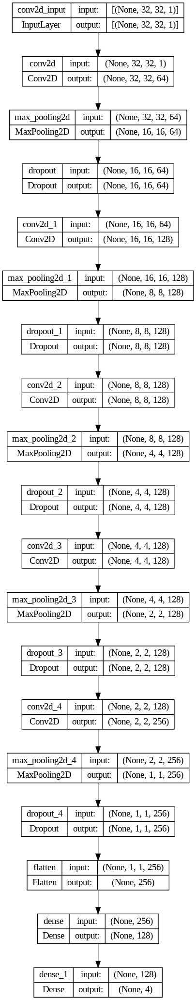

In [ ]:
tf.keras.utils.plot_model(
    model,
    to_file="model.png",
    show_shapes=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
)


In [ ]:
model.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])
hist = model.fit(x_train, y_train, epochs=200, validation_split=0.2, batch_size=64,verbose=1,shuffle=True)

Epoch 1/200
65/65 [==============================] - 31s 449ms/step - loss: 1.9299 - accuracy: 0.4622 - val_loss: 1.1429 - val_accuracy: 0.4888
Epoch 2/200
65/65 [==============================] - 29s 448ms/step - loss: 1.0492 - accuracy: 0.4963 - val_loss: 1.1388 - val_accuracy: 0.4888
Epoch 3/200
65/65 [==============================] - 28s 439ms/step - loss: 1.0368 - accuracy: 0.4924 - val_loss: 1.0465 - val_accuracy: 0.4888
Epoch 4/200
65/65 [==============================] - 28s 432ms/step - loss: 1.0158 - accuracy: 0.4951 - val_loss: 0.9918 - val_accuracy: 0.4888
Epoch 5/200
65/65 [==============================] - 28s 426ms/step - loss: 0.9611 - accuracy: 0.5161 - val_loss: 0.9981 - val_accuracy: 0.5541
Epoch 6/200
65/65 [==============================] - 28s 421ms/step - loss: 0.9724 - accuracy: 0.5168 - val_loss: 0.9423 - val_accuracy: 0.5746
Epoch 7/200
65/65 [==============================] - 28s 423ms/step - loss: 0.9596 - accuracy: 0.5220 - val_loss: 1.0625 - val_accuracy:

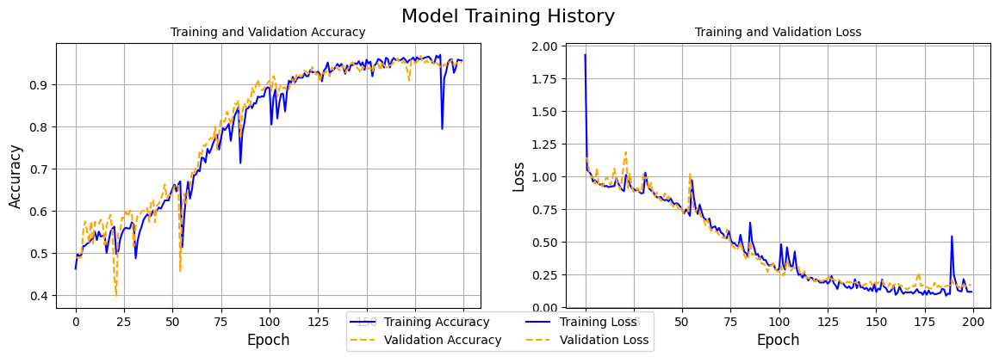

In [ ]:
import matplotlib.pyplot as plt

# Extract metrics from history object
acc = hist.history['accuracy']
val_acc = hist.history['val_accuracy']
loss = hist.history['loss']
val_loss = hist.history['val_loss']

# Create figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 4))

# Plot accuracy metrics
ax1.plot(acc, label='Training Accuracy', color='blue', linestyle='solid')
ax1.plot(val_acc, label='Validation Accuracy', color='orange', linestyle='dashed')
ax1.set_xlabel('Epoch', fontsize=12)
ax1.set_ylabel('Accuracy', fontsize=12)
ax1.set_title('Training and Validation Accuracy', fontsize=10)
ax1.grid()

# Plot loss metrics
ax2.plot(loss, label='Training Loss', color='blue', linestyle='solid')
ax2.plot(val_loss, label='Validation Loss', color='orange', linestyle='dashed')
ax2.set_xlabel('Epoch', fontsize=12)
ax2.set_ylabel('Loss', fontsize=12)
ax2.set_title('Training and Validation Loss', fontsize=10)
ax2.grid()

# Add legend and title to figure
fig.legend(loc='lower center', ncol=2, fontsize=10)
fig.suptitle('Model Training History', fontsize=16)

# Show the plot
plt.show()


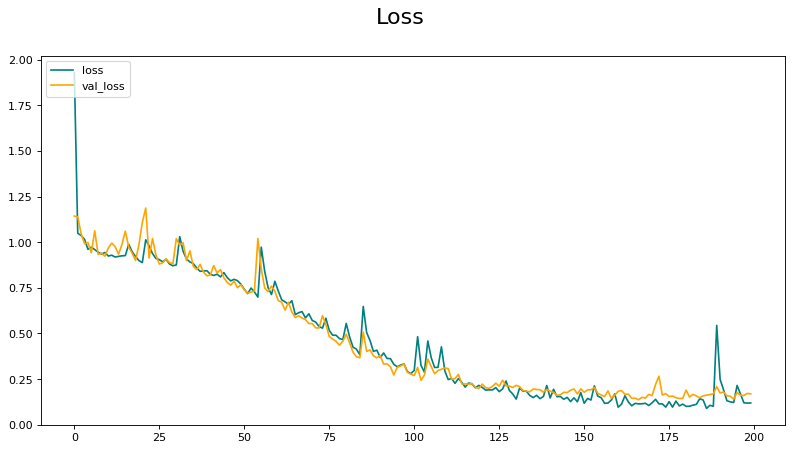

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

fig = plt.figure(figsize=(12, 6), dpi=80)
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val_loss')
fig.suptitle('Loss', fontsize=20)
plt.legend(loc="upper left")
plt.show()

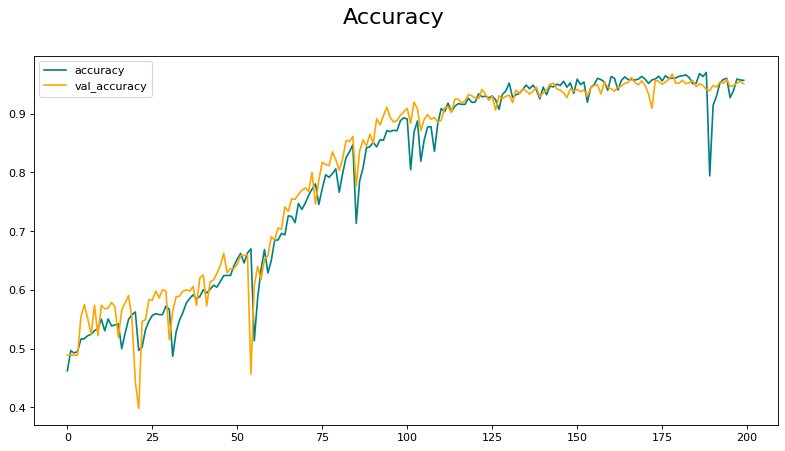

In [ ]:
fig = plt.figure(figsize=(12, 6), dpi=80)
plt.plot(hist.history['accuracy'], color='teal', label='accuracy')
plt.plot(hist.history['val_accuracy'], color='orange', label='val_accuracy')
fig.suptitle('Accuracy', fontsize=20)
plt.legend(loc="upper left")
plt.show()

In [ ]:
loss_and_metrics = model.evaluate(x_test, y_test, verbose=2)
y_pred = model.predict(x_test).argmax(axis=1)
print(f'Test Loss     : {loss_and_metrics[0]}')
print(f'Test Accuracy : {loss_and_metrics[1]}')
print(y_test.shape, y_pred.shape)

41/41 - 2s - loss: 0.1473 - accuracy: 0.9571 - 2s/epoch - 39ms/step
41/41 [==============================] - 3s 63ms/step
Test Loss     : 0.1473149061203003
Test Accuracy : 0.9570648074150085
(1281, 4) (1281,)


In [ ]:
from sklearn import metrics

df = pd.DataFrame(
  data = metrics.confusion_matrix(np.argmax(y_test, axis=1), y_pred),
  columns = ['0', '1', '2', '3'],
  index = ['0', '1', '2', '3']
)
df

,0,1,2,3
0,12,4,1,0
1,0,425,6,19
2,0,11,170,0
3,0,14,0,619


<Axes: >

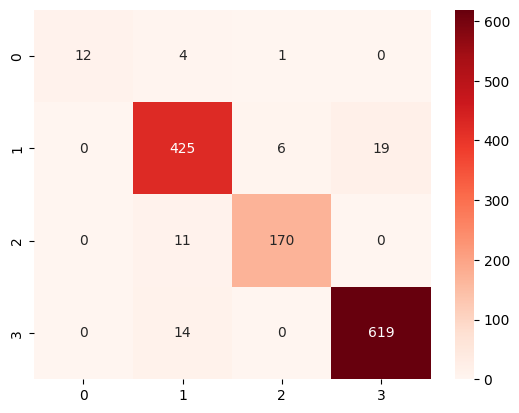

In [ ]:
import seaborn as sns

sns.heatmap(df, cmap="Reds", annot=True, fmt='.0f')

In [ ]:
print("Test Loss", loss_and_metrics[0])
print("Test Accuracy", loss_and_metrics[1])

Test Loss 0.1473149061203003
Test Accuracy 0.9570648074150085


In [ ]:
model

In [ ]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image

# Compile the model
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
hist = model.fit(x_train, y_train, epochs=200, validation_split=0.2, batch_size=64, verbose=1, shuffle=True)




Epoch 1/200
65/65 [==============================] - 30s 439ms/step - loss: 0.1211 - accuracy: 0.9602 - val_loss: 0.1670 - val_accuracy: 0.9522
Epoch 2/200
65/65 [==============================] - 28s 436ms/step - loss: 0.1242 - accuracy: 0.9610 - val_loss: 0.1625 - val_accuracy: 0.9502
Epoch 3/200
65/65 [==============================] - 29s 454ms/step - loss: 0.1230 - accuracy: 0.9600 - val_loss: 0.1768 - val_accuracy: 0.9532
Epoch 4/200
65/65 [==============================] - 28s 434ms/step - loss: 0.1028 - accuracy: 0.9646 - val_loss: 0.1669 - val_accuracy: 0.9590
Epoch 5/200
65/65 [==============================] - 28s 436ms/step - loss: 0.1174 - accuracy: 0.9592 - val_loss: 0.1708 - val_accuracy: 0.9454
Epoch 6/200
65/65 [==============================] - 28s 425ms/step - loss: 0.1249 - accuracy: 0.9580 - val_loss: 0.1643 - val_accuracy: 0.9580
Epoch 7/200
65/65 [==============================] - 28s 427ms/step - loss: 0.1170 - accuracy: 0.9583 - val_loss: 0.1388 - val_accuracy:

In [ ]:
# Function to generate class activation maps (CAM)
def generate_cam(img_array, model, class_index):
    # Get the last convolutional layer
    last_conv_layer = model.get_layer('conv2d_4')  # Update with the correct name of the last convolutional layer

    # Create a new model that outputs the last conv layer's feature map and the final prediction
    cam_model = Model(inputs=model.input, outputs=[last_conv_layer.output, model.output])

    # Get the feature map and the prediction for the input image
    feature_map, prediction = cam_model.predict(img_array)

    # Perform global average pooling on the feature map
    pooled_features = np.mean(feature_map, axis=(1, 2))

    # Get the weights of the dense layer
    dense_weights = model.get_layer('dense').get_weights()[0]

    # Compute the CAM
    cam = np.dot(pooled_features, dense_weights[:, class_index])

    # Resize the CAM to match the input image size
    cam = cv2.resize(cam, (img_array.shape[2], img_array.shape[1]))

    # Normalize the CAM to the range [0, 1]
    cam = cam - np.min(cam)
    cam = cam / np.max(cam)

    # Convert the CAM to the heatmap by applying a colormap
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)

    # Overlay the heatmap on the original image
    overlayed_img = cv2.addWeighted(cv2.cvtColor(np.uint8(255 * img_array[0]), cv2.COLOR_RGB2BGR), 0.5, heatmap, 0.5, 0)

    return overlayed_img


1/1 [==============================] - 0s 149ms/step


<ipython-input-28-294da3a996f1>:26: RuntimeWarning: invalid value encountered in true_divide
  cam = cam / np.max(cam)


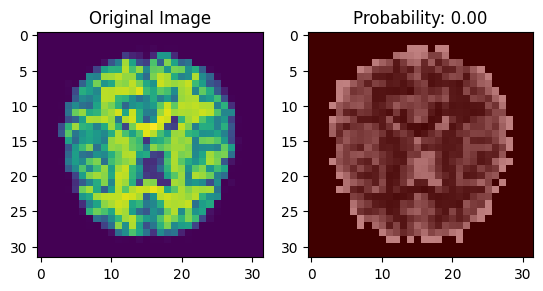

1/1 [==============================] - 0s 110ms/step


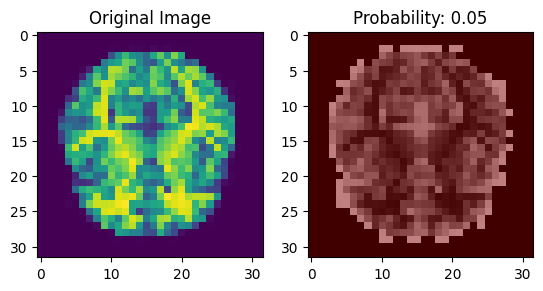

1/1 [==============================] - 0s 31ms/step


1/1 [==============================] - 0s 123ms/step


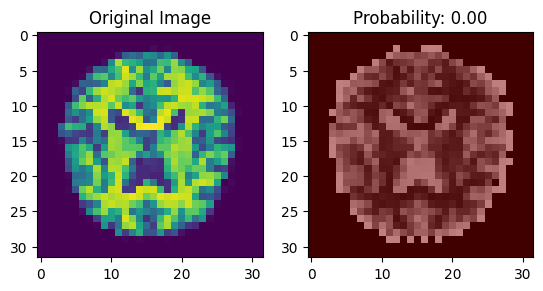

1/1 [==============================] - 0s 27ms/step


1/1 [==============================] - 0s 121ms/step


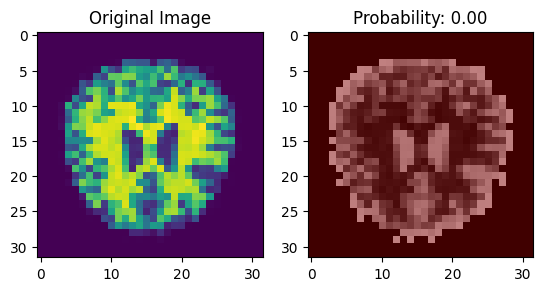

1/1 [==============================] - 0s 112ms/step


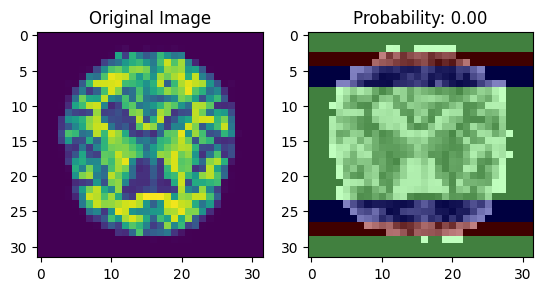

1/1 [==============================] - 0s 122ms/step


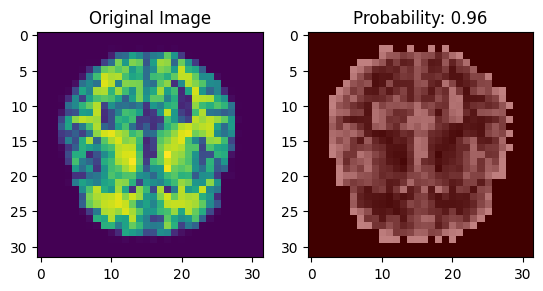

1/1 [==============================] - 0s 113ms/step


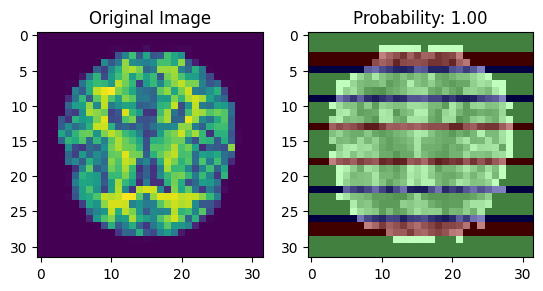

1/1 [==============================] - 0s 121ms/step


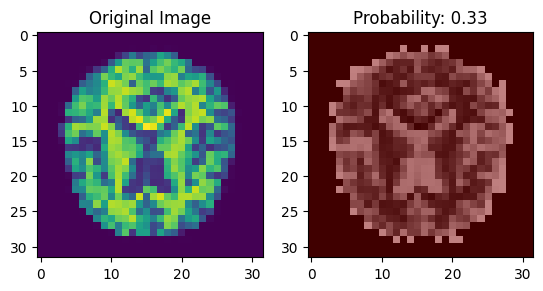

1/1 [==============================] - 0s 114ms/step


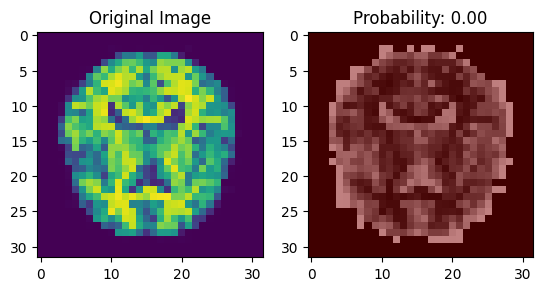

1/1 [==============================] - 0s 111ms/step


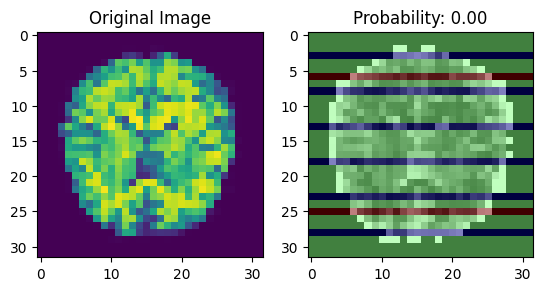

1/1 [==============================] - 0s 118ms/step


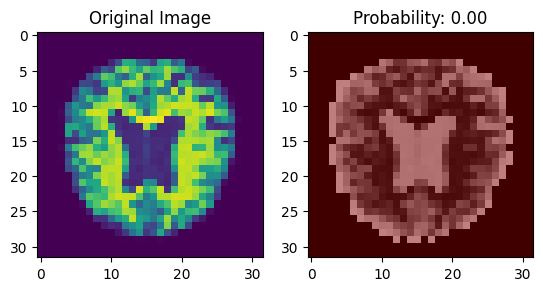

1/1 [==============================] - 0s 158ms/step


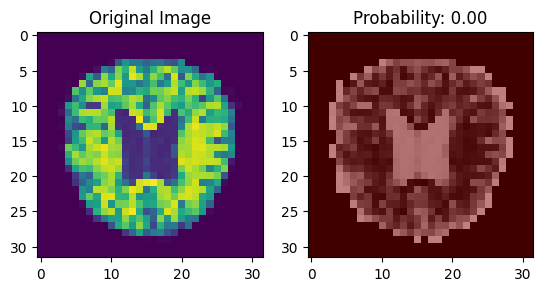

1/1 [==============================] - 0s 194ms/step


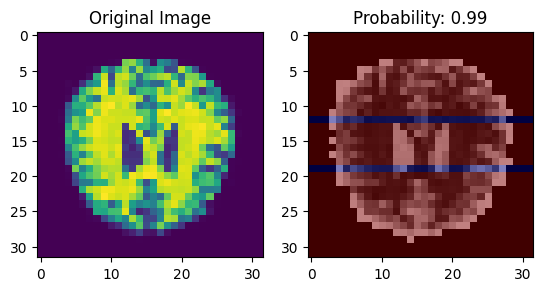

1/1 [==============================] - 0s 182ms/step


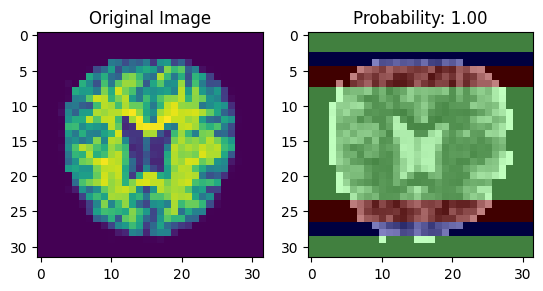

1/1 [==============================] - 0s 191ms/step


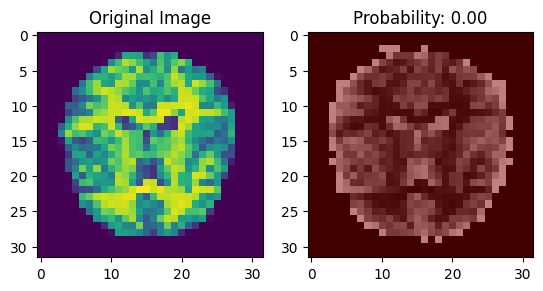

1/1 [==============================] - 0s 125ms/step


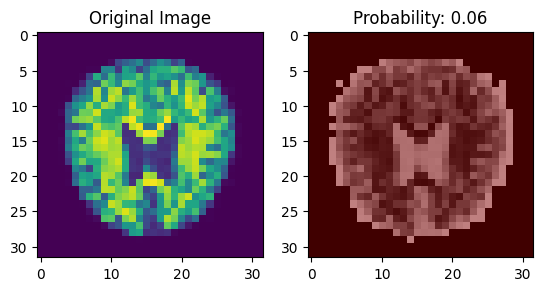

1/1 [==============================] - 0s 121ms/step


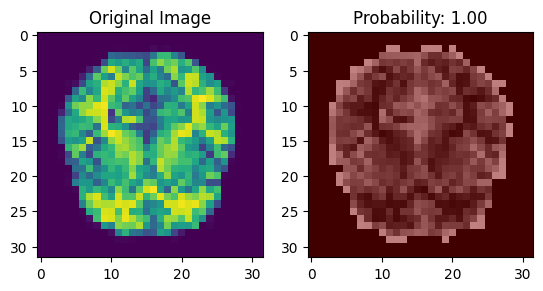

1/1 [==============================] - 0s 121ms/step


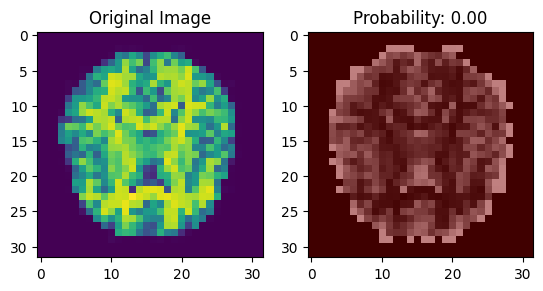

1/1 [==============================] - 0s 118ms/step


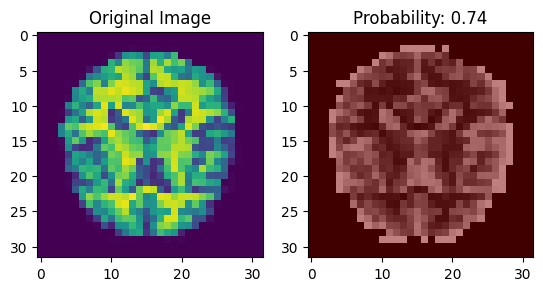

1/1 [==============================] - 0s 113ms/step


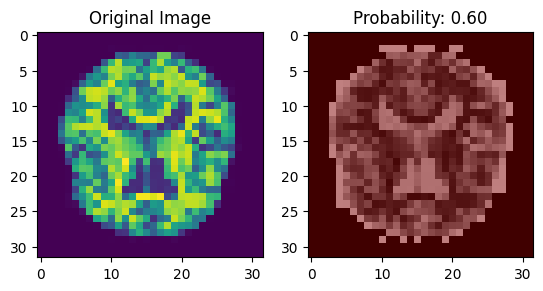

1/1 [==============================] - 0s 116ms/step


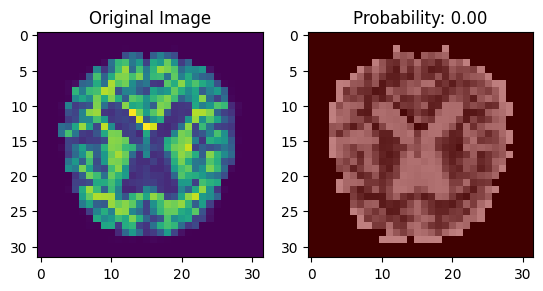

1/1 [==============================] - 0s 114ms/step


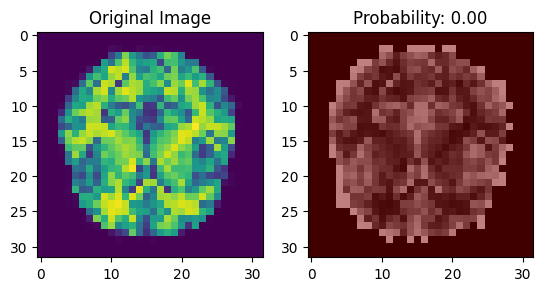

1/1 [==============================] - 0s 114ms/step


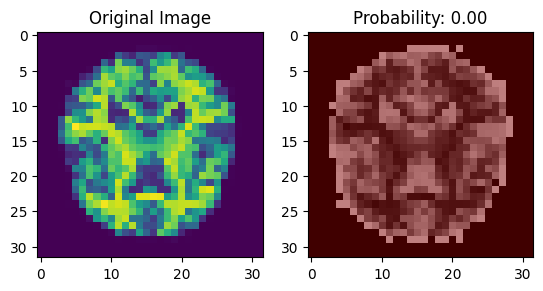

1/1 [==============================] - 0s 110ms/step


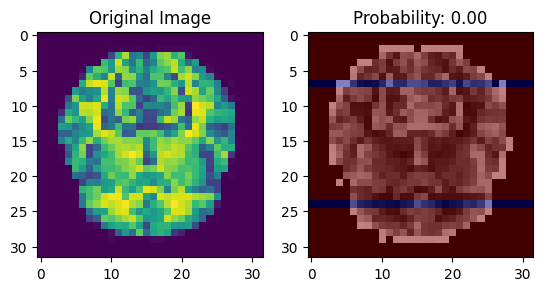

1/1 [==============================] - 0s 120ms/step


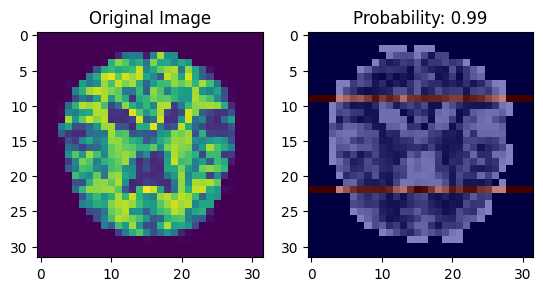

1/1 [==============================] - 0s 113ms/step


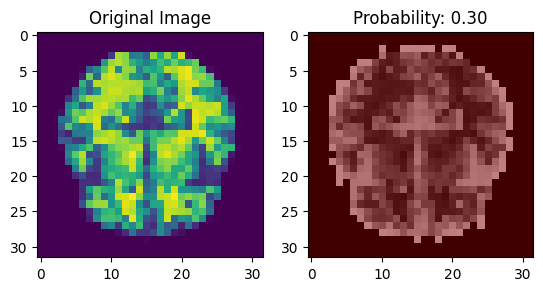

1/1 [==============================] - 0s 122ms/step


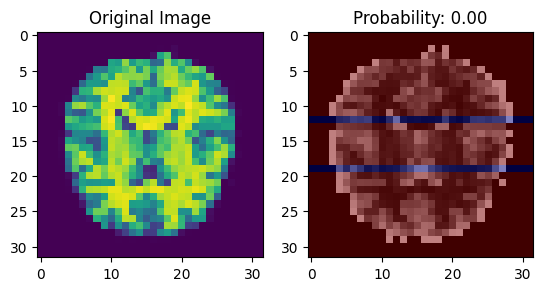

1/1 [==============================] - 0s 108ms/step


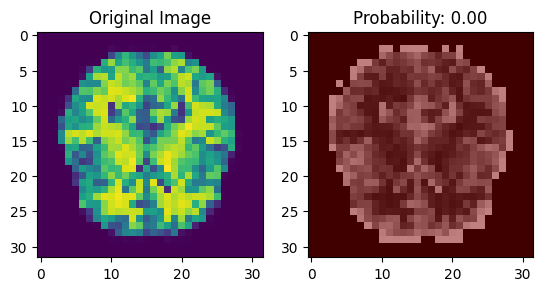

1/1 [==============================] - 0s 118ms/step


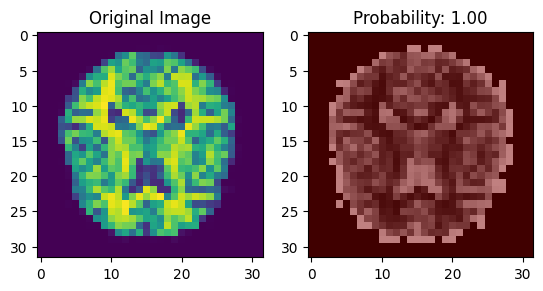

1/1 [==============================] - 0s 108ms/step


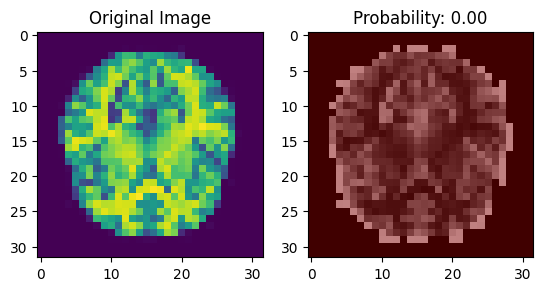

1/1 [==============================] - 0s 162ms/step


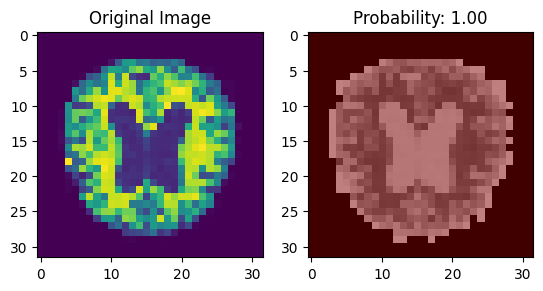

1/1 [==============================] - 0s 164ms/step


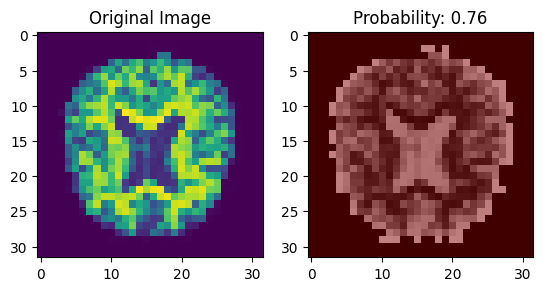

1/1 [==============================] - 0s 182ms/step


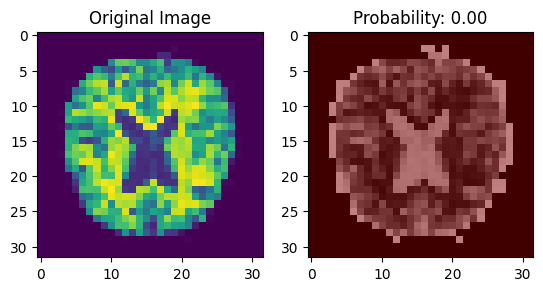

1/1 [==============================] - 0s 165ms/step


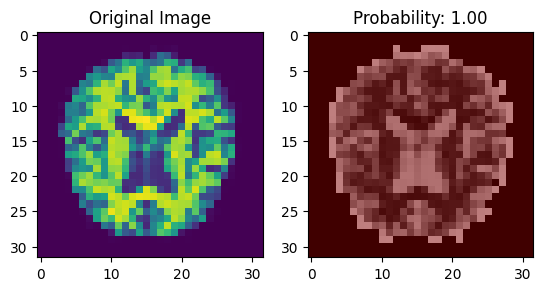

1/1 [==============================] - 0s 115ms/step


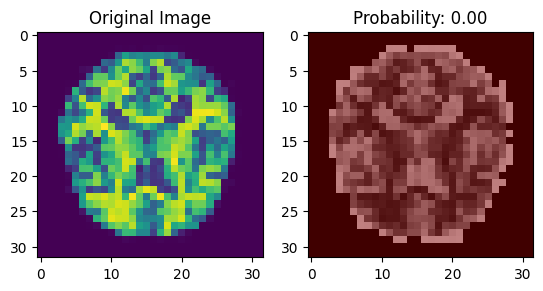

1/1 [==============================] - 0s 129ms/step


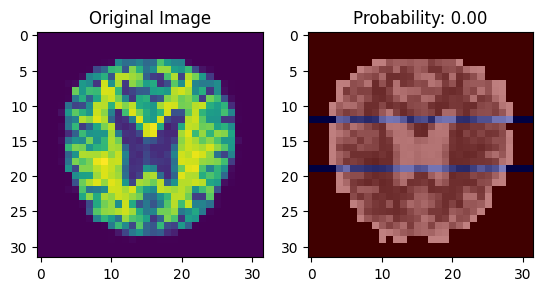

1/1 [==============================] - 0s 125ms/step


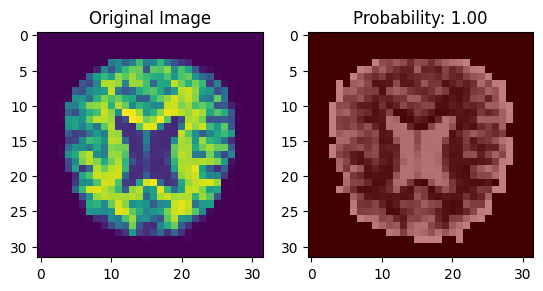

1/1 [==============================] - 0s 126ms/step


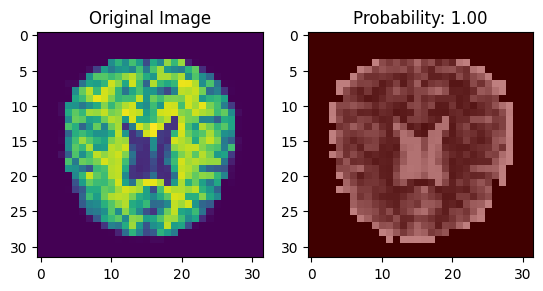

1/1 [==============================] - 0s 117ms/step


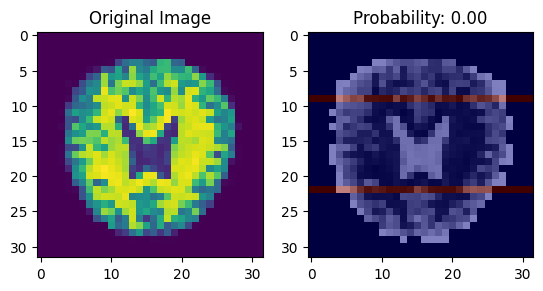

1/1 [==============================] - 0s 115ms/step


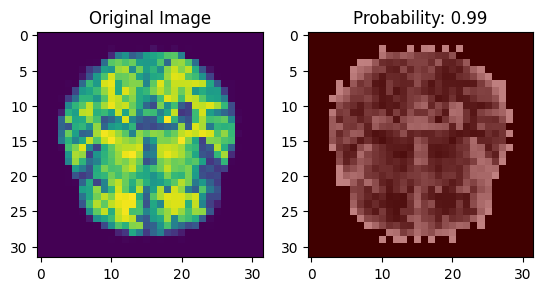

1/1 [==============================] - 0s 126ms/step


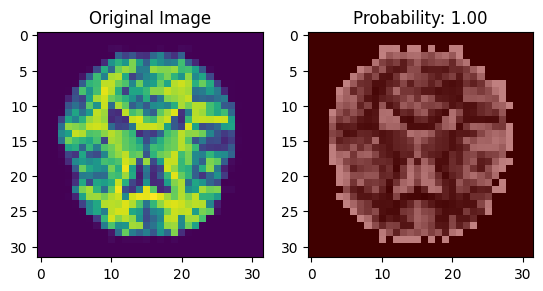

1/1 [==============================] - 0s 109ms/step


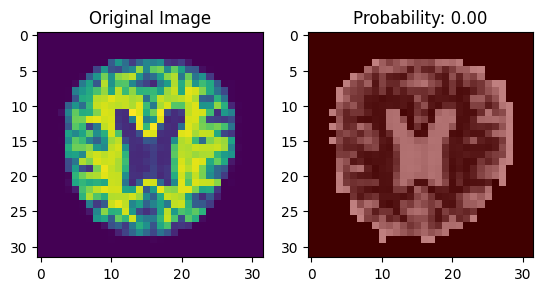

1/1 [==============================] - 0s 124ms/step


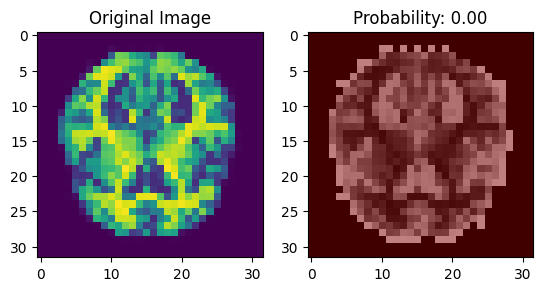

1/1 [==============================] - 0s 109ms/step


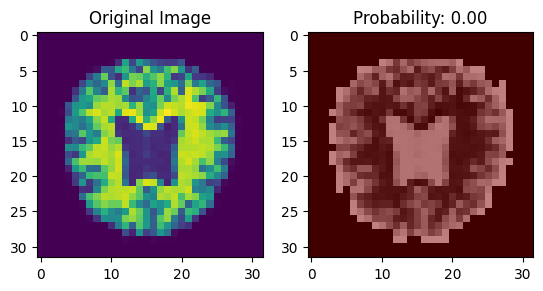

1/1 [==============================] - 0s 111ms/step


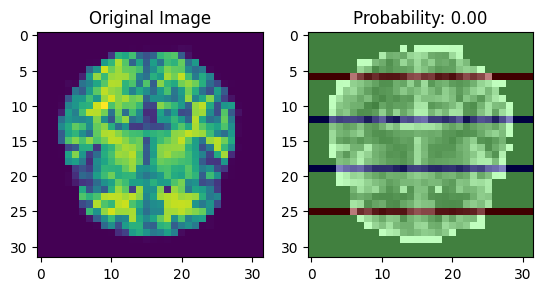

1/1 [==============================] - 0s 107ms/step


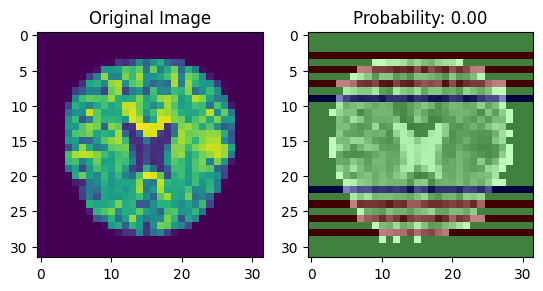

1/1 [==============================] - 0s 108ms/step


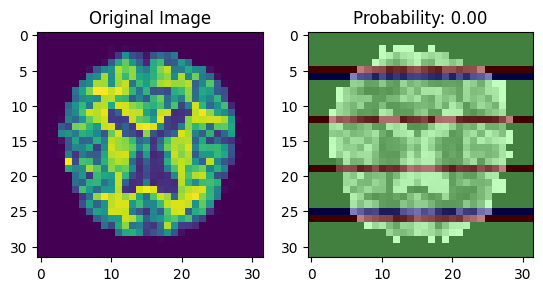

1/1 [==============================] - 0s 112ms/step


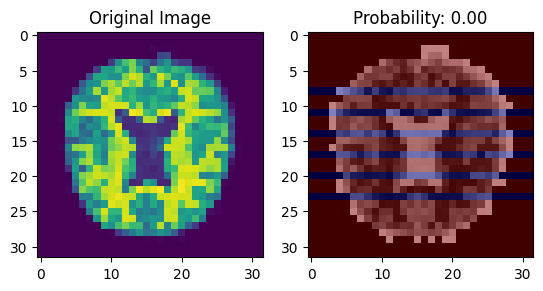

1/1 [==============================] - 0s 177ms/step


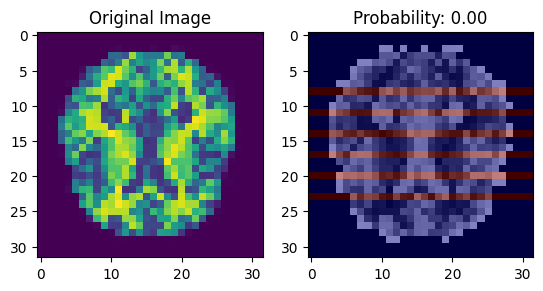

1/1 [==============================] - 0s 181ms/step


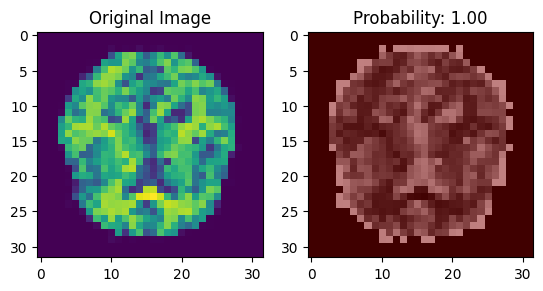

1/1 [==============================] - 0s 174ms/step


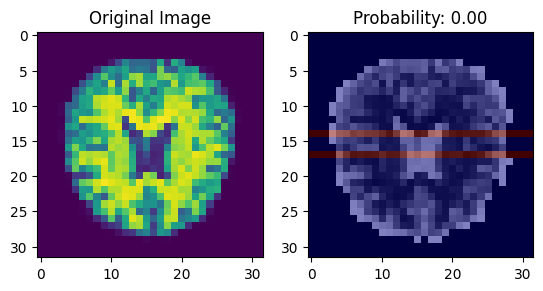

1/1 [==============================] - 0s 169ms/step


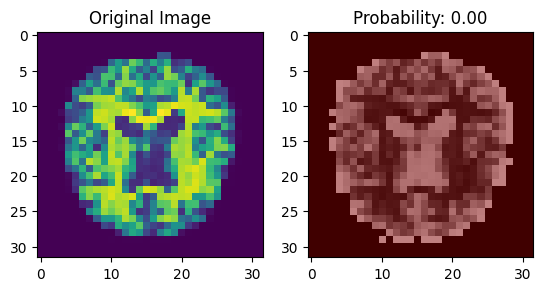

1/1 [==============================] - 0s 122ms/step


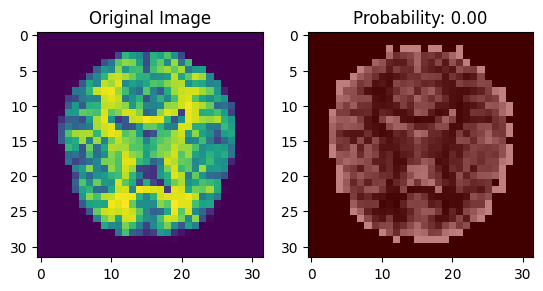

1/1 [==============================] - 0s 119ms/step


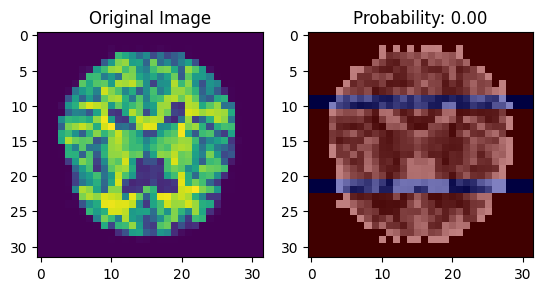

1/1 [==============================] - 0s 114ms/step


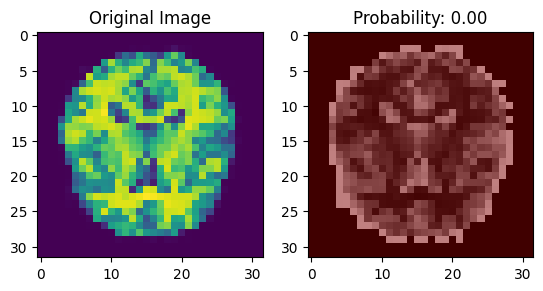

1/1 [==============================] - 0s 113ms/step


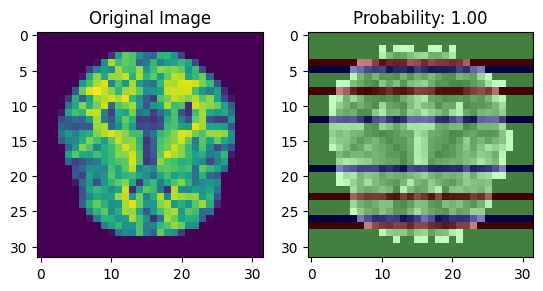

1/1 [==============================] - 0s 130ms/step


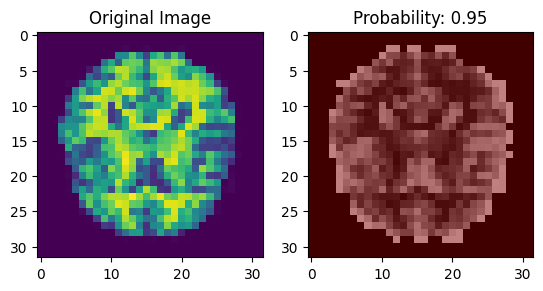

1/1 [==============================] - 0s 134ms/step


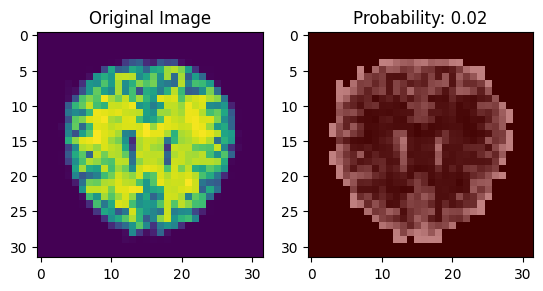

1/1 [==============================] - 0s 134ms/step


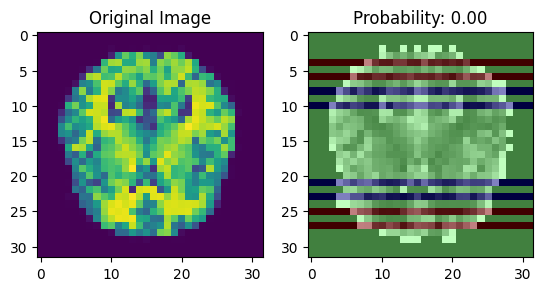

1/1 [==============================] - 0s 124ms/step


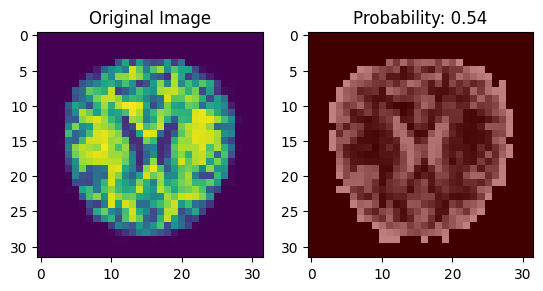

1/1 [==============================] - 0s 133ms/step


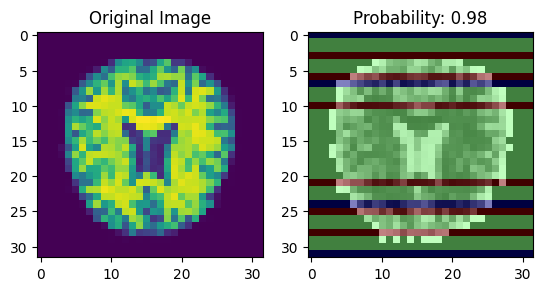

1/1 [==============================] - 0s 122ms/step


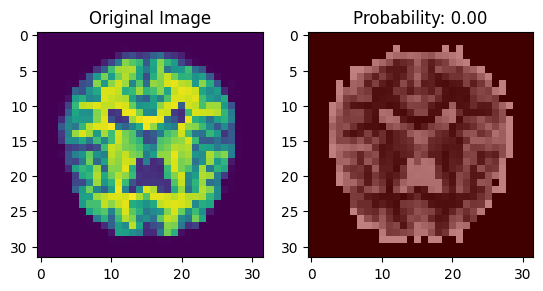

1/1 [==============================] - 0s 125ms/step


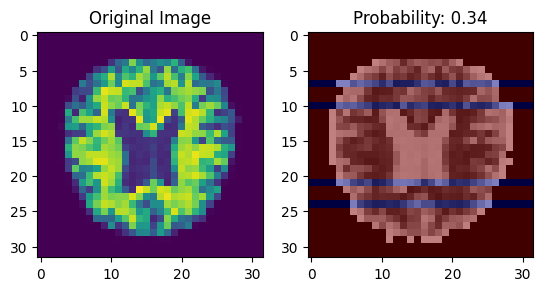

1/1 [==============================] - 0s 130ms/step


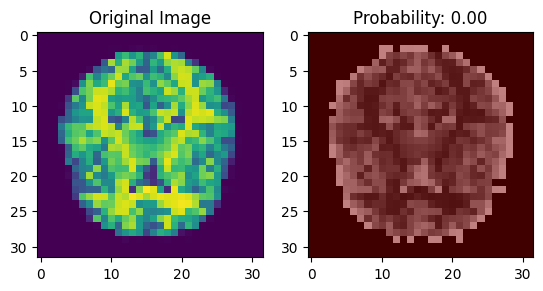

1/1 [==============================] - 0s 117ms/step


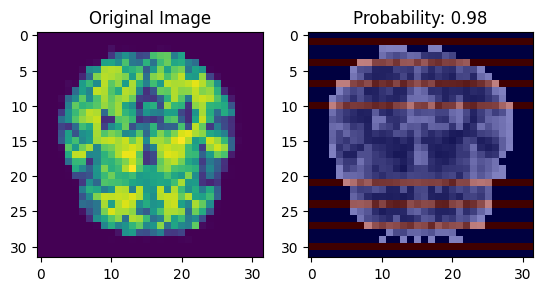

1/1 [==============================] - 0s 117ms/step


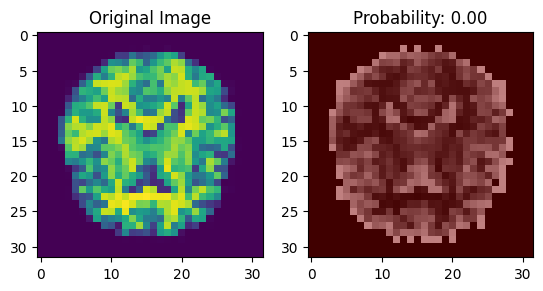

1/1 [==============================] - 0s 140ms/step


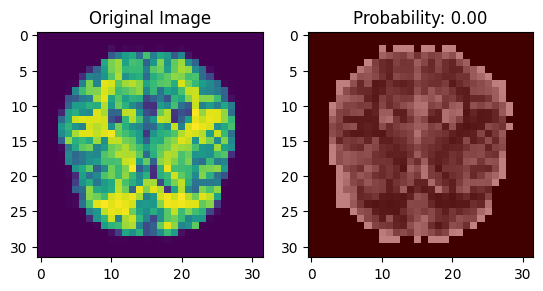

1/1 [==============================] - 0s 173ms/step


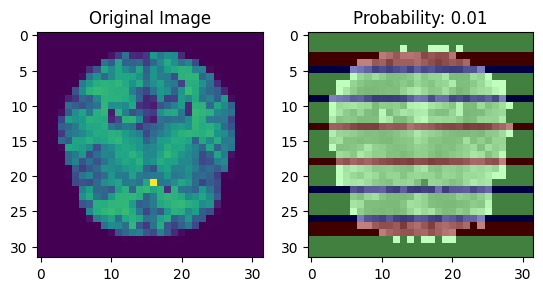

1/1 [==============================] - 0s 173ms/step


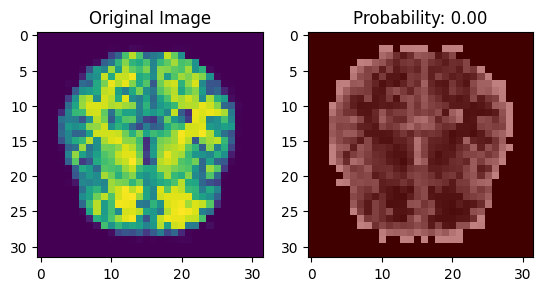

1/1 [==============================] - 0s 189ms/step


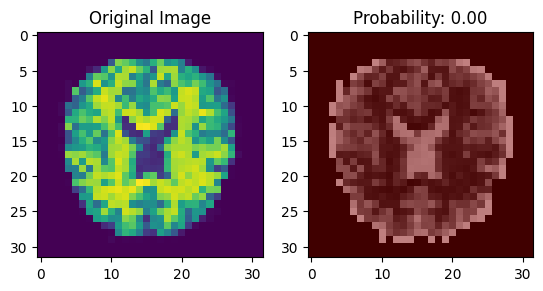

1/1 [==============================] - 0s 169ms/step


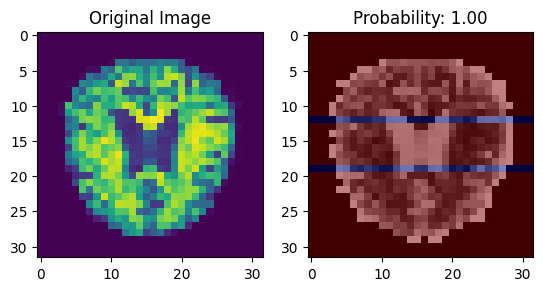

1/1 [==============================] - 0s 120ms/step


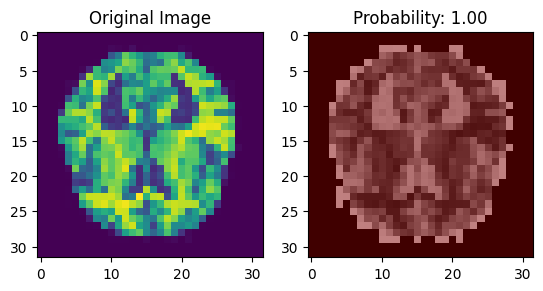

1/1 [==============================] - 0s 118ms/step


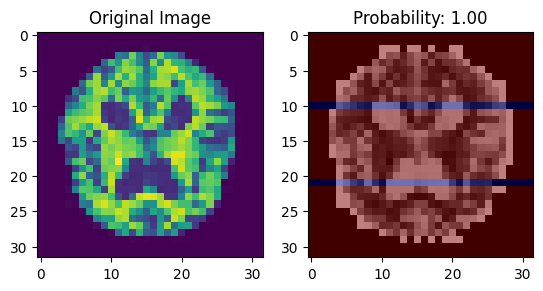

1/1 [==============================] - 0s 113ms/step


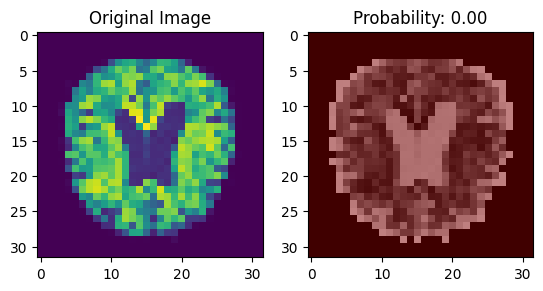

1/1 [==============================] - 0s 116ms/step


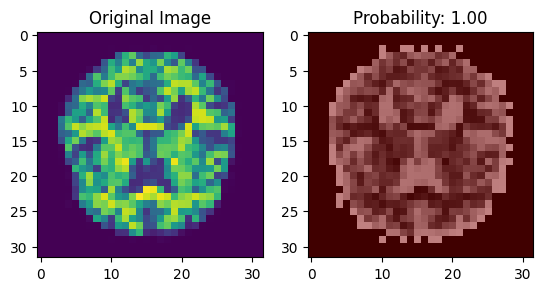

1/1 [==============================] - 0s 141ms/step


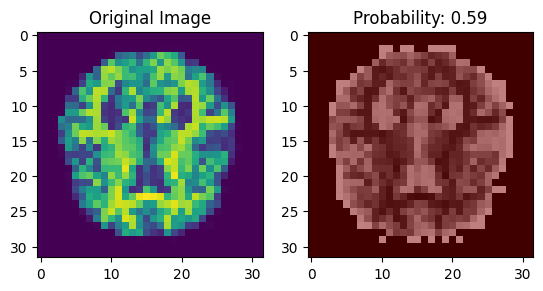

1/1 [==============================] - 0s 136ms/step


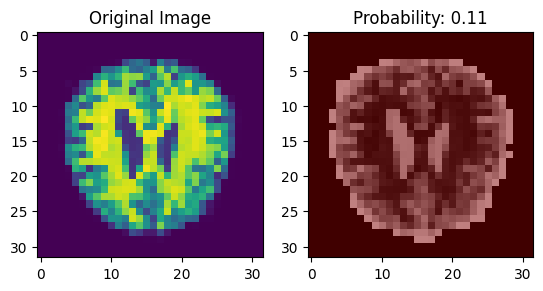

1/1 [==============================] - 0s 145ms/step


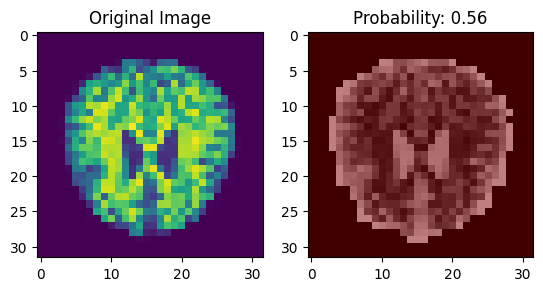

1/1 [==============================] - 0s 127ms/step


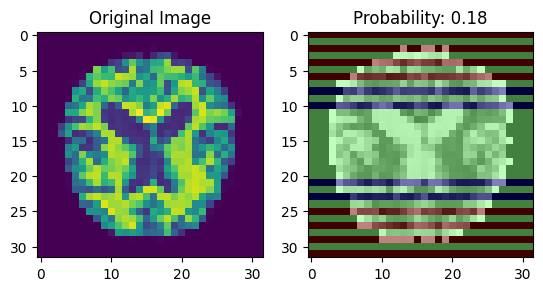

1/1 [==============================] - 0s 124ms/step


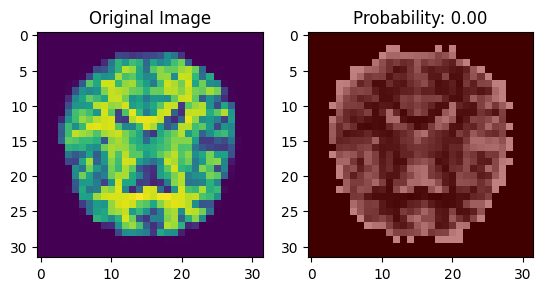

1/1 [==============================] - 0s 123ms/step


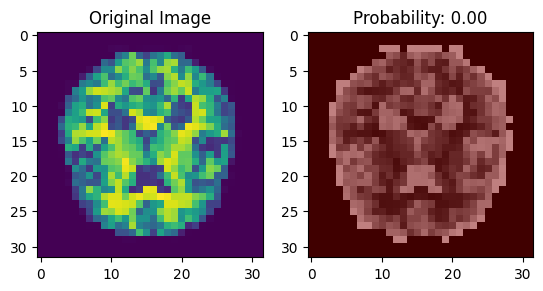

1/1 [==============================] - 0s 127ms/step


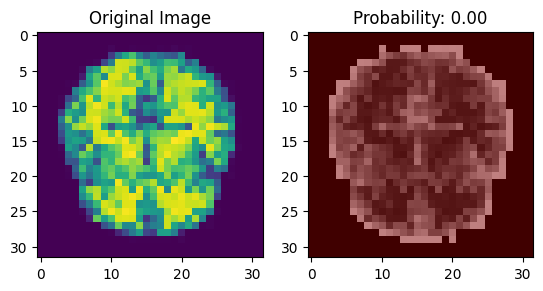

1/1 [==============================] - 0s 110ms/step


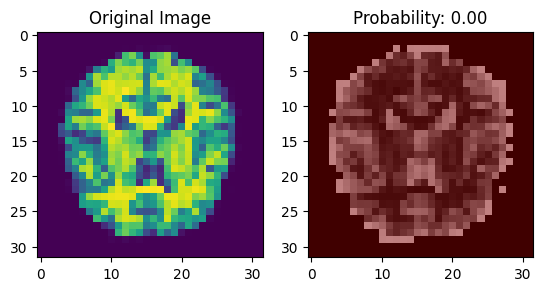

1/1 [==============================] - 0s 127ms/step


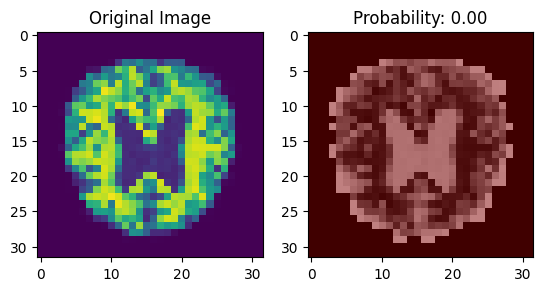

1/1 [==============================] - 0s 125ms/step


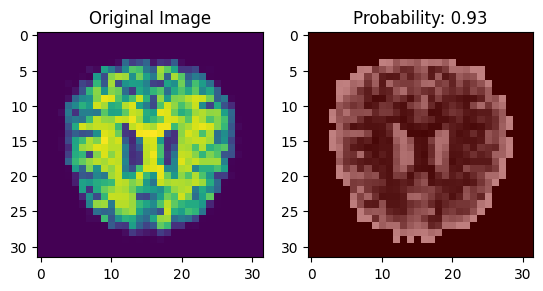

1/1 [==============================] - 0s 169ms/step


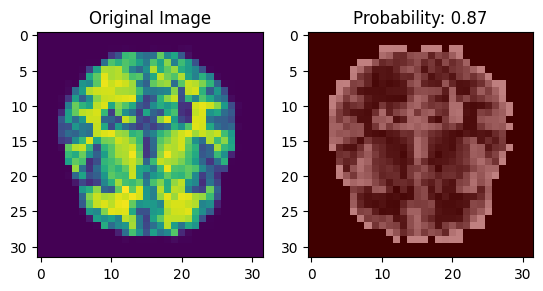

1/1 [==============================] - 0s 160ms/step


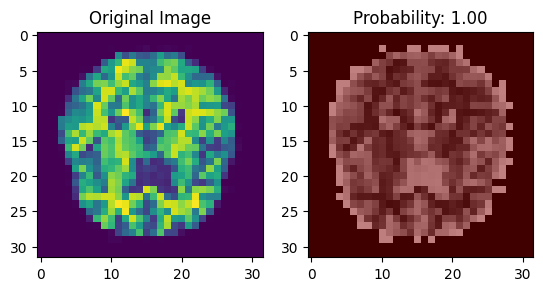

1/1 [==============================] - 0s 188ms/step


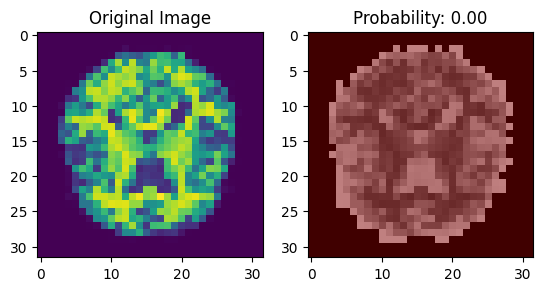

1/1 [==============================] - 0s 169ms/step


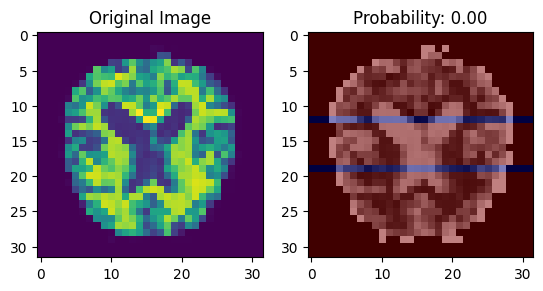

1/1 [==============================] - 0s 130ms/step


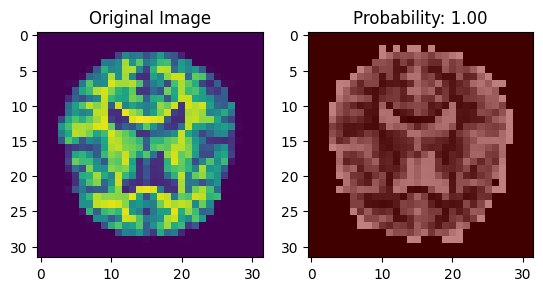

1/1 [==============================] - 0s 122ms/step


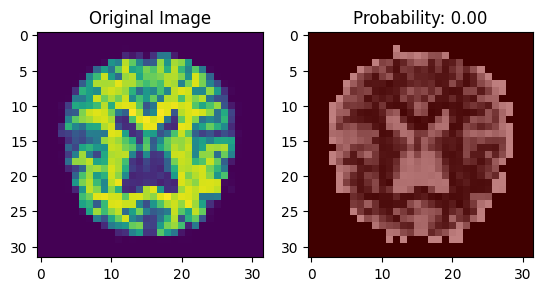

1/1 [==============================] - 0s 122ms/step


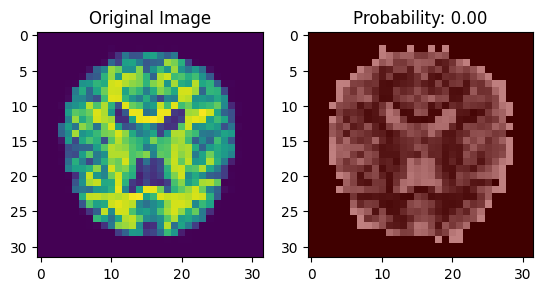

1/1 [==============================] - 0s 130ms/step


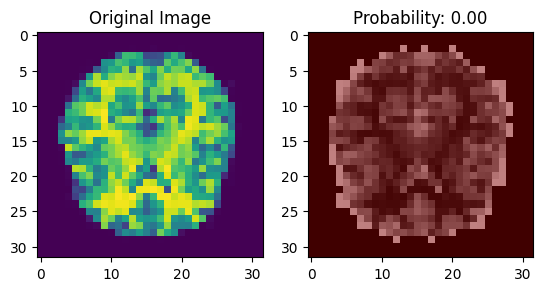

1/1 [==============================] - 0s 114ms/step


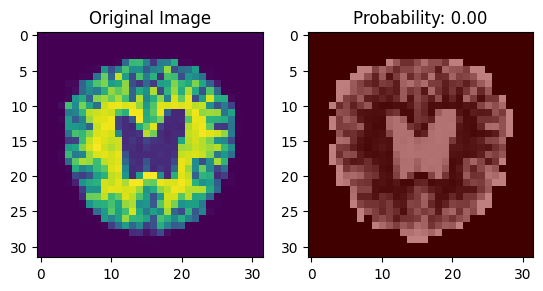

1/1 [==============================] - 0s 136ms/step


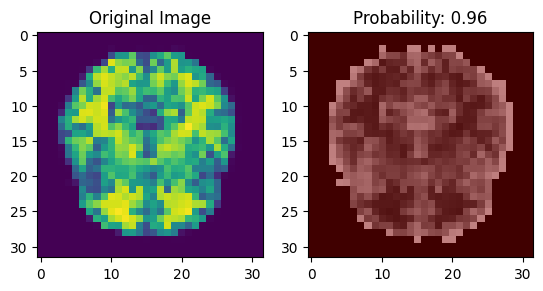

1/1 [==============================] - 0s 144ms/step


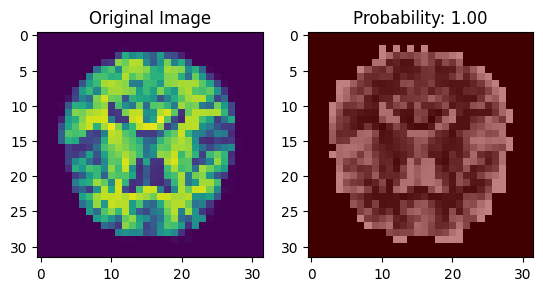

1/1 [==============================] - 0s 144ms/step


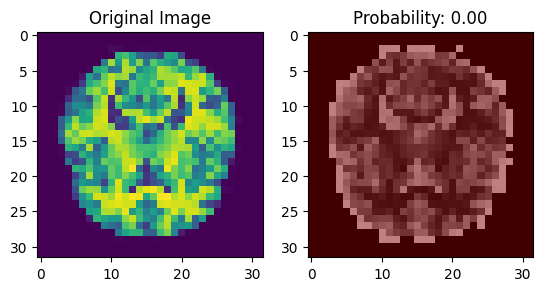

1/1 [==============================] - 0s 123ms/step


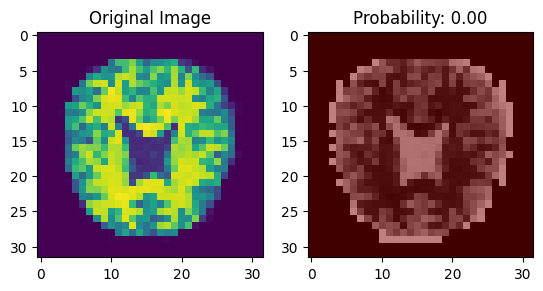

1/1 [==============================] - 0s 118ms/step


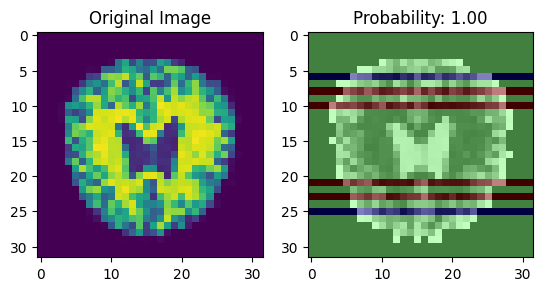

1/1 [==============================] - 0s 128ms/step


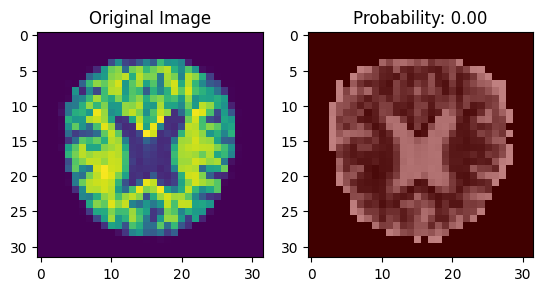

1/1 [==============================] - 0s 121ms/step


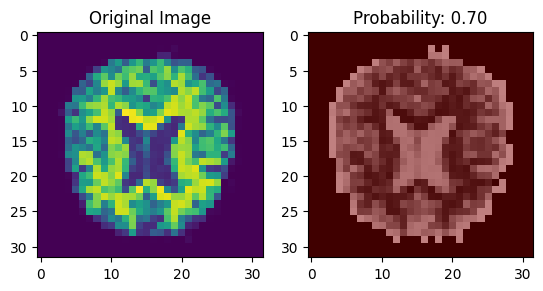

1/1 [==============================] - 0s 118ms/step


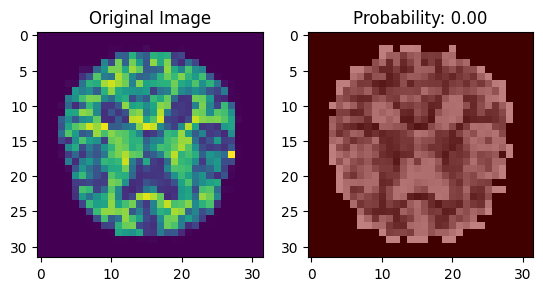

1/1 [==============================] - 0s 143ms/step


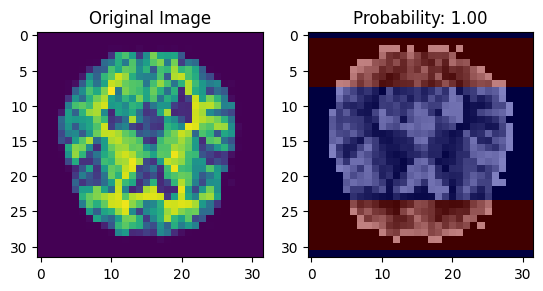

1/1 [==============================] - 0s 175ms/step


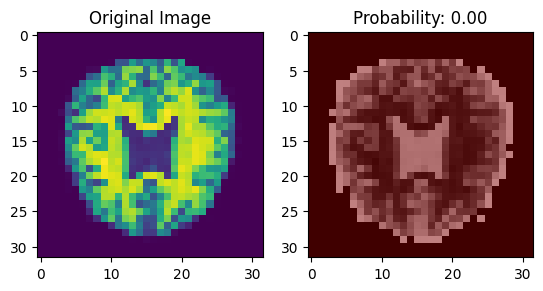

1/1 [==============================] - 0s 186ms/step


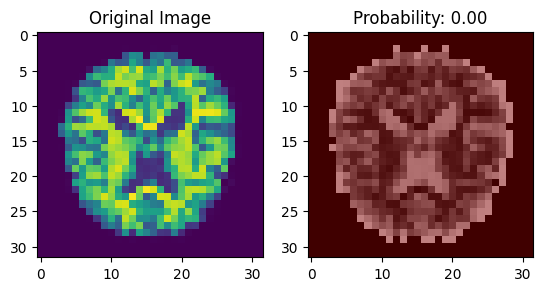

1/1 [==============================] - 0s 195ms/step


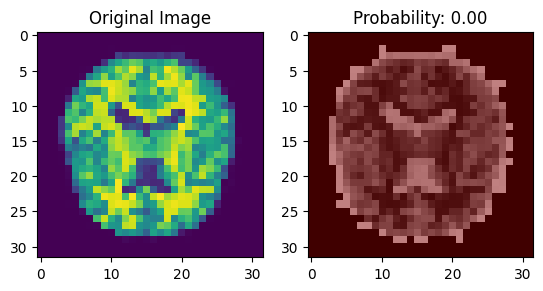

1/1 [==============================] - 0s 169ms/step


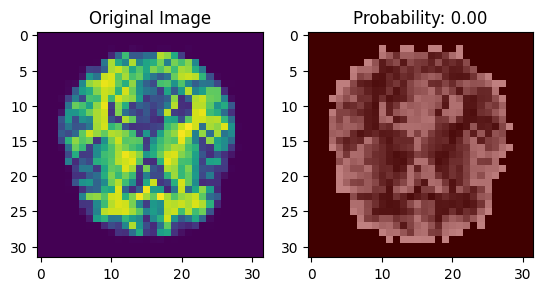

1/1 [==============================] - 0s 116ms/step


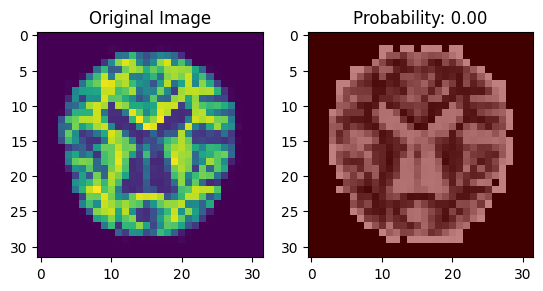

1/1 [==============================] - 0s 130ms/step


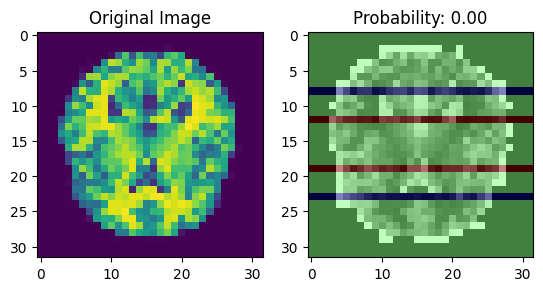

1/1 [==============================] - 0s 118ms/step


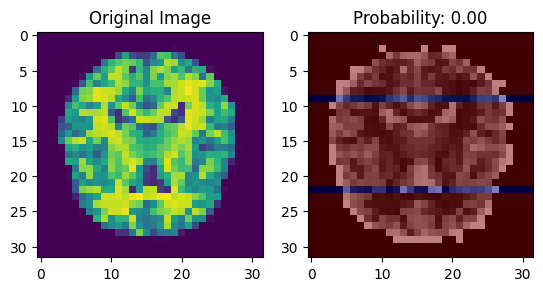

1/1 [==============================] - 0s 118ms/step


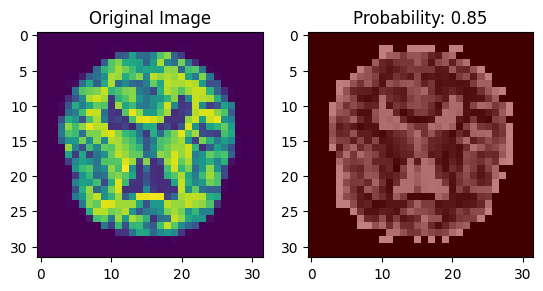

1/1 [==============================] - 0s 123ms/step


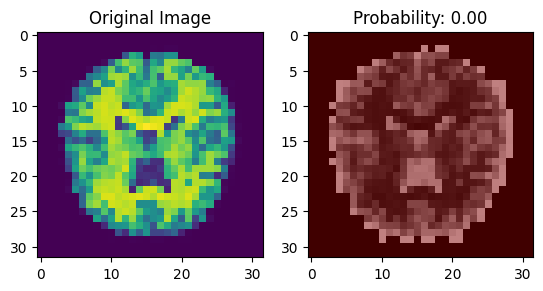

1/1 [==============================] - 0s 129ms/step


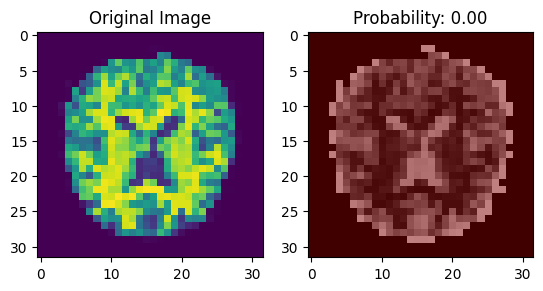

1/1 [==============================] - 0s 116ms/step


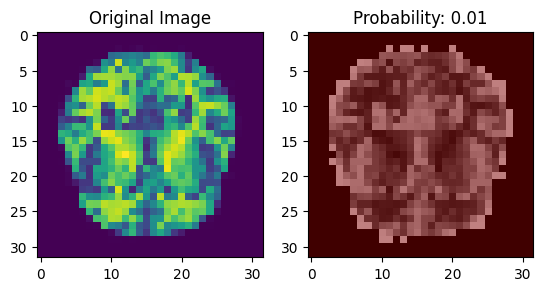

1/1 [==============================] - 1s 587ms/step


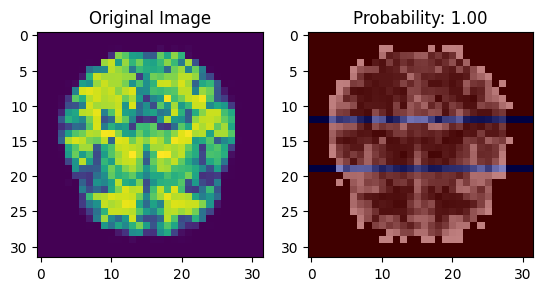

1/1 [==============================] - 0s 132ms/step


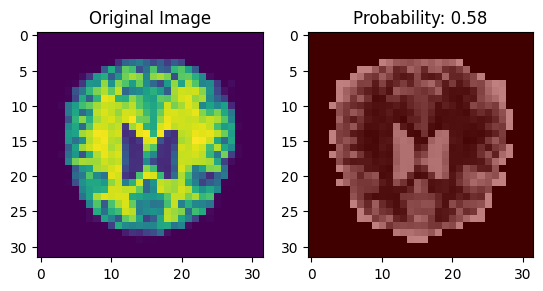

1/1 [==============================] - 0s 138ms/step


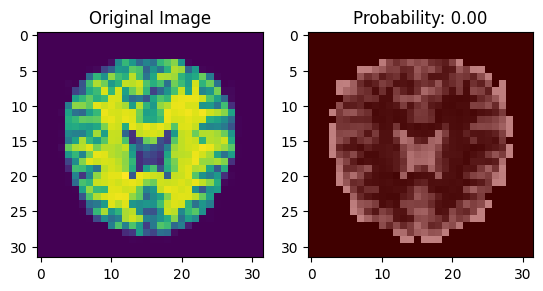

1/1 [==============================] - 0s 125ms/step


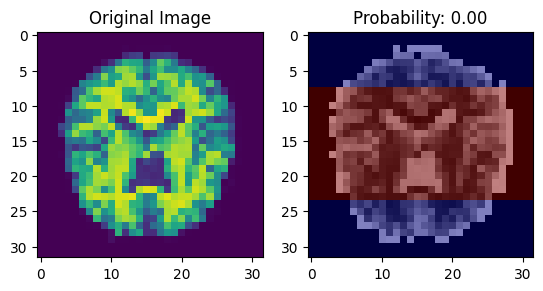

1/1 [==============================] - 0s 127ms/step


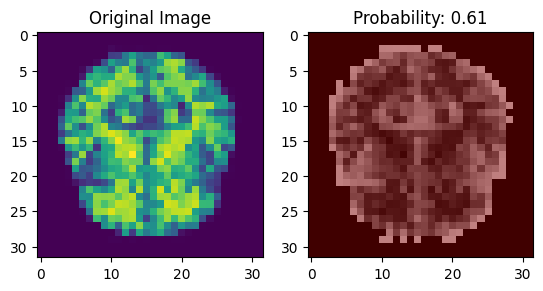

1/1 [==============================] - 0s 126ms/step


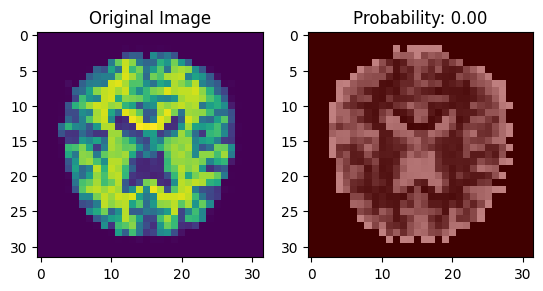

1/1 [==============================] - 0s 120ms/step


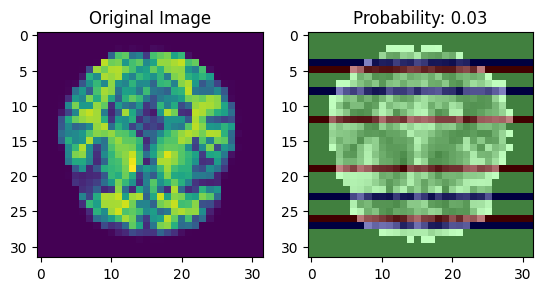

1/1 [==============================] - 0s 170ms/step


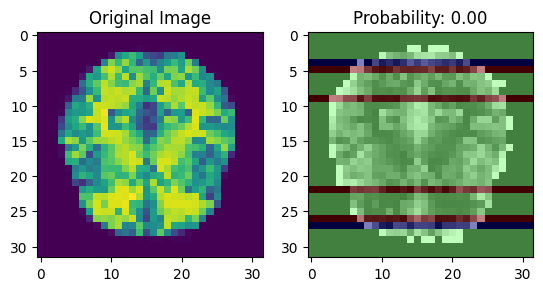

1/1 [==============================] - 0s 206ms/step


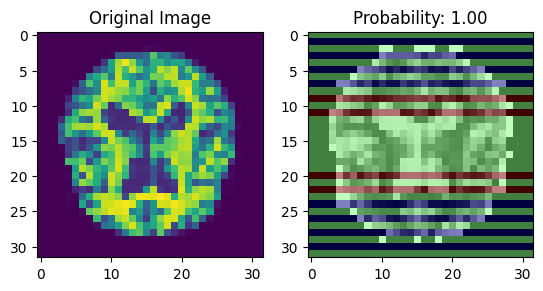

1/1 [==============================] - 0s 199ms/step


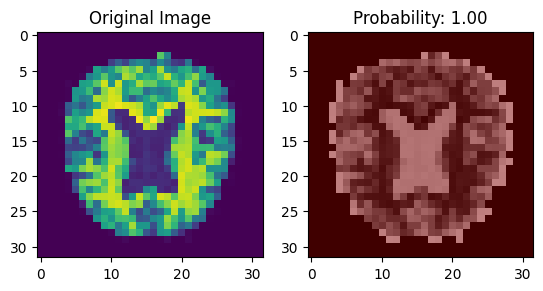

1/1 [==============================] - 0s 170ms/step


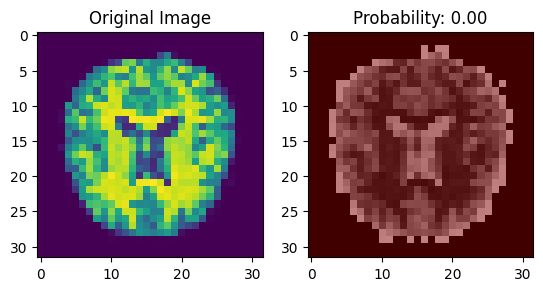

1/1 [==============================] - 0s 119ms/step


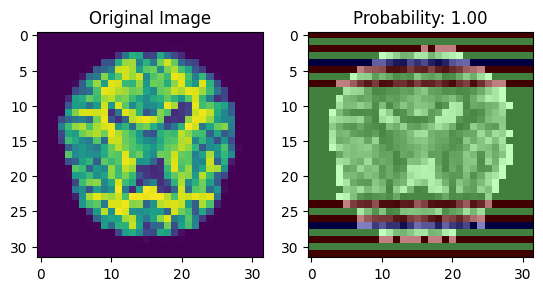

1/1 [==============================] - 0s 128ms/step


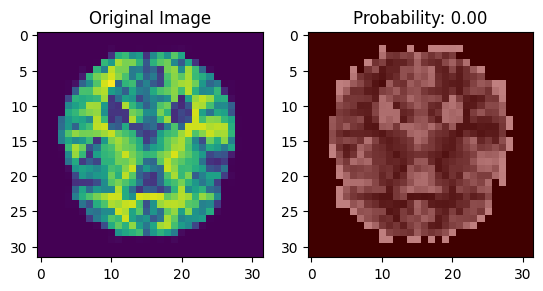

1/1 [==============================] - 0s 119ms/step


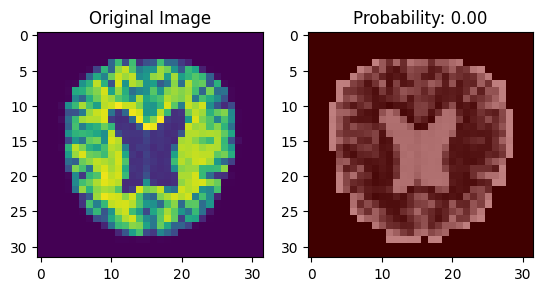

1/1 [==============================] - 0s 127ms/step


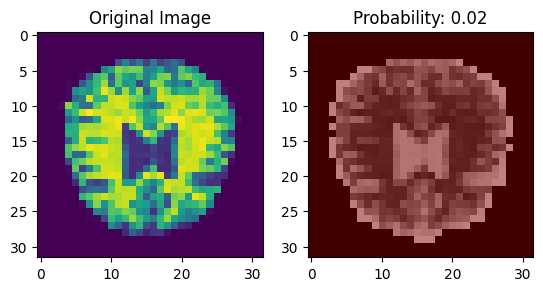

1/1 [==============================] - 0s 128ms/step


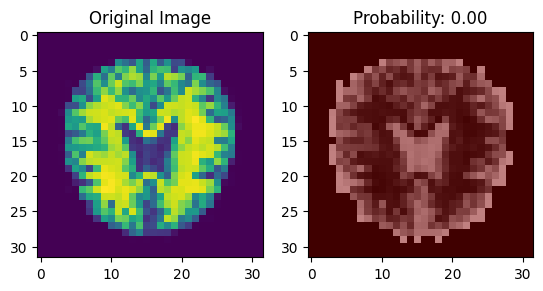

1/1 [==============================] - 0s 119ms/step


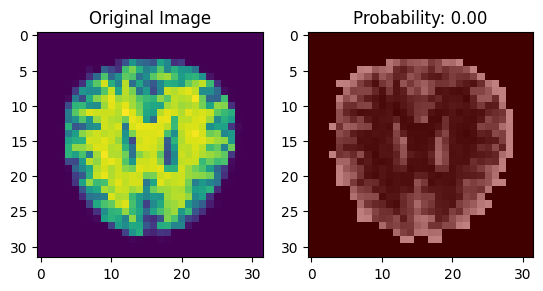

1/1 [==============================] - 0s 115ms/step


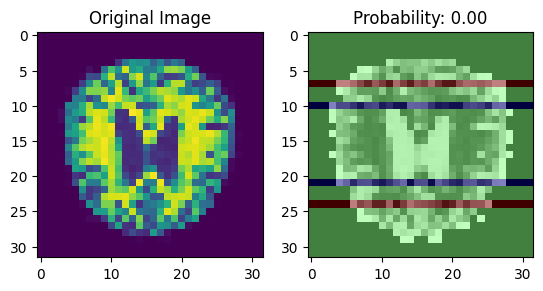

1/1 [==============================] - 0s 124ms/step


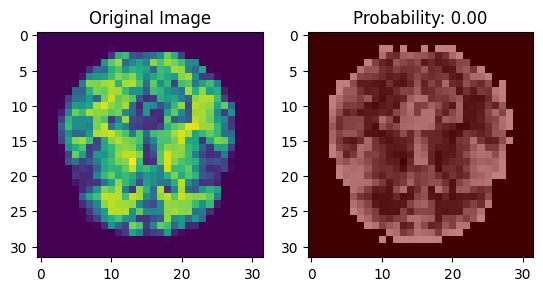

1/1 [==============================] - 0s 124ms/step


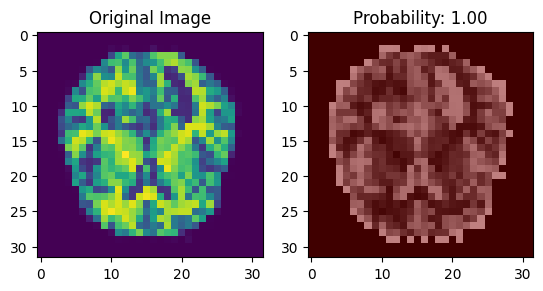

1/1 [==============================] - 0s 125ms/step


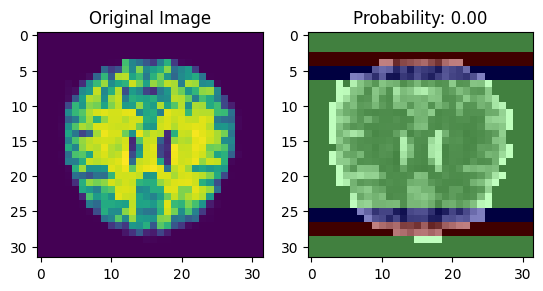

1/1 [==============================] - 0s 151ms/step


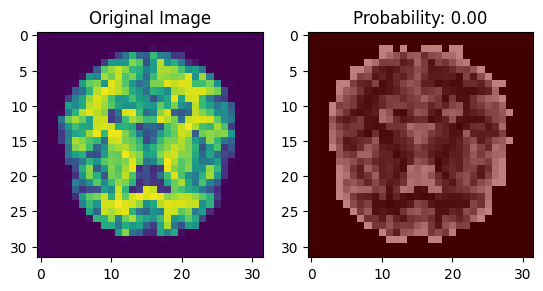

1/1 [==============================] - 0s 140ms/step


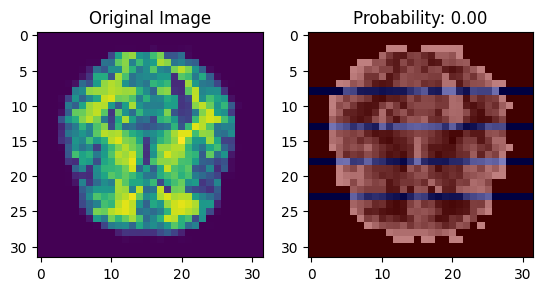

1/1 [==============================] - 0s 139ms/step


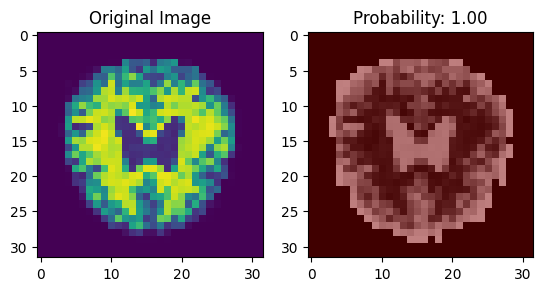

1/1 [==============================] - 0s 130ms/step


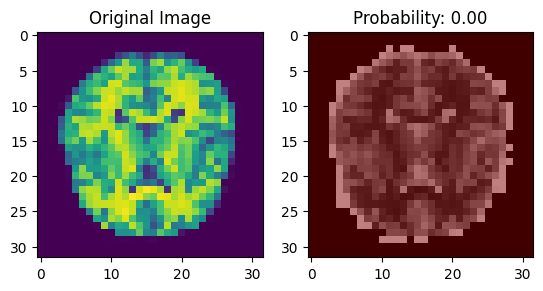

1/1 [==============================] - 0s 200ms/step


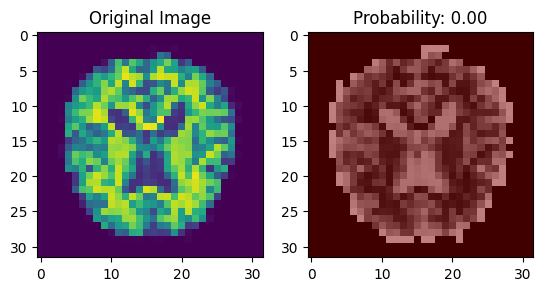

1/1 [==============================] - 0s 184ms/step


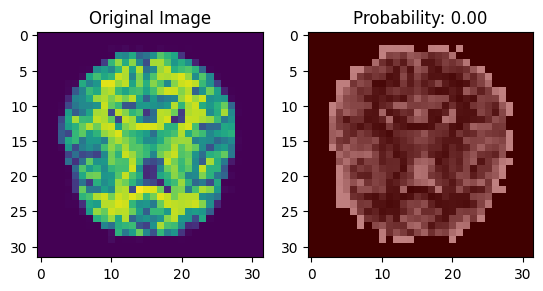

1/1 [==============================] - 0s 178ms/step


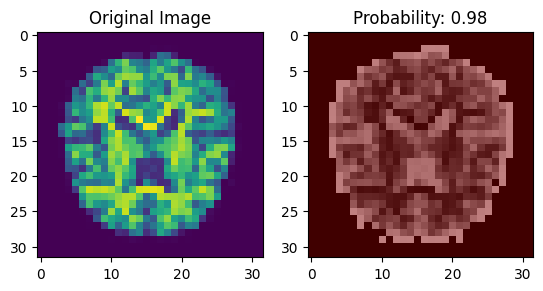

1/1 [==============================] - 0s 199ms/step


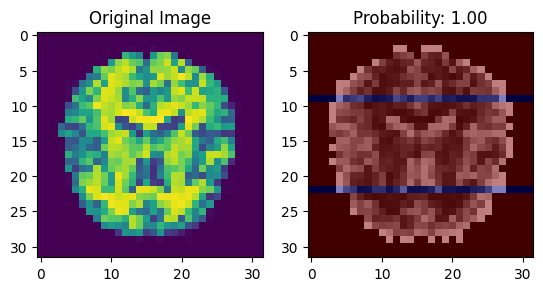

1/1 [==============================] - 0s 127ms/step


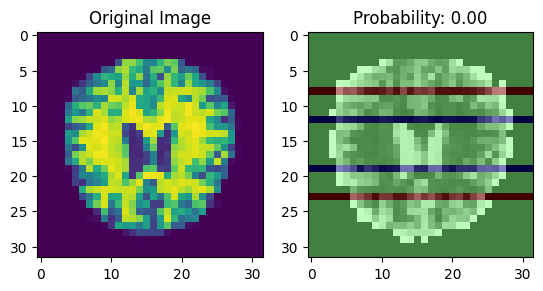

1/1 [==============================] - 0s 126ms/step


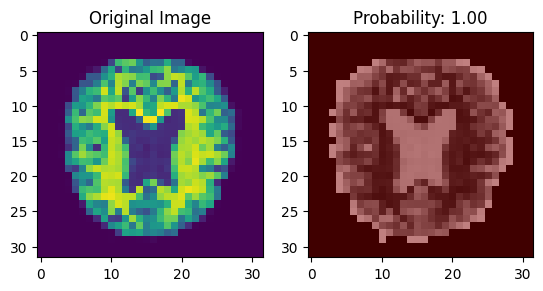

1/1 [==============================] - 0s 130ms/step


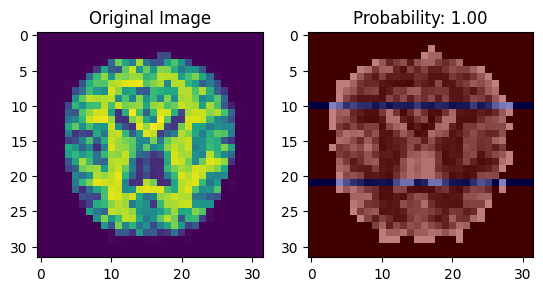

1/1 [==============================] - 0s 137ms/step


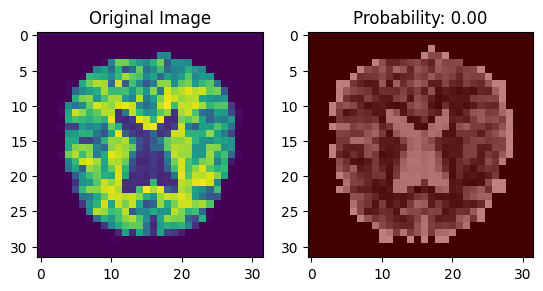

1/1 [==============================] - 0s 128ms/step


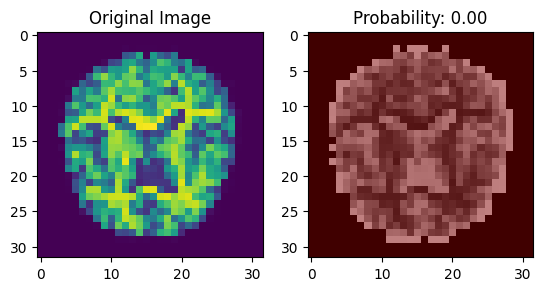

1/1 [==============================] - 0s 130ms/step


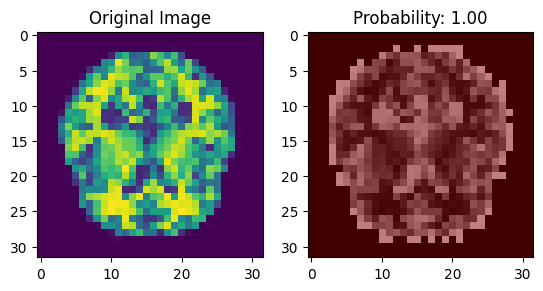

1/1 [==============================] - 0s 141ms/step


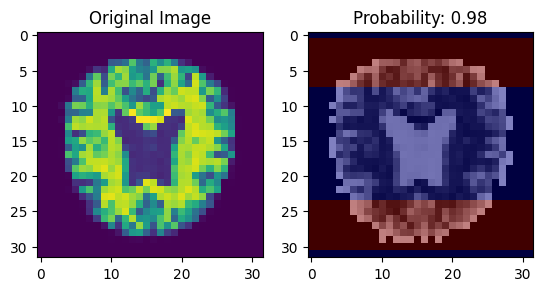

1/1 [==============================] - 0s 133ms/step


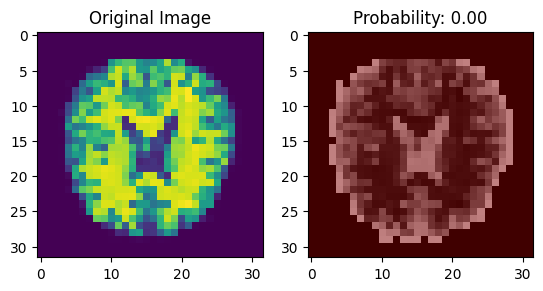

1/1 [==============================] - 0s 119ms/step


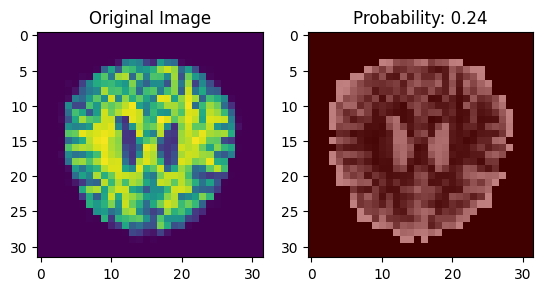

1/1 [==============================] - 0s 121ms/step


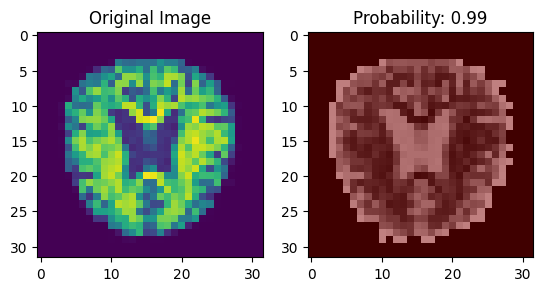

1/1 [==============================] - 0s 125ms/step


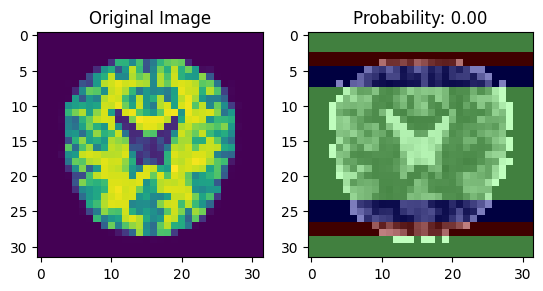

1/1 [==============================] - 0s 131ms/step


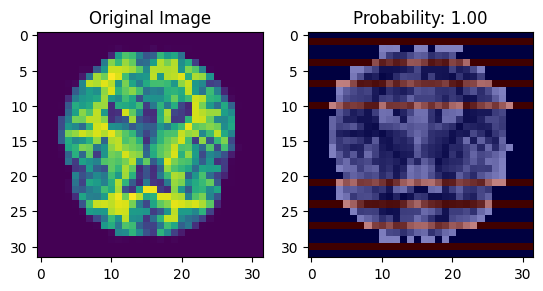

1/1 [==============================] - 0s 164ms/step


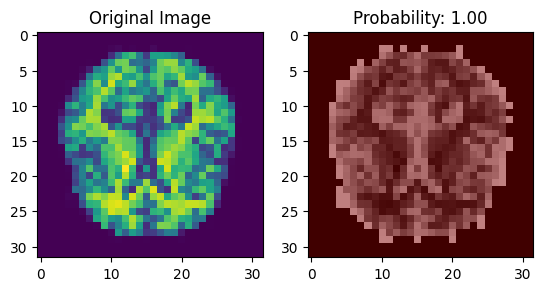

1/1 [==============================] - 0s 223ms/step


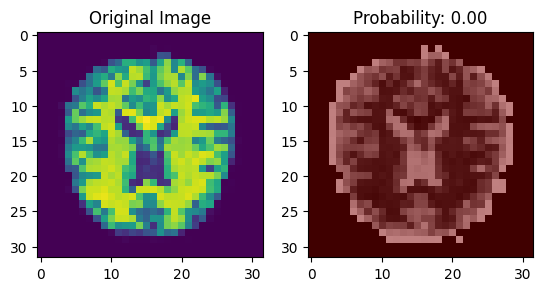

1/1 [==============================] - 0s 204ms/step


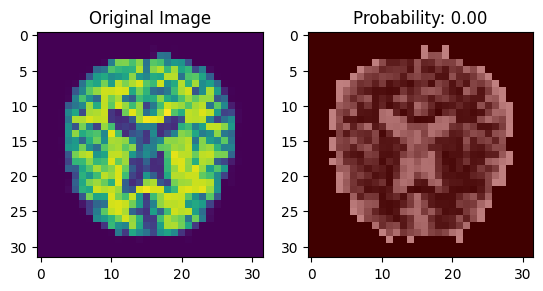

1/1 [==============================] - 0s 204ms/step


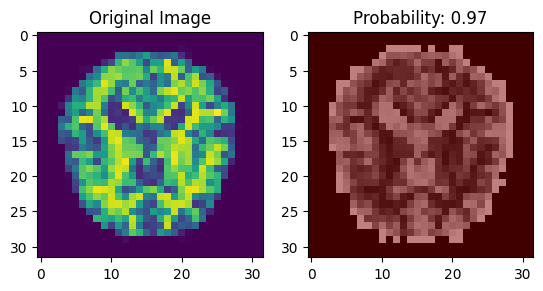

1/1 [==============================] - 0s 228ms/step


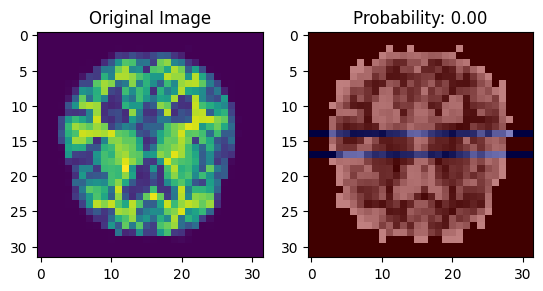

1/1 [==============================] - 0s 182ms/step


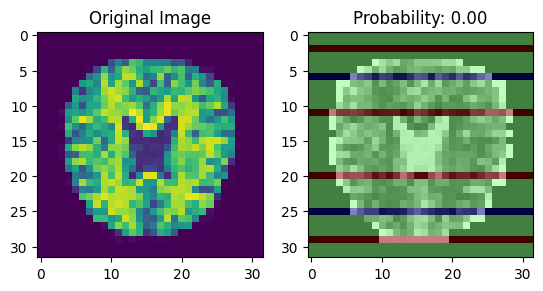

1/1 [==============================] - 0s 127ms/step


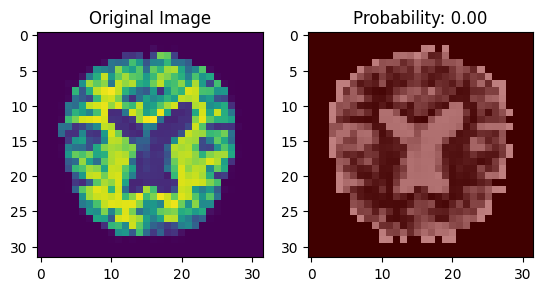

1/1 [==============================] - 0s 140ms/step


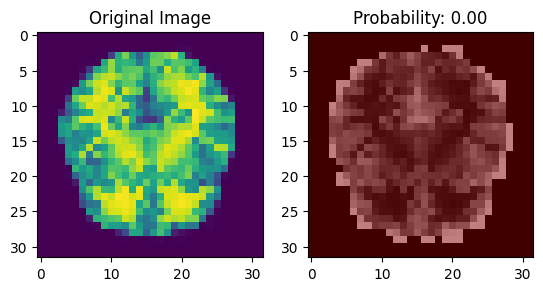

1/1 [==============================] - 0s 129ms/step


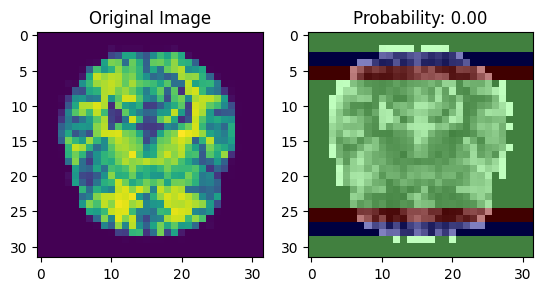

1/1 [==============================] - 0s 149ms/step


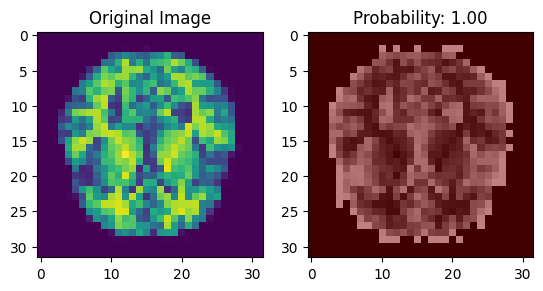

1/1 [==============================] - 0s 131ms/step


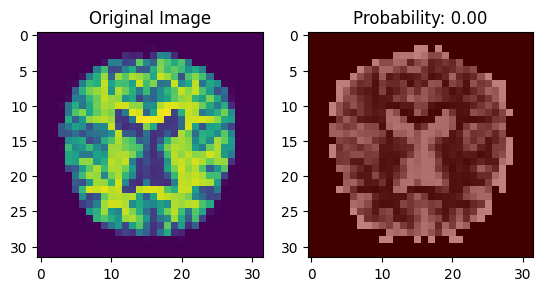

1/1 [==============================] - 0s 138ms/step


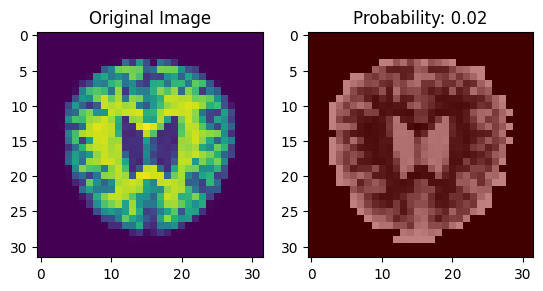

1/1 [==============================] - 0s 142ms/step


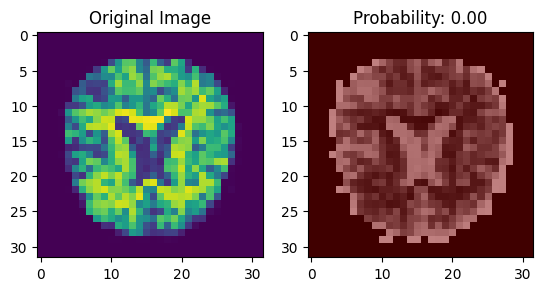

1/1 [==============================] - 0s 128ms/step


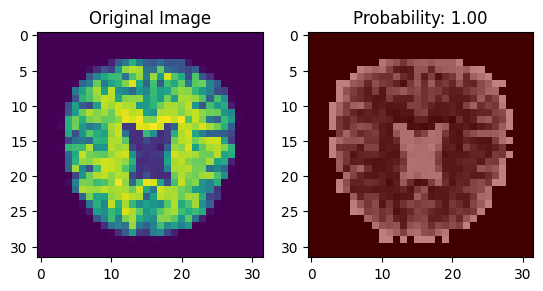

1/1 [==============================] - 0s 158ms/step


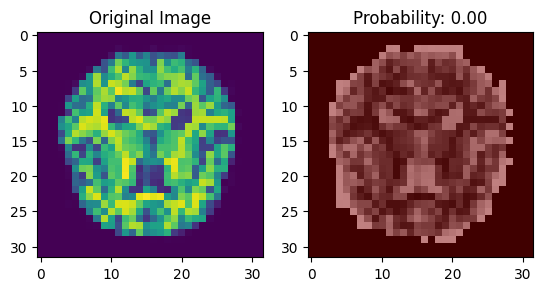

1/1 [==============================] - 0s 129ms/step


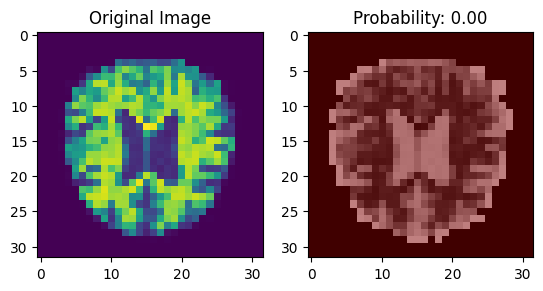

1/1 [==============================] - 0s 139ms/step


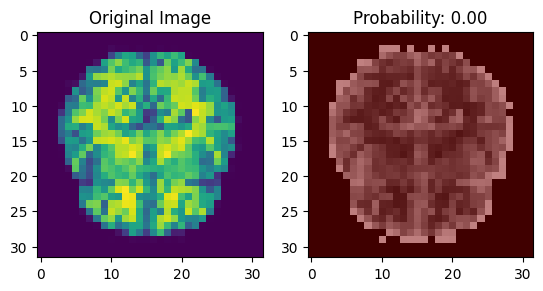

1/1 [==============================] - 0s 131ms/step


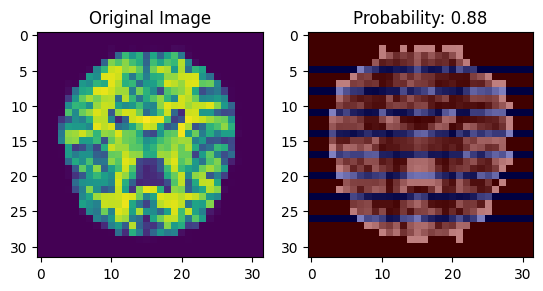

1/1 [==============================] - 0s 136ms/step


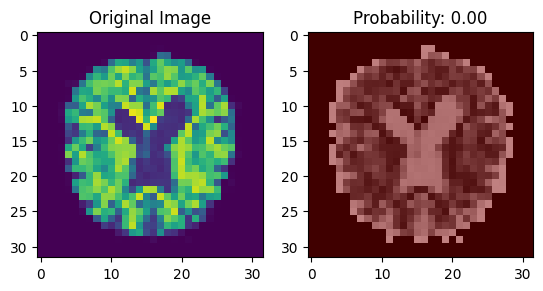

1/1 [==============================] - 0s 178ms/step


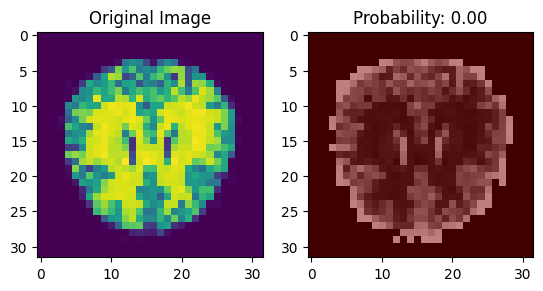

1/1 [==============================] - 0s 188ms/step


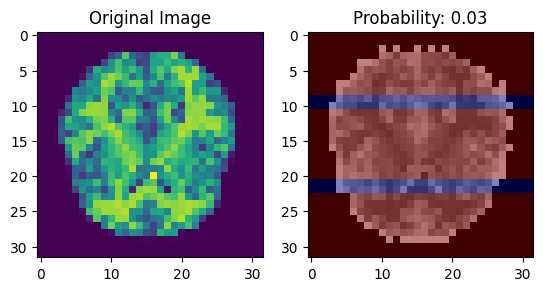

1/1 [==============================] - 0s 227ms/step


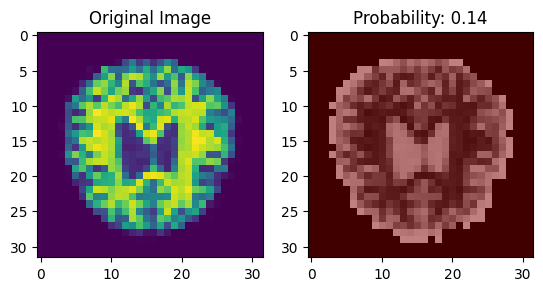

1/1 [==============================] - 0s 192ms/step


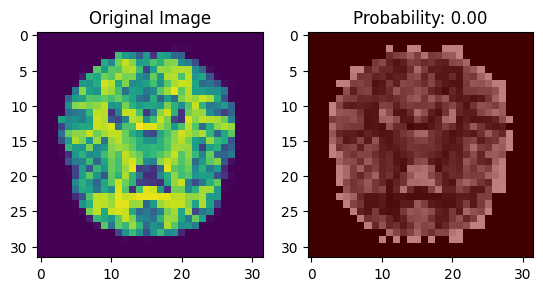

1/1 [==============================] - 0s 154ms/step


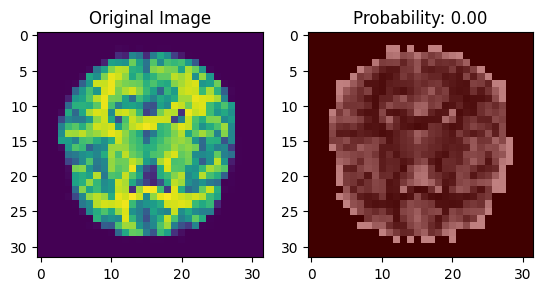

1/1 [==============================] - 0s 142ms/step


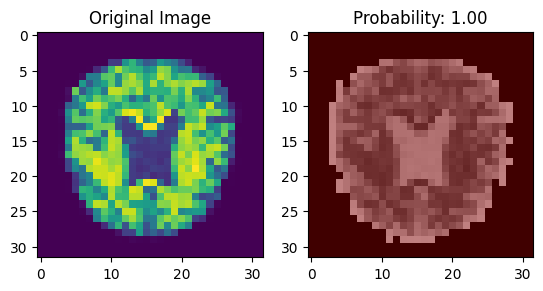

1/1 [==============================] - 0s 148ms/step


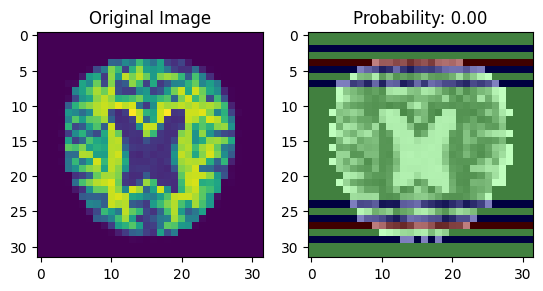

1/1 [==============================] - 0s 131ms/step


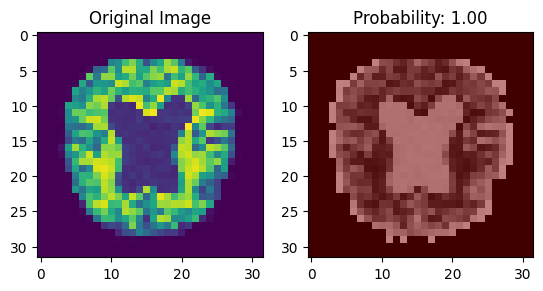

1/1 [==============================] - 0s 152ms/step


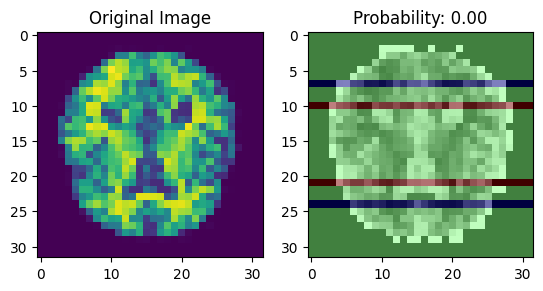

1/1 [==============================] - 0s 127ms/step


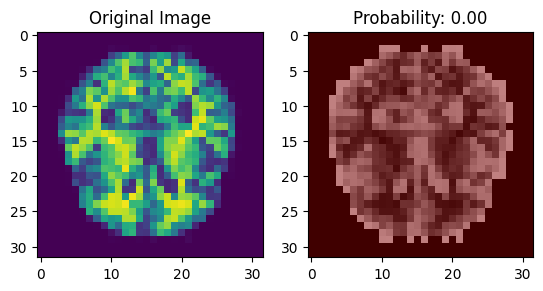

1/1 [==============================] - 0s 141ms/step


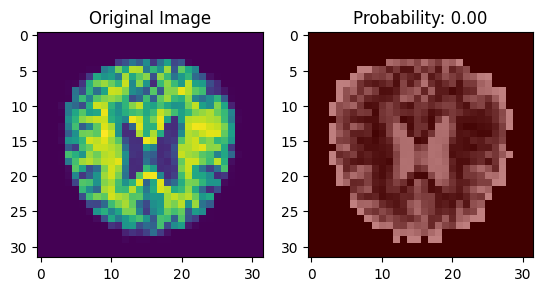

1/1 [==============================] - 0s 141ms/step


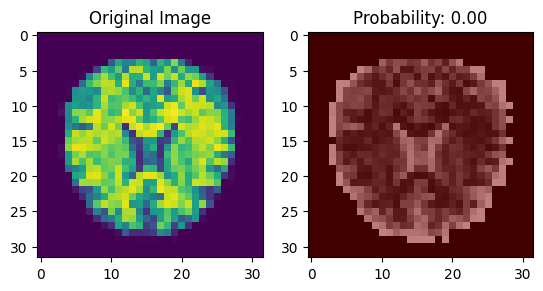

1/1 [==============================] - 0s 138ms/step


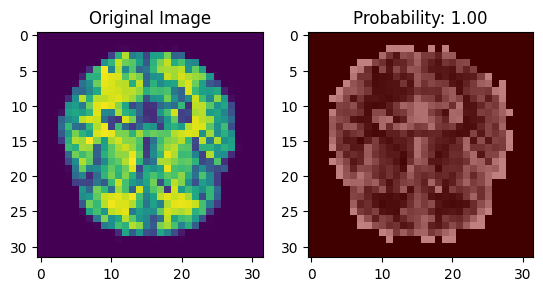

1/1 [==============================] - 0s 133ms/step


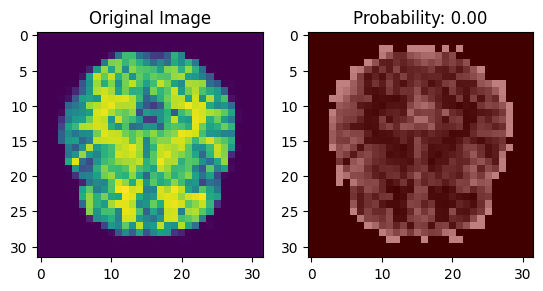

1/1 [==============================] - 0s 135ms/step


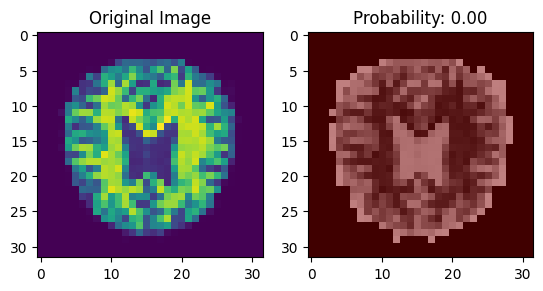

1/1 [==============================] - 0s 136ms/step


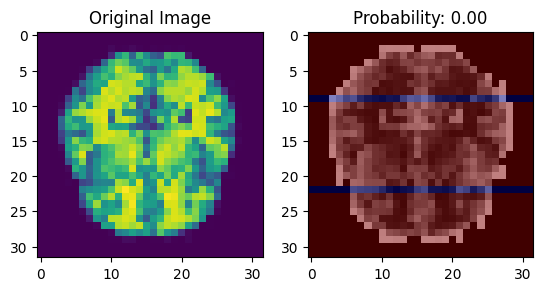

1/1 [==============================] - 0s 144ms/step


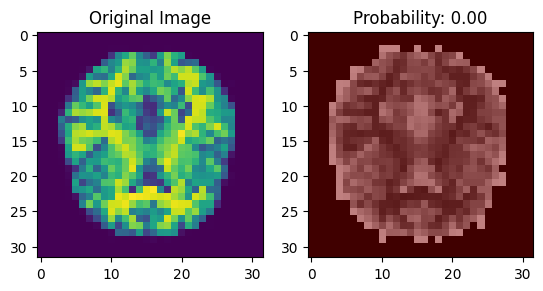

1/1 [==============================] - 0s 224ms/step


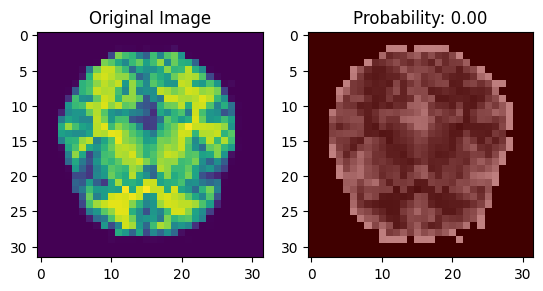

1/1 [==============================] - 0s 184ms/step


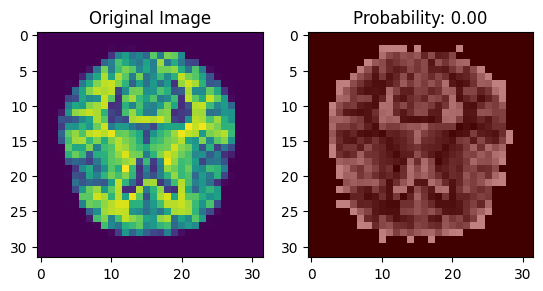

1/1 [==============================] - 0s 190ms/step


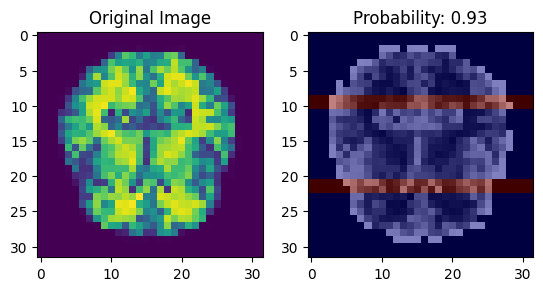

1/1 [==============================] - 0s 170ms/step


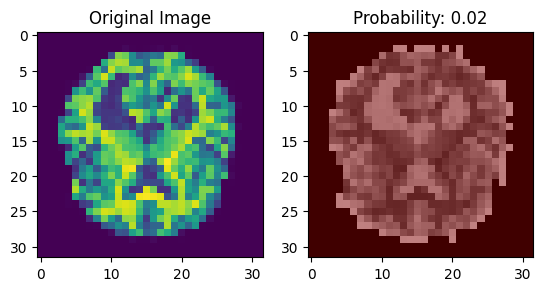

1/1 [==============================] - 0s 211ms/step


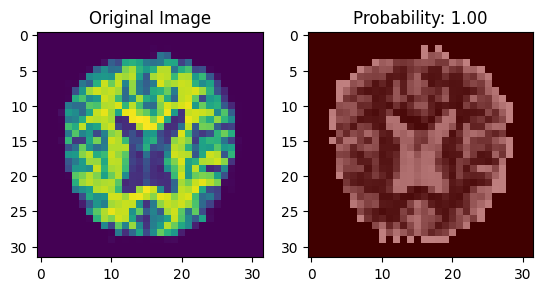

1/1 [==============================] - 0s 170ms/step


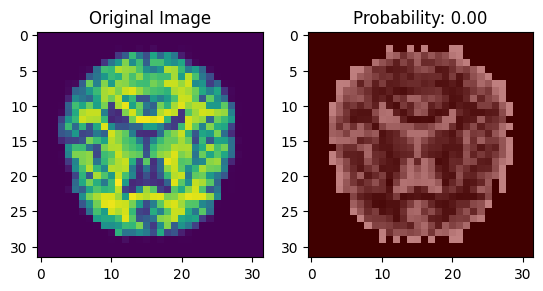

1/1 [==============================] - 0s 144ms/step


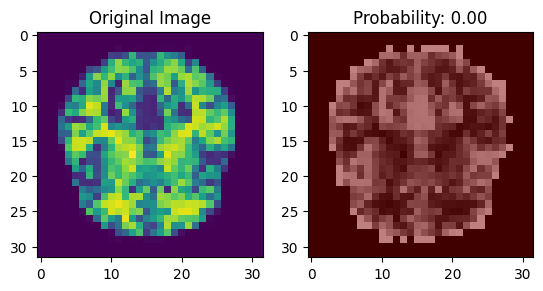

1/1 [==============================] - 0s 149ms/step


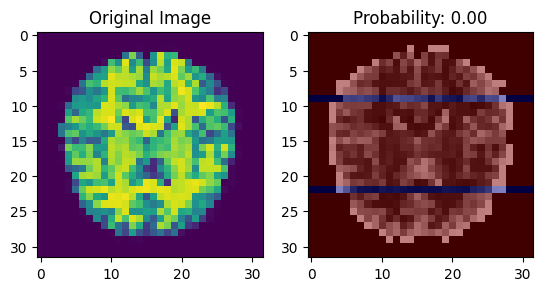

1/1 [==============================] - 0s 131ms/step


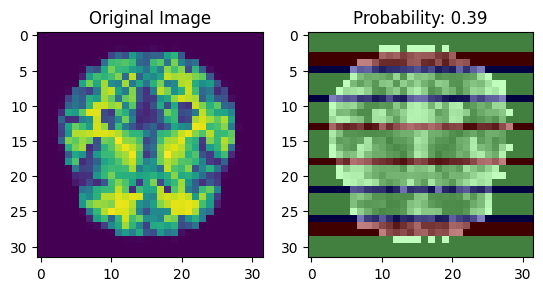

1/1 [==============================] - 0s 142ms/step


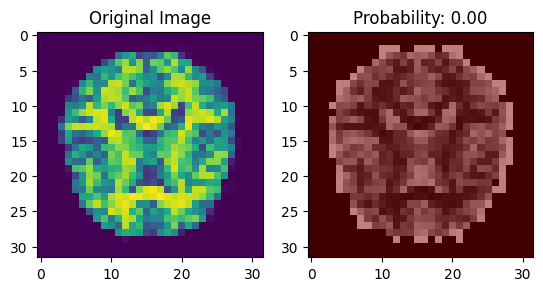

1/1 [==============================] - 0s 150ms/step


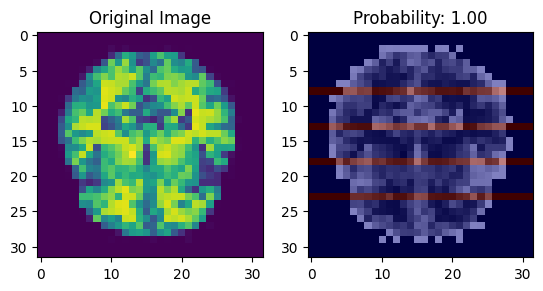

1/1 [==============================] - 0s 178ms/step


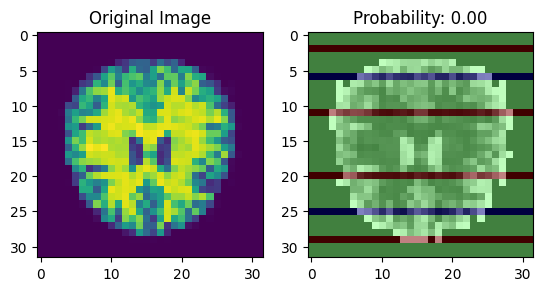

1/1 [==============================] - 0s 143ms/step


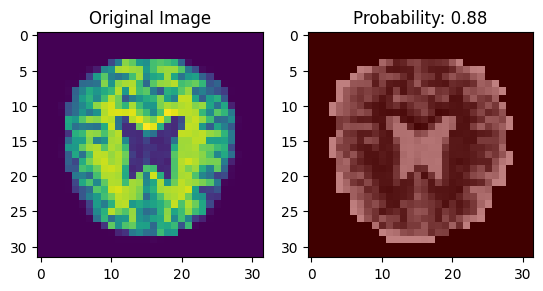

1/1 [==============================] - 0s 127ms/step


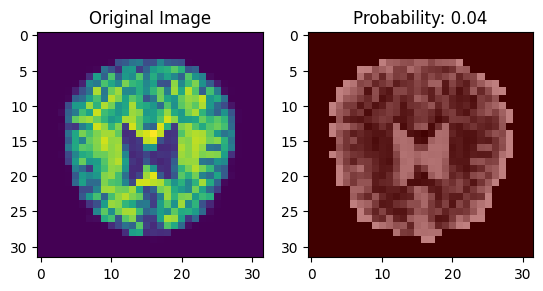

1/1 [==============================] - 0s 150ms/step


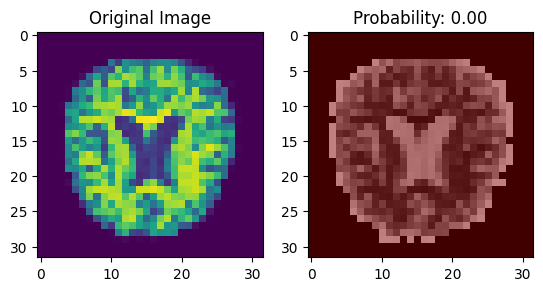

1/1 [==============================] - 0s 143ms/step


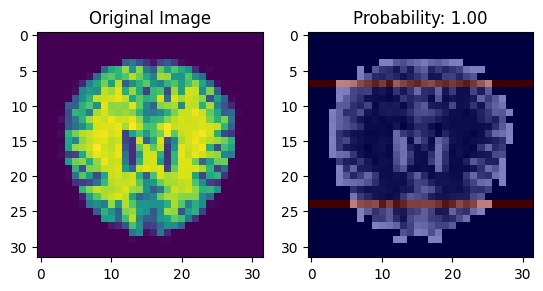

1/1 [==============================] - 0s 144ms/step


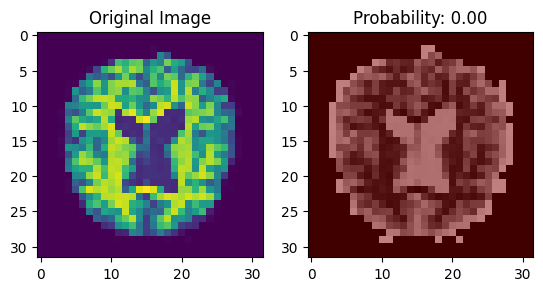

1/1 [==============================] - 0s 213ms/step


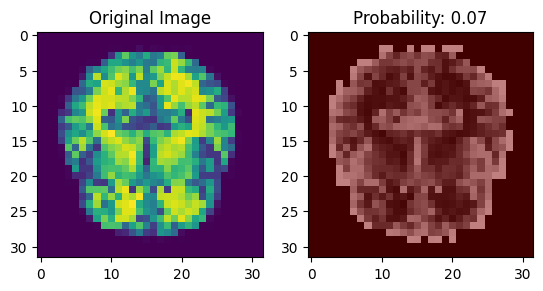

1/1 [==============================] - 0s 182ms/step


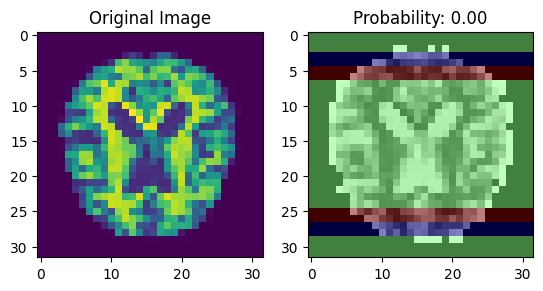

1/1 [==============================] - 0s 168ms/step


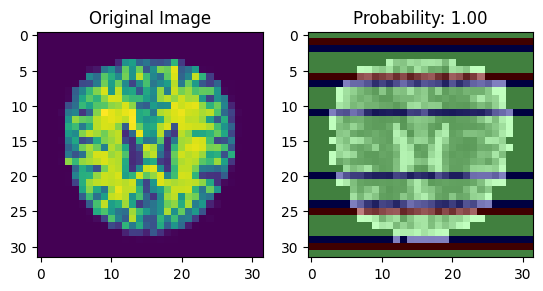

1/1 [==============================] - 0s 201ms/step


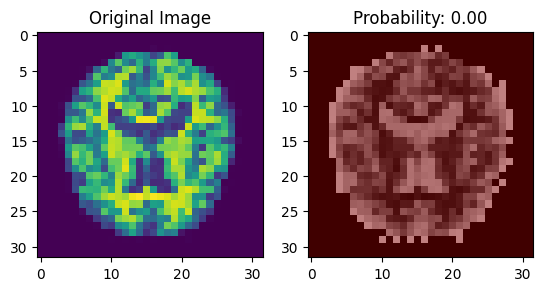

1/1 [==============================] - 0s 231ms/step


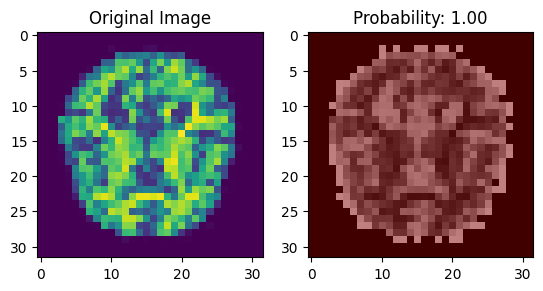

1/1 [==============================] - 0s 136ms/step


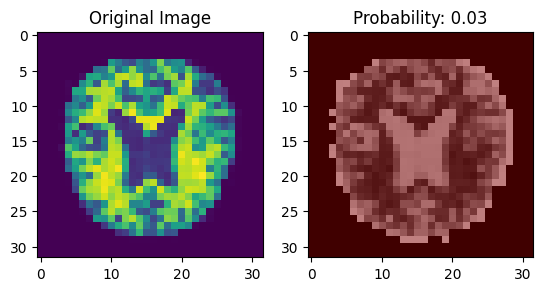

1/1 [==============================] - 0s 134ms/step


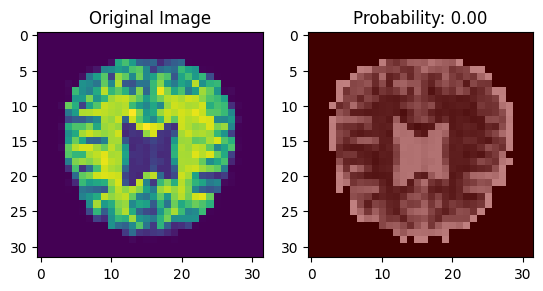

1/1 [==============================] - 0s 144ms/step


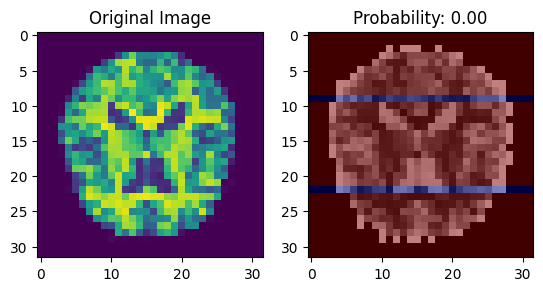

1/1 [==============================] - 0s 145ms/step


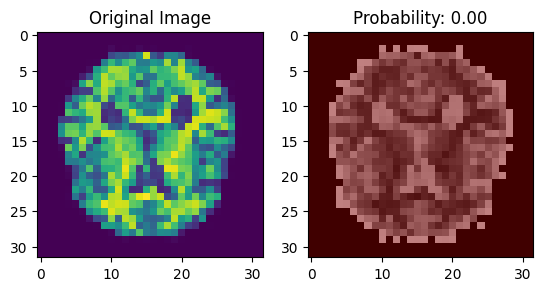

1/1 [==============================] - 0s 174ms/step


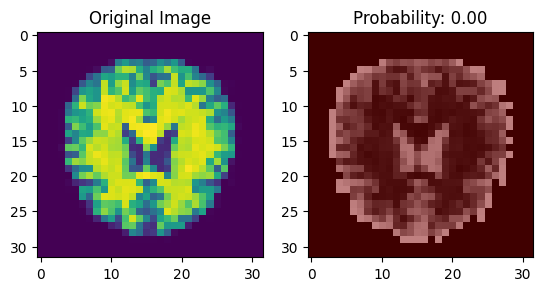

1/1 [==============================] - 0s 168ms/step


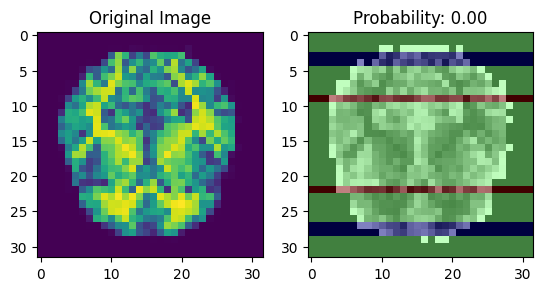

1/1 [==============================] - 0s 182ms/step


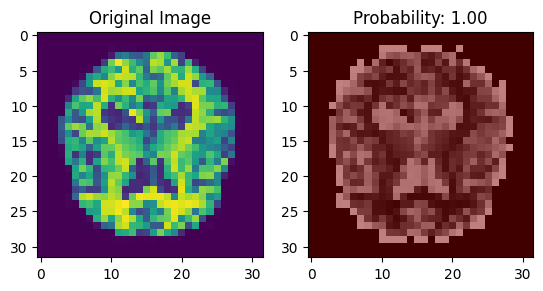

1/1 [==============================] - 0s 158ms/step


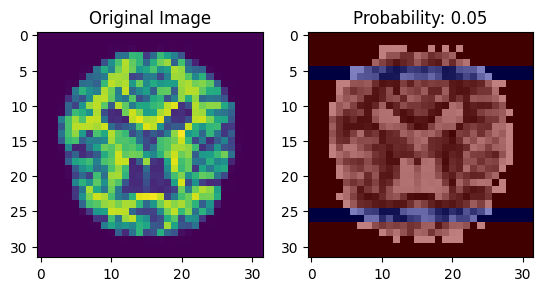

1/1 [==============================] - 0s 156ms/step


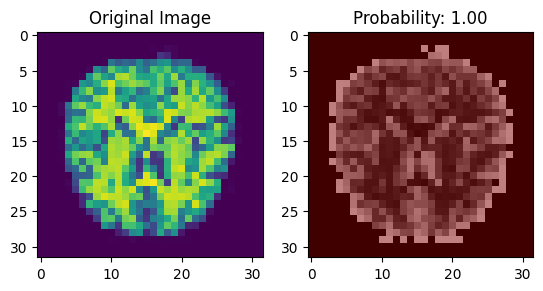

1/1 [==============================] - 0s 156ms/step


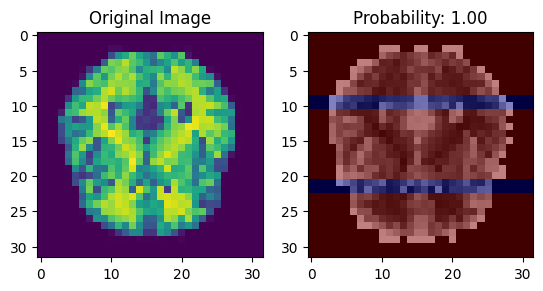

1/1 [==============================] - 0s 157ms/step


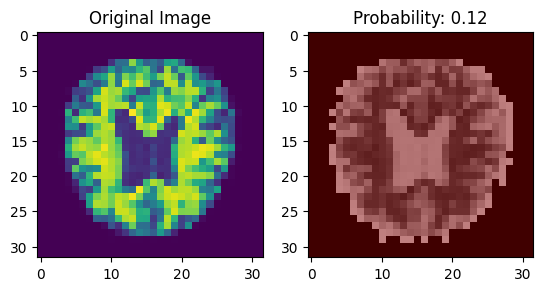

1/1 [==============================] - 0s 147ms/step


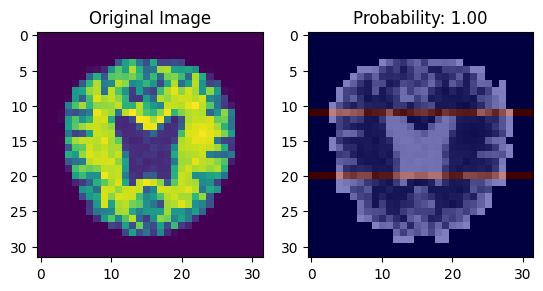

1/1 [==============================] - 0s 184ms/step


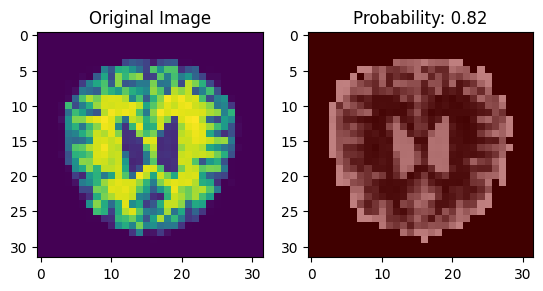

1/1 [==============================] - 0s 168ms/step


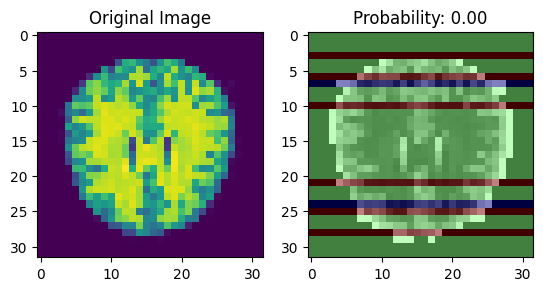

1/1 [==============================] - 0s 198ms/step


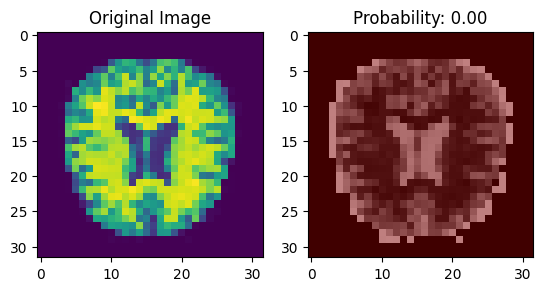

1/1 [==============================] - 0s 230ms/step


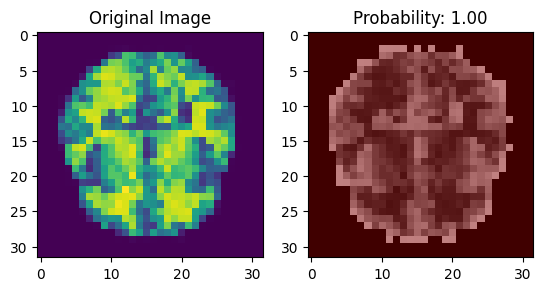

1/1 [==============================] - 0s 189ms/step


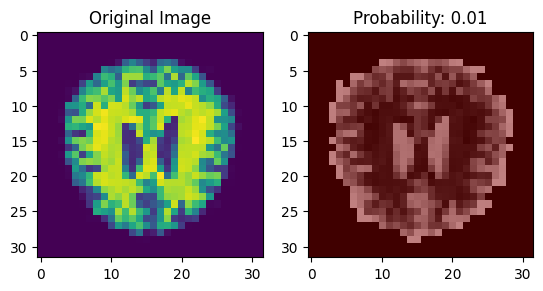

1/1 [==============================] - 0s 149ms/step


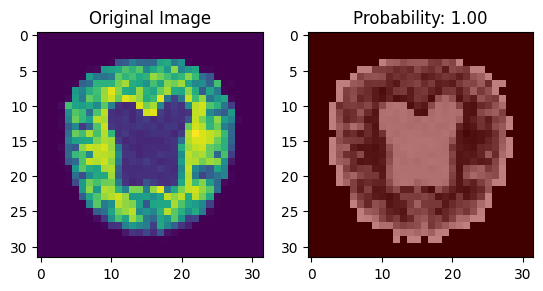

1/1 [==============================] - 0s 154ms/step


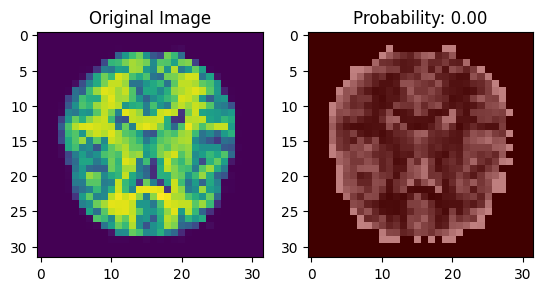

1/1 [==============================] - 0s 175ms/step


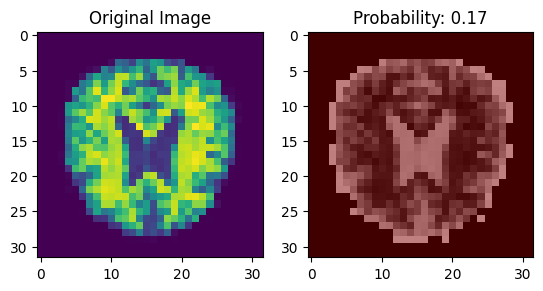

1/1 [==============================] - 0s 147ms/step


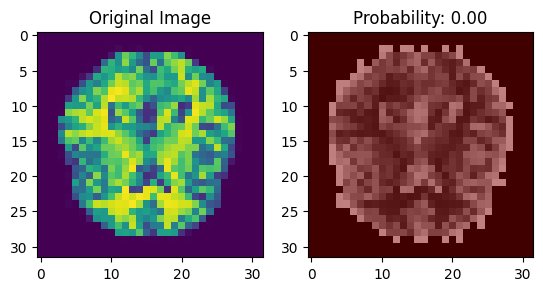

1/1 [==============================] - 0s 152ms/step


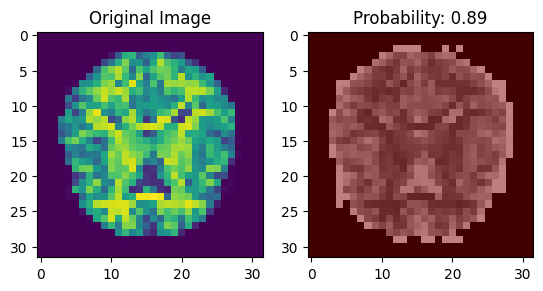

1/1 [==============================] - 0s 155ms/step


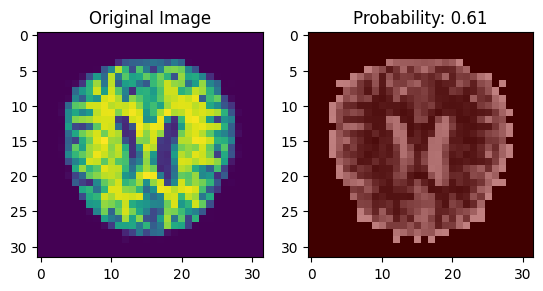

1/1 [==============================] - 0s 184ms/step


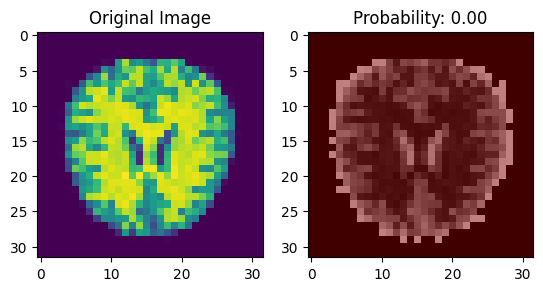

1/1 [==============================] - 0s 204ms/step


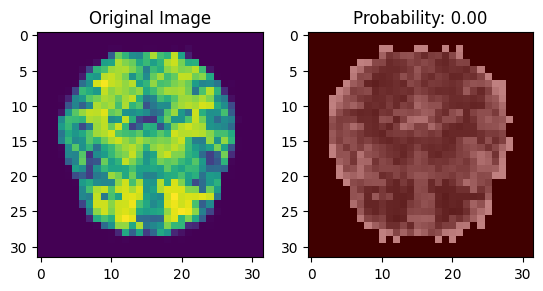

1/1 [==============================] - 0s 158ms/step


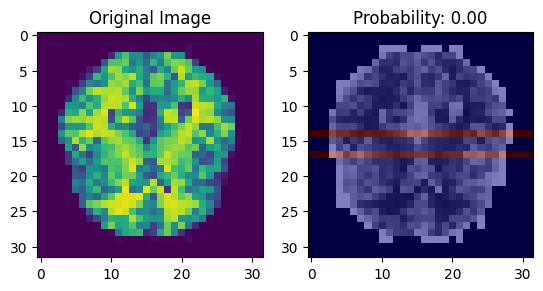

1/1 [==============================] - 0s 154ms/step


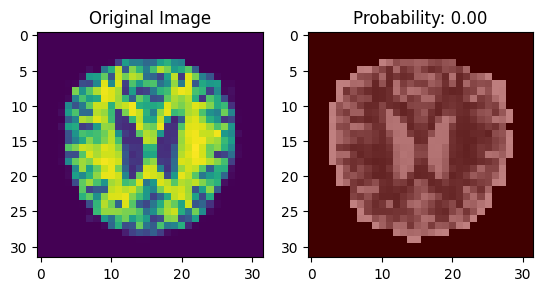

1/1 [==============================] - 0s 167ms/step


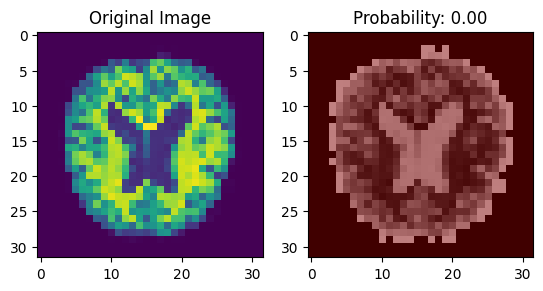

1/1 [==============================] - 0s 165ms/step


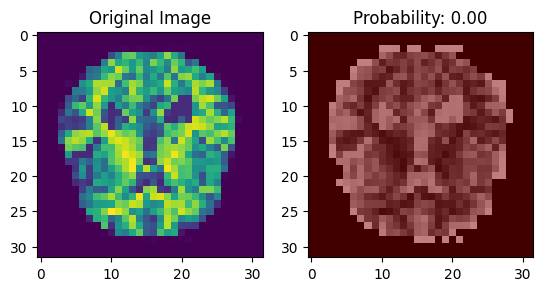

1/1 [==============================] - 0s 180ms/step


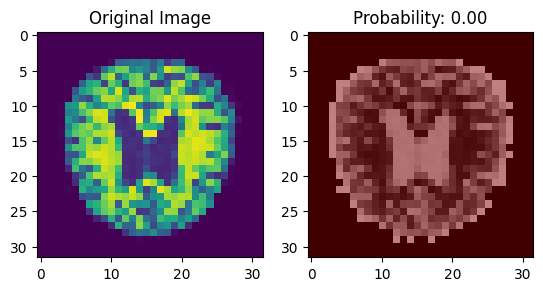

1/1 [==============================] - 0s 175ms/step


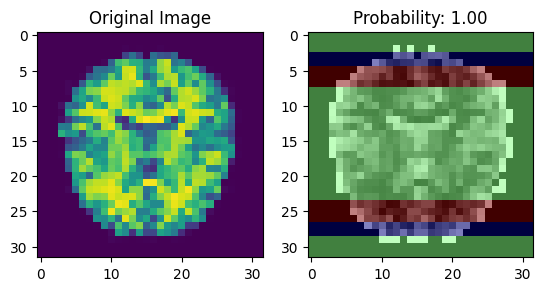

1/1 [==============================] - 0s 242ms/step


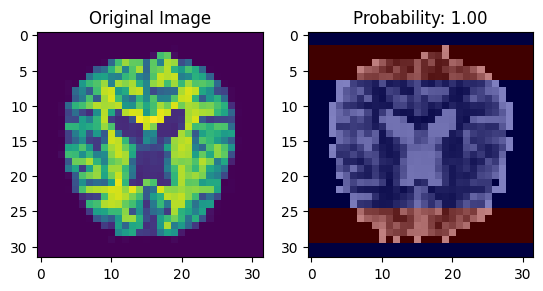

1/1 [==============================] - 0s 155ms/step


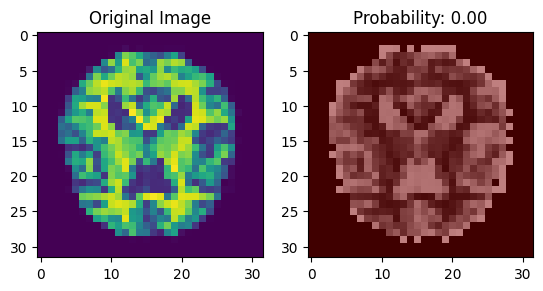

1/1 [==============================] - 0s 209ms/step


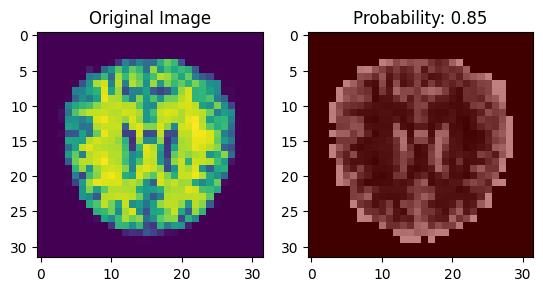

1/1 [==============================] - 0s 181ms/step


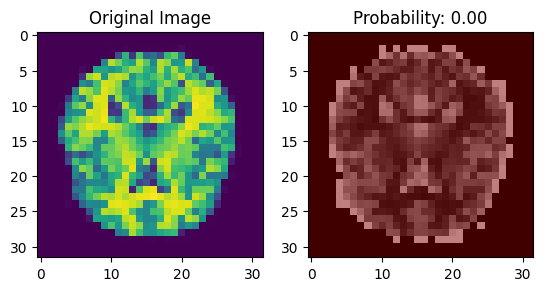

1/1 [==============================] - 0s 157ms/step


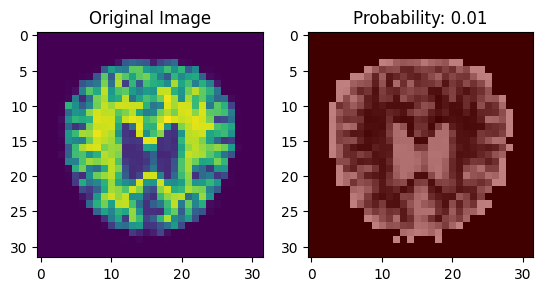

1/1 [==============================] - 0s 142ms/step


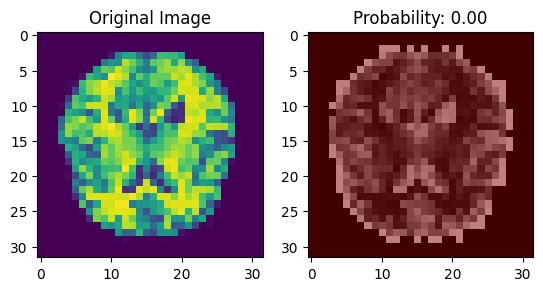

1/1 [==============================] - 0s 167ms/step


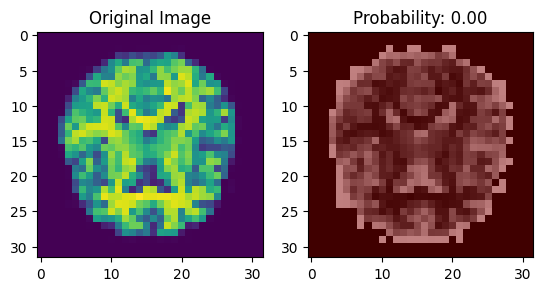

1/1 [==============================] - 0s 159ms/step


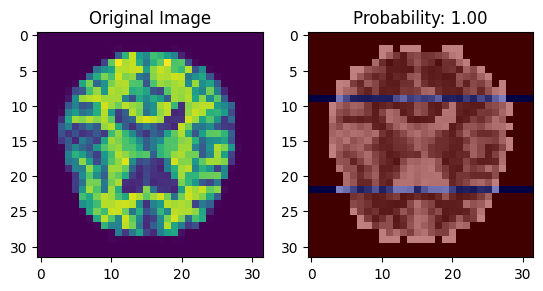

1/1 [==============================] - 0s 147ms/step


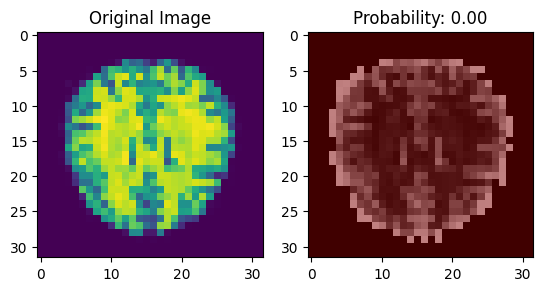

1/1 [==============================] - 0s 163ms/step


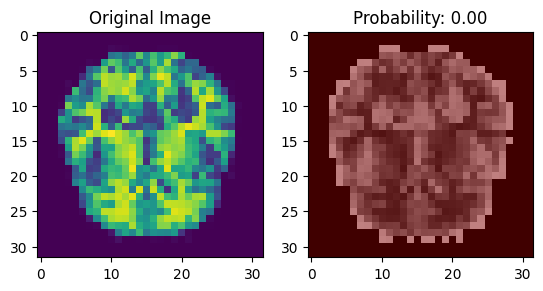

1/1 [==============================] - 0s 152ms/step


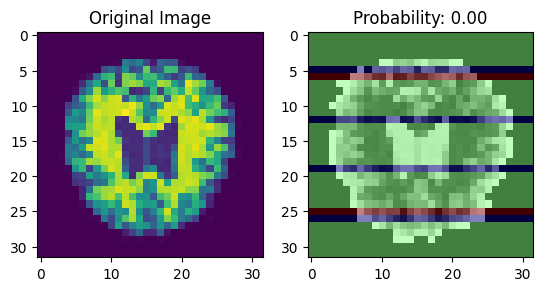

1/1 [==============================] - 0s 171ms/step


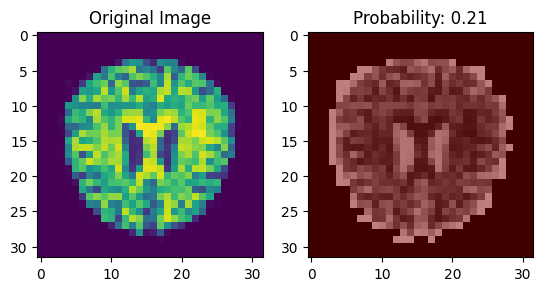

1/1 [==============================] - 0s 228ms/step


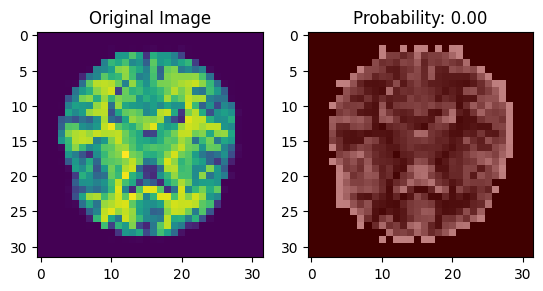

1/1 [==============================] - 0s 182ms/step


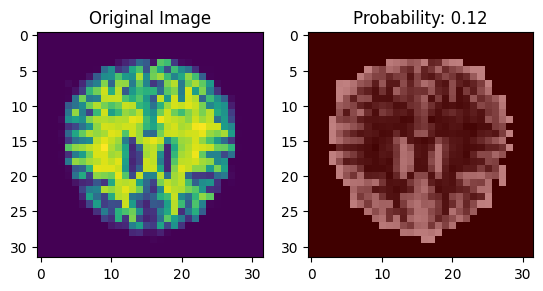

1/1 [==============================] - 0s 171ms/step


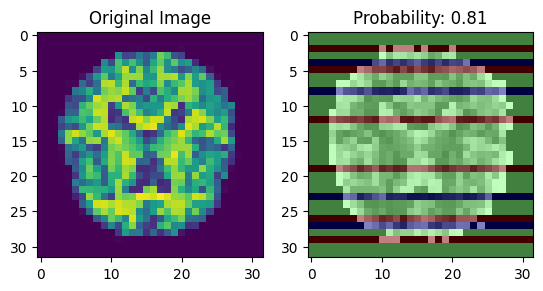

1/1 [==============================] - 0s 211ms/step


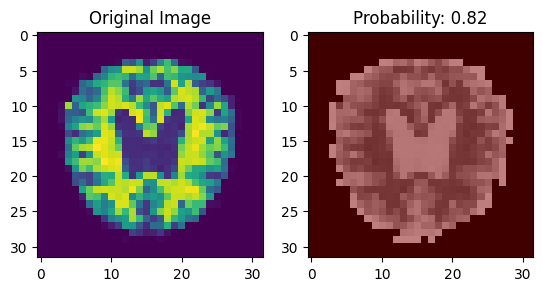

1/1 [==============================] - 0s 198ms/step


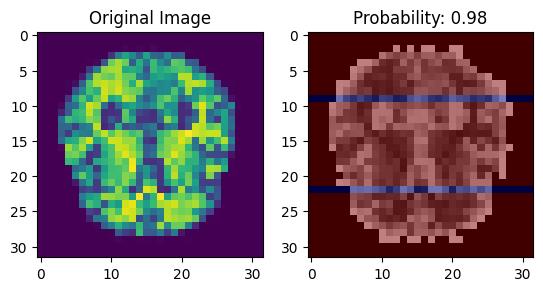

1/1 [==============================] - 0s 263ms/step


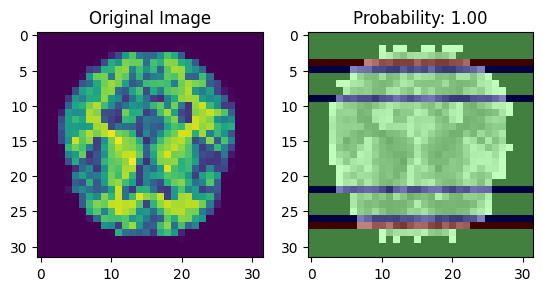

1/1 [==============================] - 0s 181ms/step


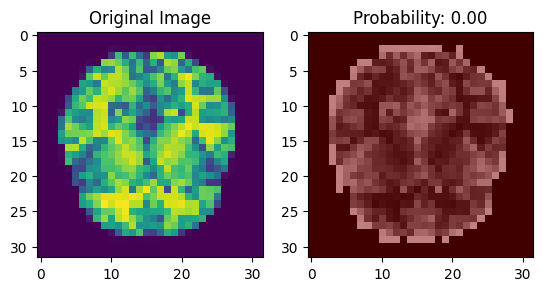

1/1 [==============================] - 0s 155ms/step


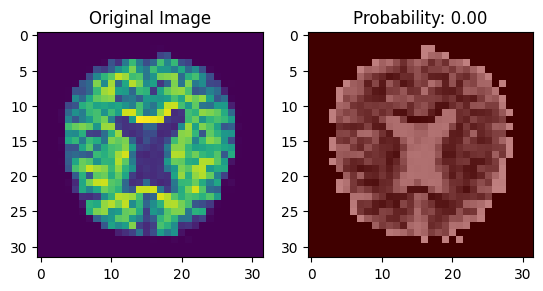

1/1 [==============================] - 0s 182ms/step


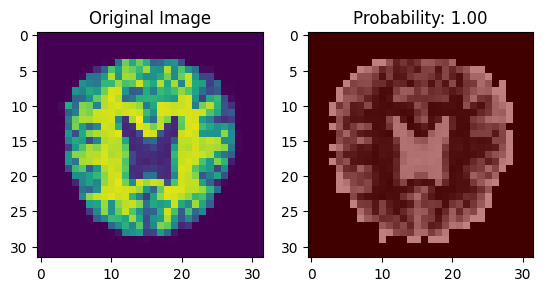

1/1 [==============================] - 0s 166ms/step


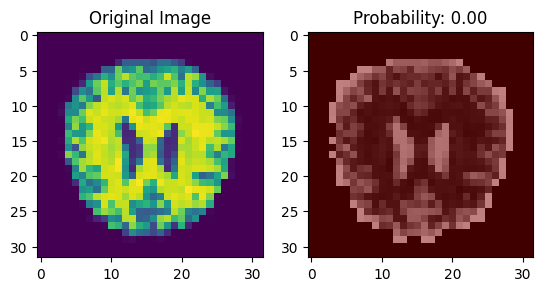

1/1 [==============================] - 0s 160ms/step


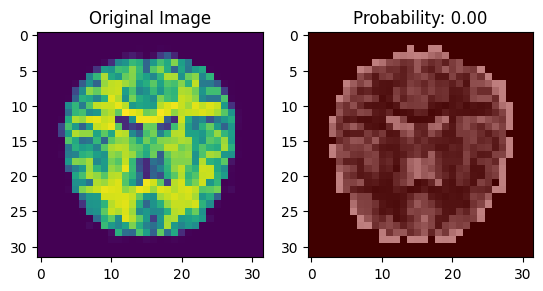

1/1 [==============================] - 0s 166ms/step


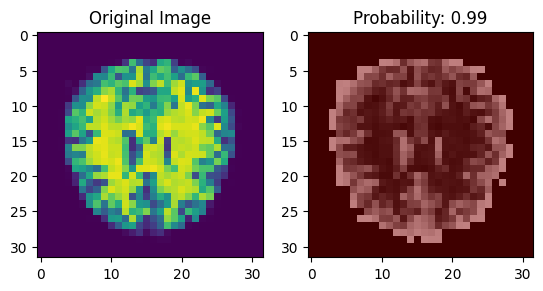

1/1 [==============================] - 0s 153ms/step


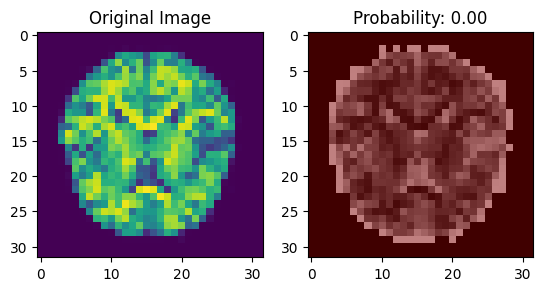

1/1 [==============================] - 0s 169ms/step


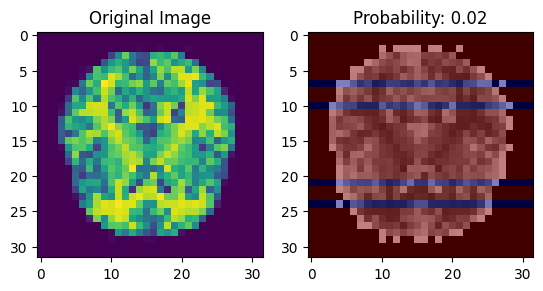

1/1 [==============================] - 0s 146ms/step


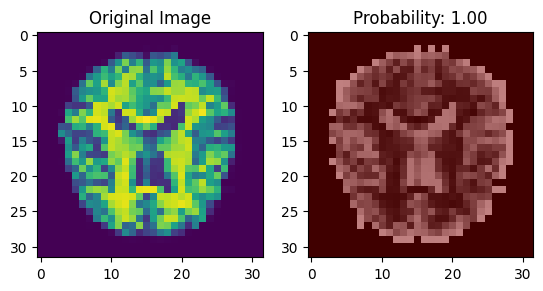

1/1 [==============================] - 0s 174ms/step


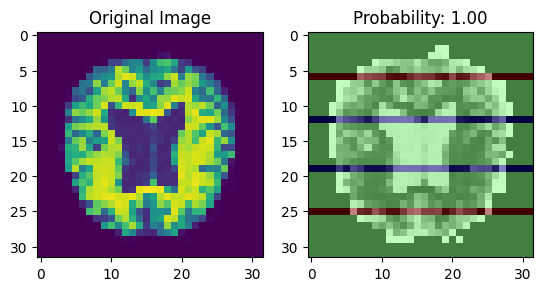

1/1 [==============================] - 0s 168ms/step


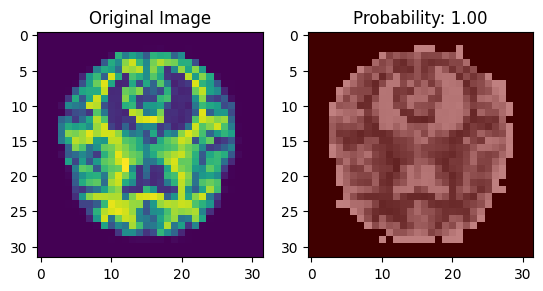

1/1 [==============================] - 0s 171ms/step


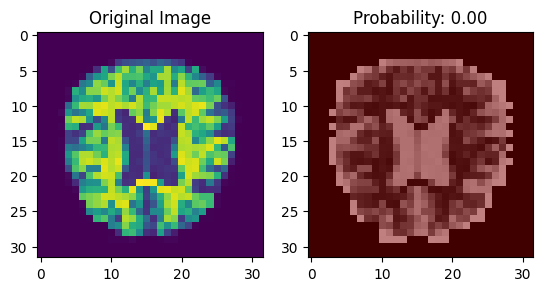

1/1 [==============================] - 0s 167ms/step


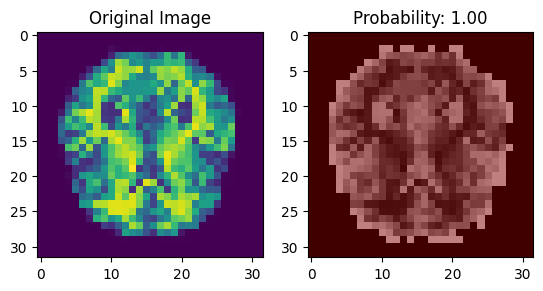

1/1 [==============================] - 0s 236ms/step


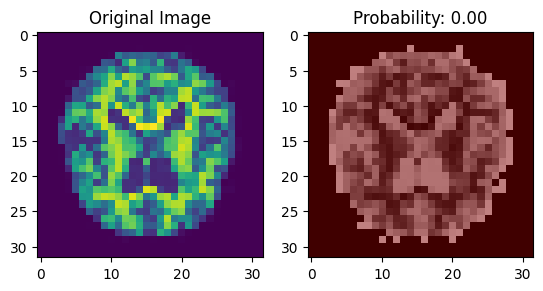

1/1 [==============================] - 0s 236ms/step


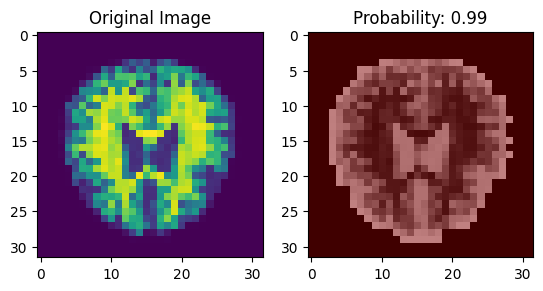

1/1 [==============================] - 0s 230ms/step


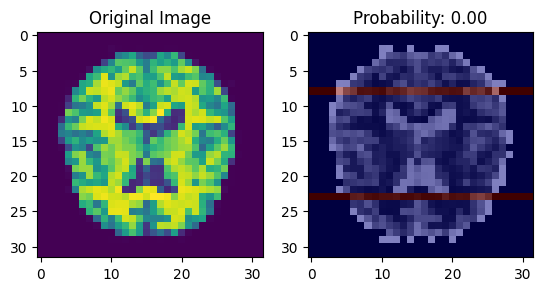

1/1 [==============================] - 0s 200ms/step


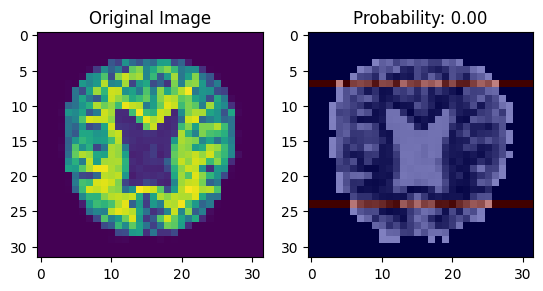

1/1 [==============================] - 0s 211ms/step


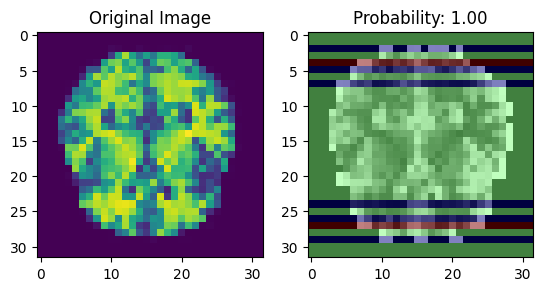

1/1 [==============================] - 0s 162ms/step


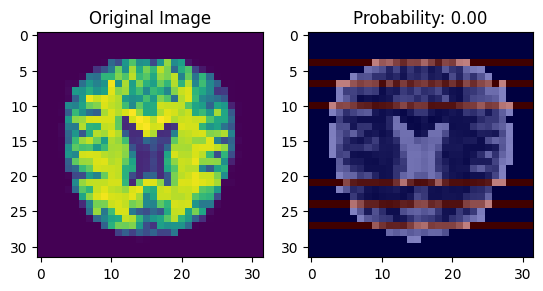

1/1 [==============================] - 0s 179ms/step


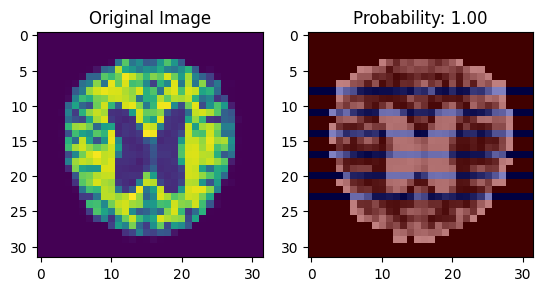

1/1 [==============================] - 0s 182ms/step


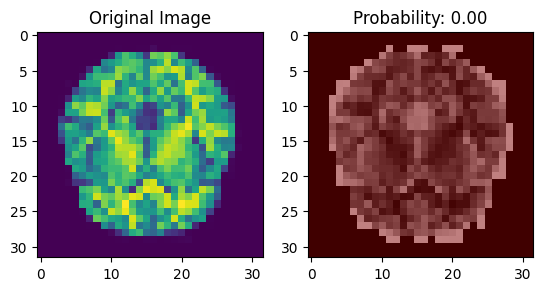

1/1 [==============================] - 0s 159ms/step


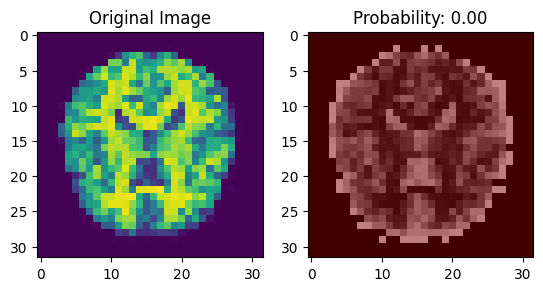

1/1 [==============================] - 0s 181ms/step


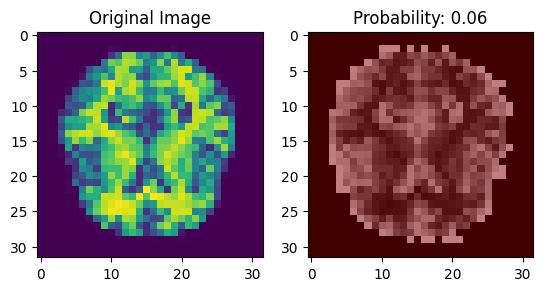

1/1 [==============================] - 0s 152ms/step


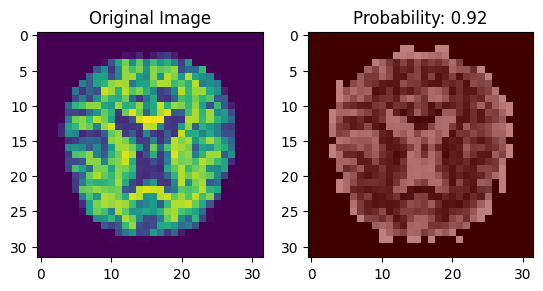

1/1 [==============================] - 0s 179ms/step


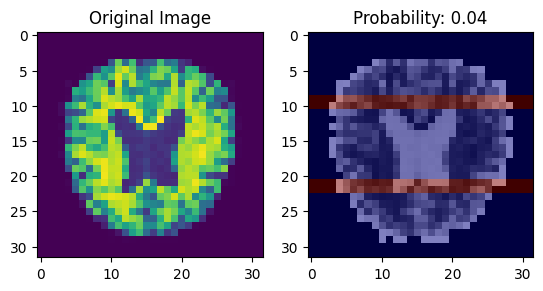

1/1 [==============================] - 0s 174ms/step


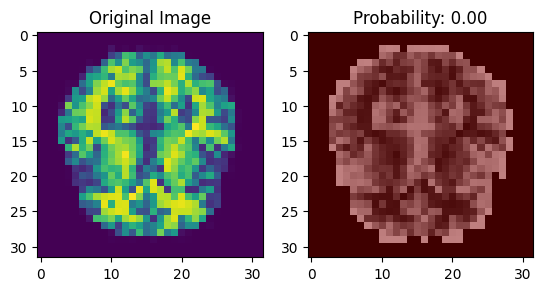

1/1 [==============================] - 0s 174ms/step


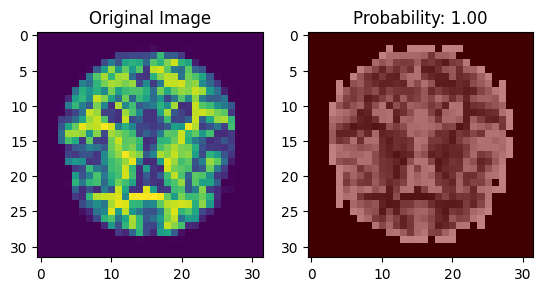

1/1 [==============================] - 0s 160ms/step


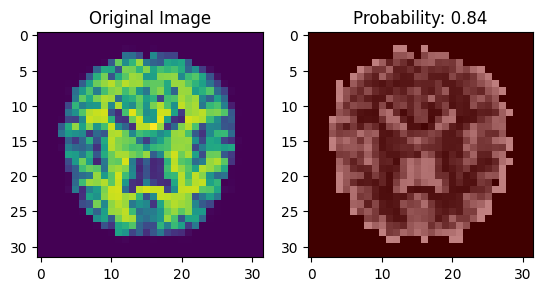

1/1 [==============================] - 0s 167ms/step


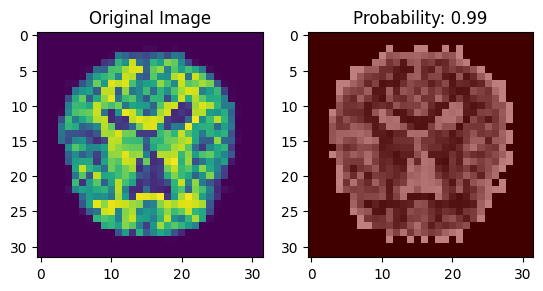

1/1 [==============================] - 0s 179ms/step


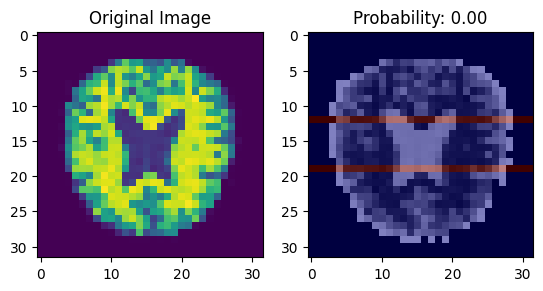

1/1 [==============================] - 0s 194ms/step


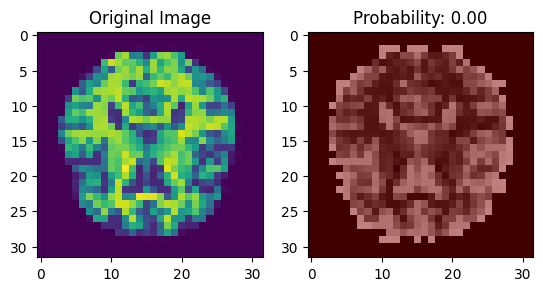

1/1 [==============================] - 0s 214ms/step


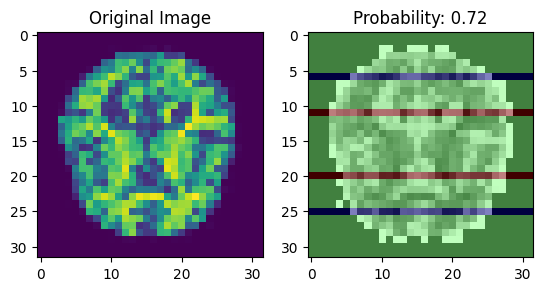

1/1 [==============================] - 0s 203ms/step


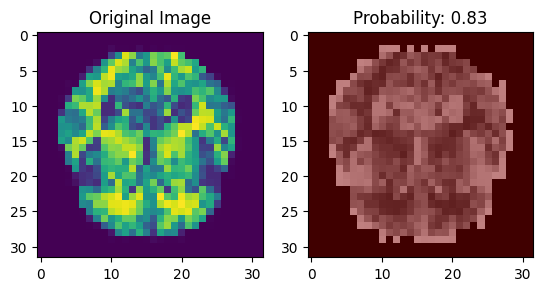

1/1 [==============================] - 0s 186ms/step


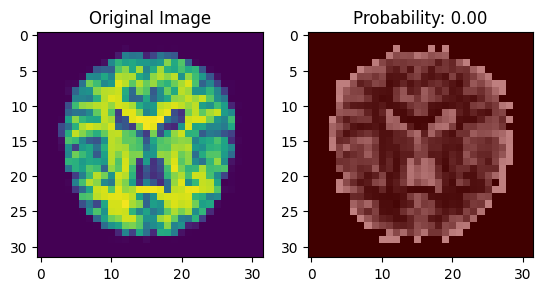

1/1 [==============================] - 0s 198ms/step


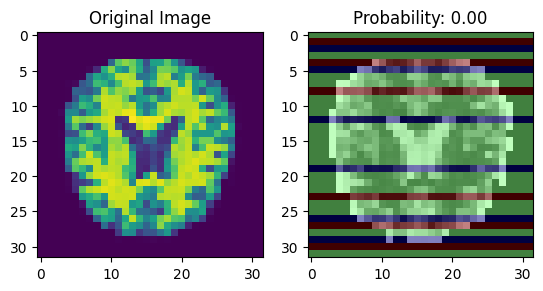

1/1 [==============================] - 0s 185ms/step


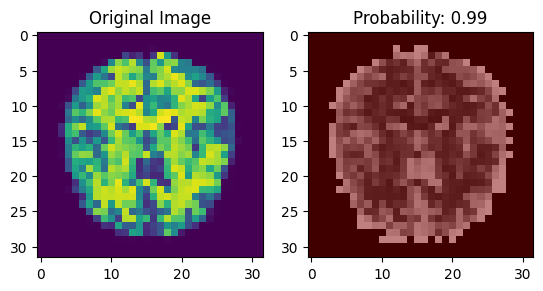

1/1 [==============================] - 0s 189ms/step


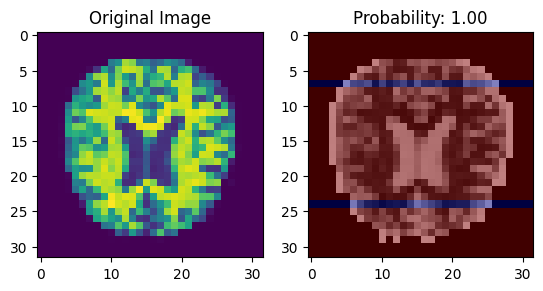

1/1 [==============================] - 0s 201ms/step


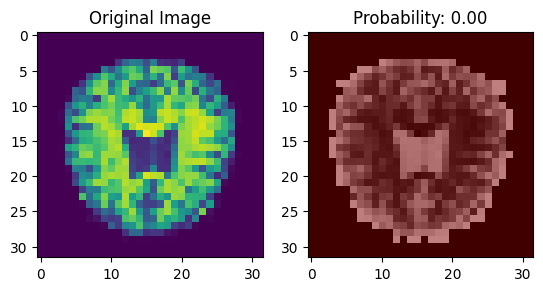

1/1 [==============================] - 0s 160ms/step


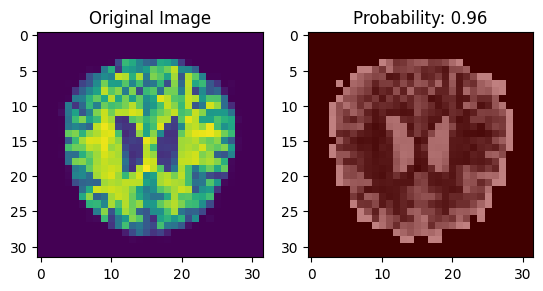

1/1 [==============================] - 0s 174ms/step


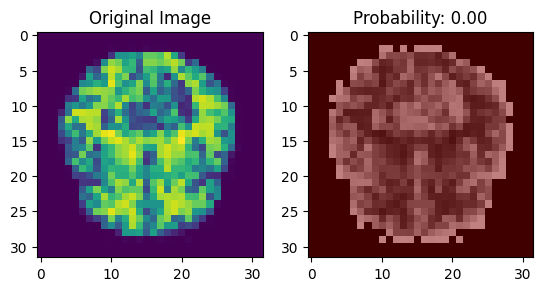

1/1 [==============================] - 0s 158ms/step


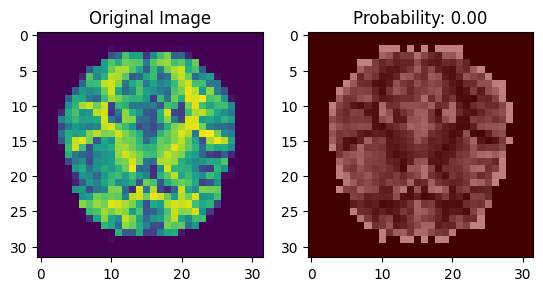

1/1 [==============================] - 0s 176ms/step


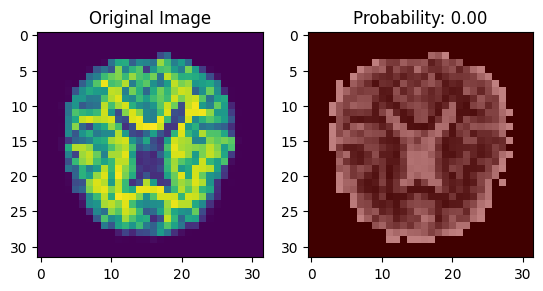

1/1 [==============================] - 0s 170ms/step


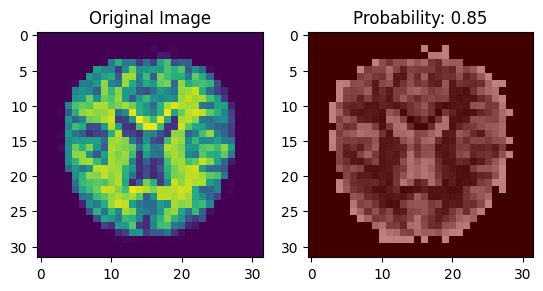

1/1 [==============================] - 0s 169ms/step


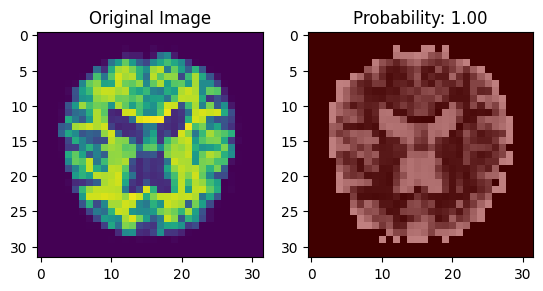

1/1 [==============================] - 0s 158ms/step


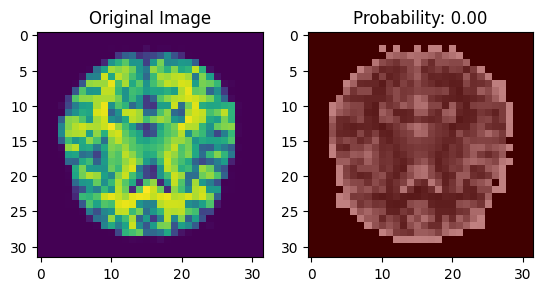

1/1 [==============================] - 0s 166ms/step


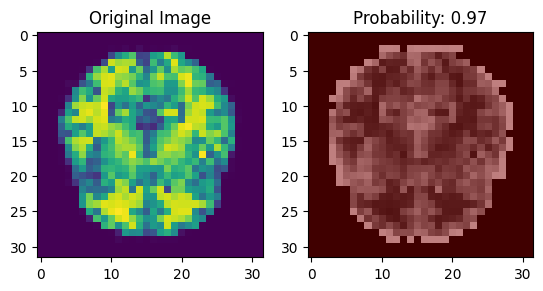

1/1 [==============================] - 0s 206ms/step


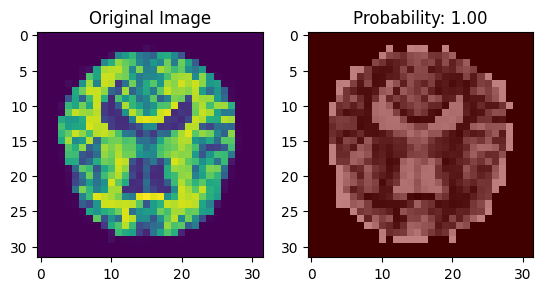

1/1 [==============================] - 0s 233ms/step


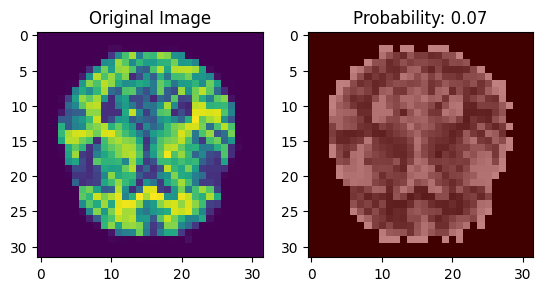

1/1 [==============================] - 0s 193ms/step


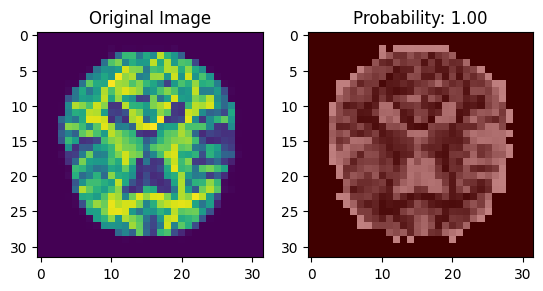

1/1 [==============================] - 0s 209ms/step


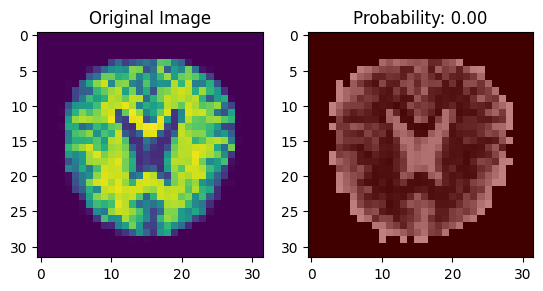

1/1 [==============================] - 0s 174ms/step


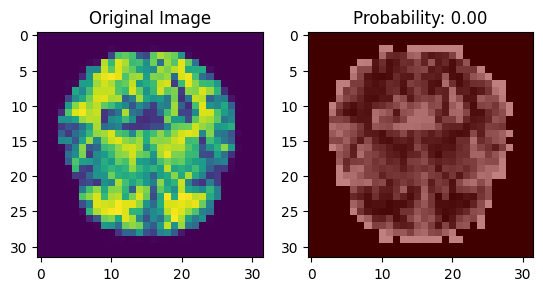

1/1 [==============================] - 0s 169ms/step


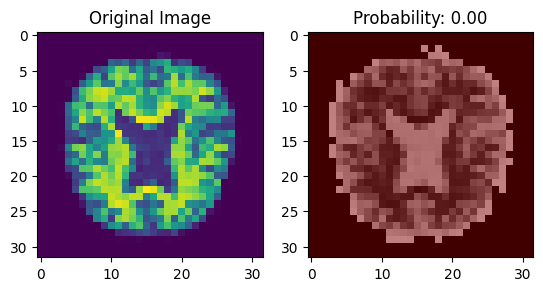

1/1 [==============================] - 0s 177ms/step


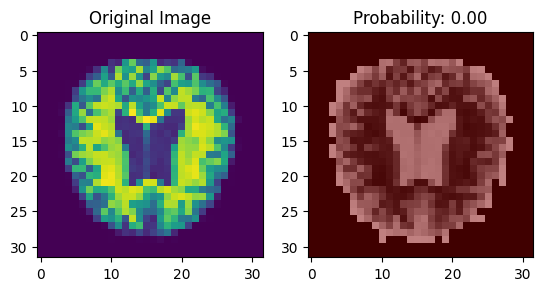

1/1 [==============================] - 0s 190ms/step


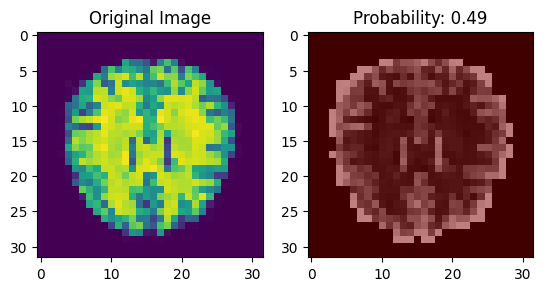

1/1 [==============================] - 0s 203ms/step


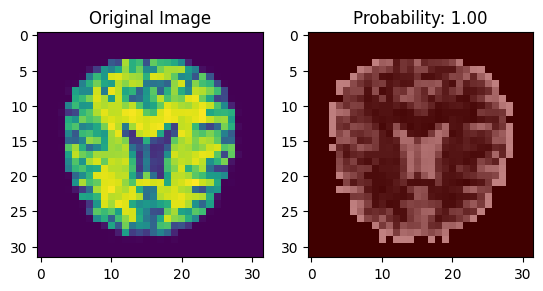

1/1 [==============================] - 0s 184ms/step


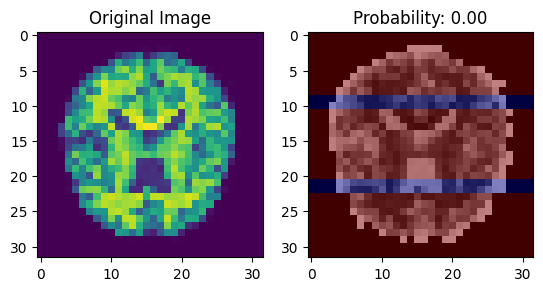

1/1 [==============================] - 0s 170ms/step


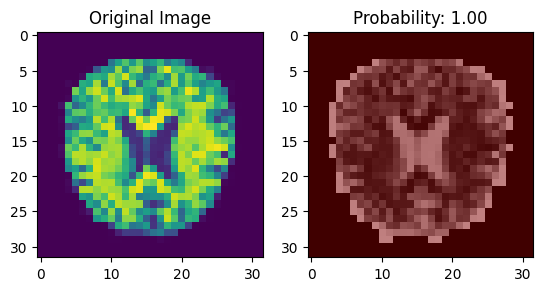

1/1 [==============================] - 0s 168ms/step


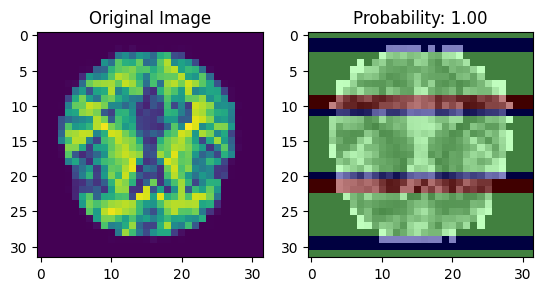

1/1 [==============================] - 0s 145ms/step


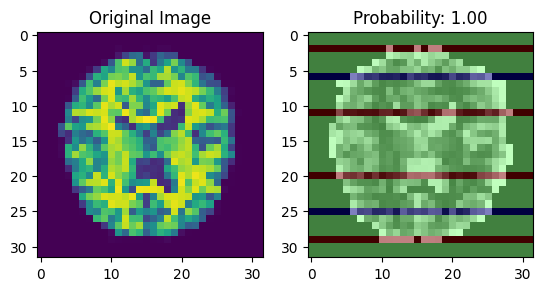

1/1 [==============================] - 0s 172ms/step


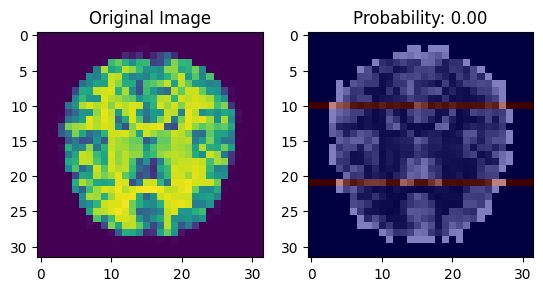

1/1 [==============================] - 0s 170ms/step


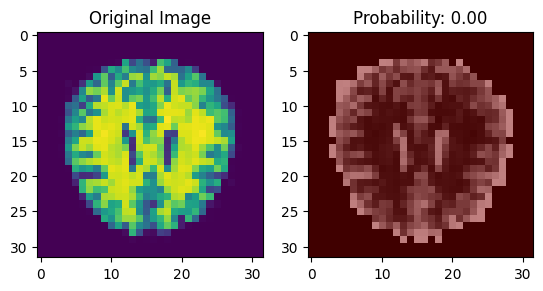

1/1 [==============================] - 0s 187ms/step


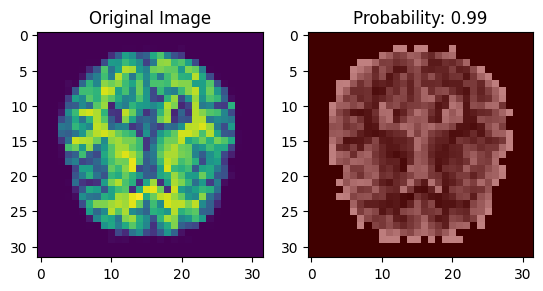

1/1 [==============================] - 0s 182ms/step


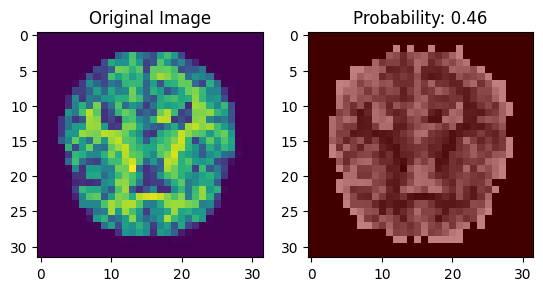

1/1 [==============================] - 0s 162ms/step


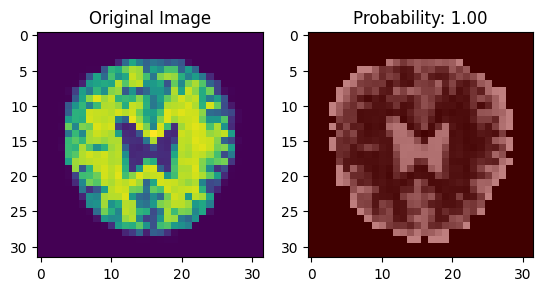

1/1 [==============================] - 0s 224ms/step


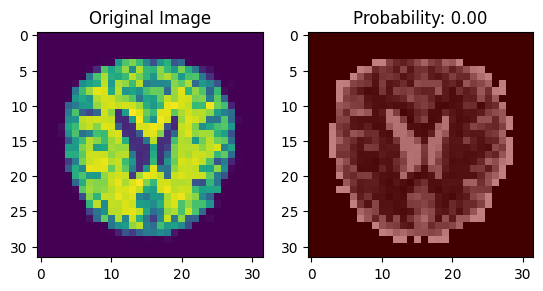

1/1 [==============================] - 0s 170ms/step


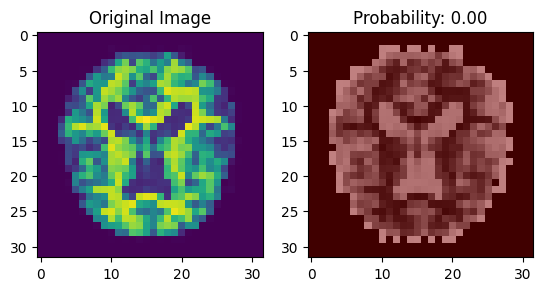

1/1 [==============================] - 0s 183ms/step


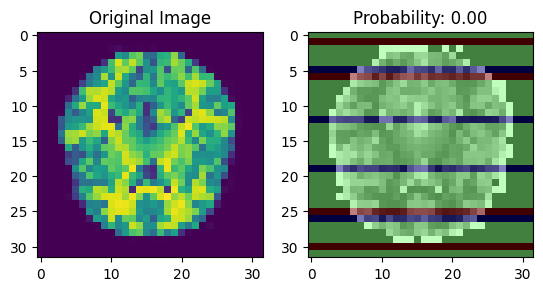

1/1 [==============================] - 0s 195ms/step


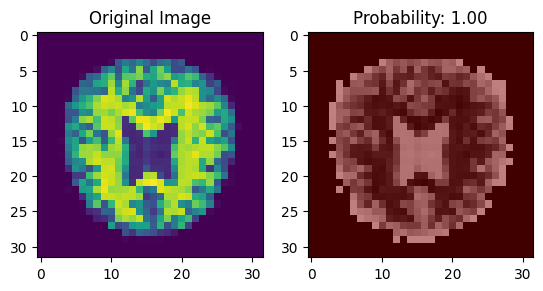

1/1 [==============================] - 0s 197ms/step


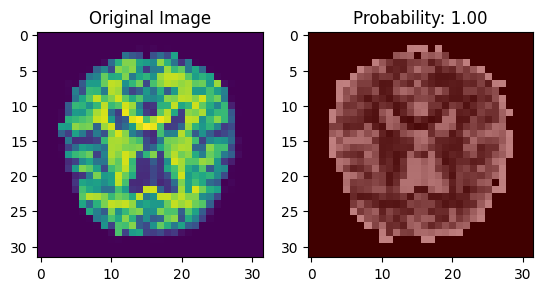

1/1 [==============================] - 0s 207ms/step


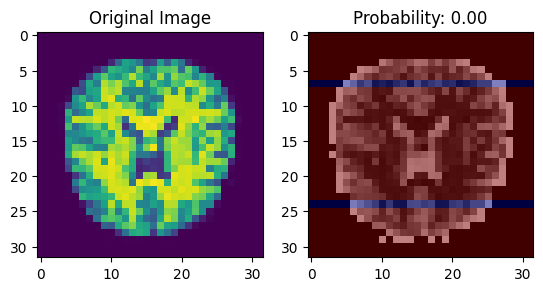

1/1 [==============================] - 0s 175ms/step


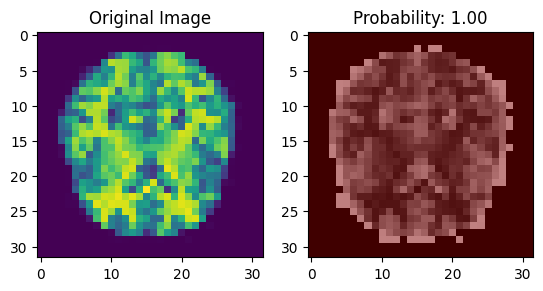

1/1 [==============================] - 0s 158ms/step


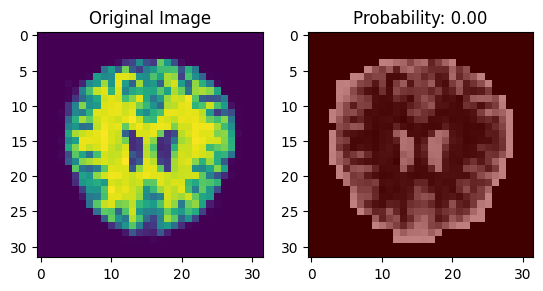

1/1 [==============================] - 0s 187ms/step


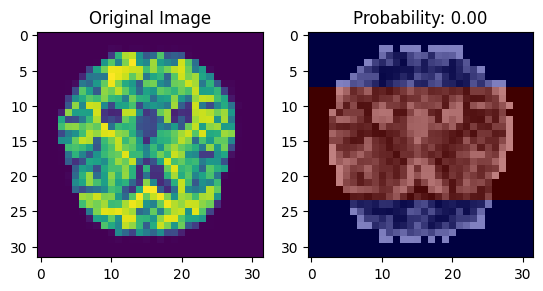

1/1 [==============================] - 0s 184ms/step


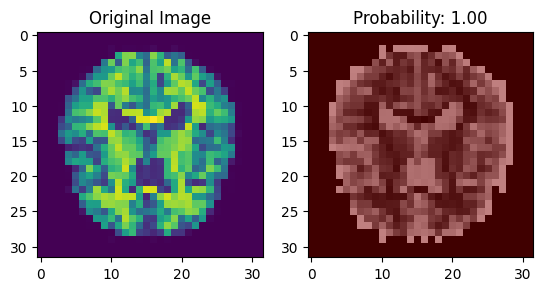

1/1 [==============================] - 0s 194ms/step


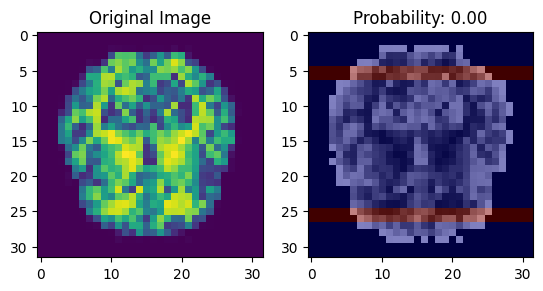

1/1 [==============================] - 0s 193ms/step


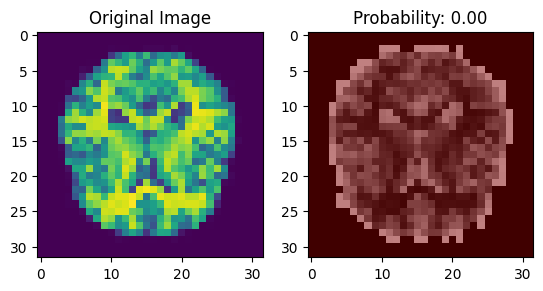

1/1 [==============================] - 0s 199ms/step


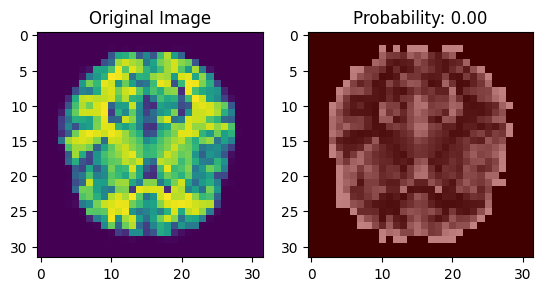

1/1 [==============================] - 0s 192ms/step


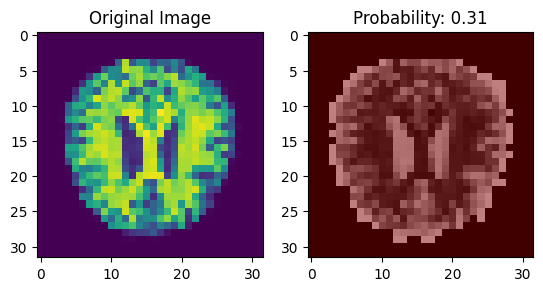

1/1 [==============================] - 0s 203ms/step


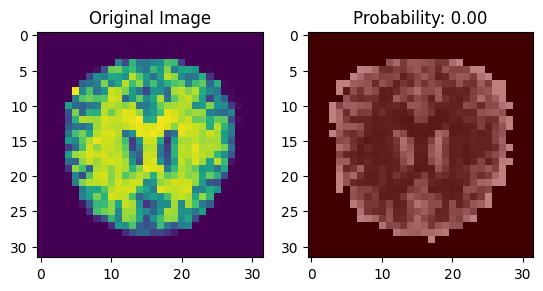

1/1 [==============================] - 0s 175ms/step


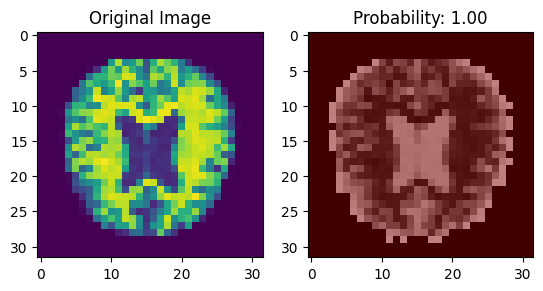

1/1 [==============================] - 0s 174ms/step


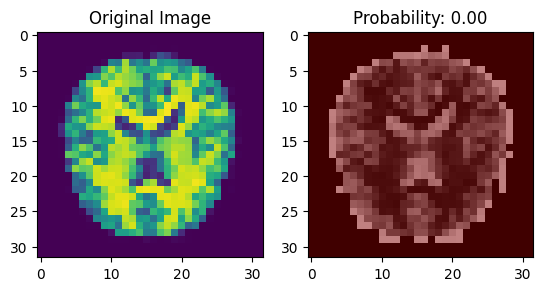

1/1 [==============================] - 0s 187ms/step


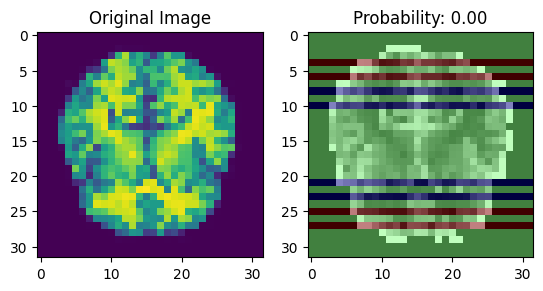

1/1 [==============================] - 0s 207ms/step


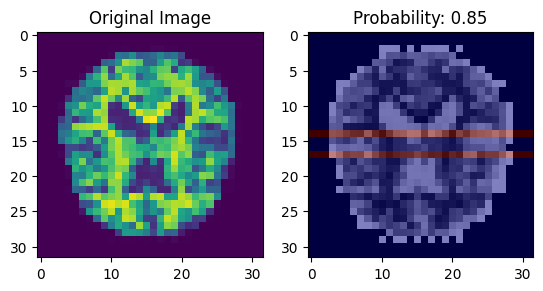

1/1 [==============================] - 0s 216ms/step


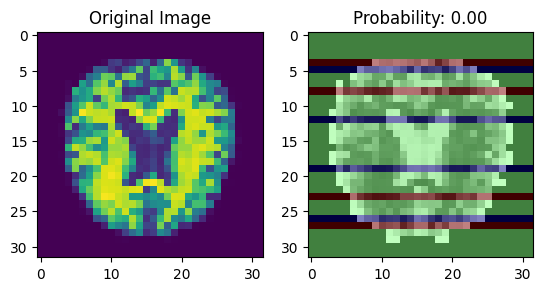

1/1 [==============================] - 0s 249ms/step


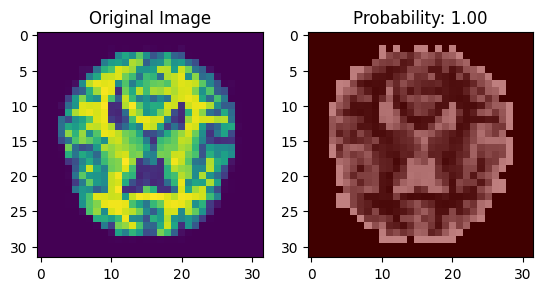

1/1 [==============================] - 0s 234ms/step


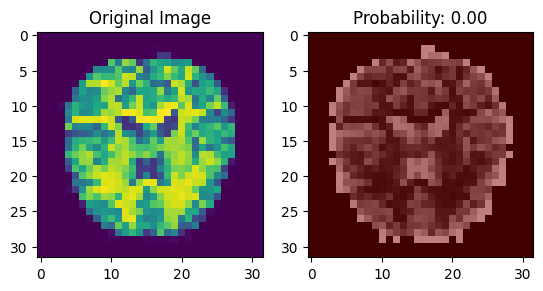

1/1 [==============================] - 0s 182ms/step


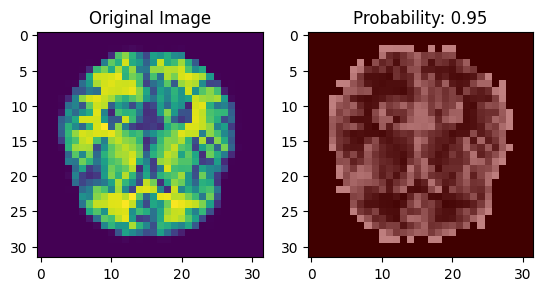

1/1 [==============================] - 0s 183ms/step


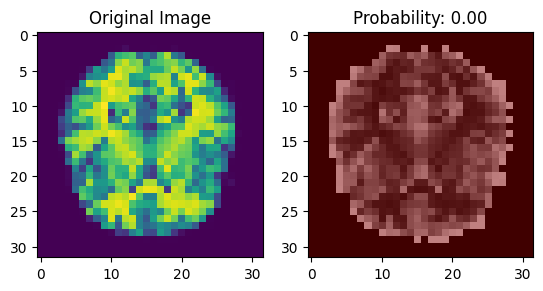

1/1 [==============================] - 0s 177ms/step


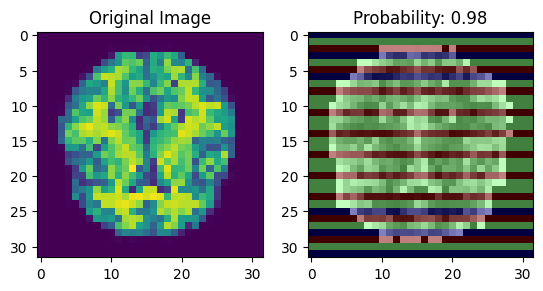

1/1 [==============================] - 0s 161ms/step


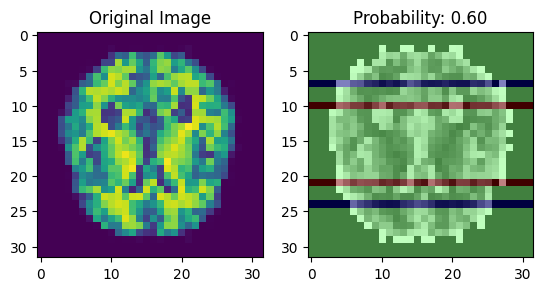

1/1 [==============================] - 0s 178ms/step


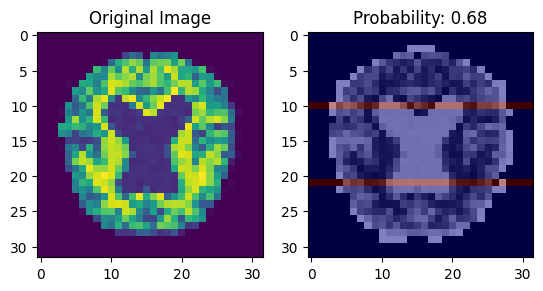

1/1 [==============================] - 0s 158ms/step


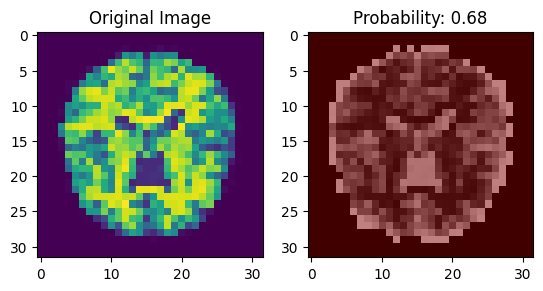

1/1 [==============================] - 0s 167ms/step


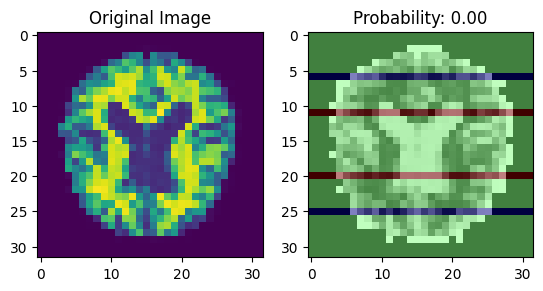

1/1 [==============================] - 0s 167ms/step


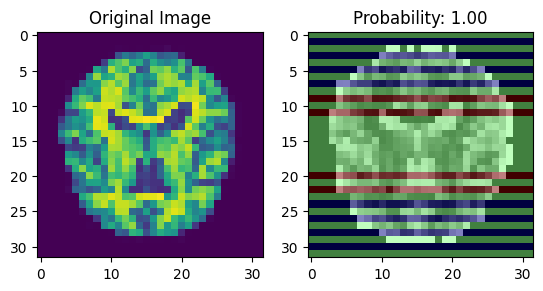

1/1 [==============================] - 0s 194ms/step


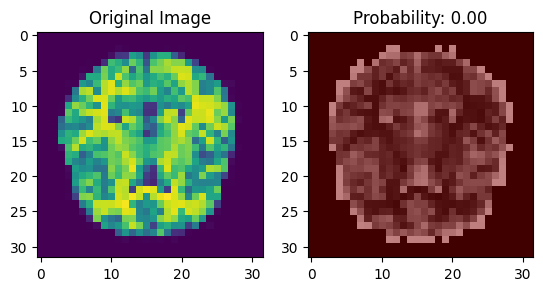

1/1 [==============================] - 0s 195ms/step


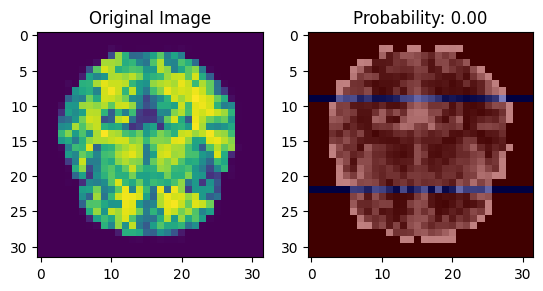

1/1 [==============================] - 0s 195ms/step


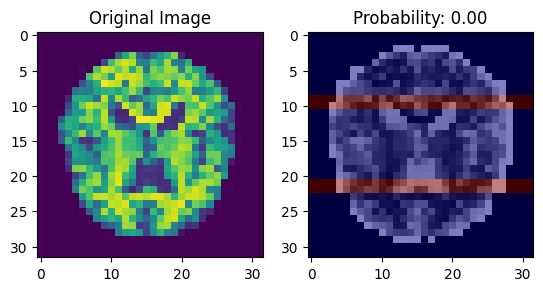

1/1 [==============================] - 0s 231ms/step


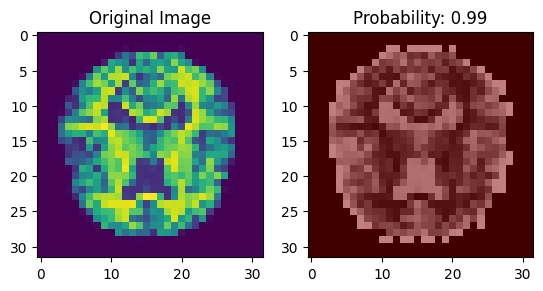

1/1 [==============================] - 0s 172ms/step


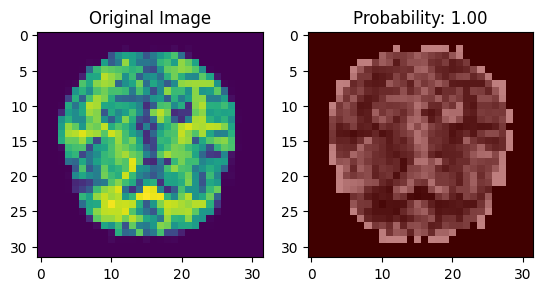

1/1 [==============================] - 0s 219ms/step


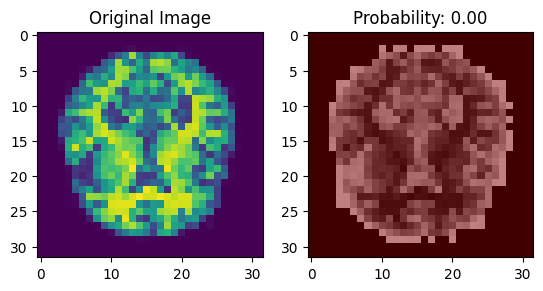

1/1 [==============================] - 0s 194ms/step


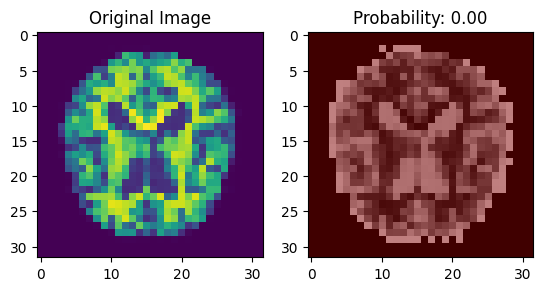

1/1 [==============================] - 0s 188ms/step


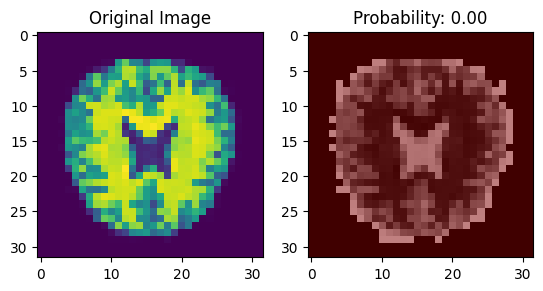

1/1 [==============================] - 0s 197ms/step


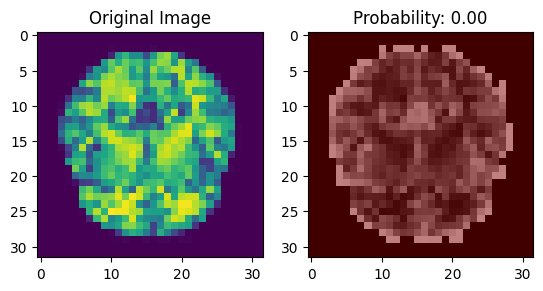

1/1 [==============================] - 0s 177ms/step


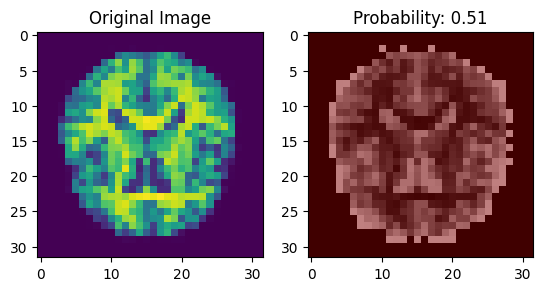

1/1 [==============================] - 0s 191ms/step


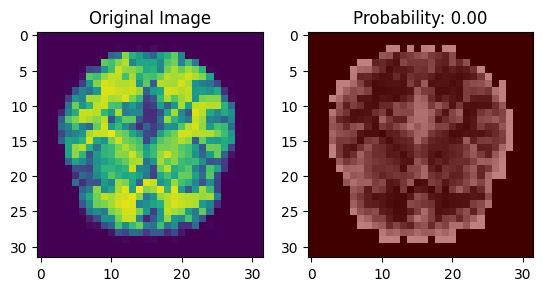

1/1 [==============================] - 0s 167ms/step


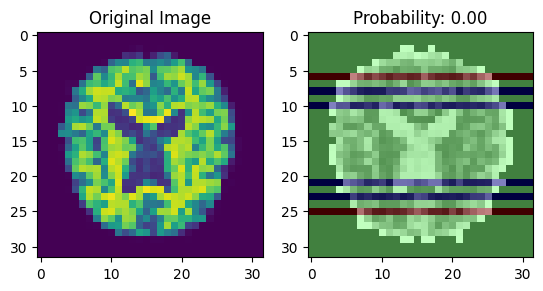

1/1 [==============================] - 0s 169ms/step


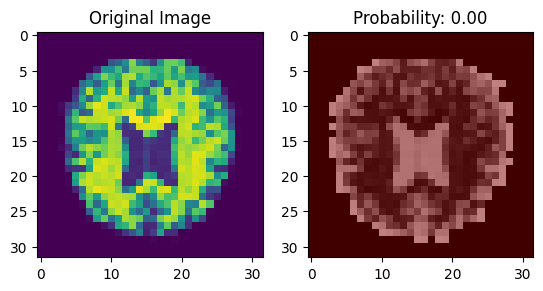

1/1 [==============================] - 0s 176ms/step


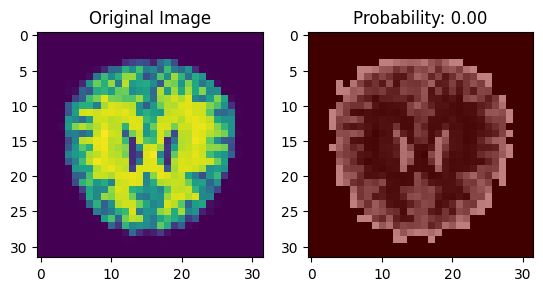

1/1 [==============================] - 0s 157ms/step


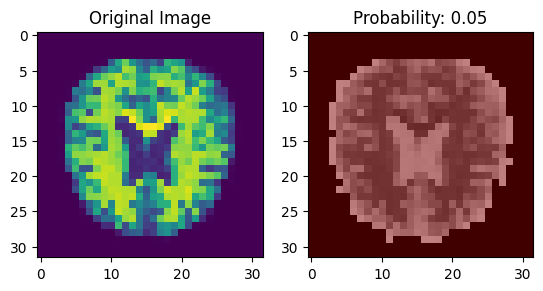

1/1 [==============================] - 0s 159ms/step


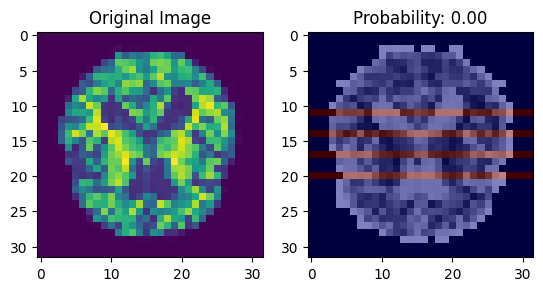

1/1 [==============================] - 0s 160ms/step


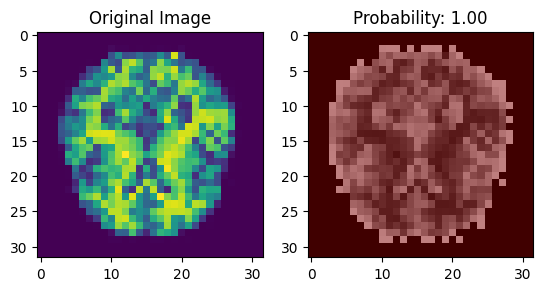

1/1 [==============================] - 0s 159ms/step


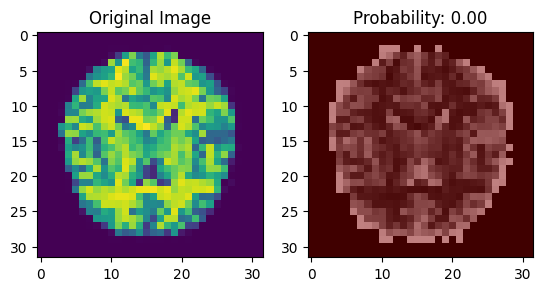

1/1 [==============================] - 0s 159ms/step


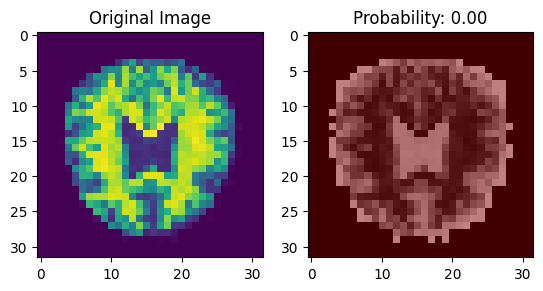

1/1 [==============================] - 0s 153ms/step


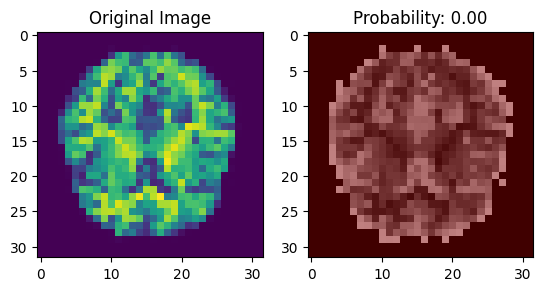

1/1 [==============================] - 1s 754ms/step


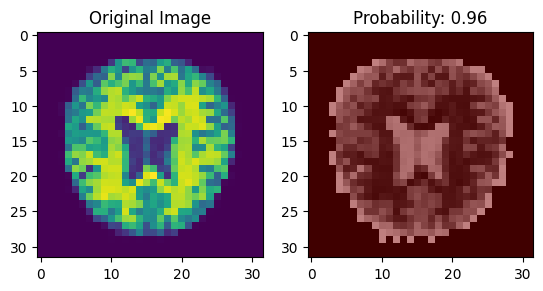

1/1 [==============================] - 0s 248ms/step


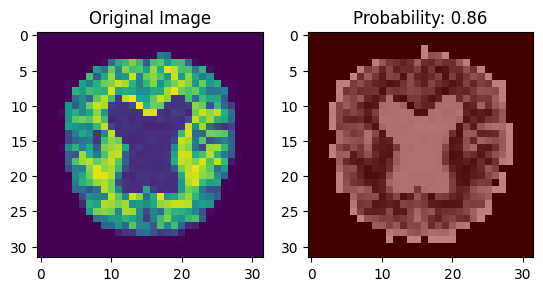

1/1 [==============================] - 0s 257ms/step


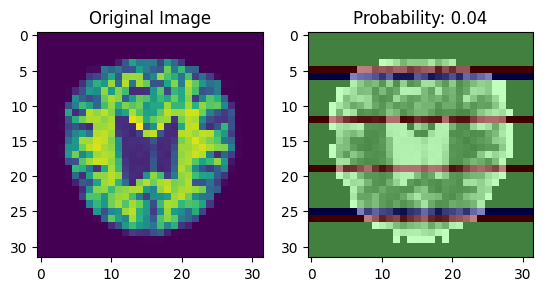

1/1 [==============================] - 0s 236ms/step


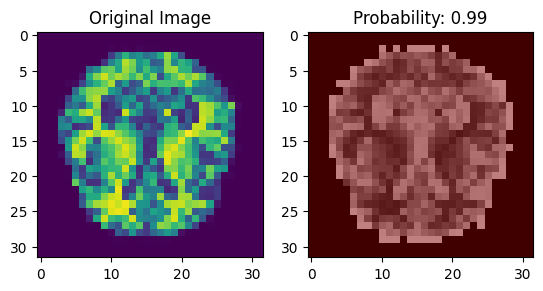

1/1 [==============================] - 0s 176ms/step


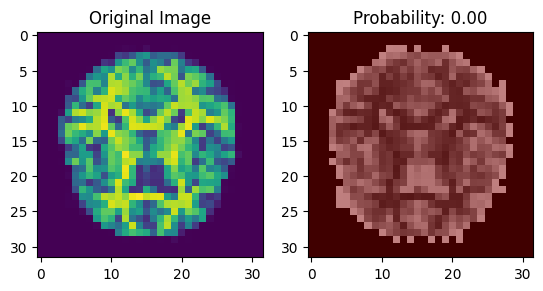

1/1 [==============================] - 0s 162ms/step


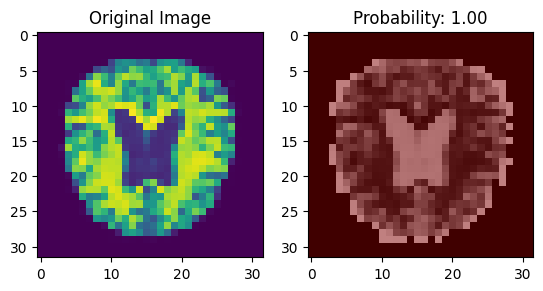

1/1 [==============================] - 0s 162ms/step


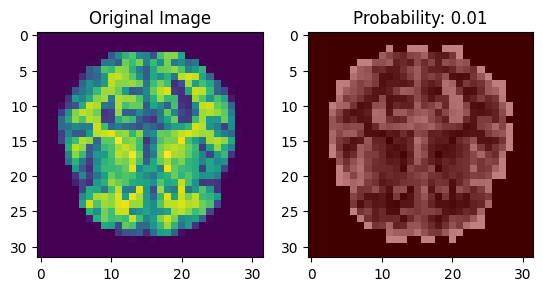

1/1 [==============================] - 0s 167ms/step


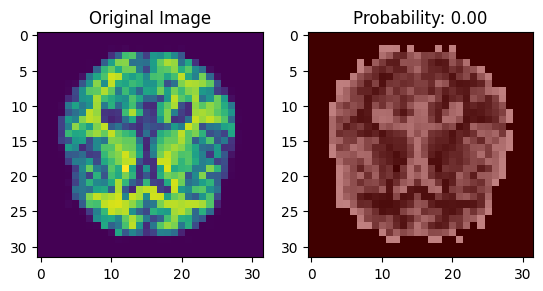

1/1 [==============================] - 0s 171ms/step


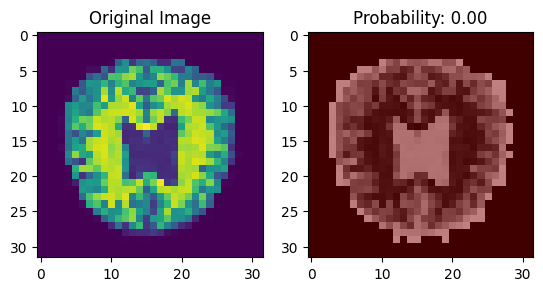

1/1 [==============================] - 0s 183ms/step


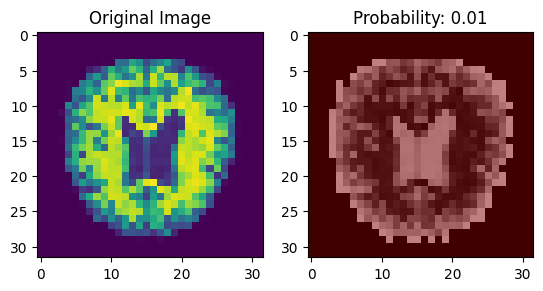

1/1 [==============================] - 0s 185ms/step


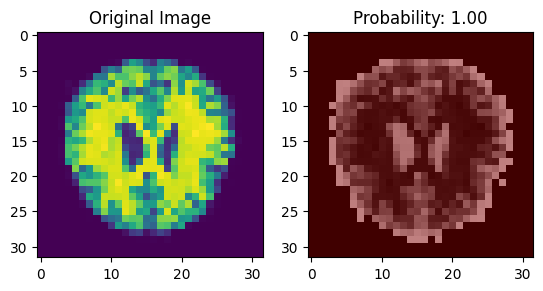

1/1 [==============================] - 0s 163ms/step


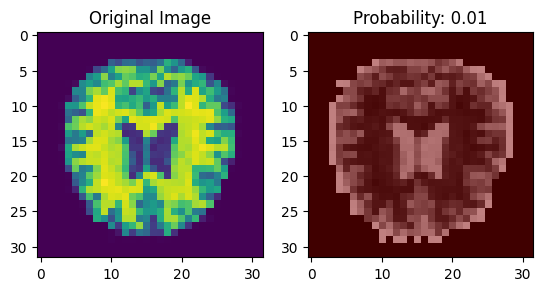

1/1 [==============================] - 0s 161ms/step


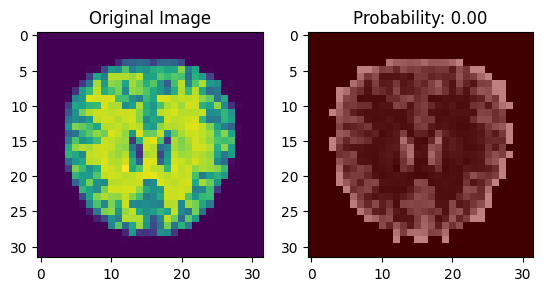

1/1 [==============================] - 0s 165ms/step


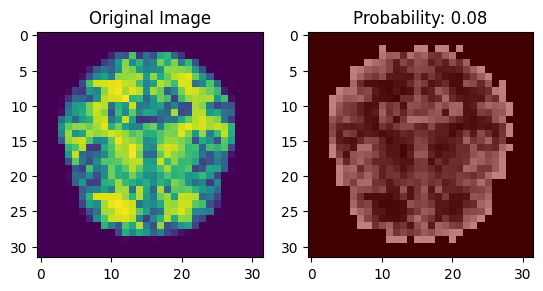

1/1 [==============================] - 0s 176ms/step


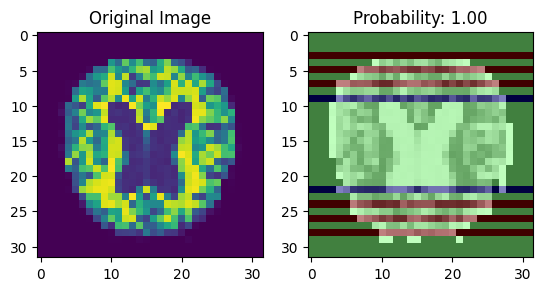

1/1 [==============================] - 0s 167ms/step


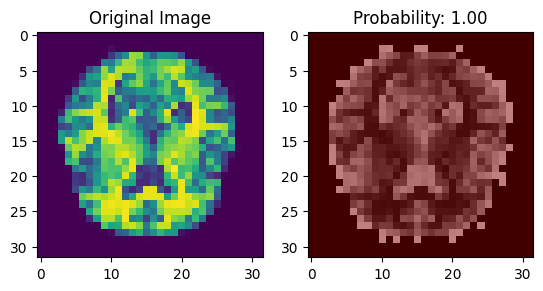

1/1 [==============================] - 0s 229ms/step


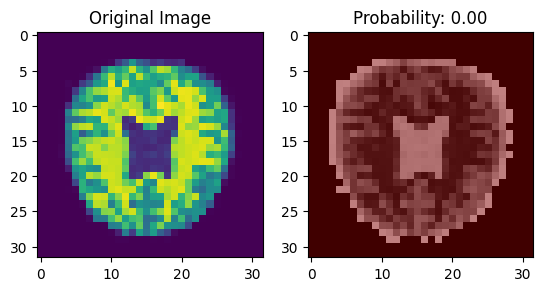

1/1 [==============================] - 0s 158ms/step


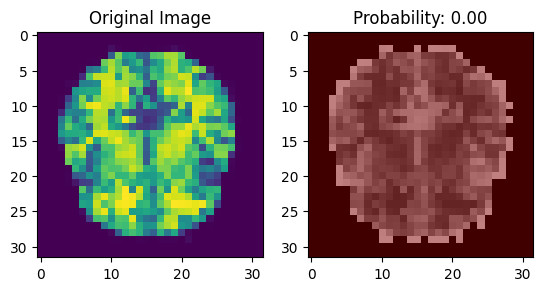

1/1 [==============================] - 0s 156ms/step


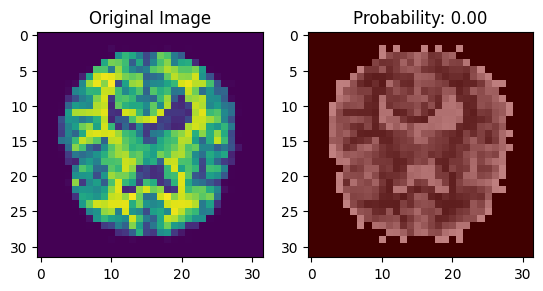

1/1 [==============================] - 0s 202ms/step


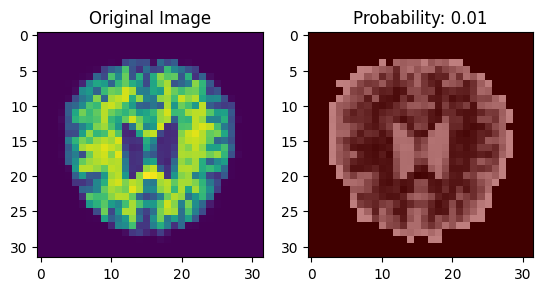

1/1 [==============================] - 0s 192ms/step


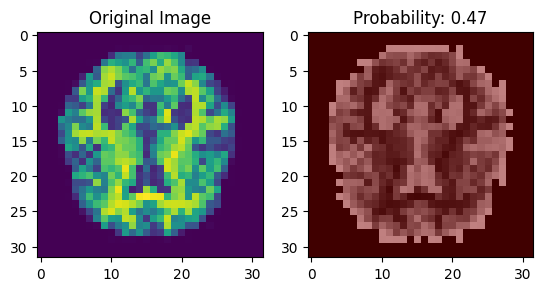

1/1 [==============================] - 0s 213ms/step


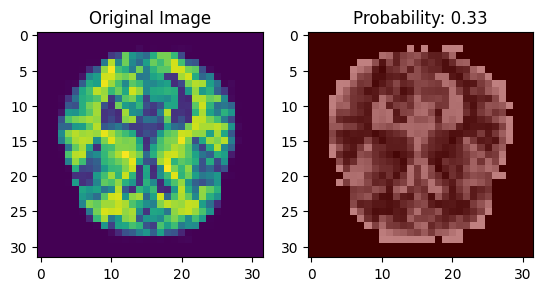

1/1 [==============================] - 0s 175ms/step


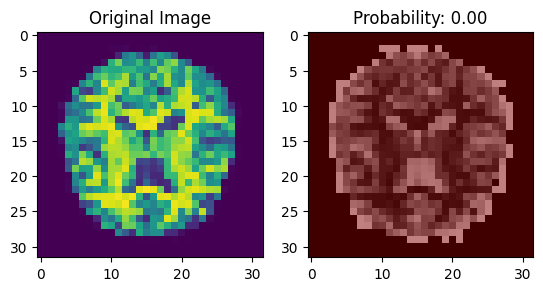

1/1 [==============================] - 0s 184ms/step


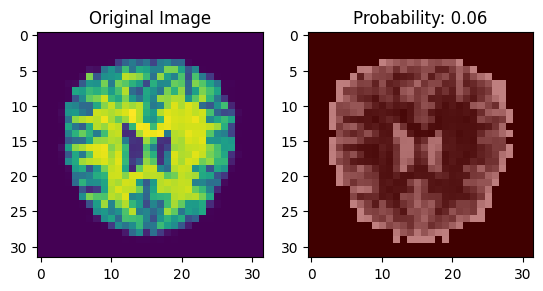

1/1 [==============================] - 0s 178ms/step


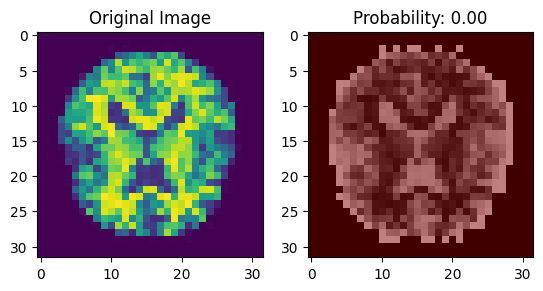

1/1 [==============================] - 0s 169ms/step


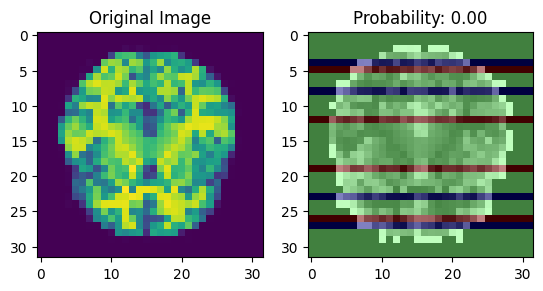

1/1 [==============================] - 0s 171ms/step


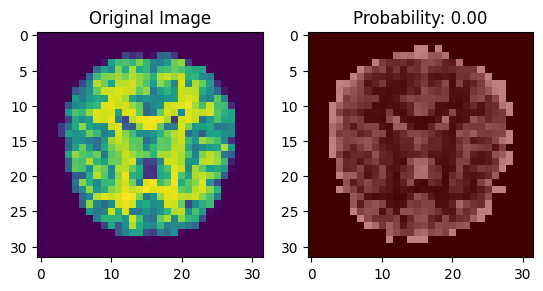

1/1 [==============================] - 0s 170ms/step


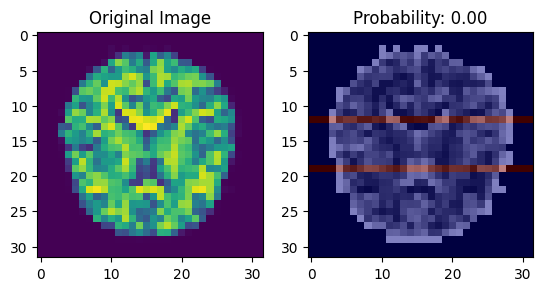

1/1 [==============================] - 0s 176ms/step


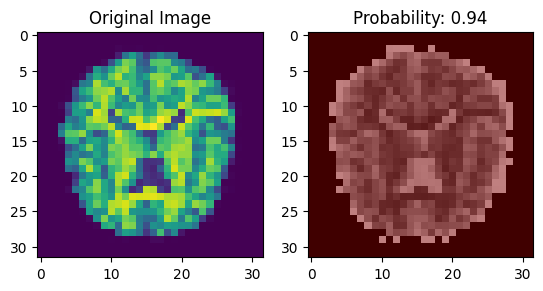

1/1 [==============================] - 0s 162ms/step


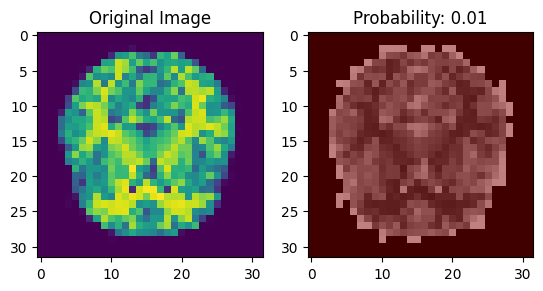

1/1 [==============================] - 0s 173ms/step


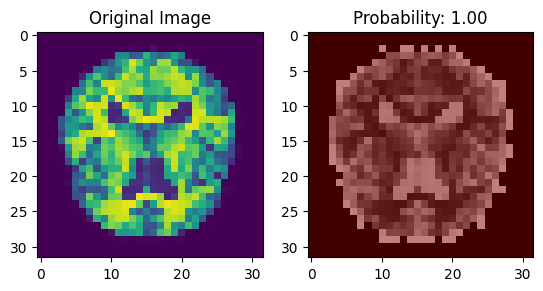

1/1 [==============================] - 0s 166ms/step


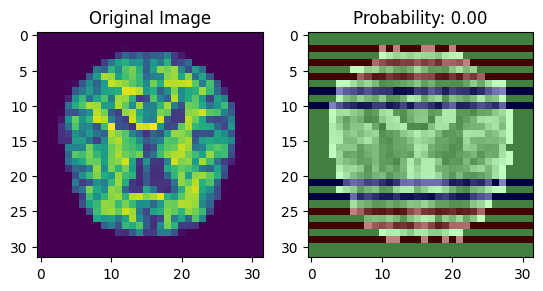

1/1 [==============================] - 0s 157ms/step


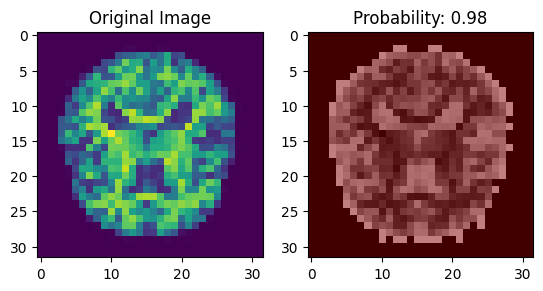

1/1 [==============================] - 0s 187ms/step


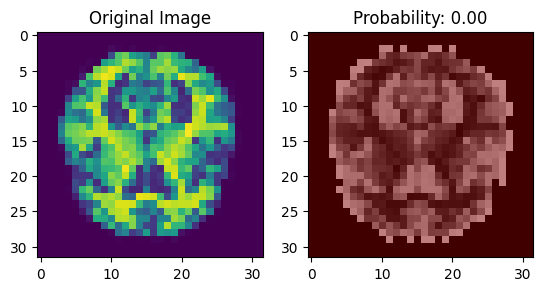

1/1 [==============================] - 0s 162ms/step


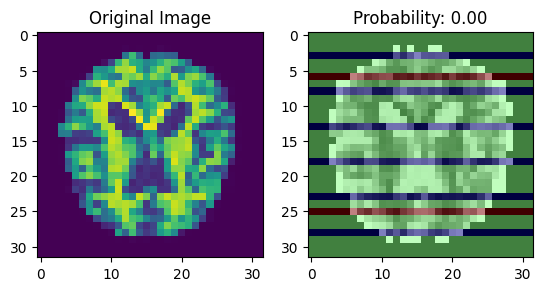

1/1 [==============================] - 0s 198ms/step


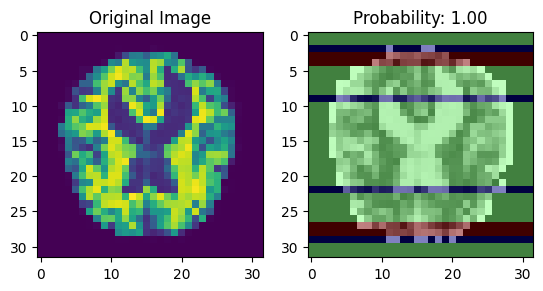

1/1 [==============================] - 0s 238ms/step


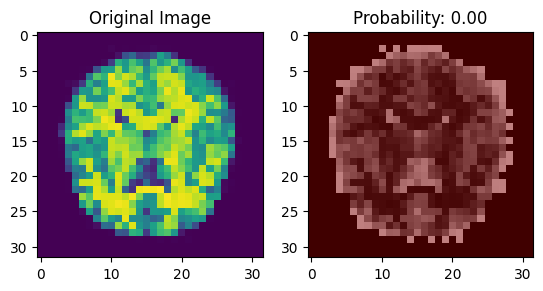

1/1 [==============================] - 0s 167ms/step


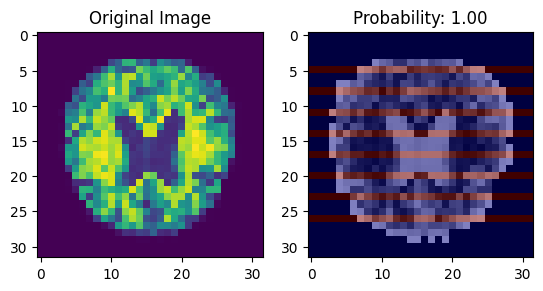

1/1 [==============================] - 0s 231ms/step


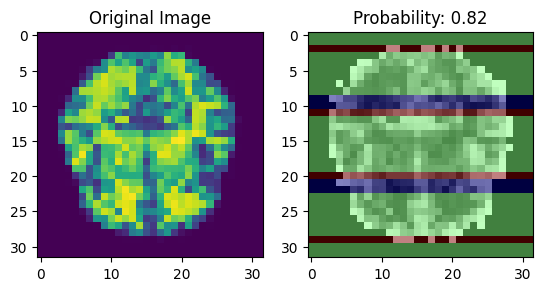

1/1 [==============================] - 0s 205ms/step


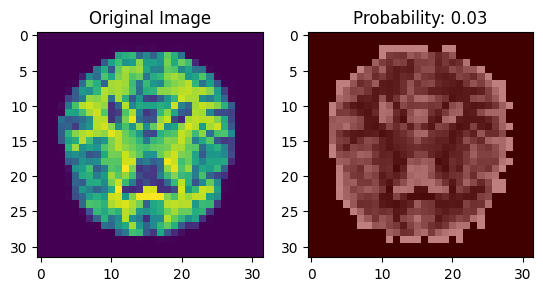

1/1 [==============================] - 0s 167ms/step


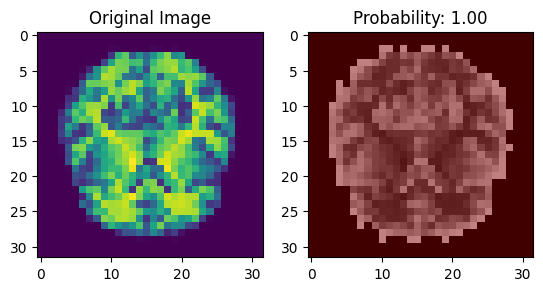

1/1 [==============================] - 1s 760ms/step


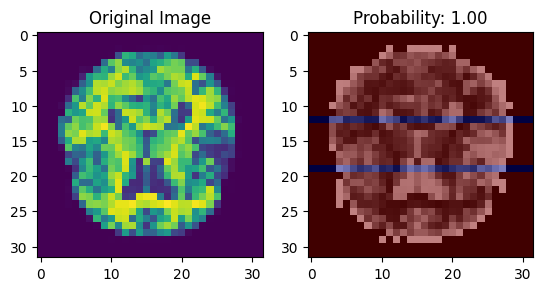

1/1 [==============================] - 0s 188ms/step


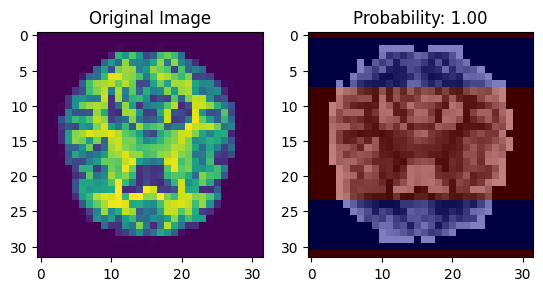

1/1 [==============================] - 0s 197ms/step


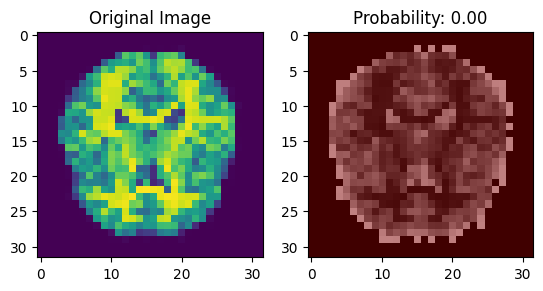

1/1 [==============================] - 0s 183ms/step


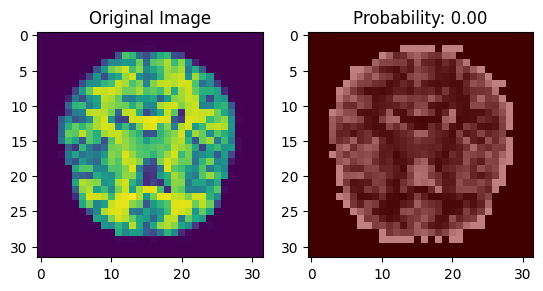

1/1 [==============================] - 0s 162ms/step


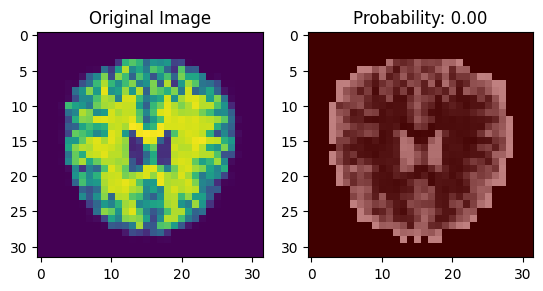

1/1 [==============================] - 0s 178ms/step


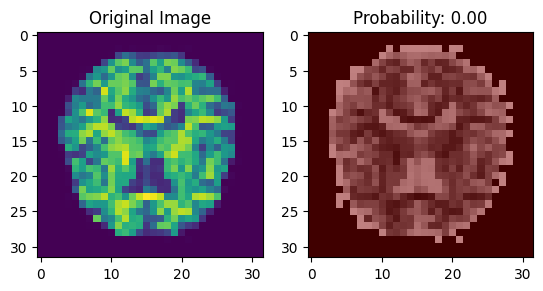

1/1 [==============================] - 0s 163ms/step


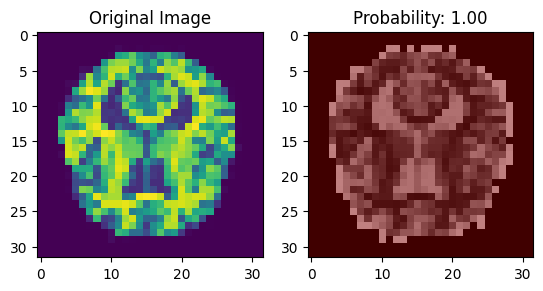

1/1 [==============================] - 0s 159ms/step


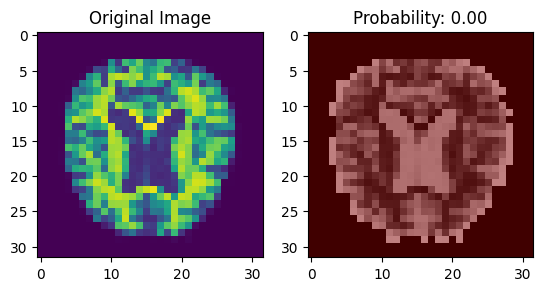

1/1 [==============================] - 0s 169ms/step


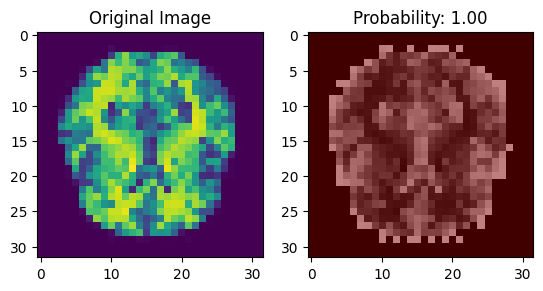

1/1 [==============================] - 0s 219ms/step


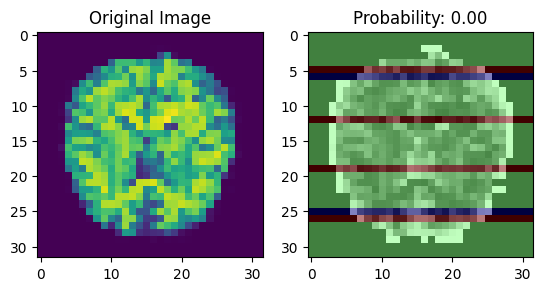

1/1 [==============================] - 0s 254ms/step


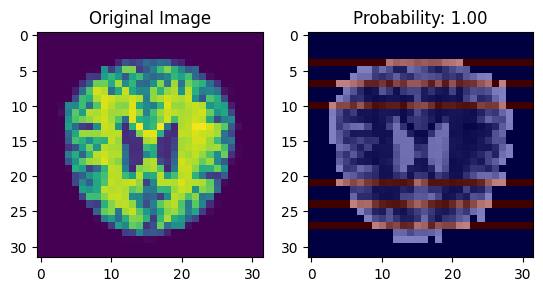

1/1 [==============================] - 0s 244ms/step


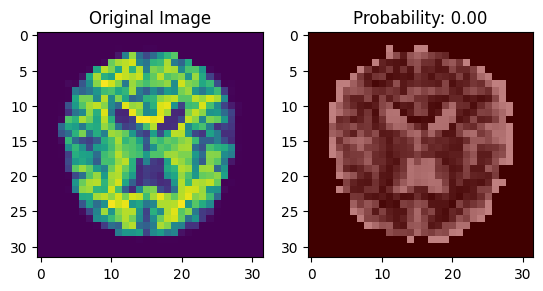

1/1 [==============================] - 0s 181ms/step


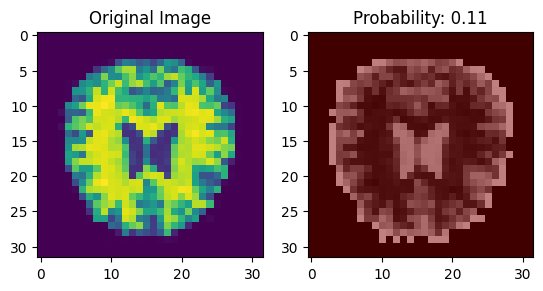

1/1 [==============================] - 0s 239ms/step


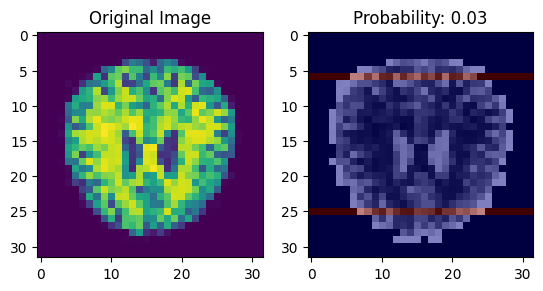

1/1 [==============================] - 0s 189ms/step


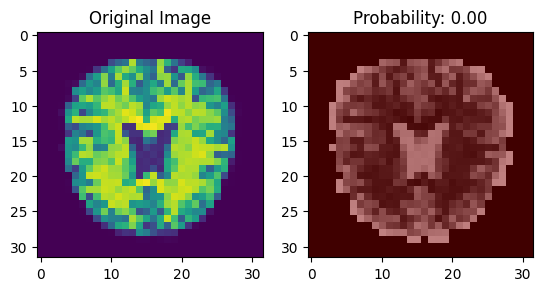

1/1 [==============================] - 0s 168ms/step


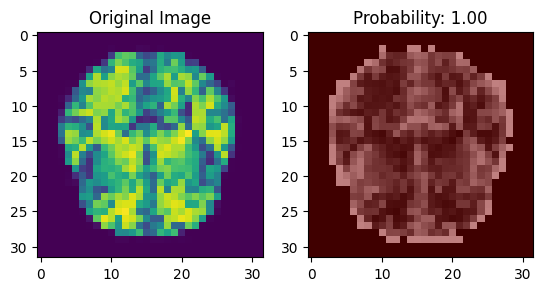

1/1 [==============================] - 0s 164ms/step


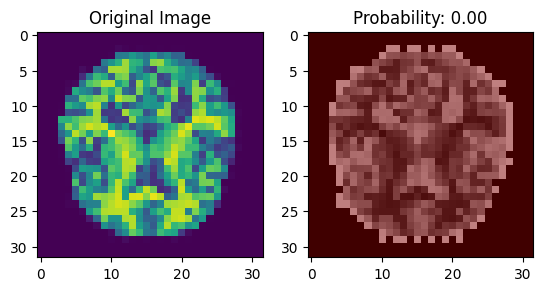

1/1 [==============================] - 0s 168ms/step


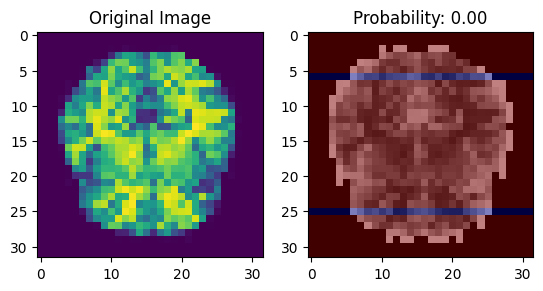

1/1 [==============================] - 0s 161ms/step


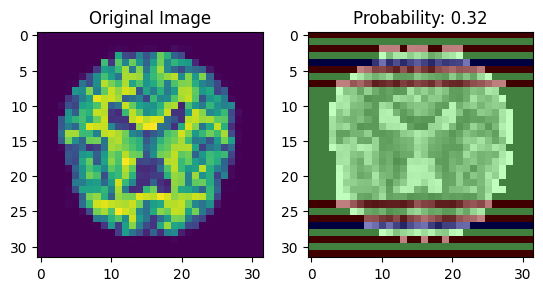

1/1 [==============================] - 0s 157ms/step


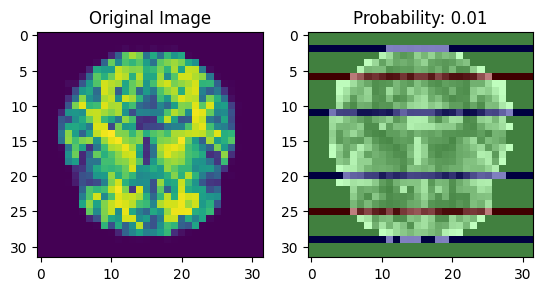

1/1 [==============================] - 0s 158ms/step


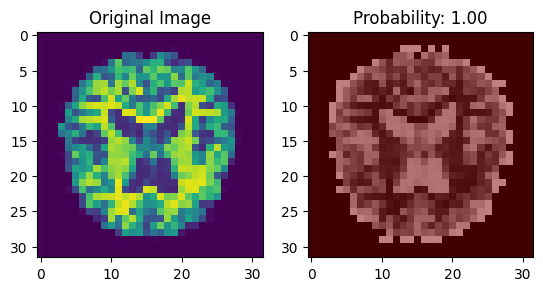

1/1 [==============================] - 0s 197ms/step


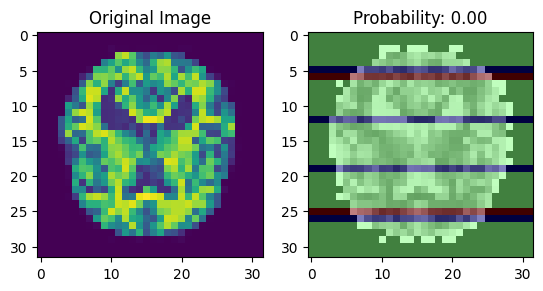

1/1 [==============================] - 0s 189ms/step


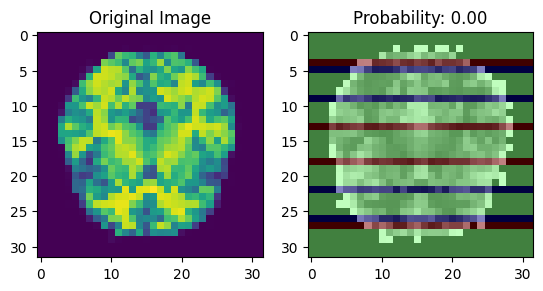

1/1 [==============================] - 0s 224ms/step


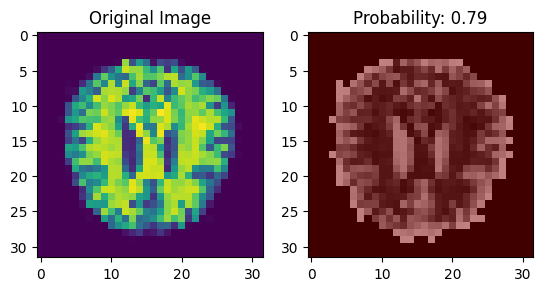

1/1 [==============================] - 0s 182ms/step


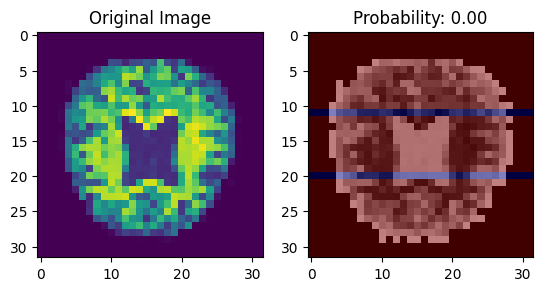

1/1 [==============================] - 0s 175ms/step


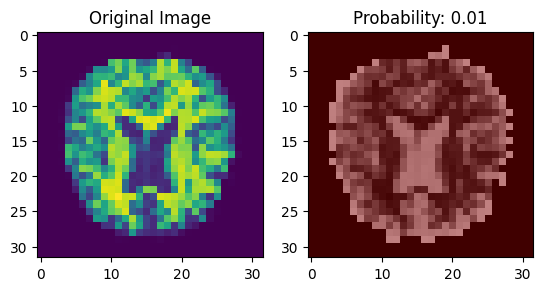

1/1 [==============================] - 0s 183ms/step


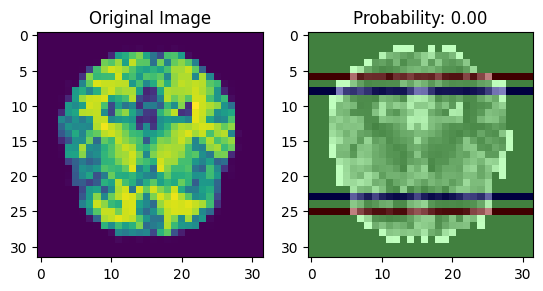

1/1 [==============================] - 0s 208ms/step


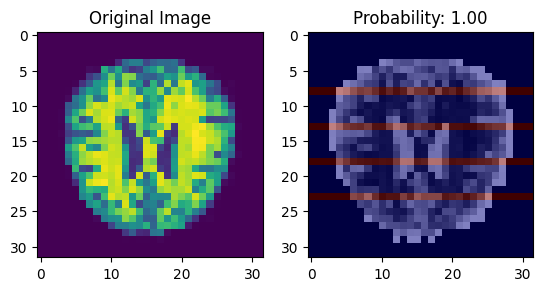

1/1 [==============================] - 0s 178ms/step


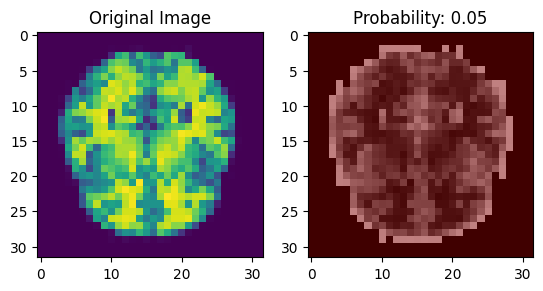

1/1 [==============================] - 0s 194ms/step


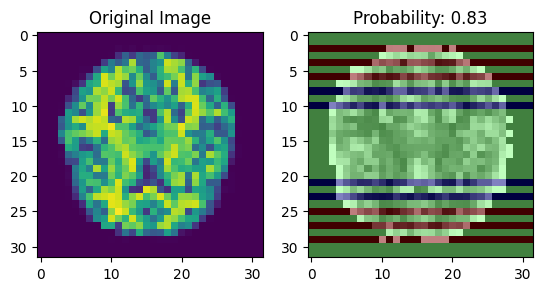

1/1 [==============================] - 0s 187ms/step


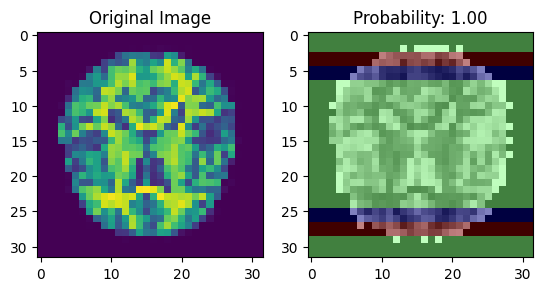

1/1 [==============================] - 0s 159ms/step


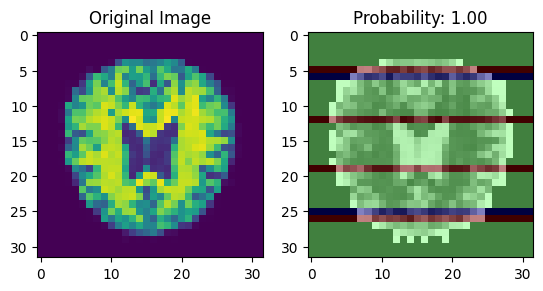

1/1 [==============================] - 0s 159ms/step


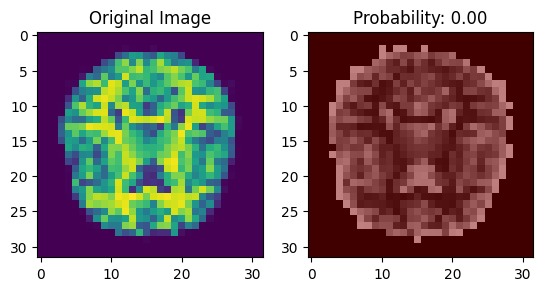

1/1 [==============================] - 0s 155ms/step


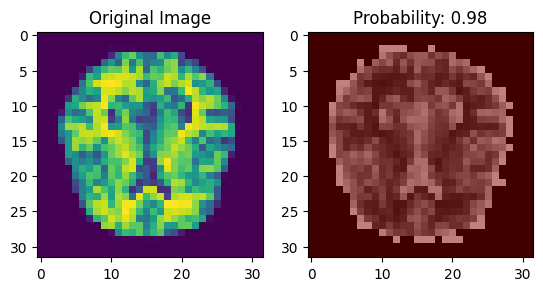

1/1 [==============================] - 0s 155ms/step


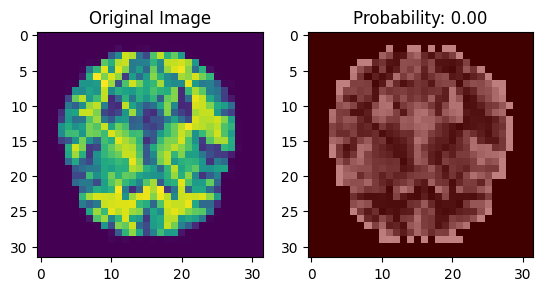

1/1 [==============================] - 0s 173ms/step


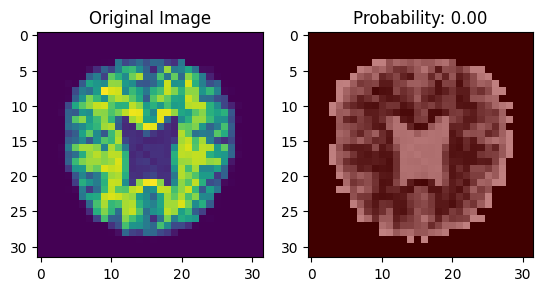

1/1 [==============================] - 0s 157ms/step


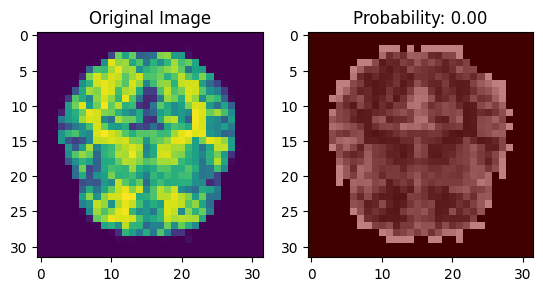

1/1 [==============================] - 0s 173ms/step


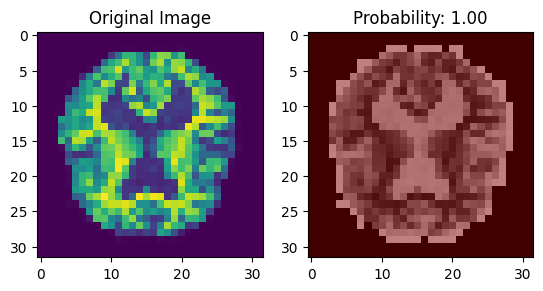

1/1 [==============================] - 0s 155ms/step


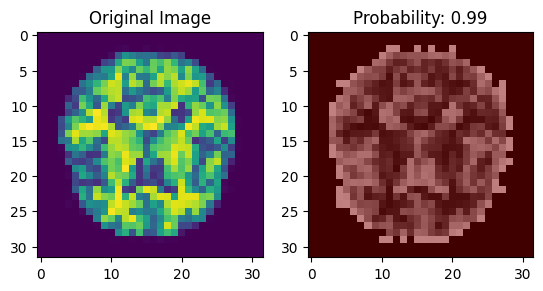

1/1 [==============================] - 0s 158ms/step


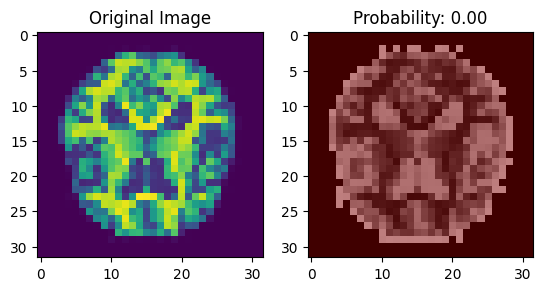

1/1 [==============================] - 0s 159ms/step


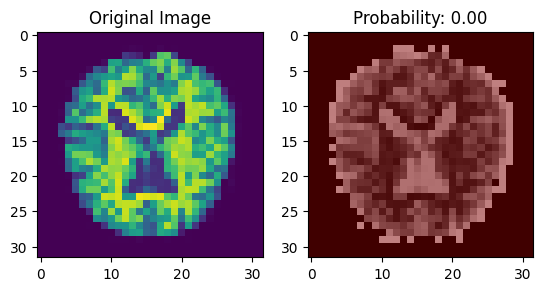

1/1 [==============================] - 1s 751ms/step


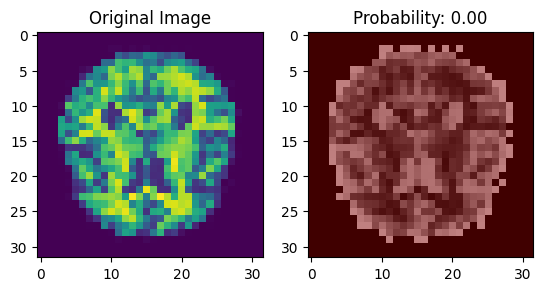

1/1 [==============================] - 0s 220ms/step


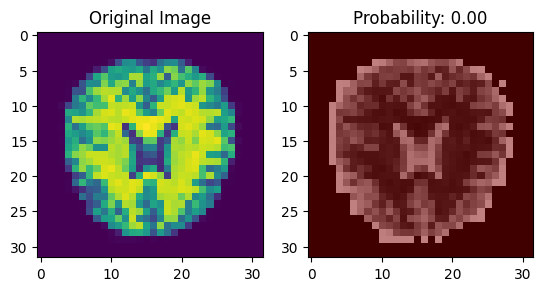

1/1 [==============================] - 0s 202ms/step


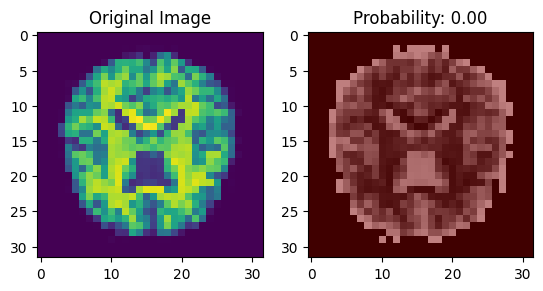

1/1 [==============================] - 0s 216ms/step


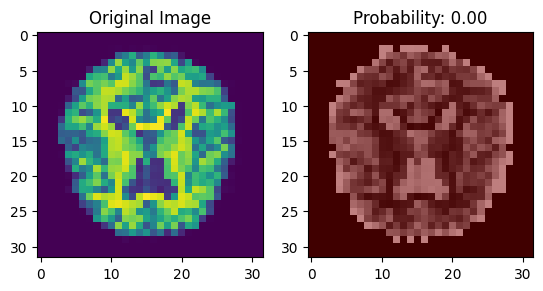

1/1 [==============================] - 0s 188ms/step


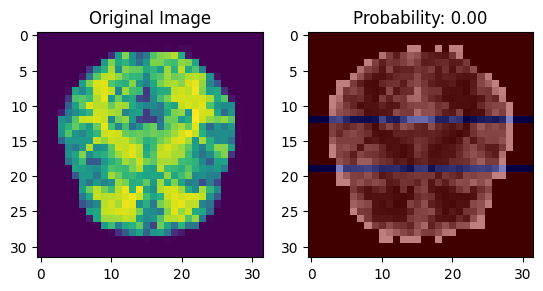

1/1 [==============================] - 0s 241ms/step


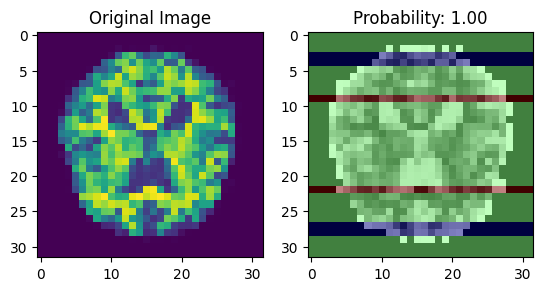

1/1 [==============================] - 0s 161ms/step


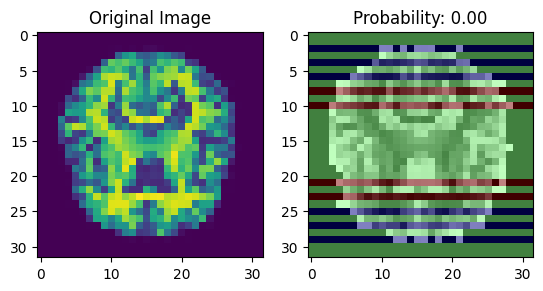

1/1 [==============================] - 0s 177ms/step


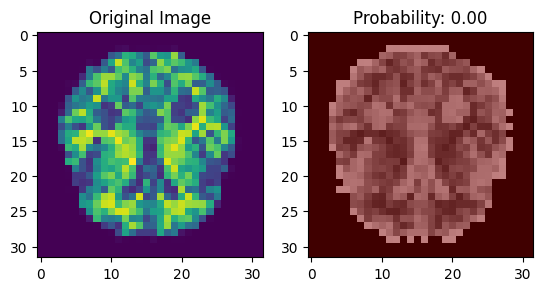

1/1 [==============================] - 0s 173ms/step


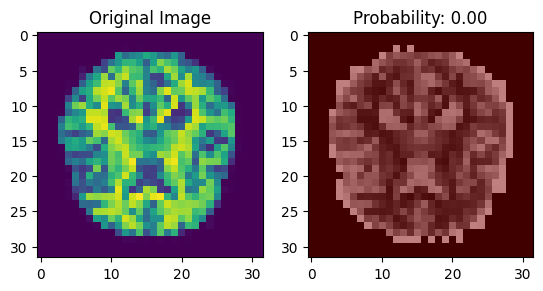

1/1 [==============================] - 0s 171ms/step


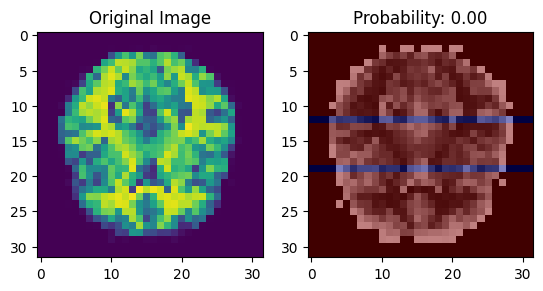

1/1 [==============================] - 0s 190ms/step


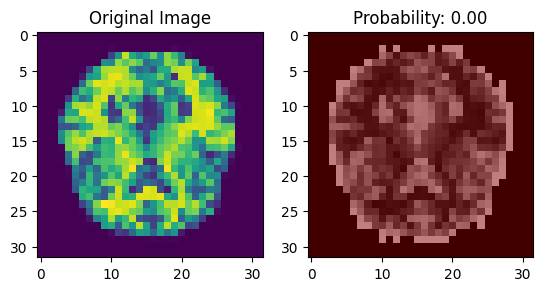

1/1 [==============================] - 0s 159ms/step


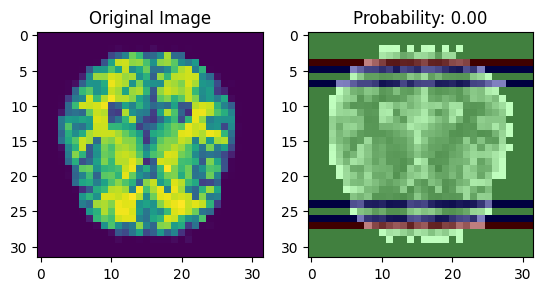

1/1 [==============================] - 0s 157ms/step


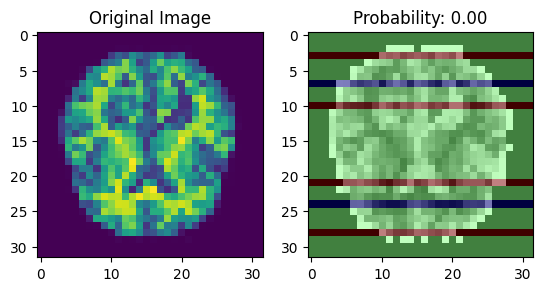

1/1 [==============================] - 0s 172ms/step


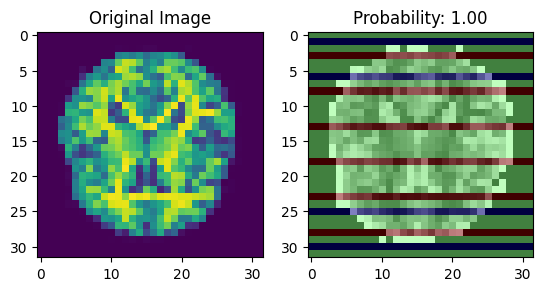

1/1 [==============================] - 0s 184ms/step


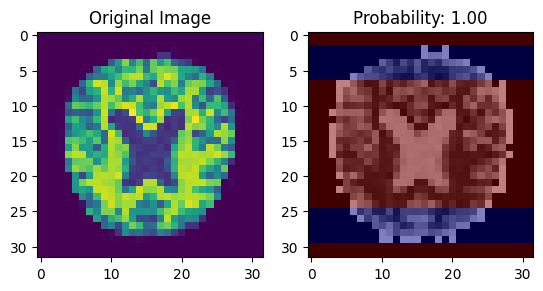

1/1 [==============================] - 0s 158ms/step


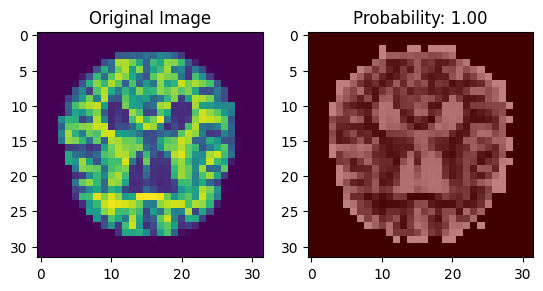

1/1 [==============================] - 0s 162ms/step


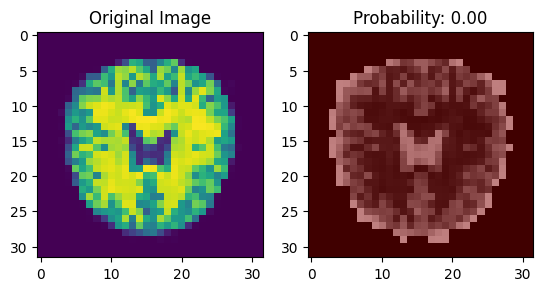

1/1 [==============================] - 0s 196ms/step


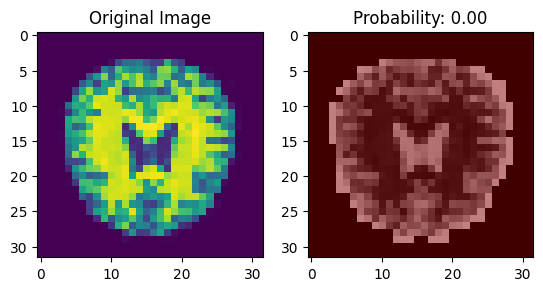

1/1 [==============================] - 0s 159ms/step


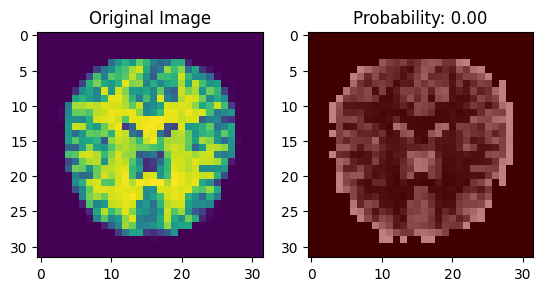

1/1 [==============================] - 0s 155ms/step


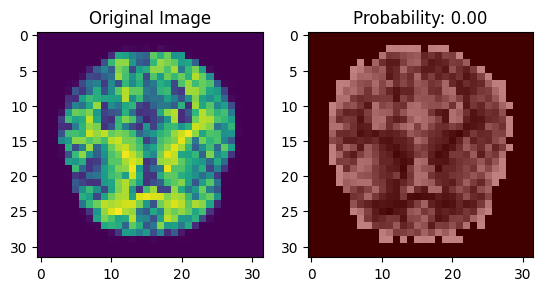

1/1 [==============================] - 0s 163ms/step


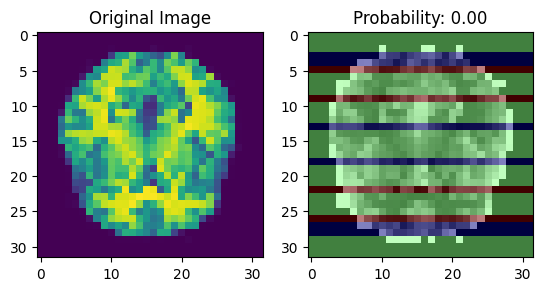

1/1 [==============================] - 0s 229ms/step


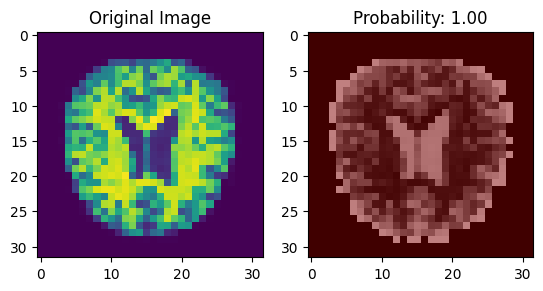

1/1 [==============================] - 0s 210ms/step


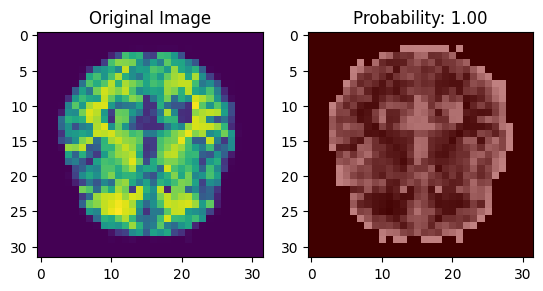

1/1 [==============================] - 0s 195ms/step


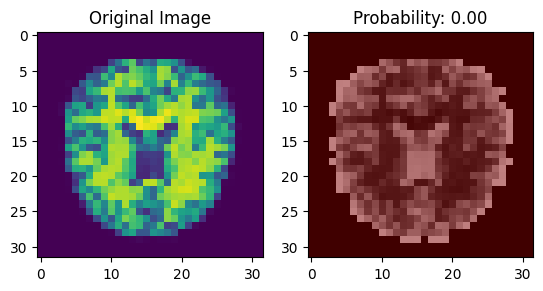

1/1 [==============================] - 0s 168ms/step


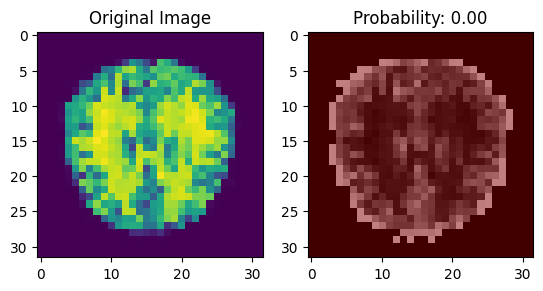

1/1 [==============================] - 0s 172ms/step


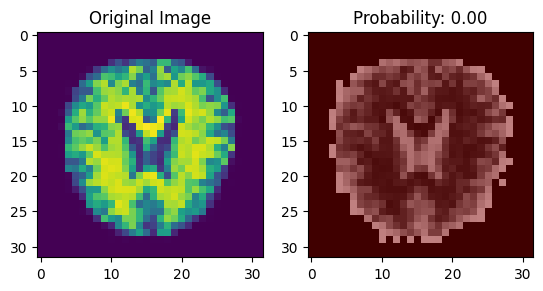

1/1 [==============================] - 0s 186ms/step


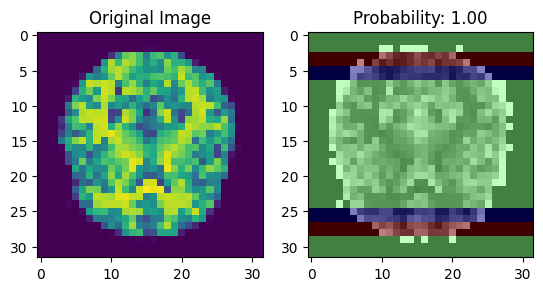

1/1 [==============================] - 0s 157ms/step


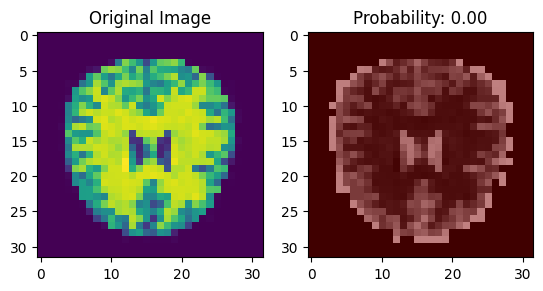

1/1 [==============================] - 0s 181ms/step


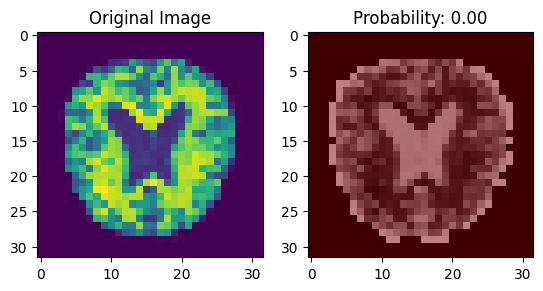

1/1 [==============================] - 0s 161ms/step


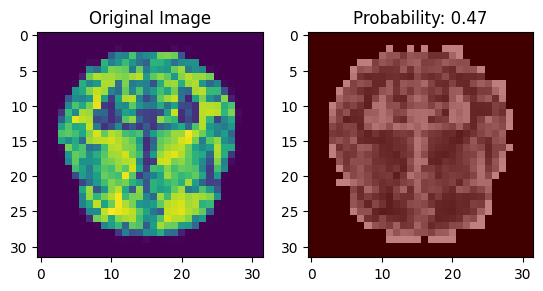

1/1 [==============================] - 0s 162ms/step


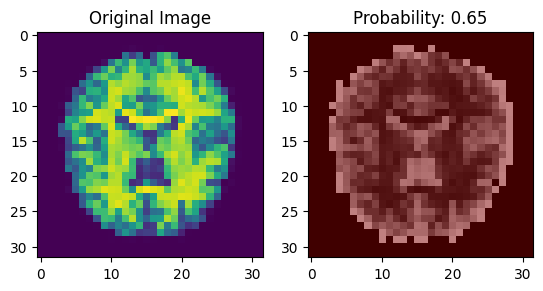

1/1 [==============================] - 0s 164ms/step


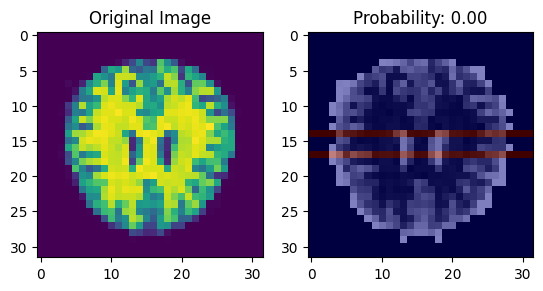

1/1 [==============================] - 0s 162ms/step


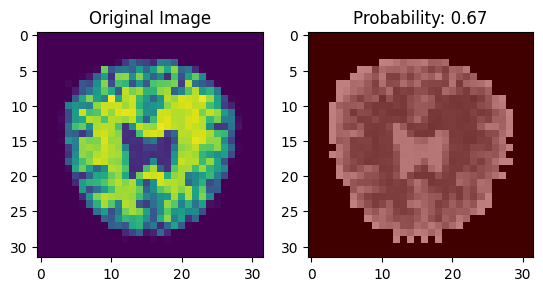

1/1 [==============================] - 0s 148ms/step


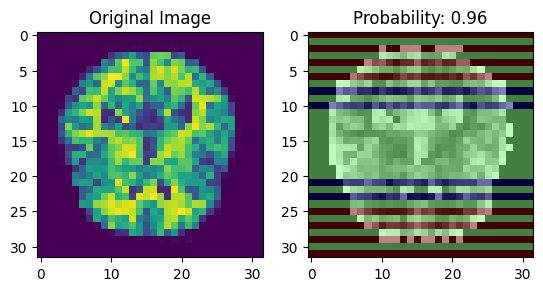

1/1 [==============================] - 0s 188ms/step


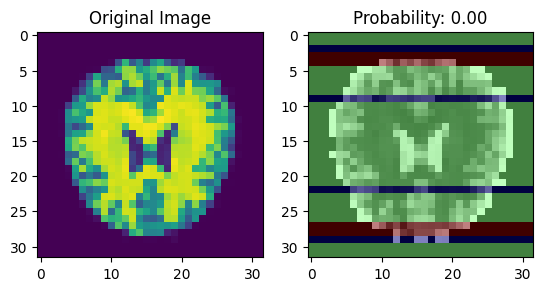

1/1 [==============================] - 0s 232ms/step


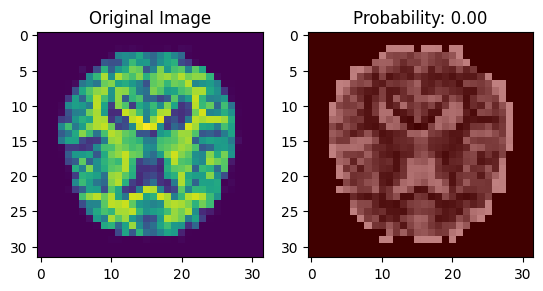

1/1 [==============================] - 0s 193ms/step


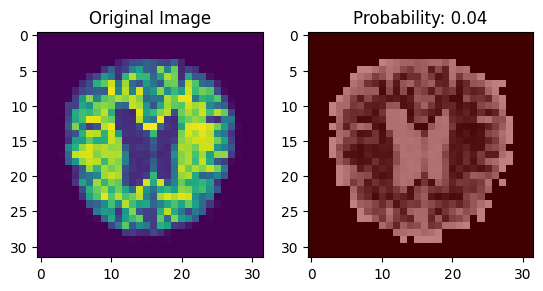

1/1 [==============================] - 0s 179ms/step


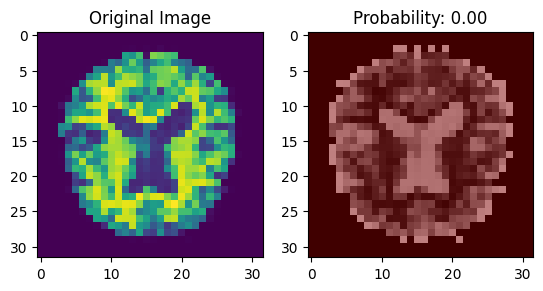

1/1 [==============================] - 0s 194ms/step


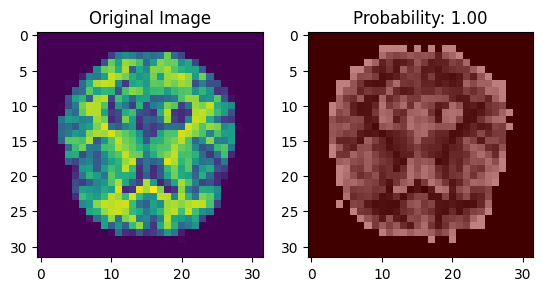

1/1 [==============================] - 0s 176ms/step


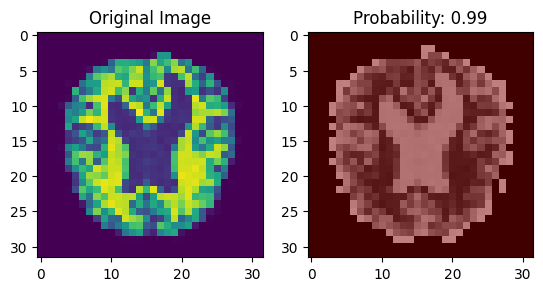

1/1 [==============================] - 0s 189ms/step


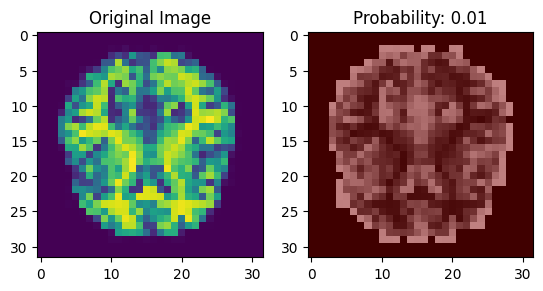

1/1 [==============================] - 1s 720ms/step


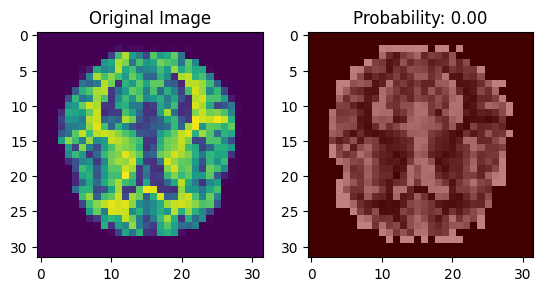

1/1 [==============================] - 0s 221ms/step


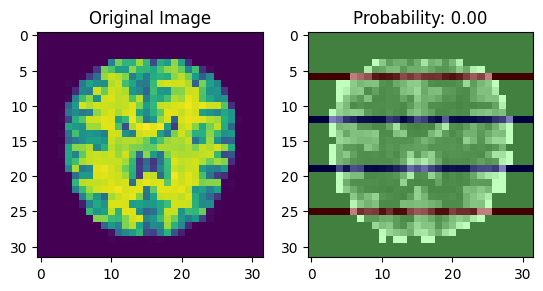

1/1 [==============================] - 0s 202ms/step


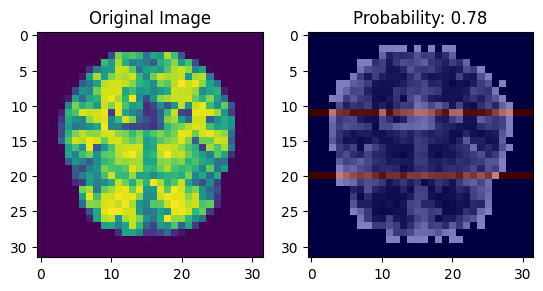

1/1 [==============================] - 0s 203ms/step


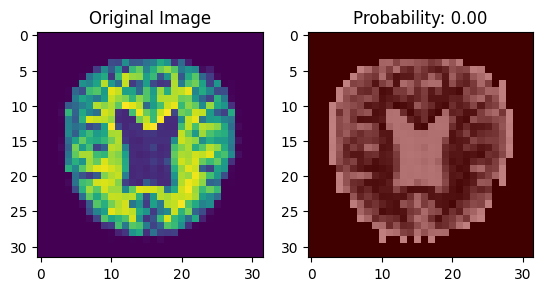

1/1 [==============================] - 0s 169ms/step


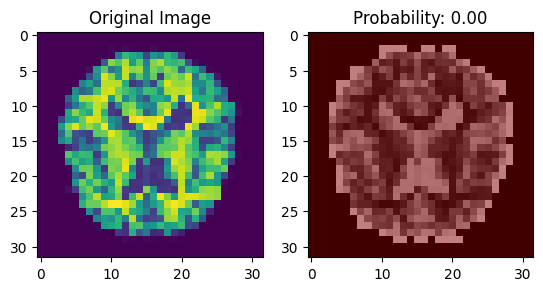

1/1 [==============================] - 0s 160ms/step


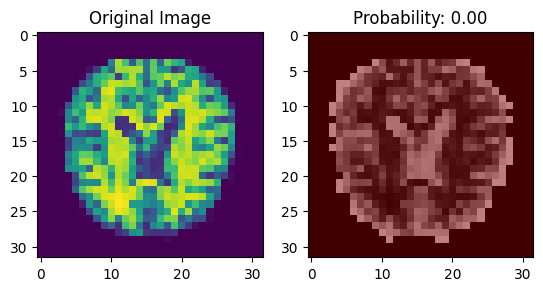

1/1 [==============================] - 0s 181ms/step


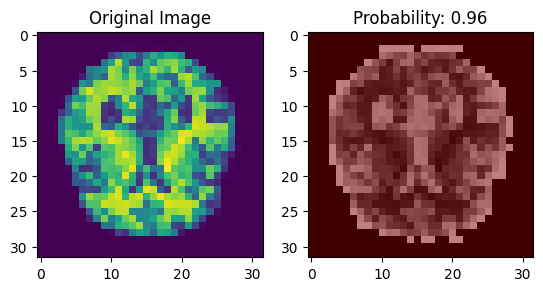

1/1 [==============================] - 0s 157ms/step


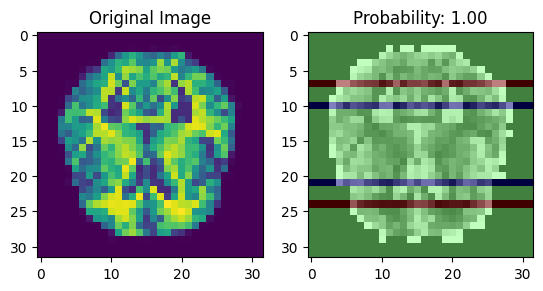

1/1 [==============================] - 0s 158ms/step


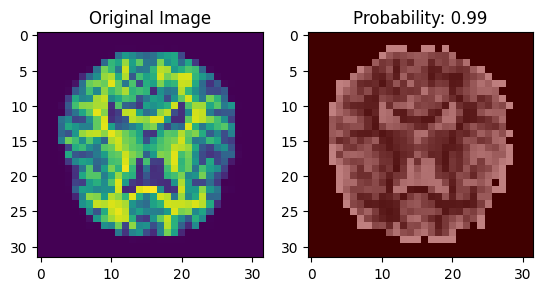

1/1 [==============================] - 0s 170ms/step


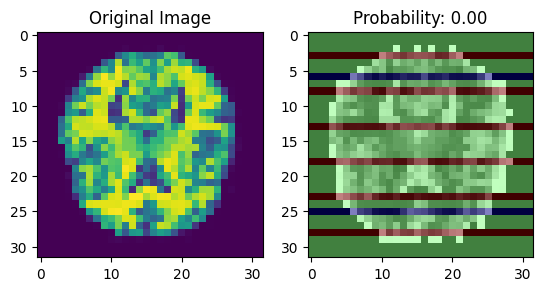

1/1 [==============================] - 0s 195ms/step


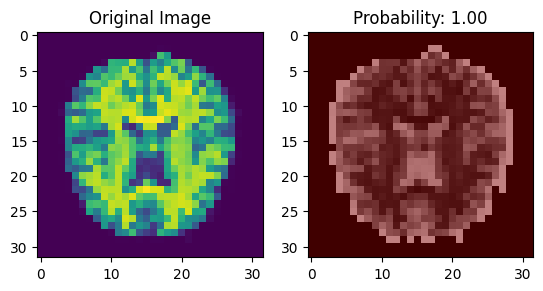

1/1 [==============================] - 0s 207ms/step


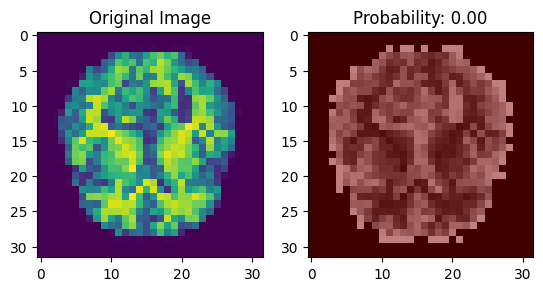

1/1 [==============================] - 0s 203ms/step


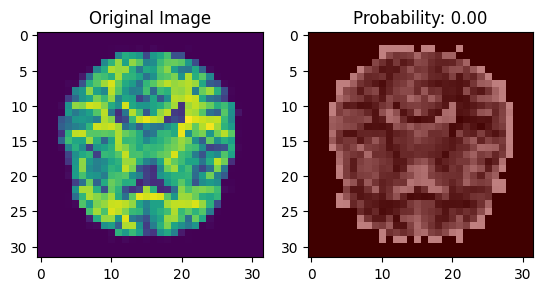

1/1 [==============================] - 0s 236ms/step


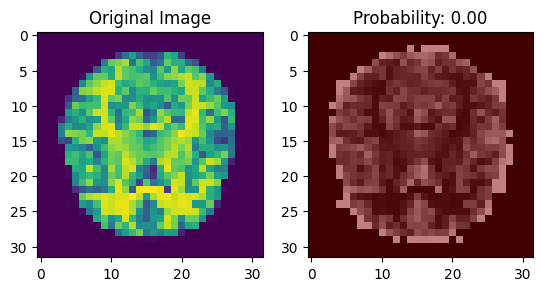

1/1 [==============================] - 0s 182ms/step


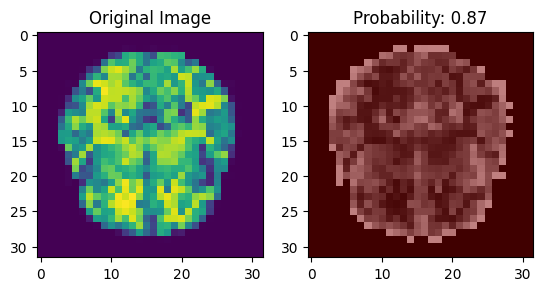

1/1 [==============================] - 0s 169ms/step


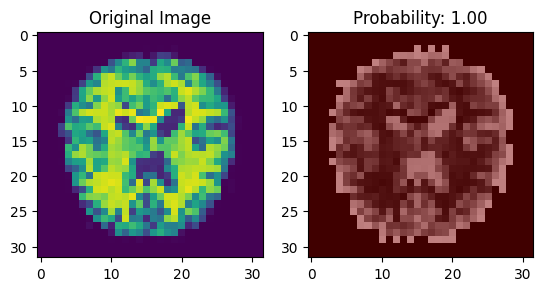

1/1 [==============================] - 0s 154ms/step


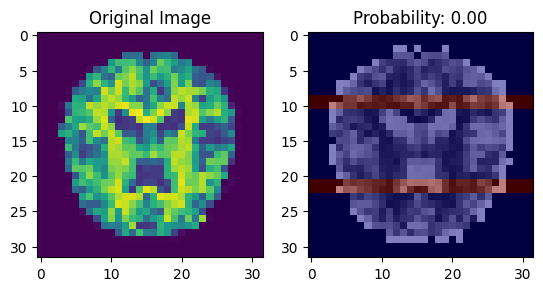

1/1 [==============================] - 0s 156ms/step


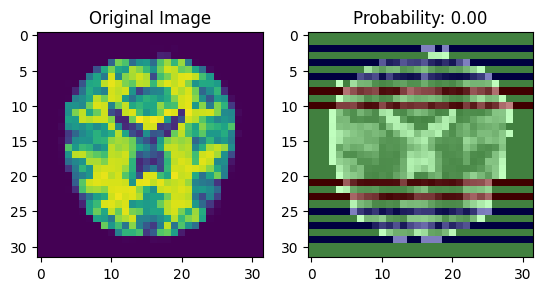

1/1 [==============================] - 0s 157ms/step


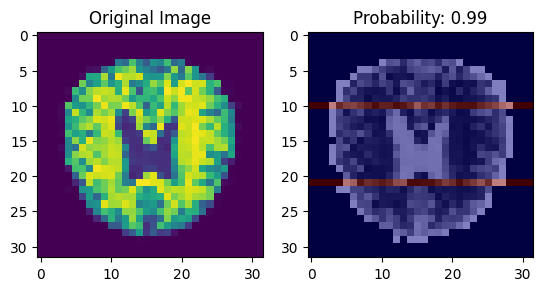

1/1 [==============================] - 0s 163ms/step


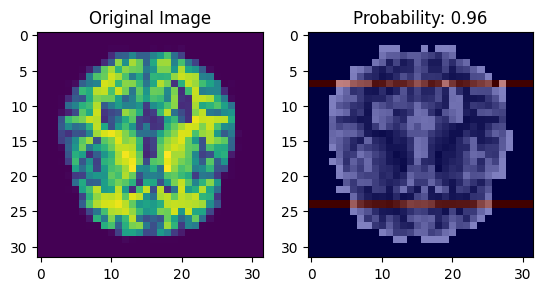

1/1 [==============================] - 0s 156ms/step


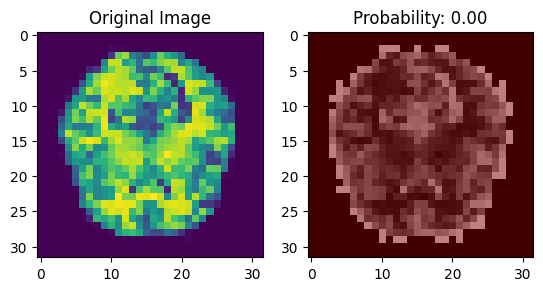

1/1 [==============================] - 0s 205ms/step


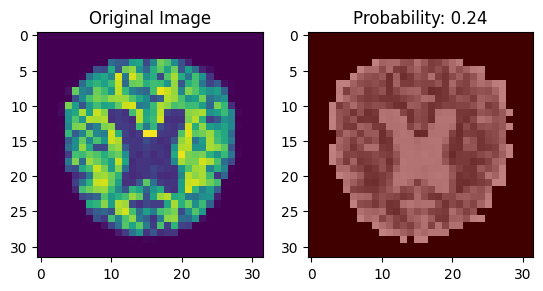

1/1 [==============================] - 0s 218ms/step


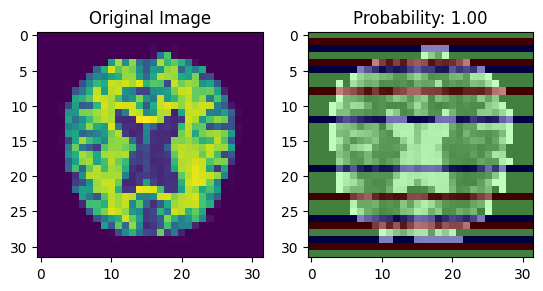

1/1 [==============================] - 0s 231ms/step


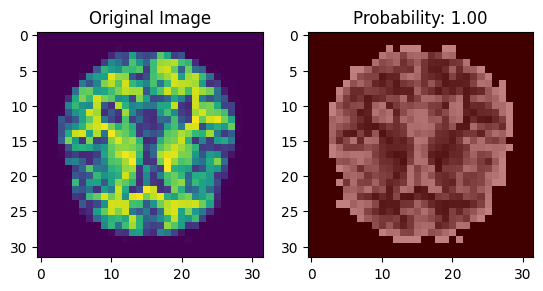

1/1 [==============================] - 0s 169ms/step


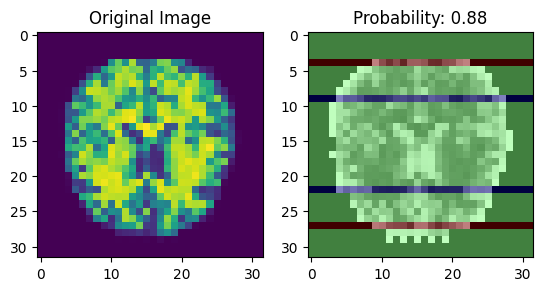

1/1 [==============================] - 0s 163ms/step


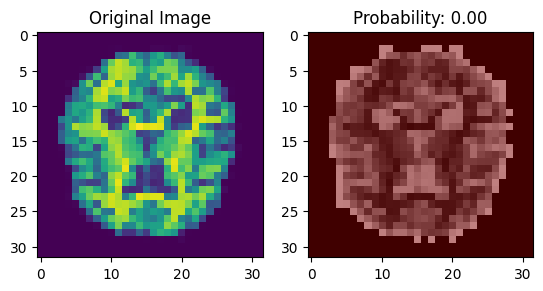

1/1 [==============================] - 0s 168ms/step


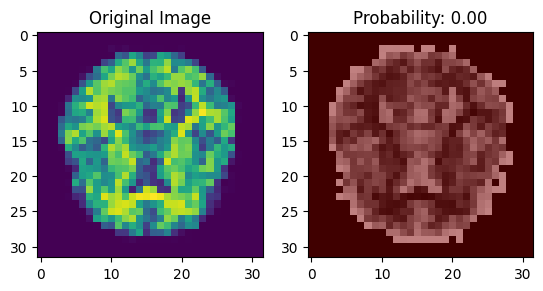

1/1 [==============================] - 0s 203ms/step


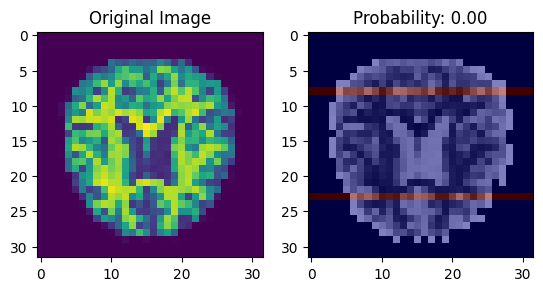

1/1 [==============================] - 0s 236ms/step


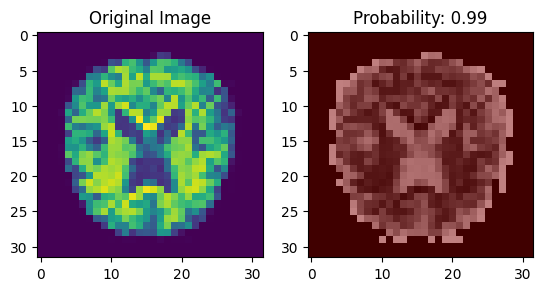

1/1 [==============================] - 0s 227ms/step


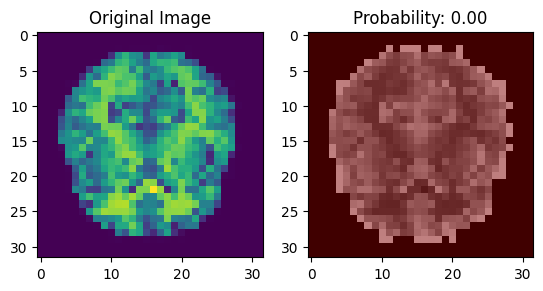

1/1 [==============================] - 0s 185ms/step


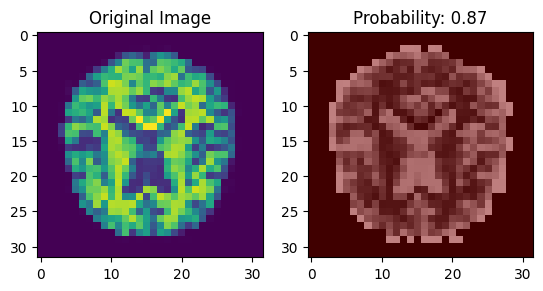

1/1 [==============================] - 0s 200ms/step


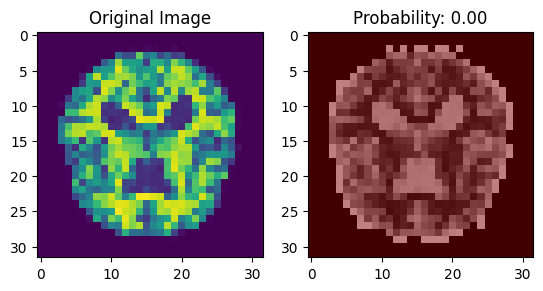

1/1 [==============================] - 0s 176ms/step


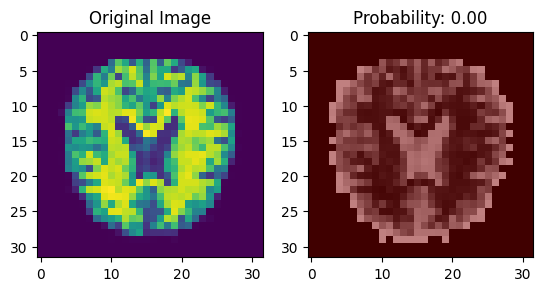

1/1 [==============================] - 0s 154ms/step


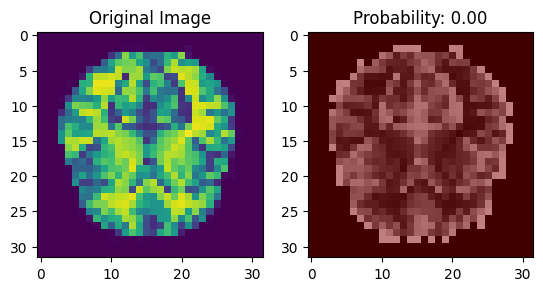

1/1 [==============================] - 0s 171ms/step


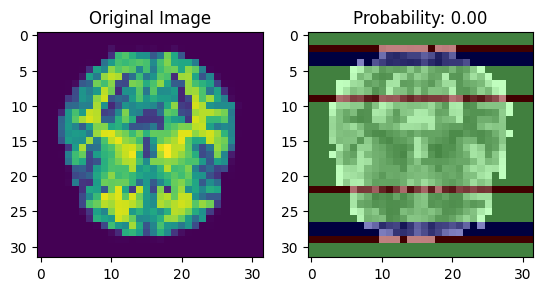

1/1 [==============================] - 0s 173ms/step


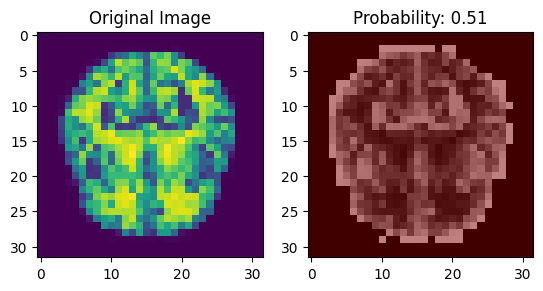

1/1 [==============================] - 0s 165ms/step


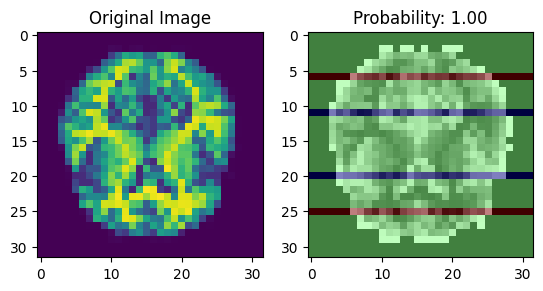

1/1 [==============================] - 0s 166ms/step


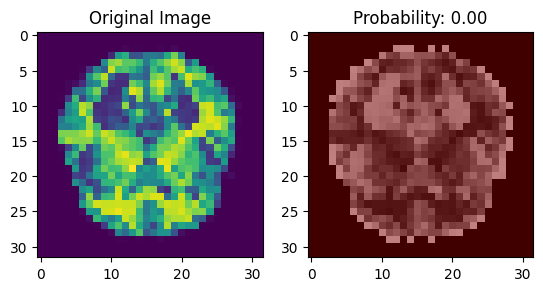

1/1 [==============================] - 0s 172ms/step


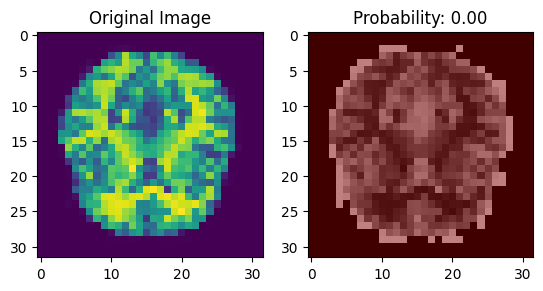

1/1 [==============================] - 0s 153ms/step


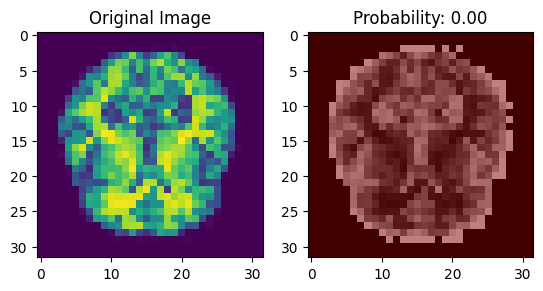

1/1 [==============================] - 0s 168ms/step


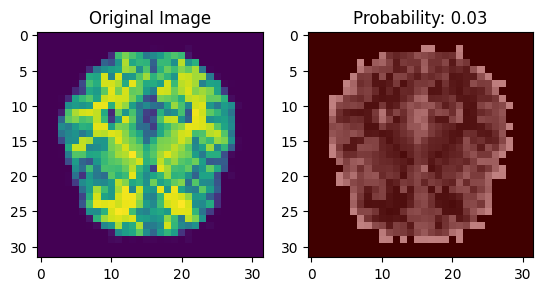

1/1 [==============================] - 1s 765ms/step


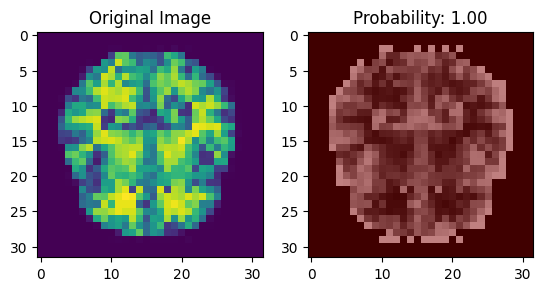

1/1 [==============================] - 0s 267ms/step


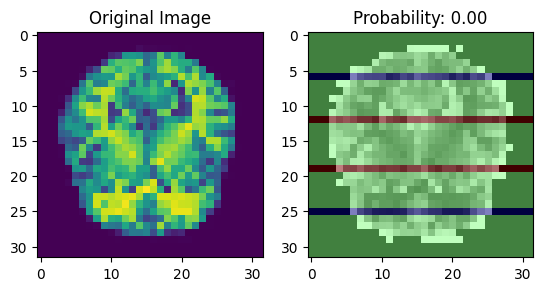

1/1 [==============================] - 0s 232ms/step


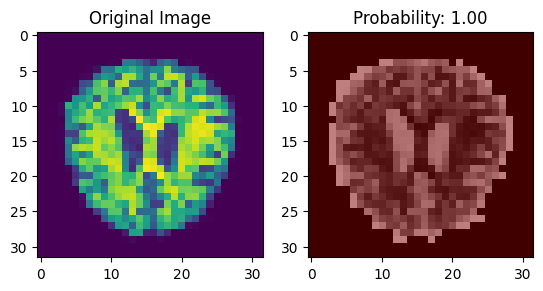

1/1 [==============================] - 0s 232ms/step


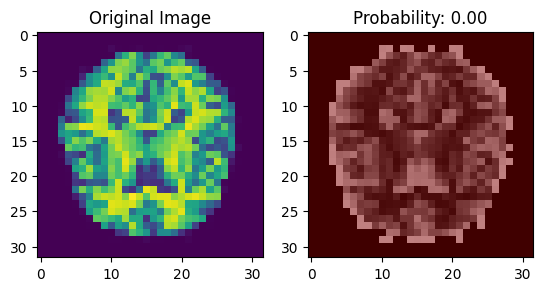

1/1 [==============================] - 0s 274ms/step


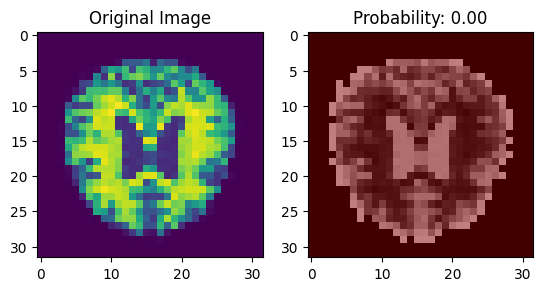

1/1 [==============================] - 0s 171ms/step


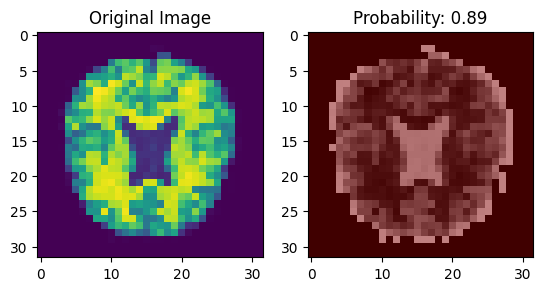

1/1 [==============================] - 0s 191ms/step


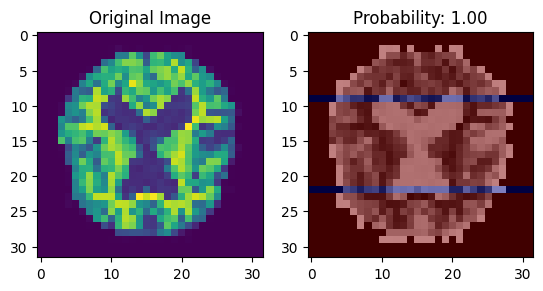

1/1 [==============================] - 0s 161ms/step


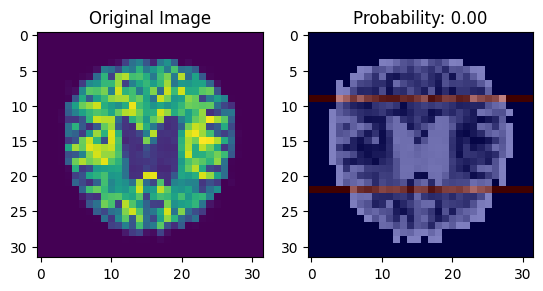

1/1 [==============================] - 0s 166ms/step


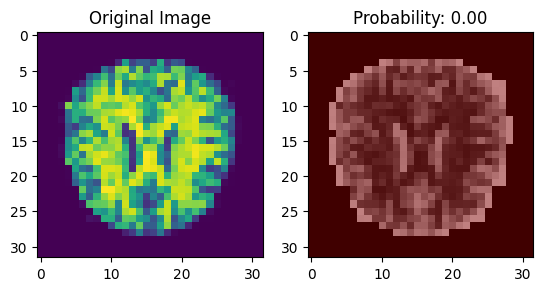

1/1 [==============================] - 0s 173ms/step


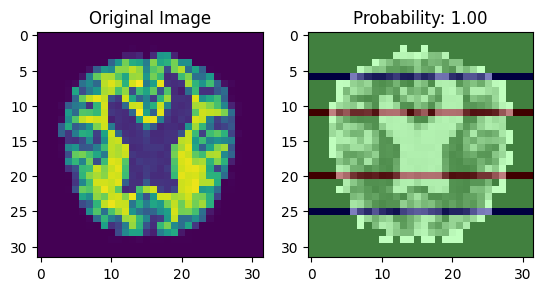

1/1 [==============================] - 0s 180ms/step


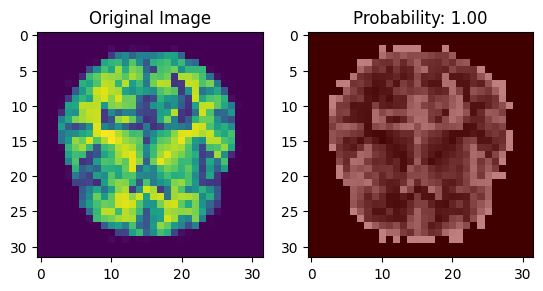

1/1 [==============================] - 0s 165ms/step


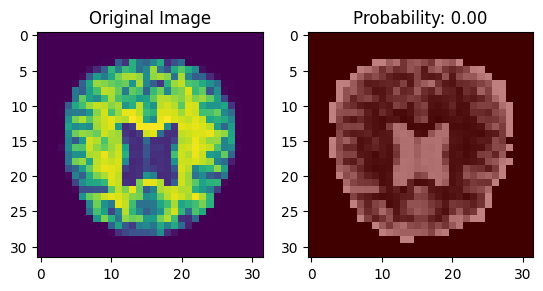

1/1 [==============================] - 0s 193ms/step


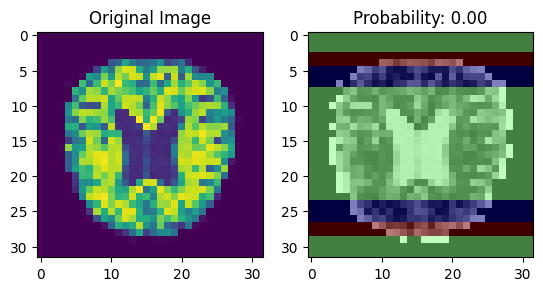

1/1 [==============================] - 0s 171ms/step


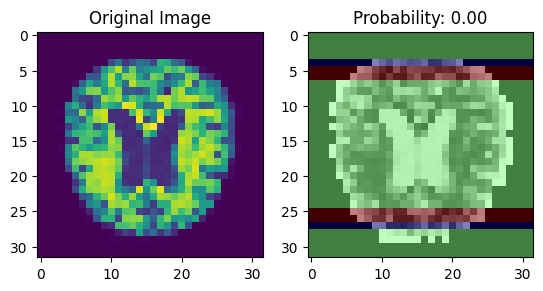

1/1 [==============================] - 0s 170ms/step


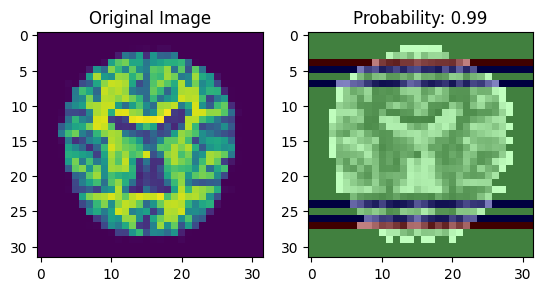

1/1 [==============================] - 0s 165ms/step


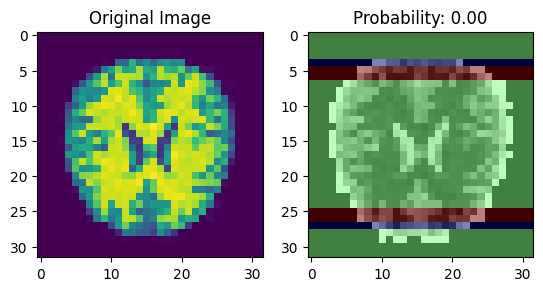

1/1 [==============================] - 0s 154ms/step


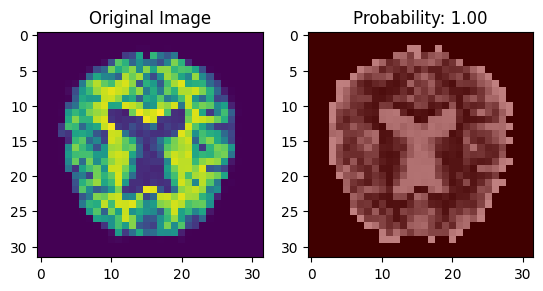

1/1 [==============================] - 0s 156ms/step


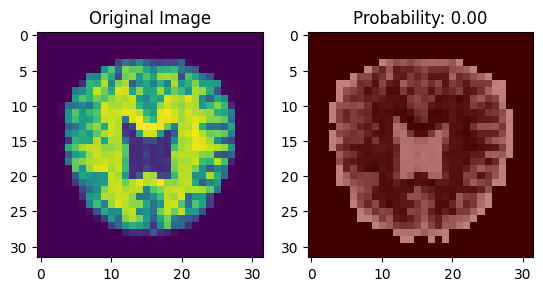

1/1 [==============================] - 0s 187ms/step


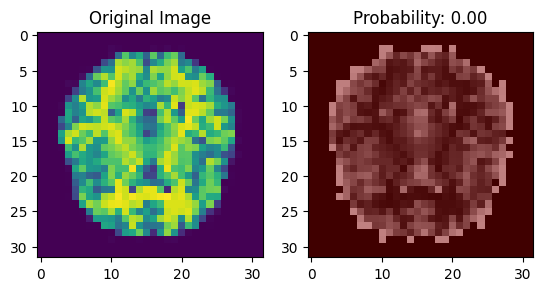

1/1 [==============================] - 0s 181ms/step


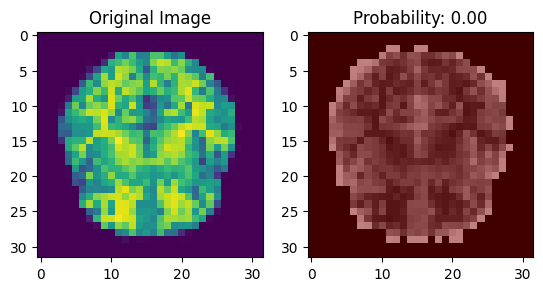

1/1 [==============================] - 0s 222ms/step


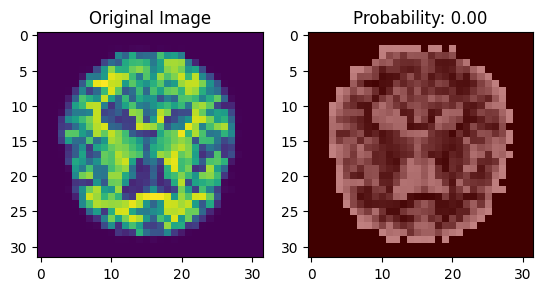

1/1 [==============================] - 0s 258ms/step


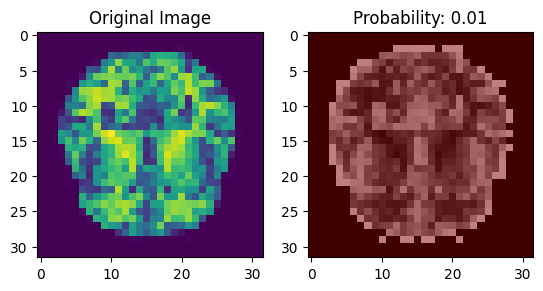

1/1 [==============================] - 0s 241ms/step


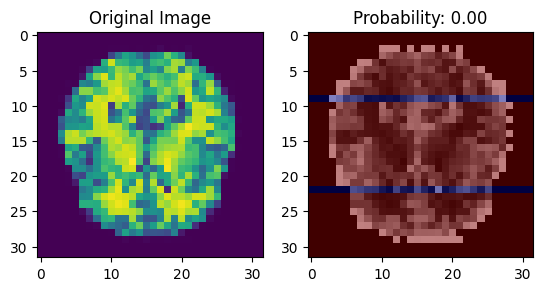

1/1 [==============================] - 0s 200ms/step


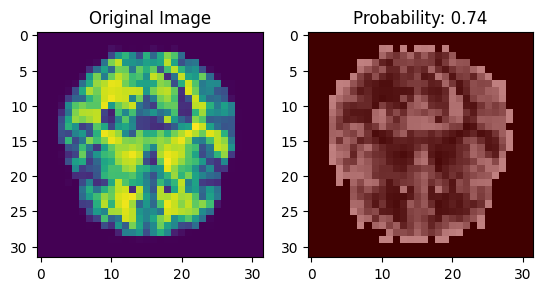

1/1 [==============================] - 0s 194ms/step


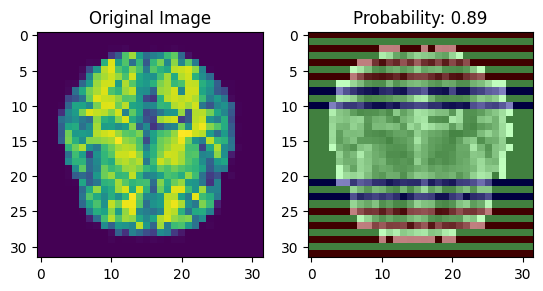

1/1 [==============================] - 0s 171ms/step


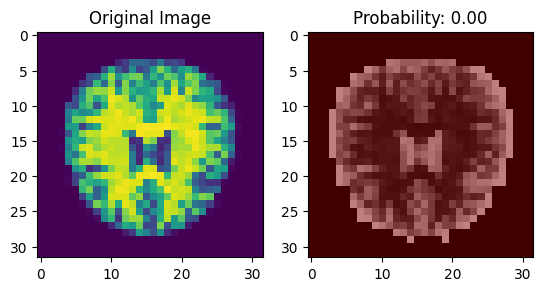

1/1 [==============================] - 0s 178ms/step


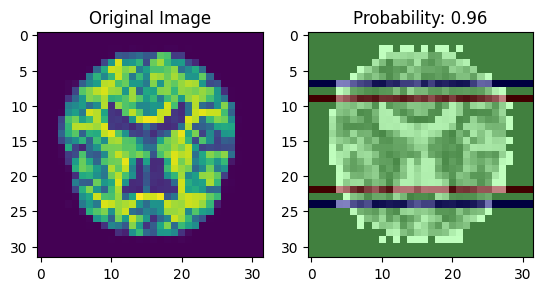

1/1 [==============================] - 0s 156ms/step


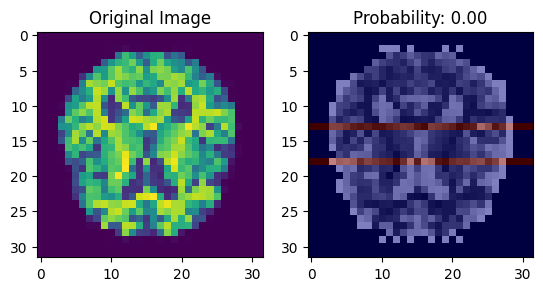

1/1 [==============================] - 0s 155ms/step


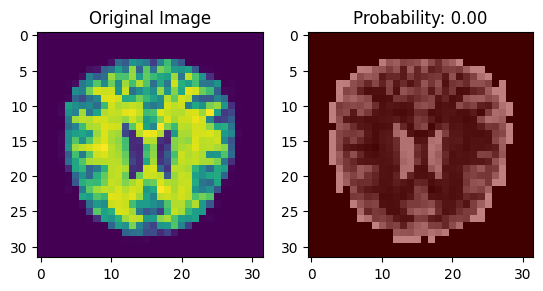

1/1 [==============================] - 0s 180ms/step


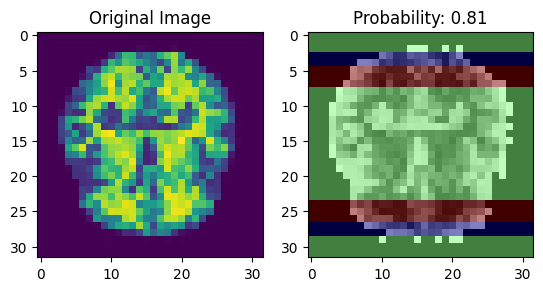

1/1 [==============================] - 0s 169ms/step


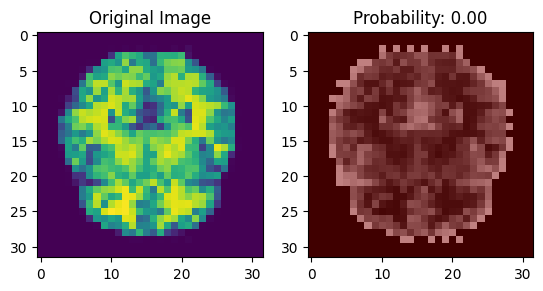

1/1 [==============================] - 0s 162ms/step


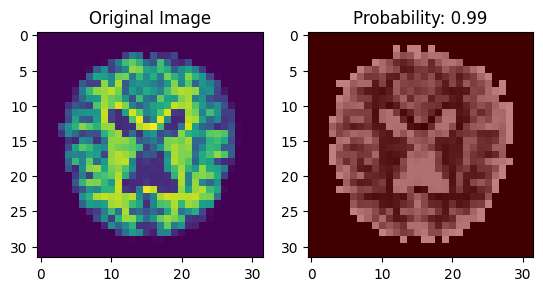

1/1 [==============================] - 0s 156ms/step


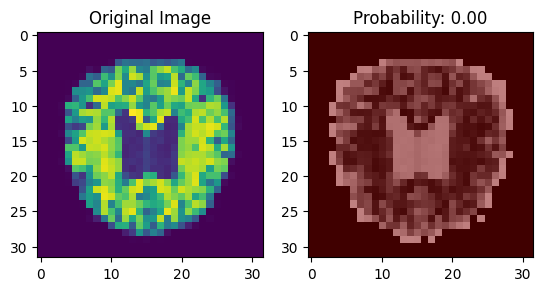

1/1 [==============================] - 0s 163ms/step


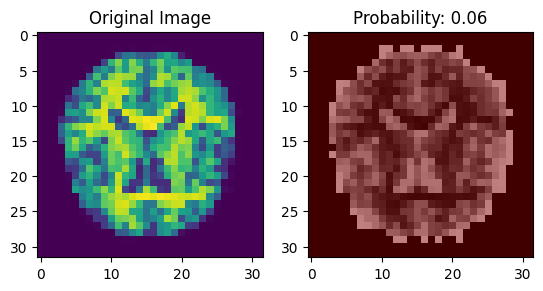

1/1 [==============================] - 0s 180ms/step


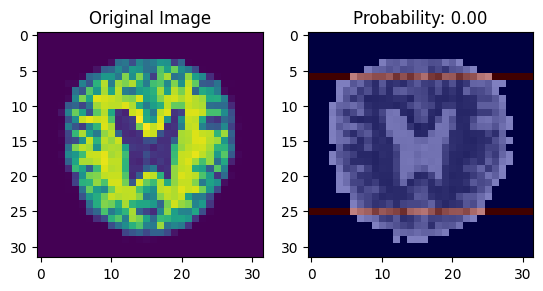

1/1 [==============================] - 0s 251ms/step


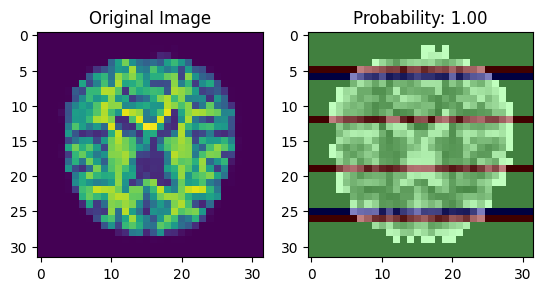

1/1 [==============================] - 0s 168ms/step


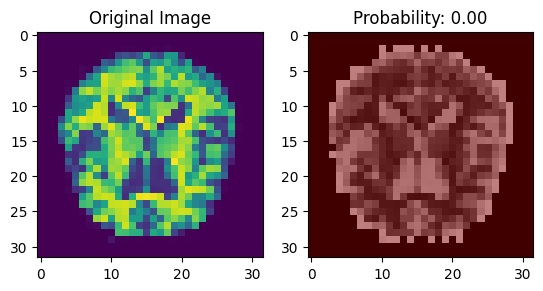

1/1 [==============================] - 0s 223ms/step


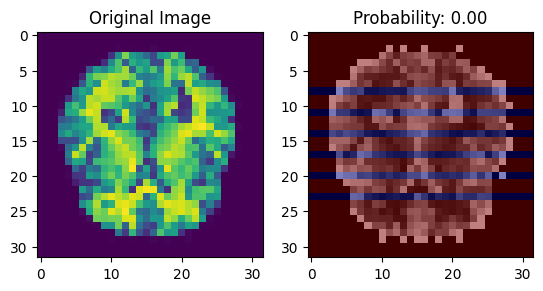

1/1 [==============================] - 0s 188ms/step


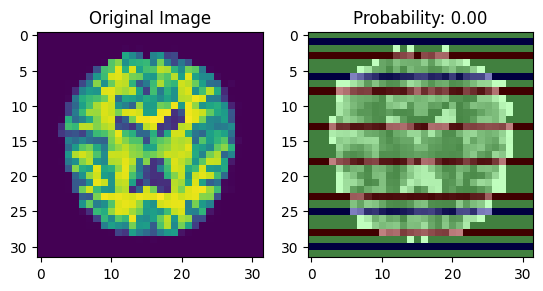

1/1 [==============================] - 0s 185ms/step


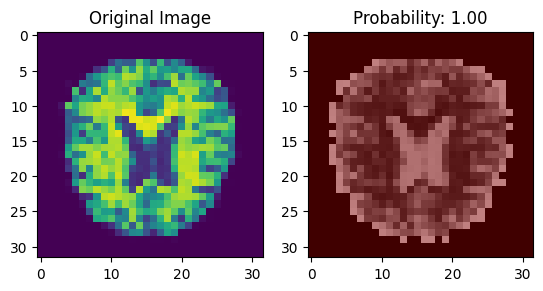

1/1 [==============================] - 0s 172ms/step


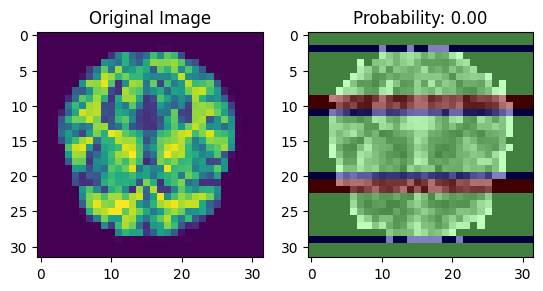

1/1 [==============================] - 0s 237ms/step


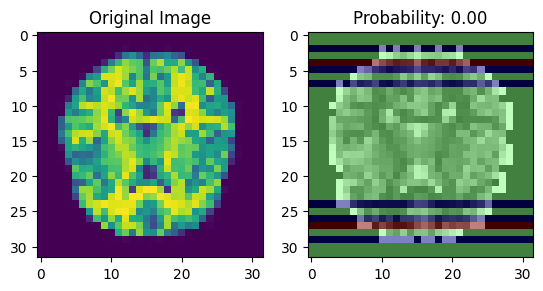

1/1 [==============================] - 0s 212ms/step


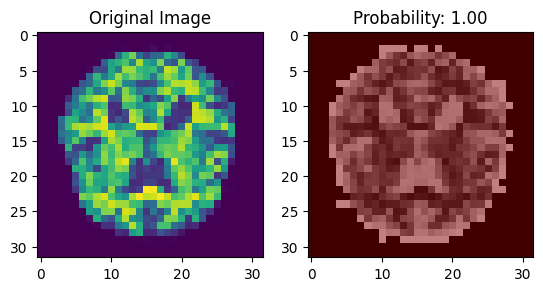

1/1 [==============================] - 0s 225ms/step


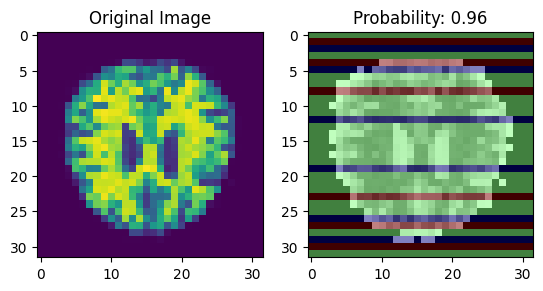

1/1 [==============================] - 0s 219ms/step


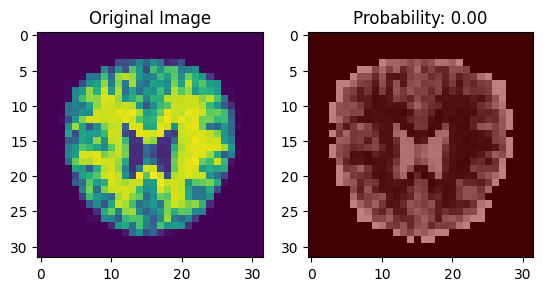

1/1 [==============================] - 0s 177ms/step


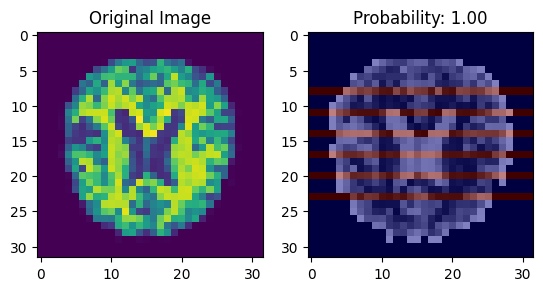

1/1 [==============================] - 0s 179ms/step


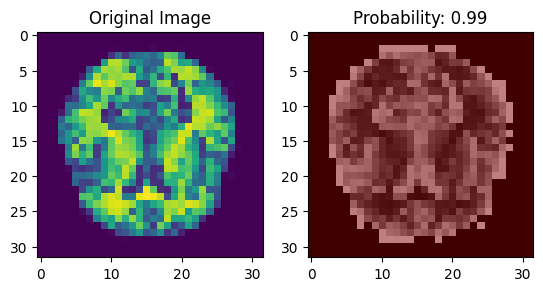

1/1 [==============================] - 0s 184ms/step


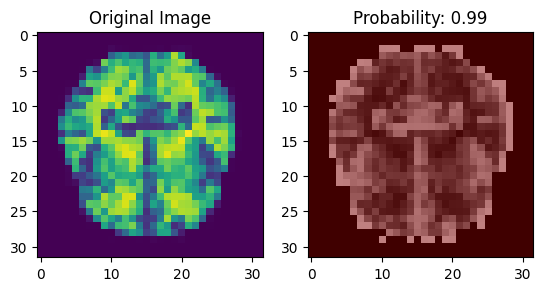

1/1 [==============================] - 0s 182ms/step


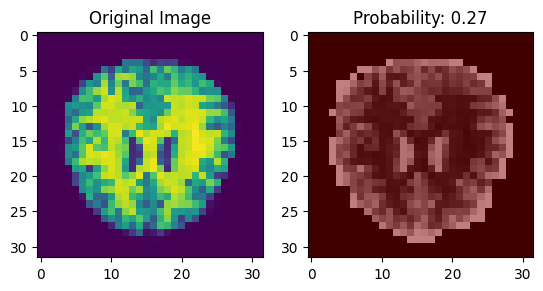

1/1 [==============================] - 0s 207ms/step


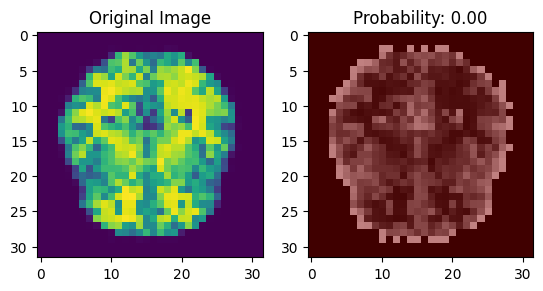

1/1 [==============================] - 0s 164ms/step


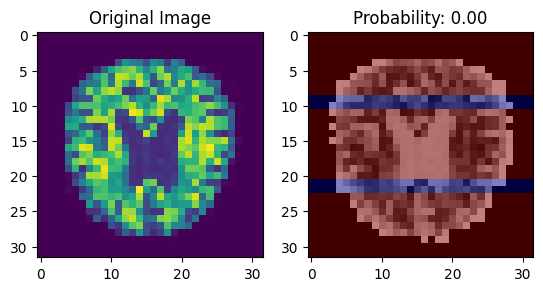

1/1 [==============================] - 0s 193ms/step


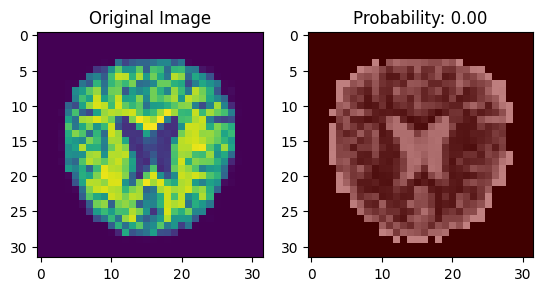

1/1 [==============================] - 0s 172ms/step


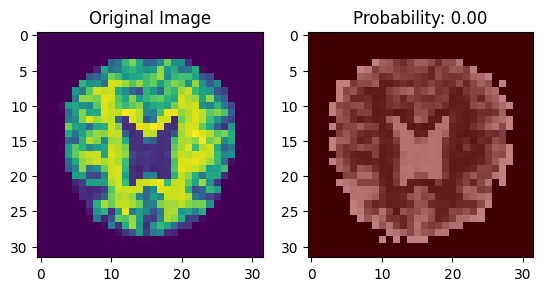

1/1 [==============================] - 0s 195ms/step


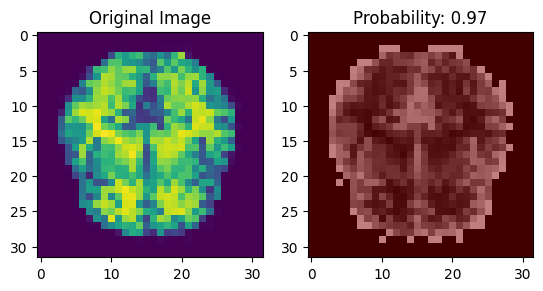

1/1 [==============================] - 0s 197ms/step


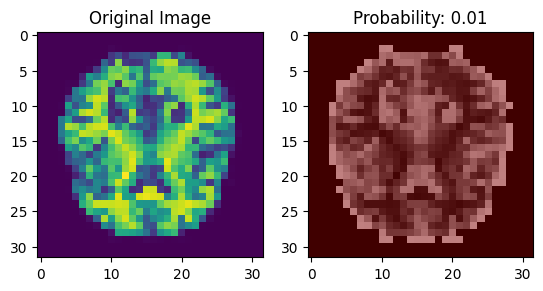

1/1 [==============================] - 0s 169ms/step


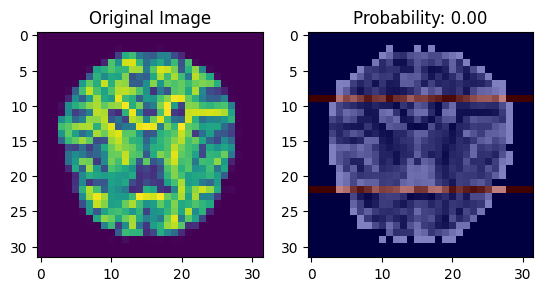

1/1 [==============================] - 0s 174ms/step


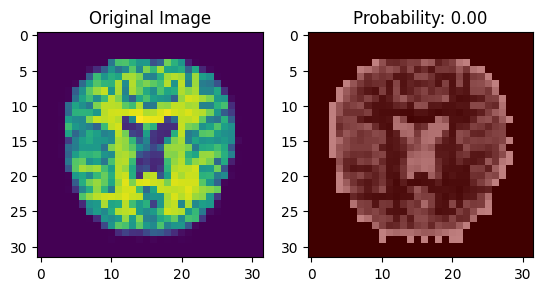

1/1 [==============================] - 0s 165ms/step


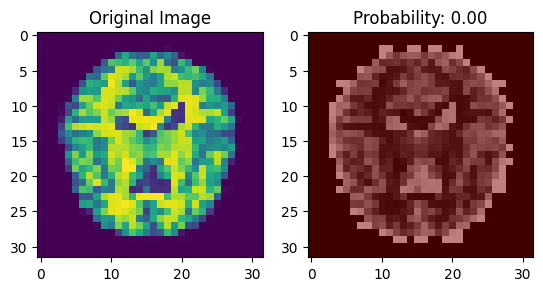

1/1 [==============================] - 0s 157ms/step


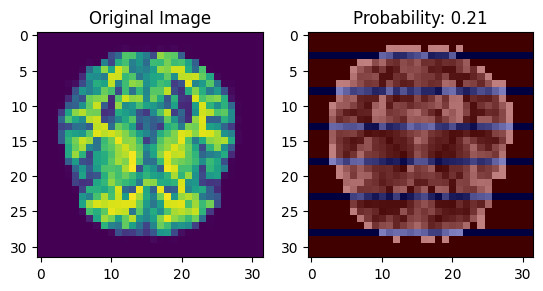

1/1 [==============================] - 0s 157ms/step


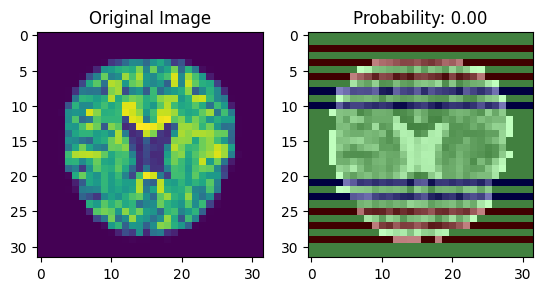

1/1 [==============================] - 0s 191ms/step


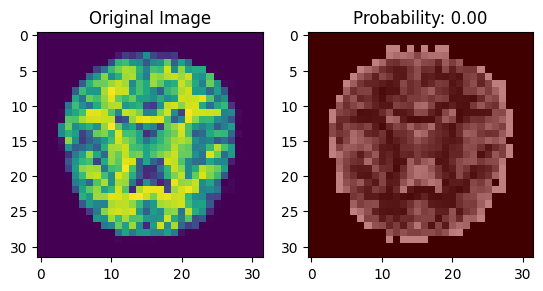

1/1 [==============================] - 0s 236ms/step


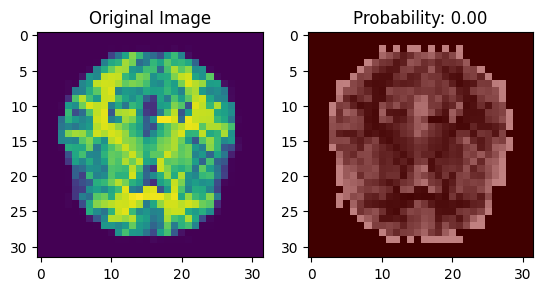

1/1 [==============================] - 0s 229ms/step


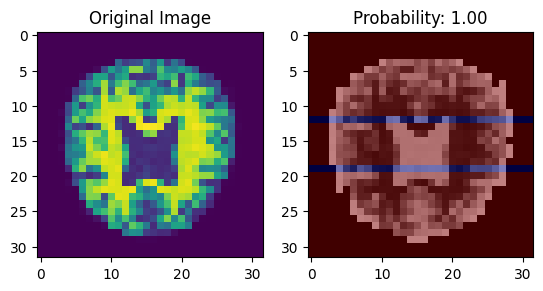

1/1 [==============================] - 0s 185ms/step


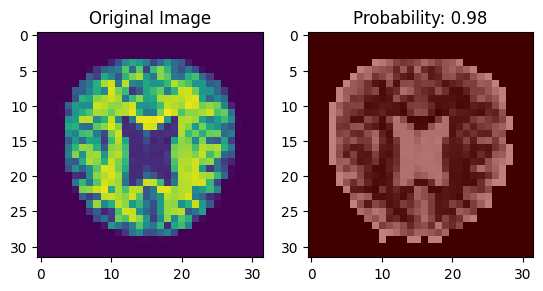

1/1 [==============================] - 0s 177ms/step


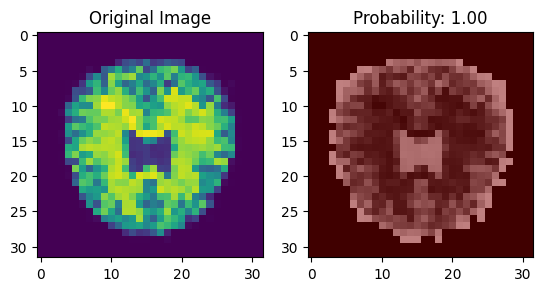

1/1 [==============================] - 0s 208ms/step


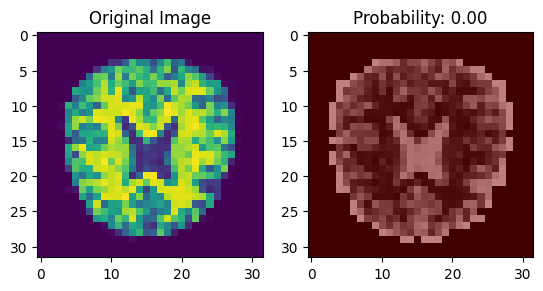

1/1 [==============================] - 0s 217ms/step


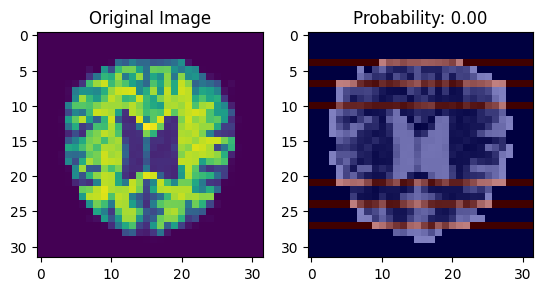

1/1 [==============================] - 0s 267ms/step


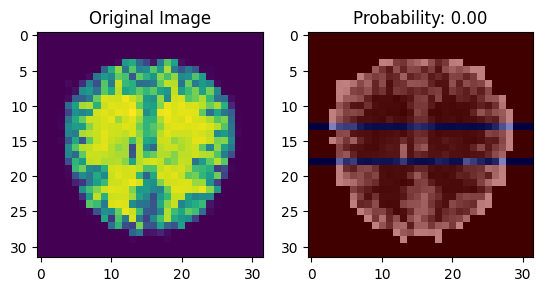

1/1 [==============================] - 0s 220ms/step


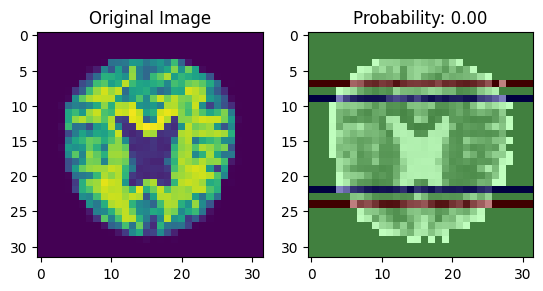

1/1 [==============================] - 0s 214ms/step


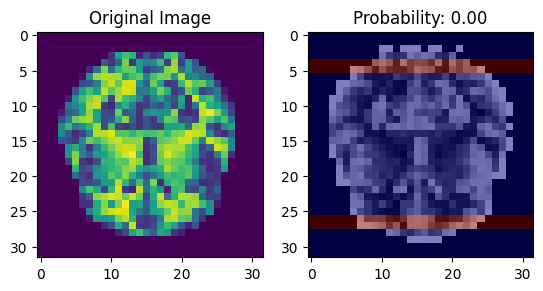

1/1 [==============================] - 0s 171ms/step


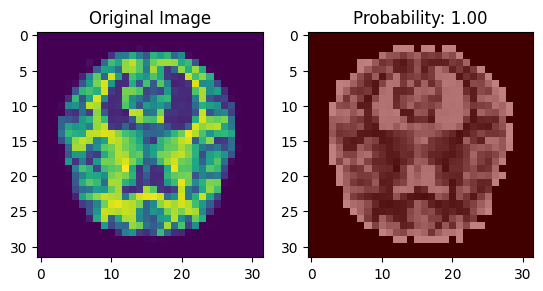

1/1 [==============================] - 0s 197ms/step


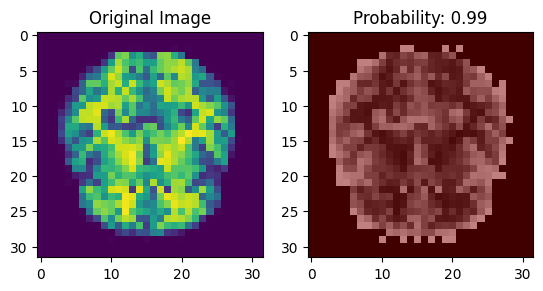

1/1 [==============================] - 0s 176ms/step


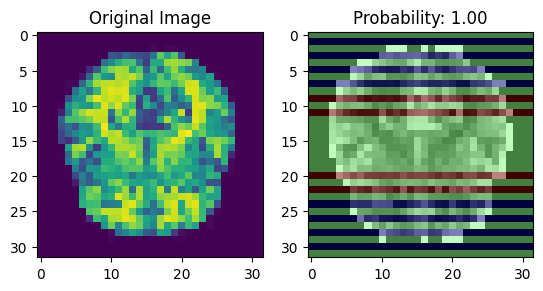

1/1 [==============================] - 0s 165ms/step


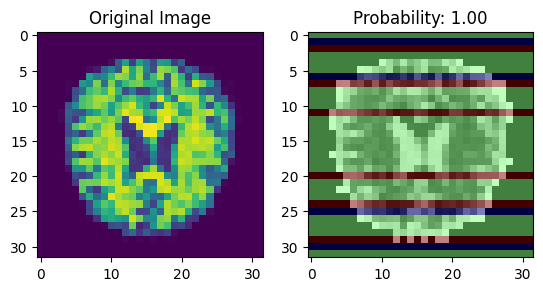

1/1 [==============================] - 0s 170ms/step


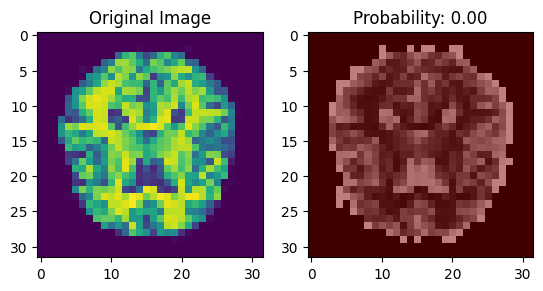

1/1 [==============================] - 0s 166ms/step


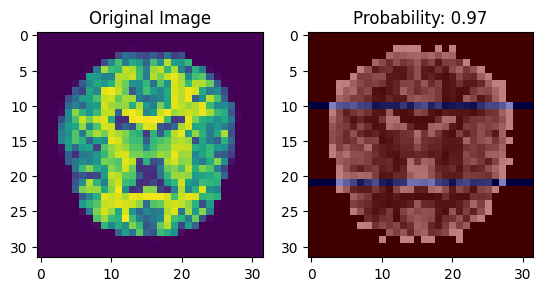

1/1 [==============================] - 0s 166ms/step


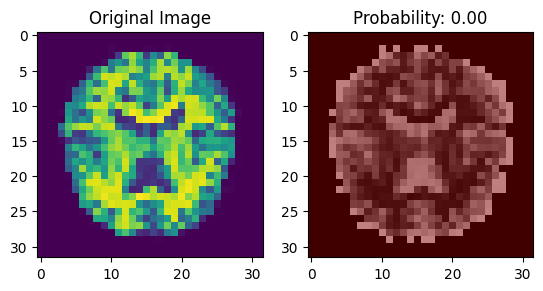

1/1 [==============================] - 0s 155ms/step


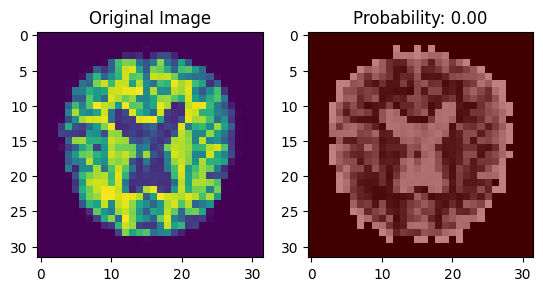

1/1 [==============================] - 0s 164ms/step


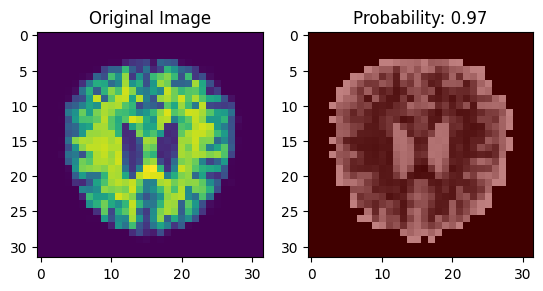

1/1 [==============================] - 0s 167ms/step


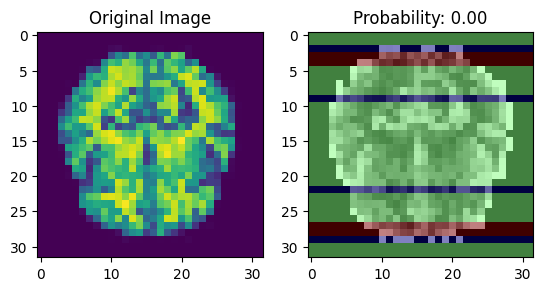

1/1 [==============================] - 0s 168ms/step


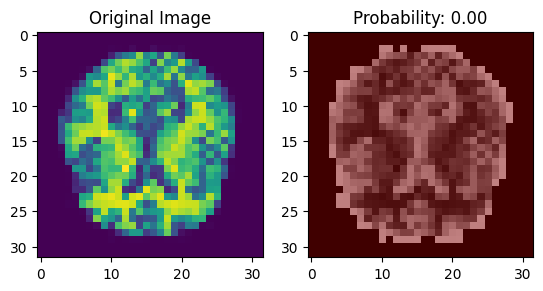

1/1 [==============================] - 0s 175ms/step


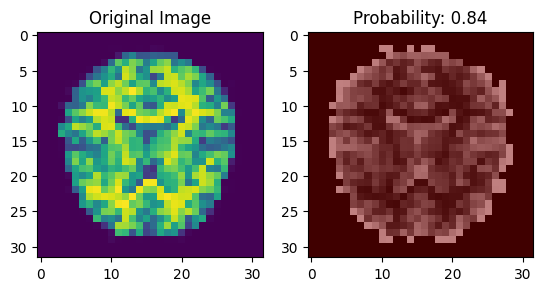

1/1 [==============================] - 0s 161ms/step


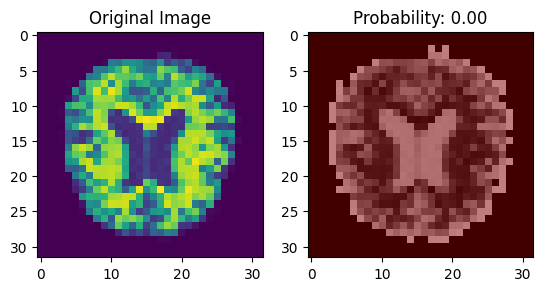

1/1 [==============================] - 0s 278ms/step


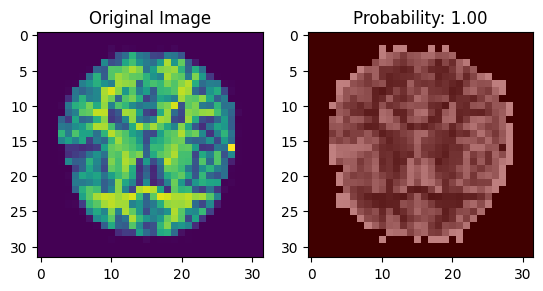

1/1 [==============================] - 0s 223ms/step


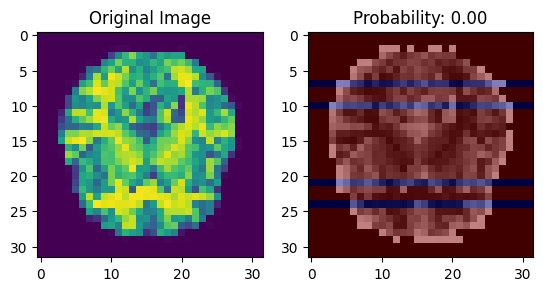

1/1 [==============================] - 0s 298ms/step


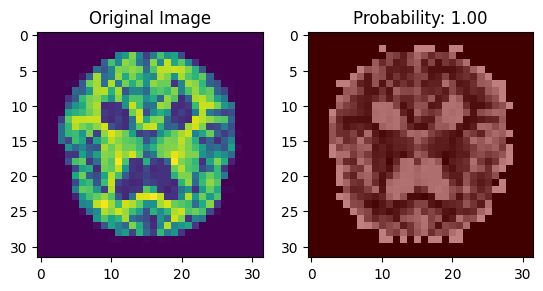

1/1 [==============================] - 0s 183ms/step


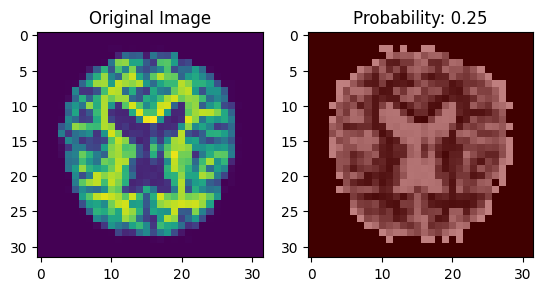

1/1 [==============================] - 0s 173ms/step


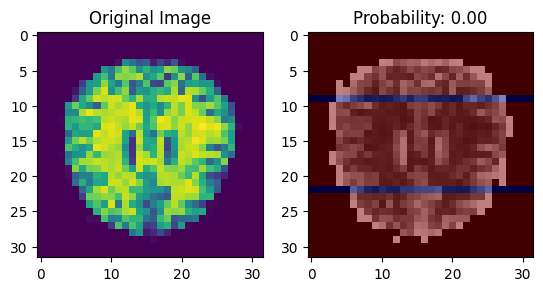

1/1 [==============================] - 0s 194ms/step


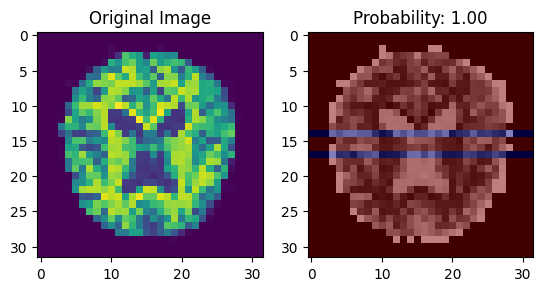

1/1 [==============================] - 0s 160ms/step


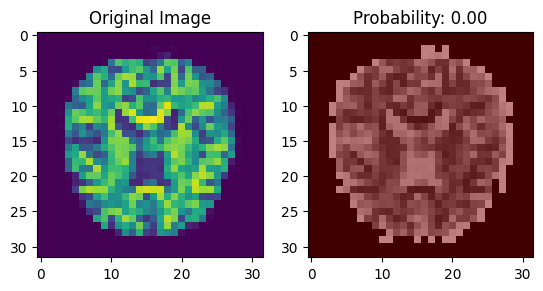

1/1 [==============================] - 0s 154ms/step


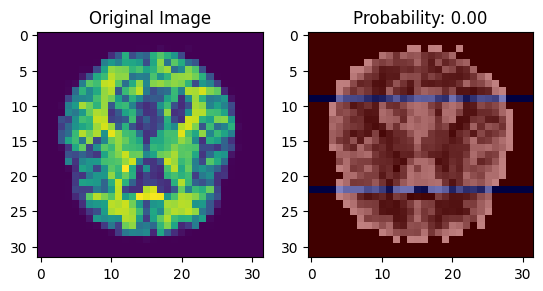

1/1 [==============================] - 0s 166ms/step


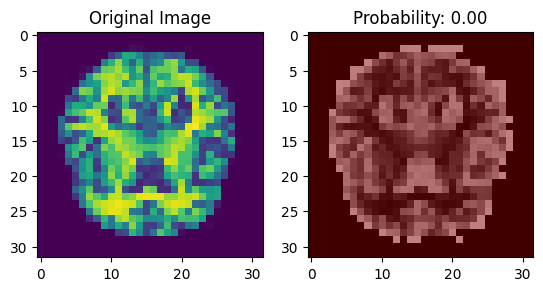

1/1 [==============================] - 0s 161ms/step


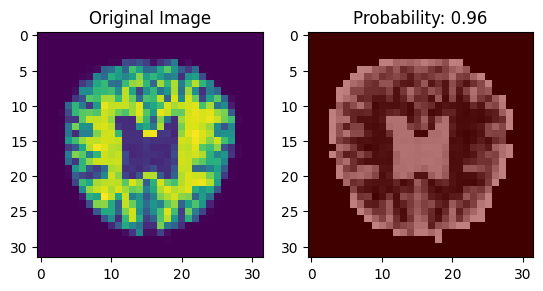

1/1 [==============================] - 0s 153ms/step


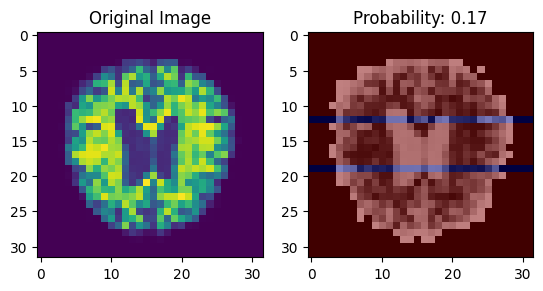

1/1 [==============================] - 0s 172ms/step


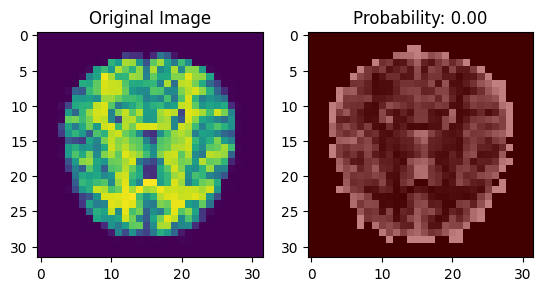

1/1 [==============================] - 0s 162ms/step


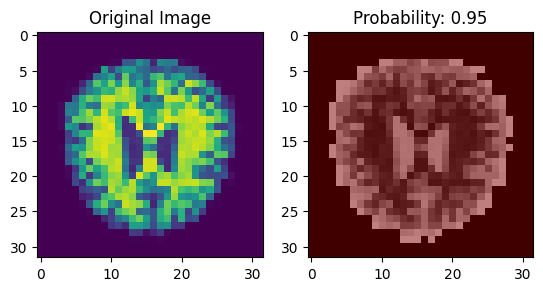

1/1 [==============================] - 0s 159ms/step


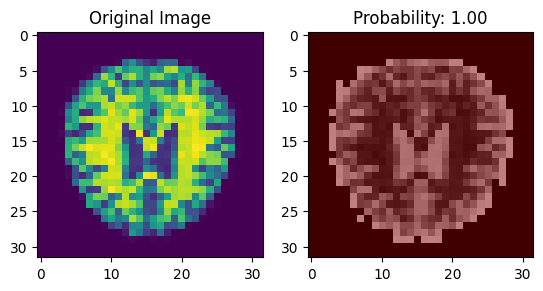

1/1 [==============================] - 0s 172ms/step


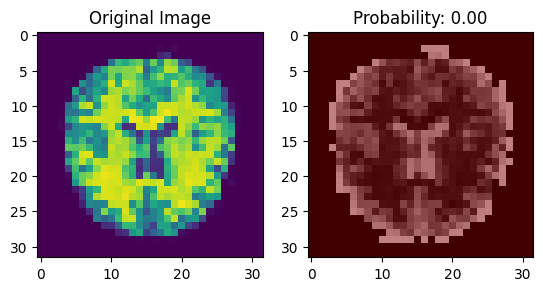

1/1 [==============================] - 0s 188ms/step


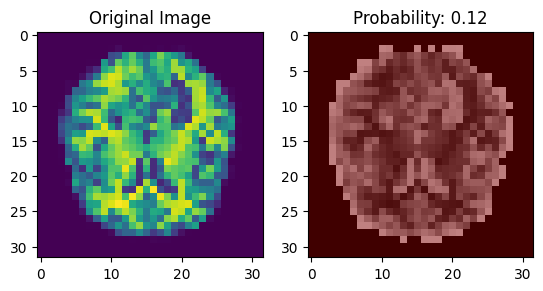

1/1 [==============================] - 0s 262ms/step


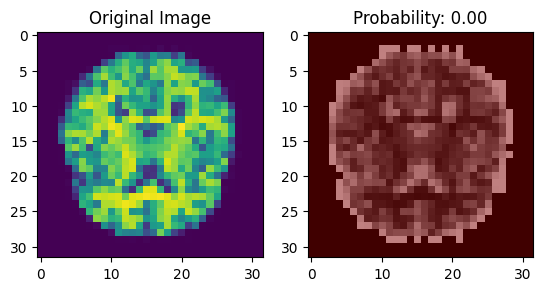

1/1 [==============================] - 0s 162ms/step


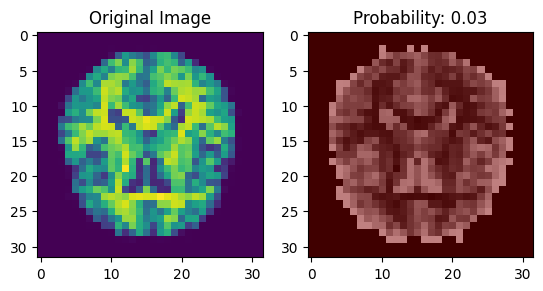

1/1 [==============================] - 0s 208ms/step


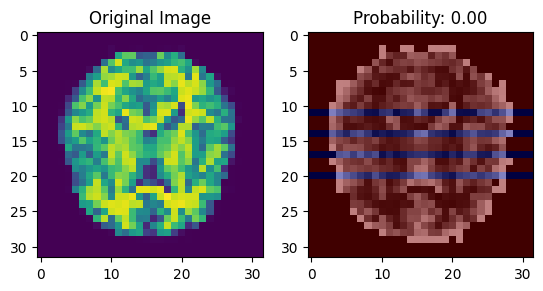

1/1 [==============================] - 0s 286ms/step


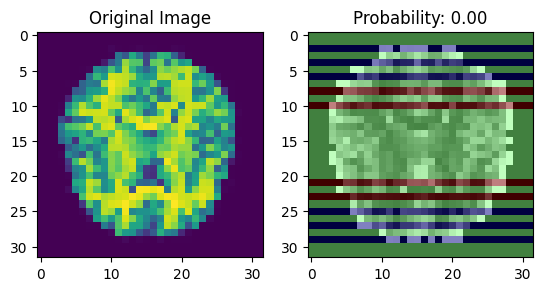

1/1 [==============================] - 0s 234ms/step


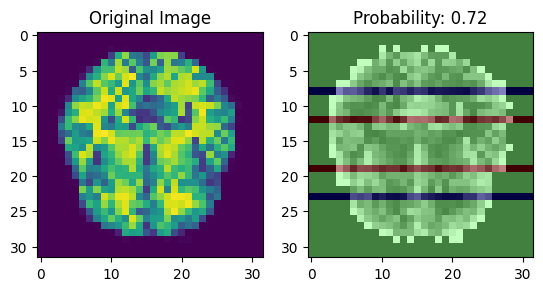

1/1 [==============================] - 0s 200ms/step


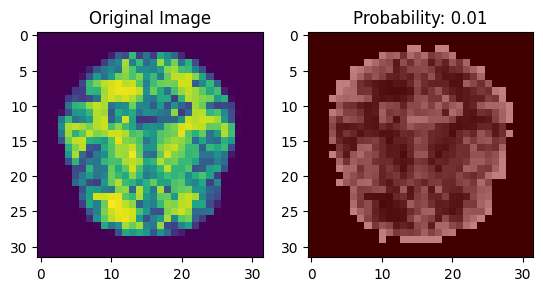

1/1 [==============================] - 0s 184ms/step


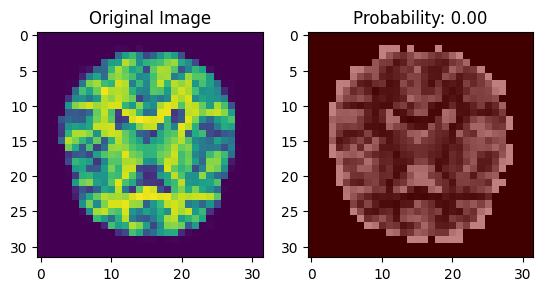

1/1 [==============================] - 0s 168ms/step


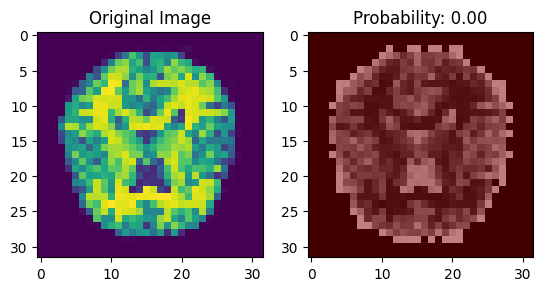

1/1 [==============================] - 0s 163ms/step


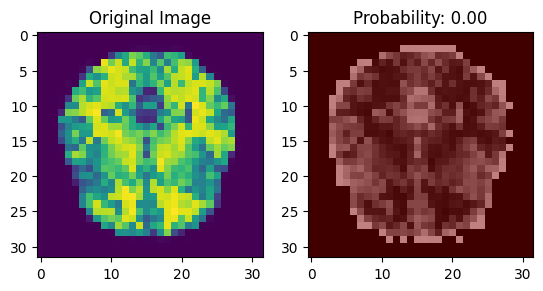

1/1 [==============================] - 0s 156ms/step


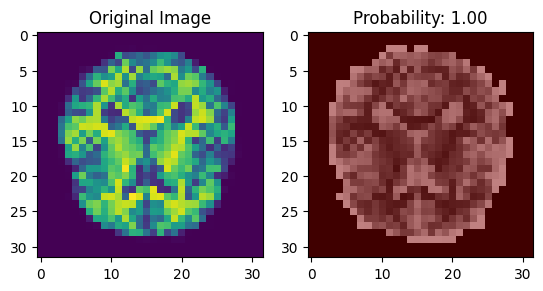

1/1 [==============================] - 0s 161ms/step


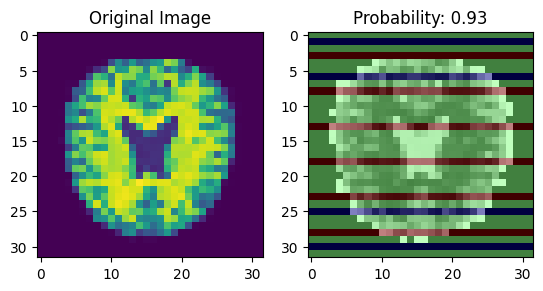

1/1 [==============================] - 0s 155ms/step


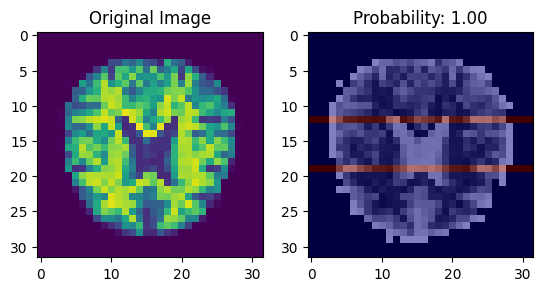

1/1 [==============================] - 0s 181ms/step


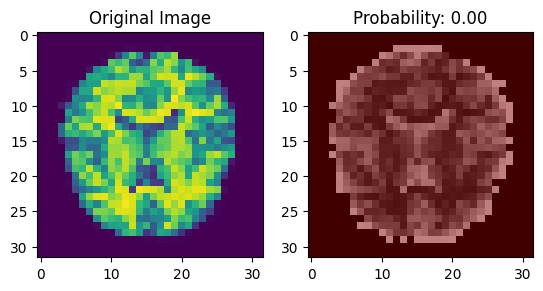

1/1 [==============================] - 0s 162ms/step


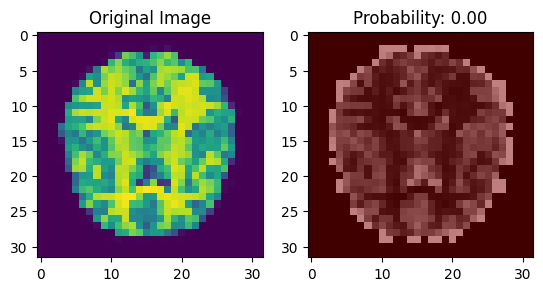

1/1 [==============================] - 0s 157ms/step


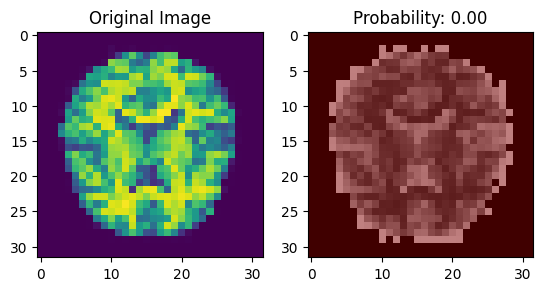

1/1 [==============================] - 0s 176ms/step


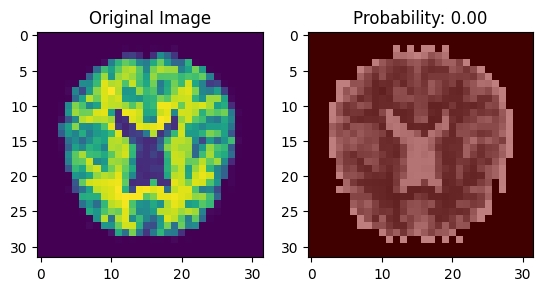

1/1 [==============================] - 0s 165ms/step


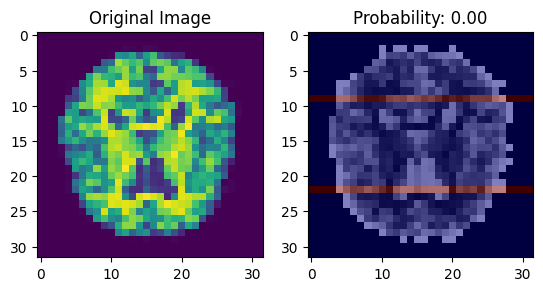

1/1 [==============================] - 0s 169ms/step


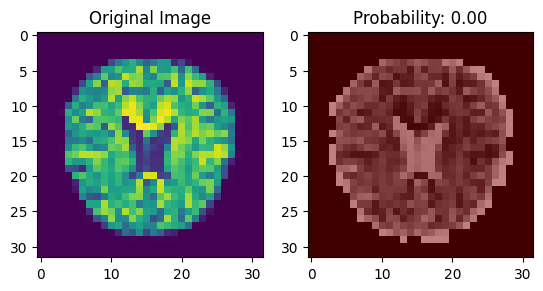

1/1 [==============================] - 0s 190ms/step


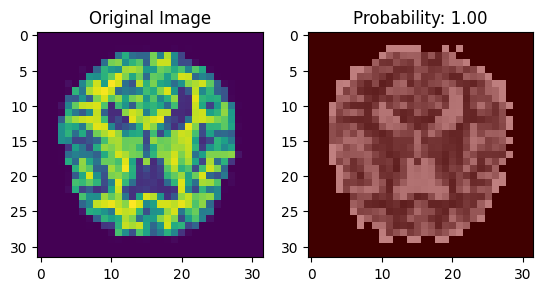

1/1 [==============================] - 0s 239ms/step


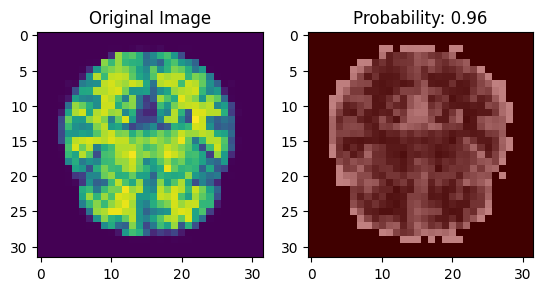

1/1 [==============================] - 0s 237ms/step


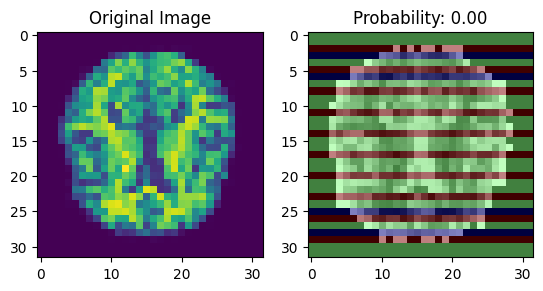

1/1 [==============================] - 0s 162ms/step


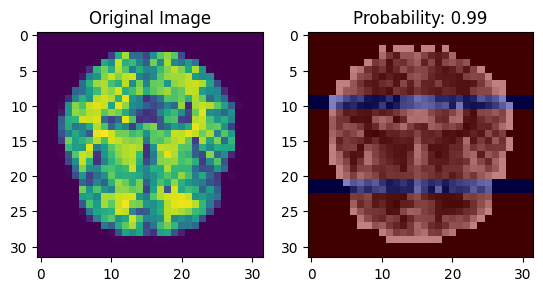

1/1 [==============================] - 0s 178ms/step


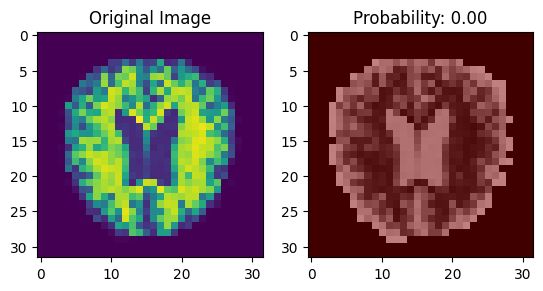

1/1 [==============================] - 0s 198ms/step


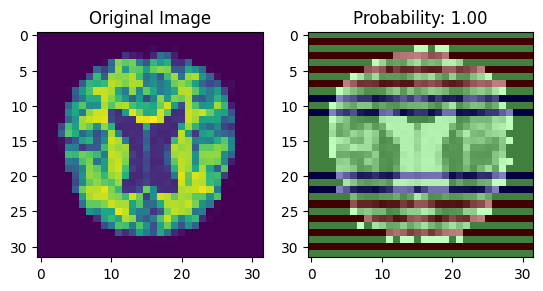

1/1 [==============================] - 0s 195ms/step


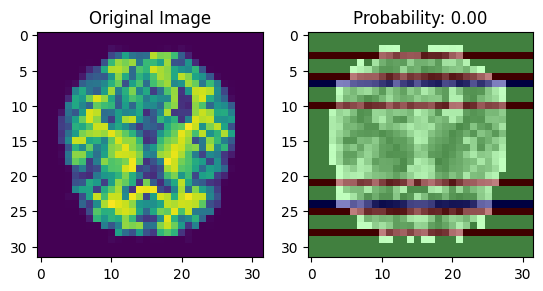

1/1 [==============================] - 0s 210ms/step


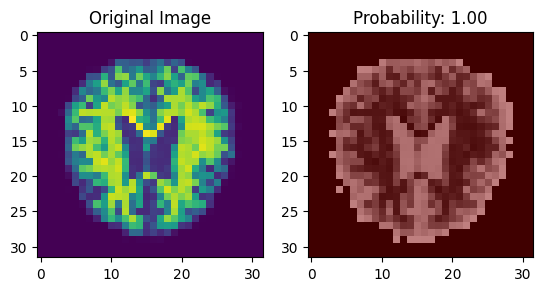

1/1 [==============================] - 0s 178ms/step


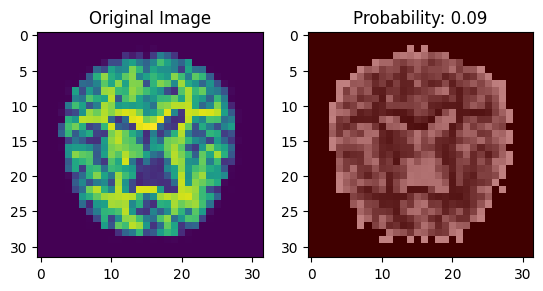

1/1 [==============================] - 0s 184ms/step


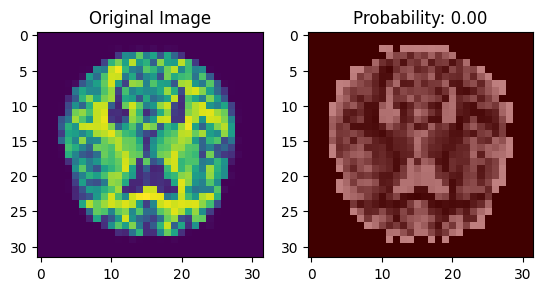

1/1 [==============================] - 0s 170ms/step


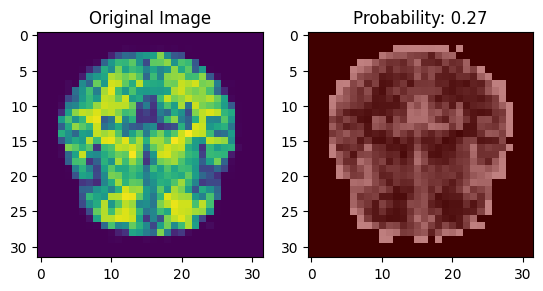

1/1 [==============================] - 0s 180ms/step


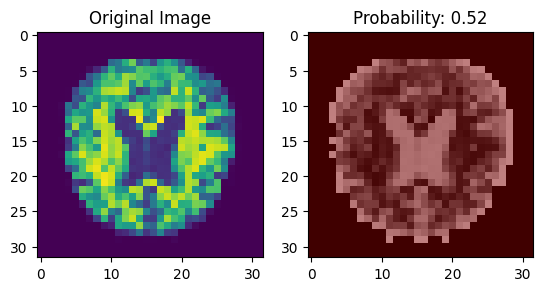

1/1 [==============================] - 0s 164ms/step


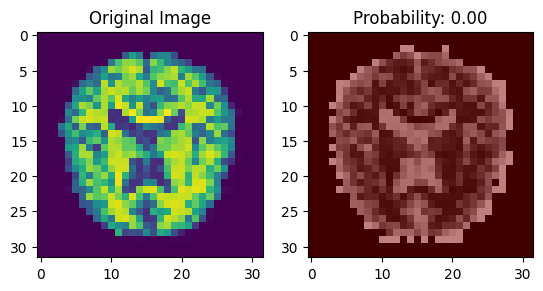

1/1 [==============================] - 0s 162ms/step


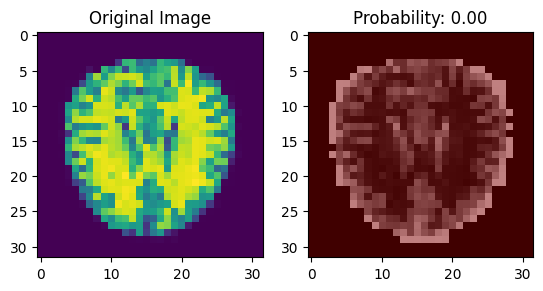

1/1 [==============================] - 0s 266ms/step


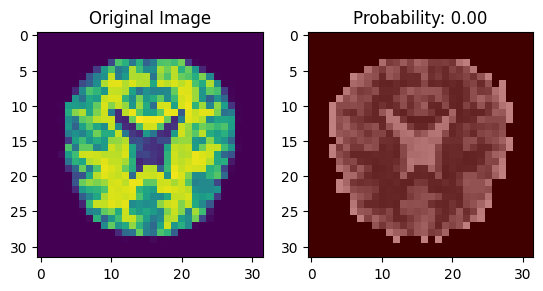

1/1 [==============================] - 0s 179ms/step


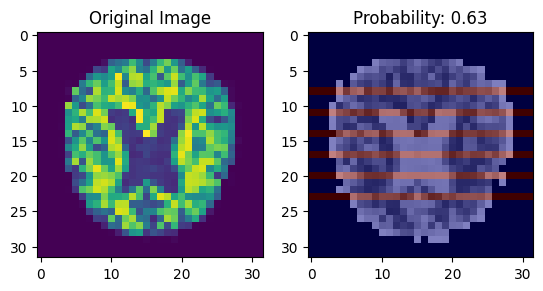

1/1 [==============================] - 0s 197ms/step


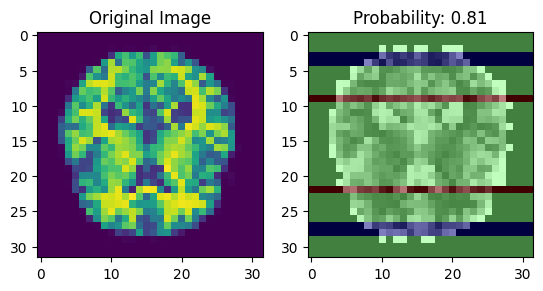

1/1 [==============================] - 0s 192ms/step


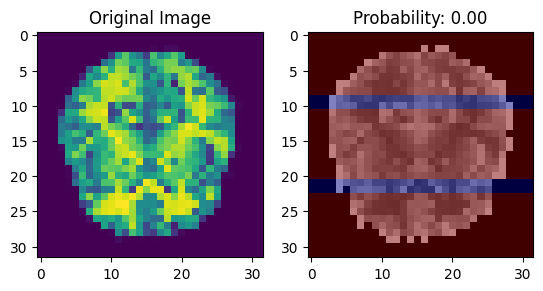

1/1 [==============================] - 0s 185ms/step


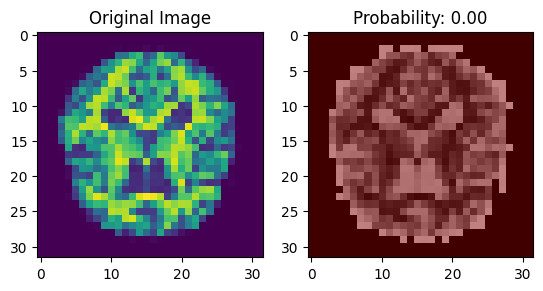

1/1 [==============================] - 0s 245ms/step


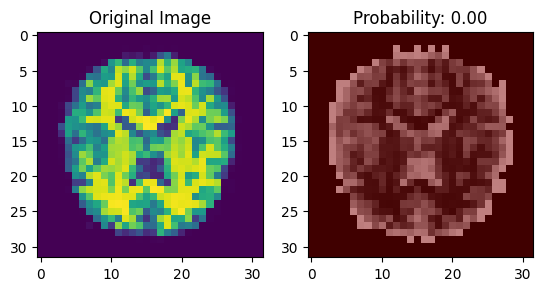

1/1 [==============================] - 0s 183ms/step


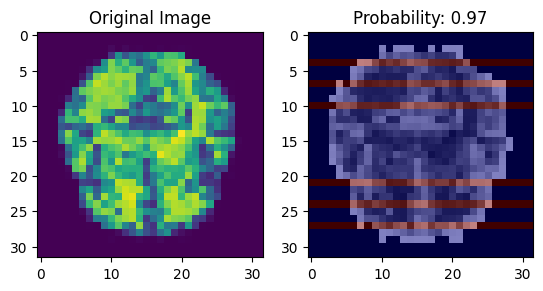

1/1 [==============================] - 0s 164ms/step


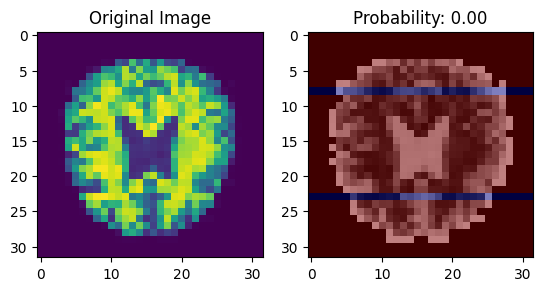

1/1 [==============================] - 0s 164ms/step


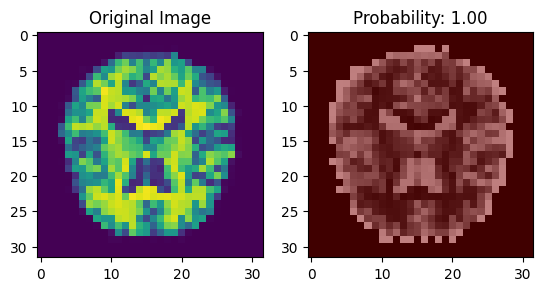

1/1 [==============================] - 0s 154ms/step


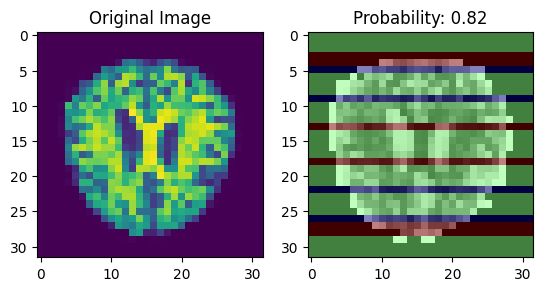

1/1 [==============================] - 0s 156ms/step


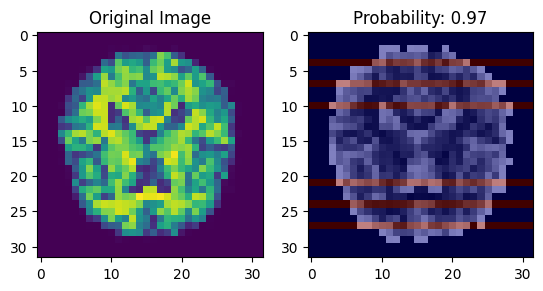

1/1 [==============================] - 0s 163ms/step


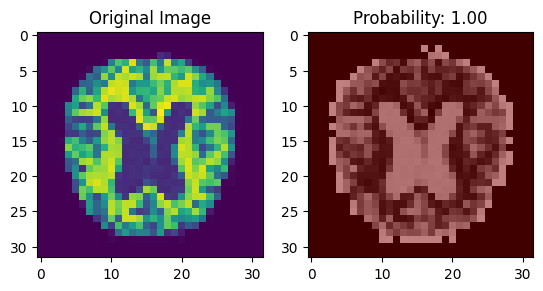

1/1 [==============================] - 0s 196ms/step


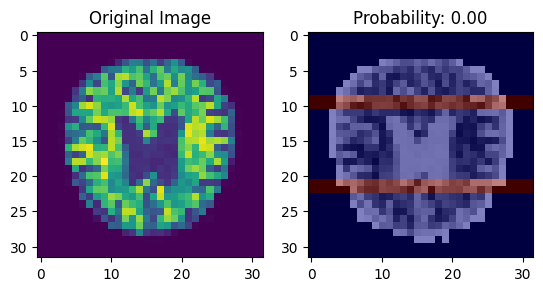

1/1 [==============================] - 0s 195ms/step


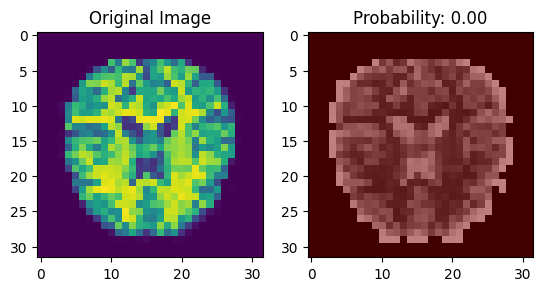

1/1 [==============================] - 0s 190ms/step


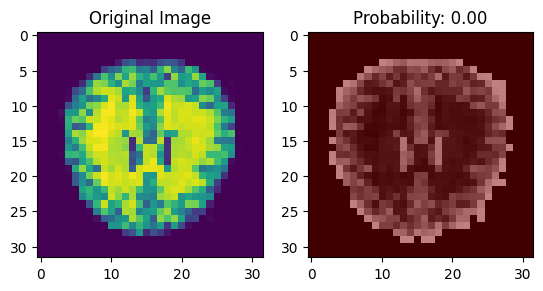

1/1 [==============================] - 0s 177ms/step


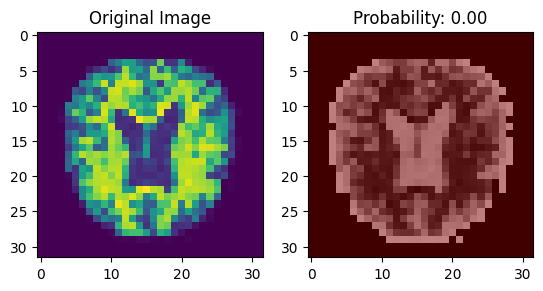

1/1 [==============================] - 0s 248ms/step


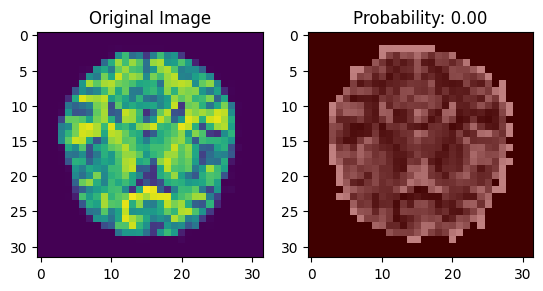

1/1 [==============================] - 0s 173ms/step


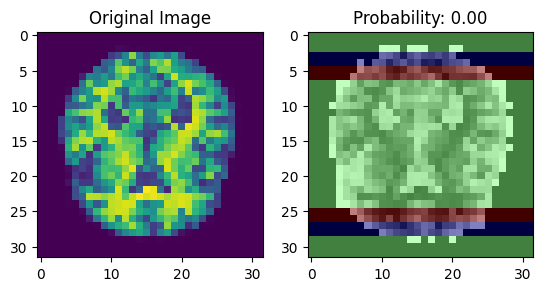

1/1 [==============================] - 0s 163ms/step


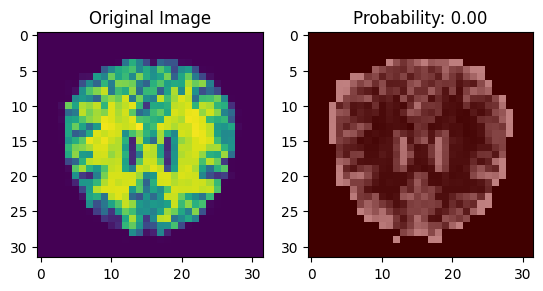

1/1 [==============================] - 0s 188ms/step


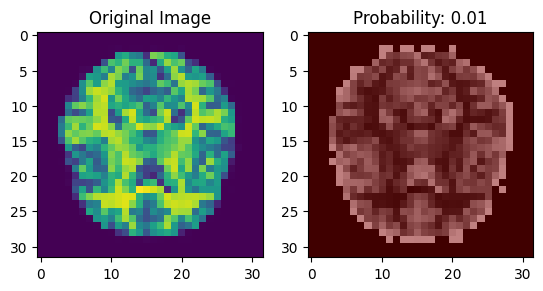

1/1 [==============================] - 0s 181ms/step


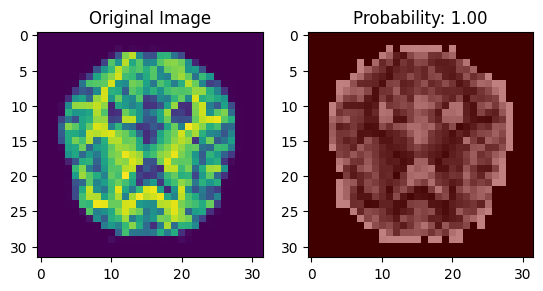

1/1 [==============================] - 0s 181ms/step


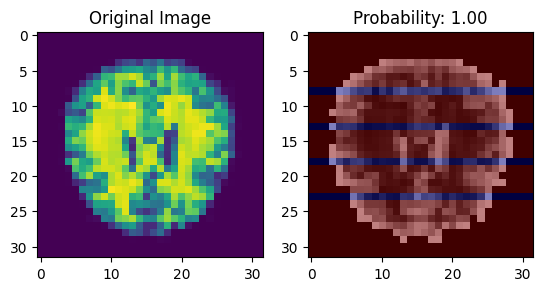

1/1 [==============================] - 0s 165ms/step


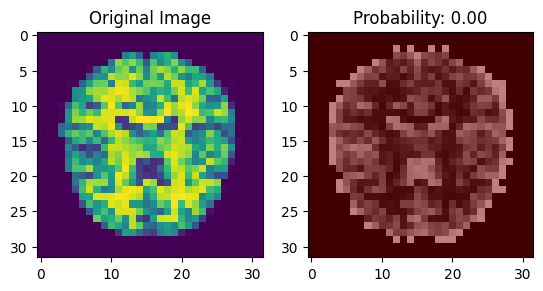

1/1 [==============================] - 0s 167ms/step


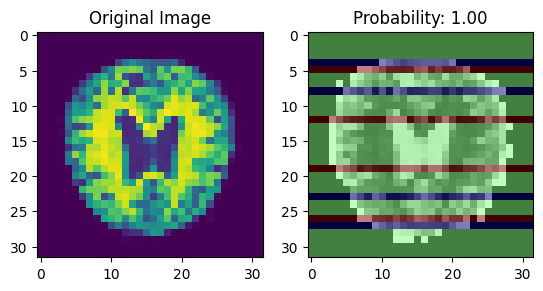

1/1 [==============================] - 0s 153ms/step


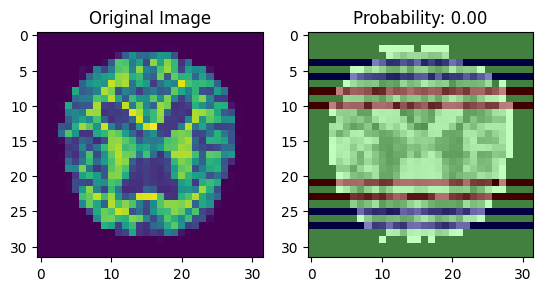

1/1 [==============================] - 0s 154ms/step


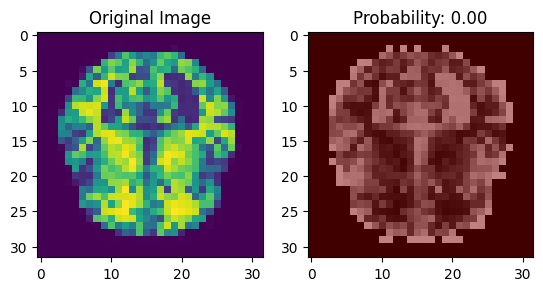

1/1 [==============================] - 0s 164ms/step


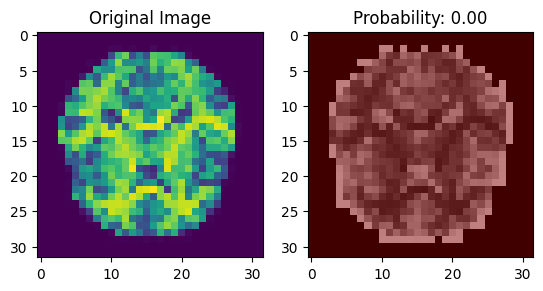

1/1 [==============================] - 0s 157ms/step


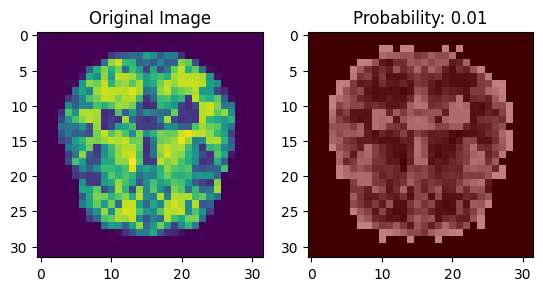

1/1 [==============================] - 0s 170ms/step


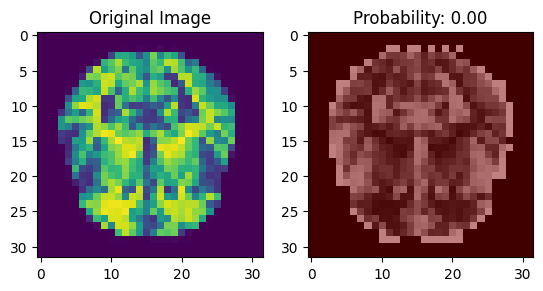

1/1 [==============================] - 0s 157ms/step


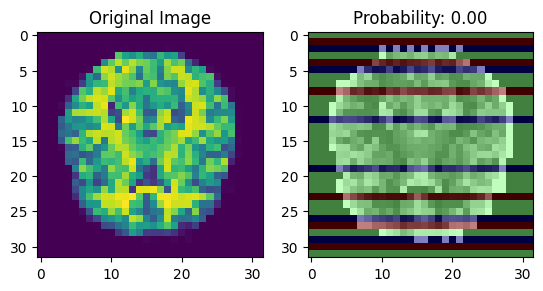

1/1 [==============================] - 0s 172ms/step


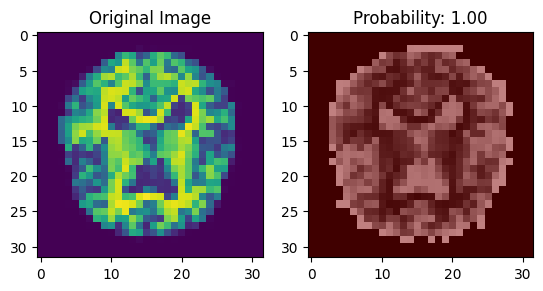

1/1 [==============================] - 0s 162ms/step


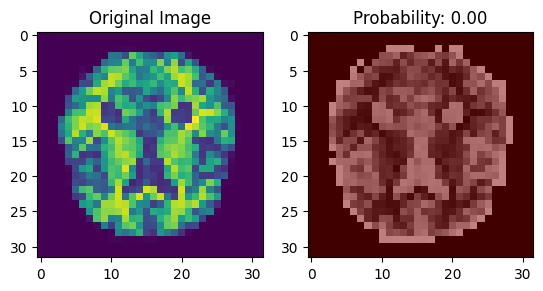

1/1 [==============================] - 0s 213ms/step


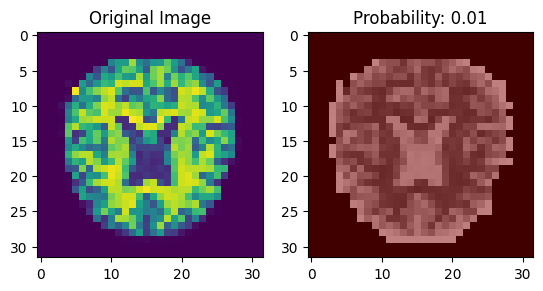

1/1 [==============================] - 0s 212ms/step


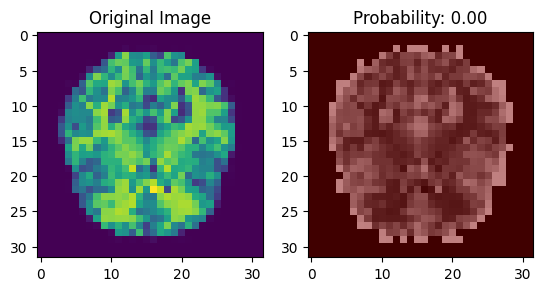

1/1 [==============================] - 0s 238ms/step


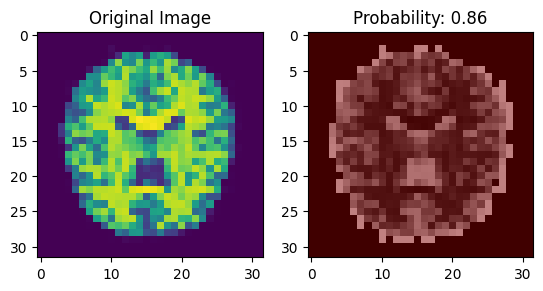

1/1 [==============================] - 0s 207ms/step


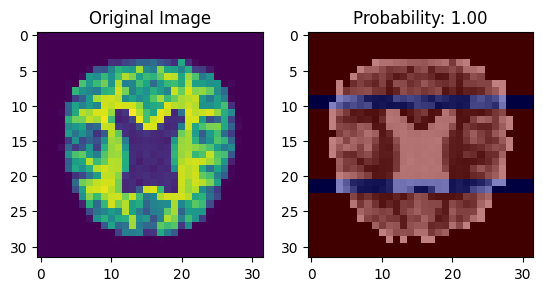

1/1 [==============================] - 0s 198ms/step


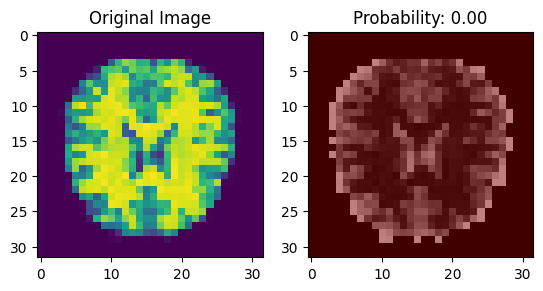

1/1 [==============================] - 0s 244ms/step


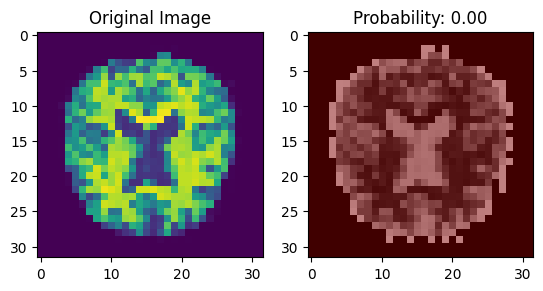

1/1 [==============================] - 0s 175ms/step


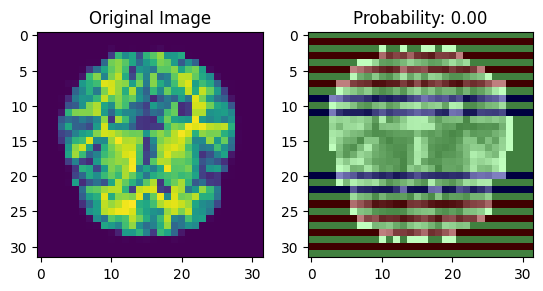

1/1 [==============================] - 0s 158ms/step


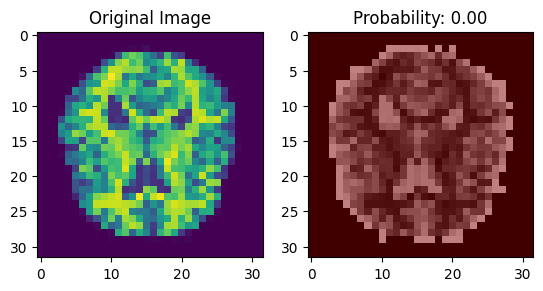

1/1 [==============================] - 0s 203ms/step


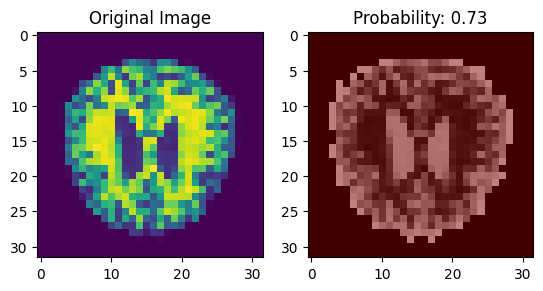

1/1 [==============================] - 0s 165ms/step


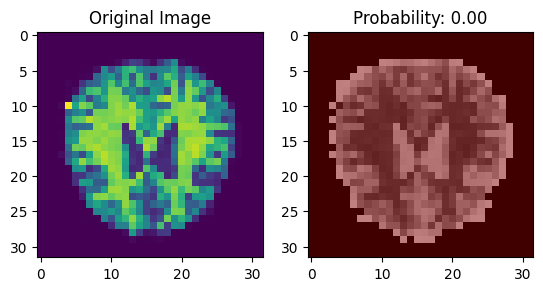

1/1 [==============================] - 0s 156ms/step


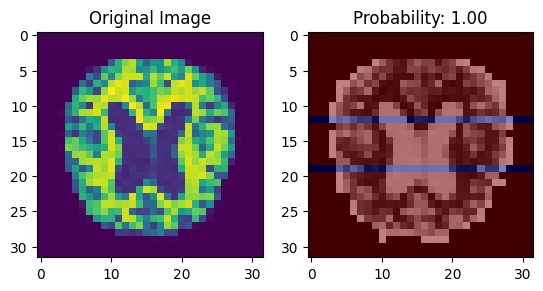

1/1 [==============================] - 0s 155ms/step


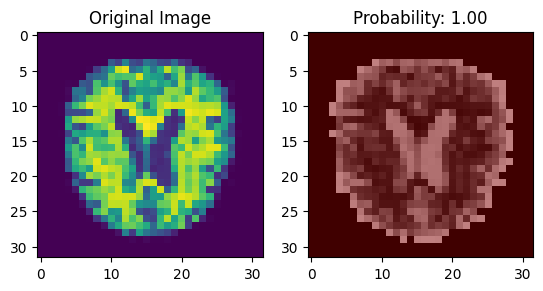

1/1 [==============================] - 0s 164ms/step


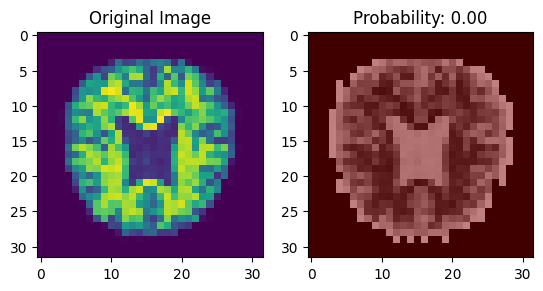

1/1 [==============================] - 0s 170ms/step


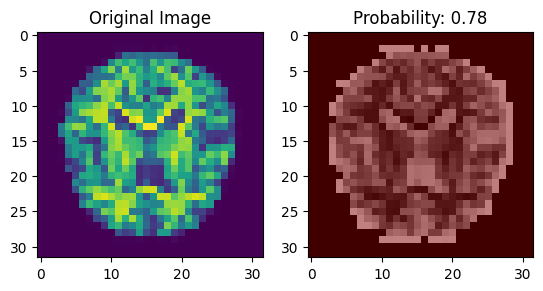

1/1 [==============================] - 0s 188ms/step


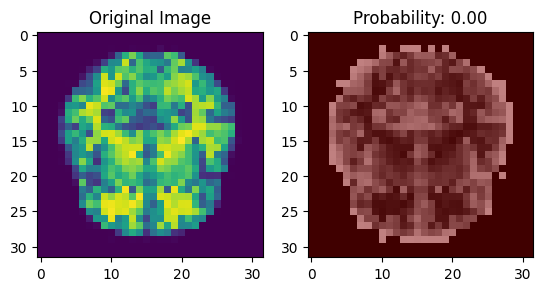

1/1 [==============================] - 0s 153ms/step


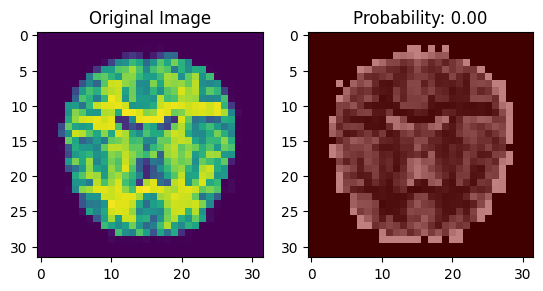

1/1 [==============================] - 0s 151ms/step


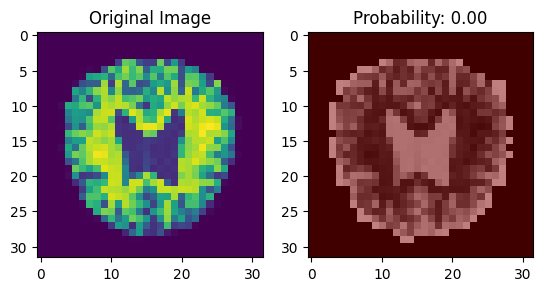

1/1 [==============================] - 0s 175ms/step


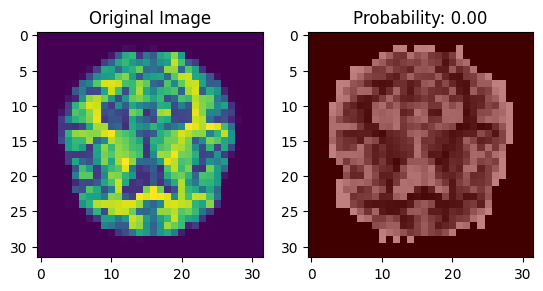

1/1 [==============================] - 0s 163ms/step


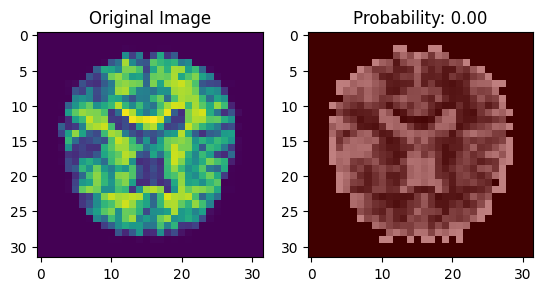

1/1 [==============================] - 0s 184ms/step


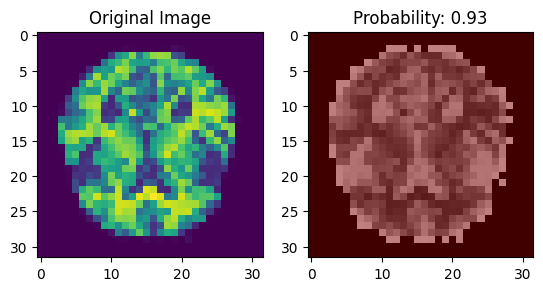

1/1 [==============================] - 1s 775ms/step


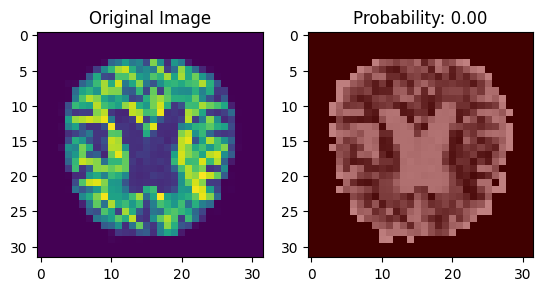

1/1 [==============================] - 0s 220ms/step


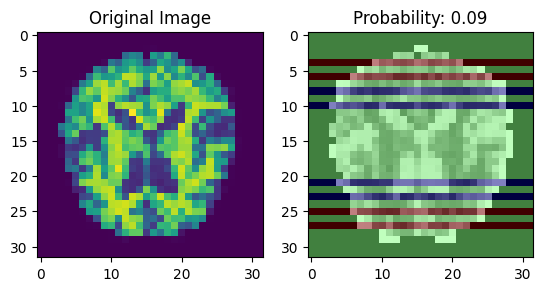

1/1 [==============================] - 0s 200ms/step


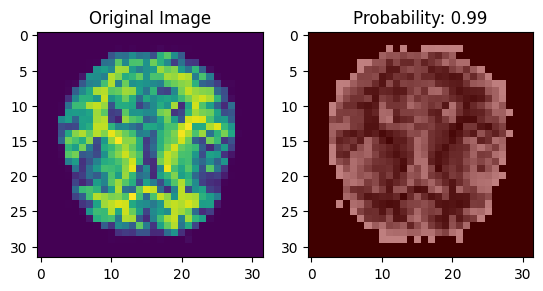

1/1 [==============================] - 0s 179ms/step


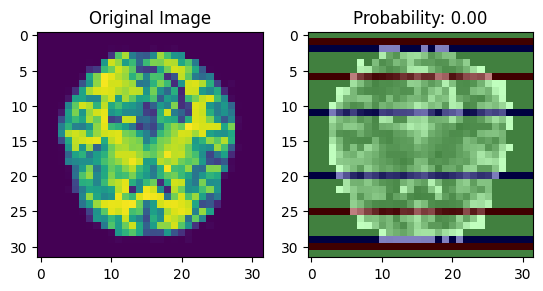

1/1 [==============================] - 0s 159ms/step


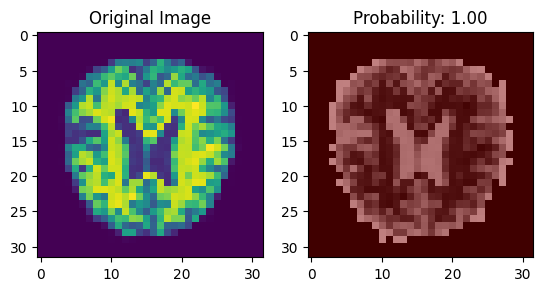

1/1 [==============================] - 0s 174ms/step


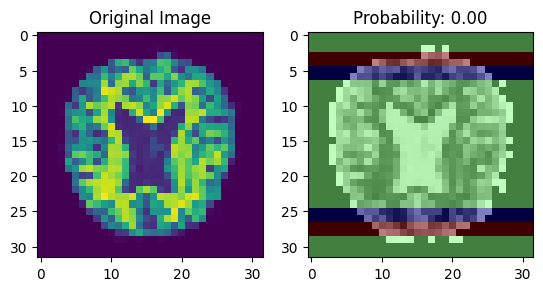

1/1 [==============================] - 0s 159ms/step


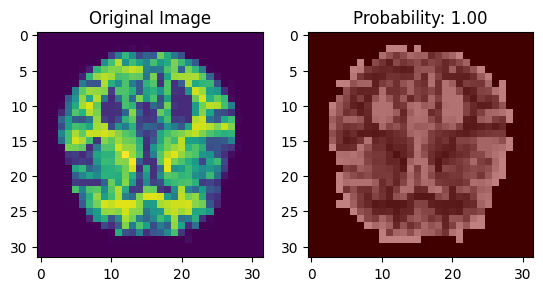

1/1 [==============================] - 0s 158ms/step


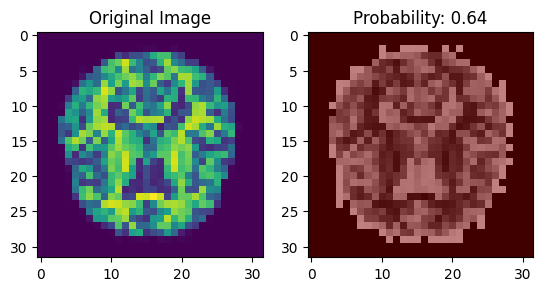

1/1 [==============================] - 0s 182ms/step


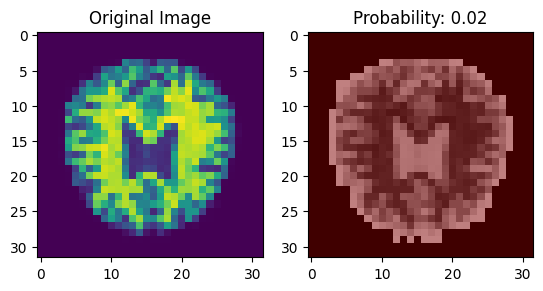

1/1 [==============================] - 0s 173ms/step


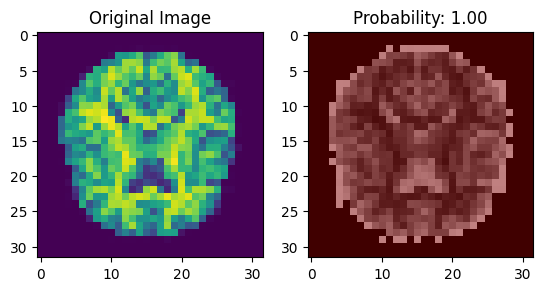

1/1 [==============================] - 0s 154ms/step


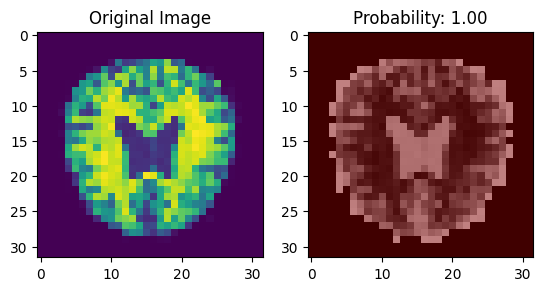

1/1 [==============================] - 0s 152ms/step


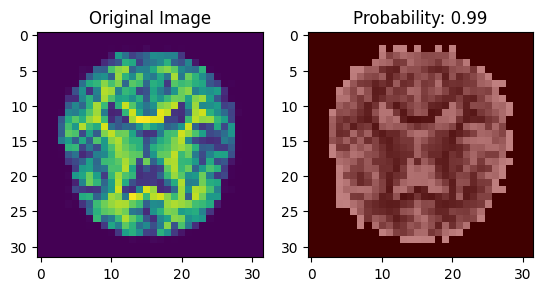

1/1 [==============================] - 0s 157ms/step


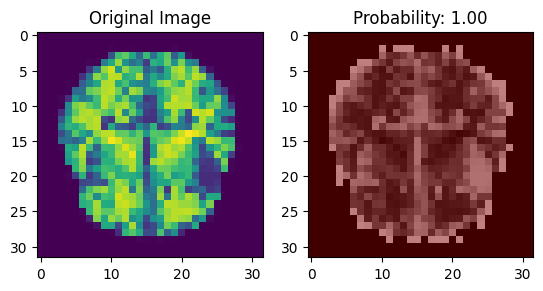

1/1 [==============================] - 0s 160ms/step


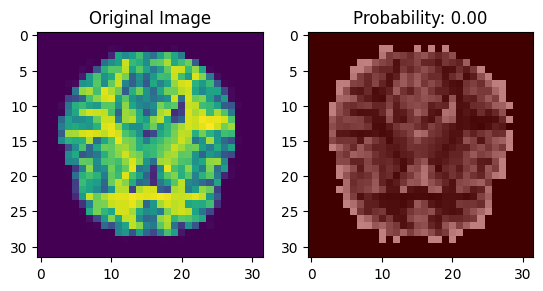

1/1 [==============================] - 0s 181ms/step


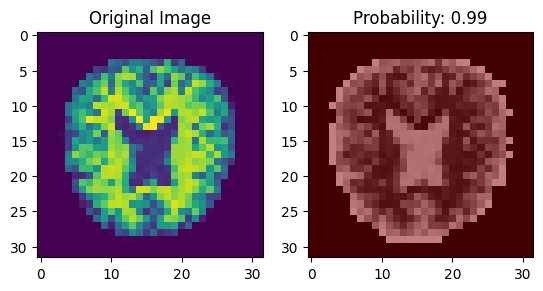

1/1 [==============================] - 0s 187ms/step


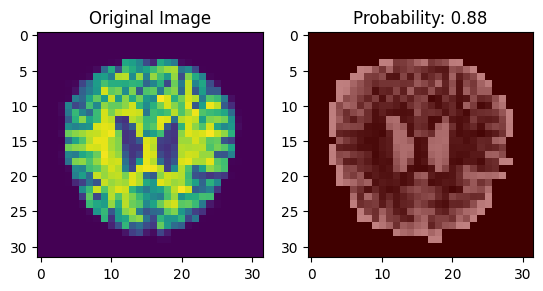

1/1 [==============================] - 0s 154ms/step


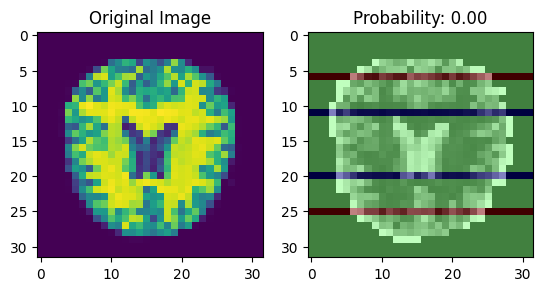

1/1 [==============================] - 0s 159ms/step


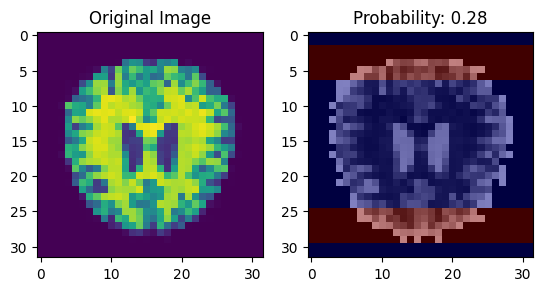

1/1 [==============================] - 0s 161ms/step


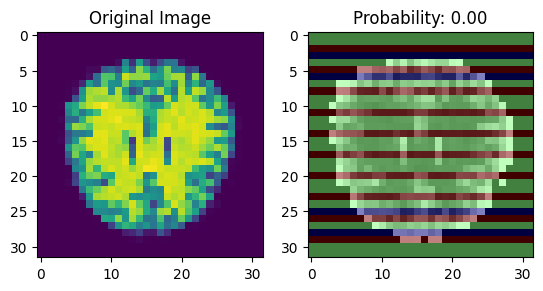

1/1 [==============================] - 0s 234ms/step


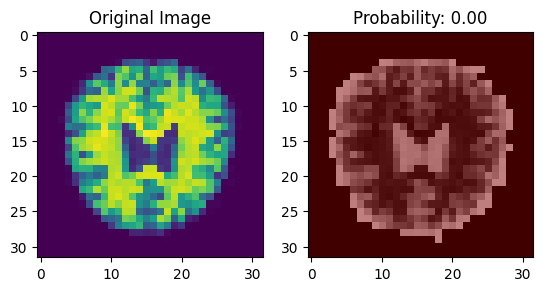

1/1 [==============================] - 0s 167ms/step


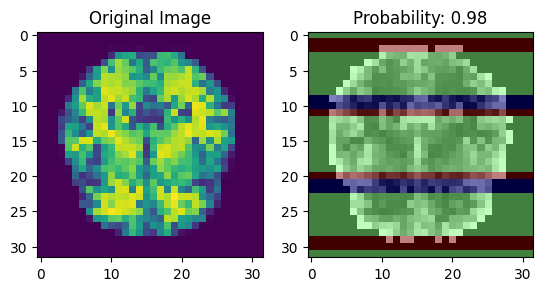

1/1 [==============================] - 0s 185ms/step


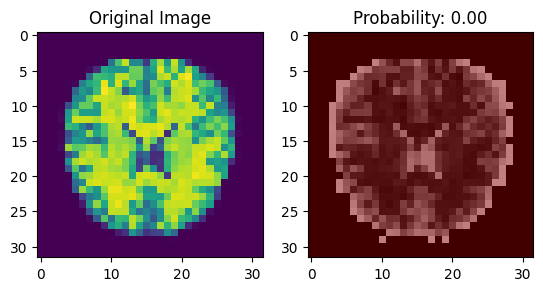

1/1 [==============================] - 0s 171ms/step


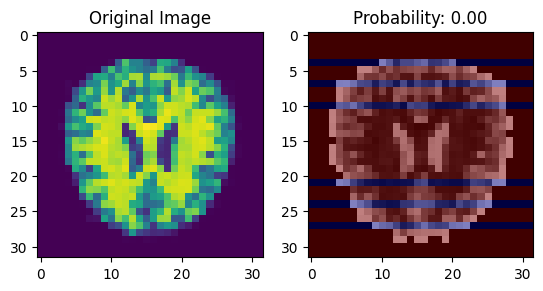

1/1 [==============================] - 0s 178ms/step


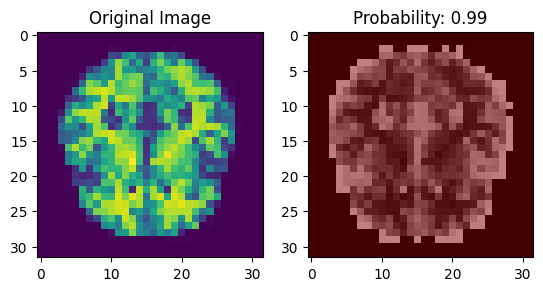

1/1 [==============================] - 0s 171ms/step


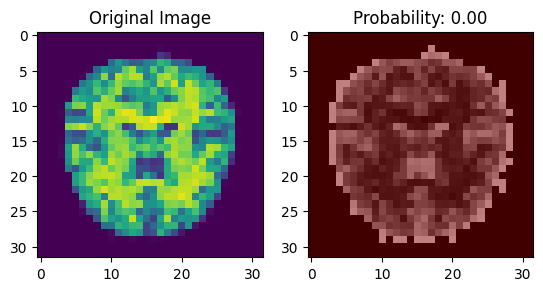

1/1 [==============================] - 0s 165ms/step


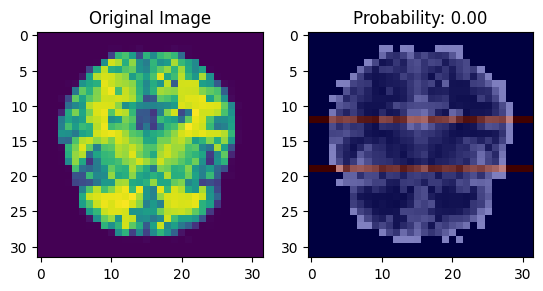

1/1 [==============================] - 0s 173ms/step


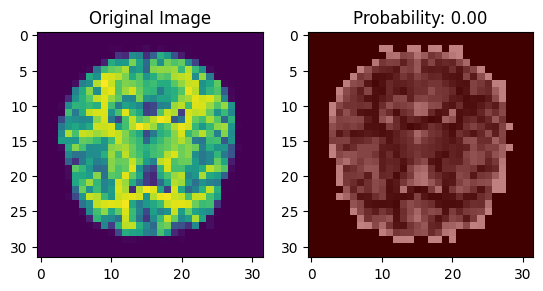

1/1 [==============================] - 0s 156ms/step


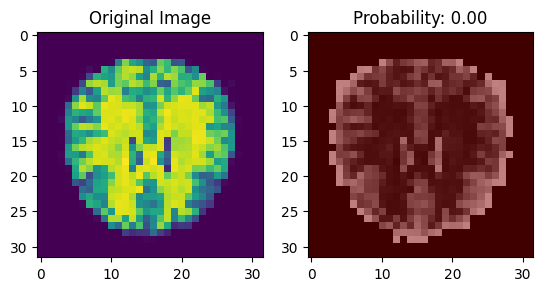

1/1 [==============================] - 0s 164ms/step


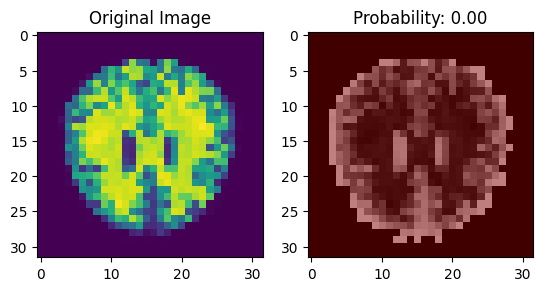

1/1 [==============================] - 0s 158ms/step


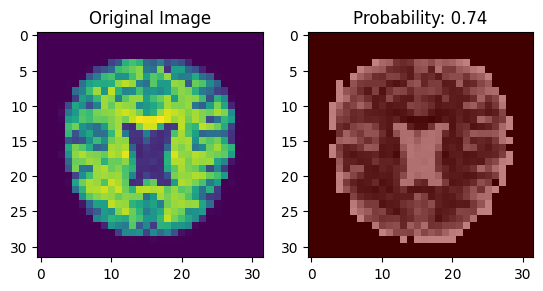

1/1 [==============================] - 0s 187ms/step


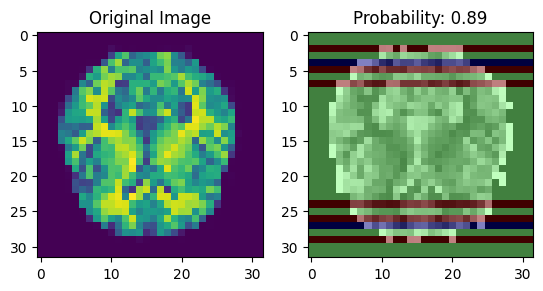

1/1 [==============================] - 0s 259ms/step


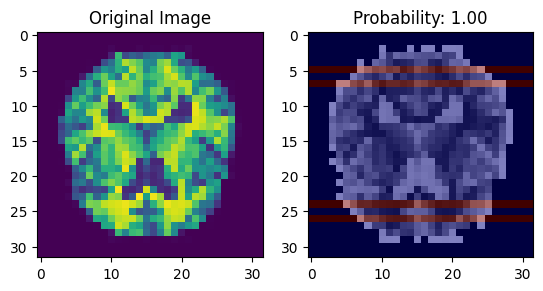

1/1 [==============================] - 0s 187ms/step


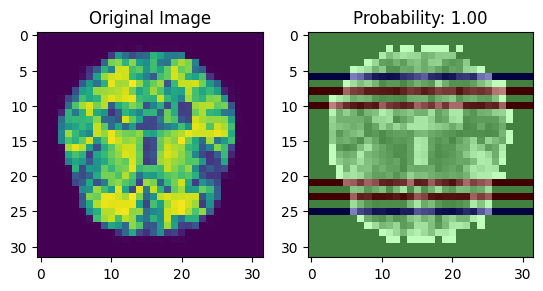

1/1 [==============================] - 0s 161ms/step


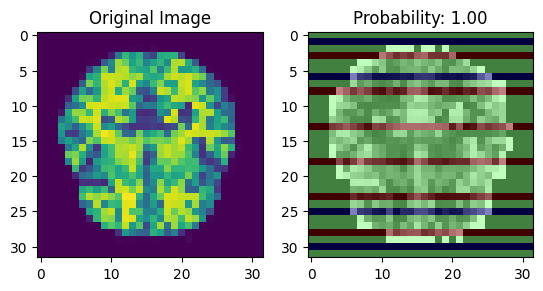

1/1 [==============================] - 0s 194ms/step


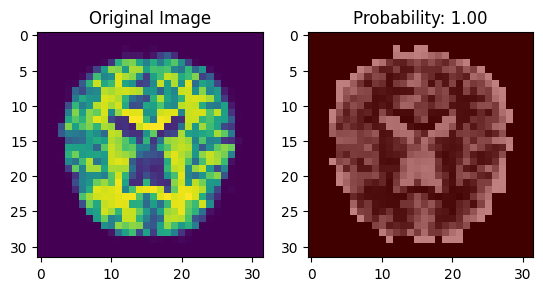

1/1 [==============================] - 0s 200ms/step


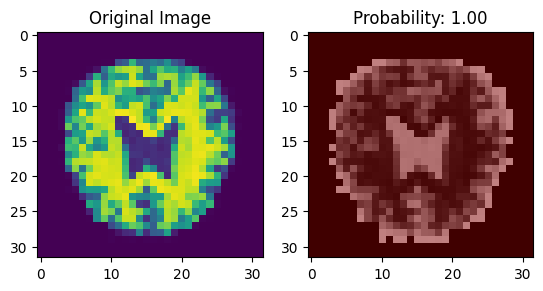

1/1 [==============================] - 0s 192ms/step


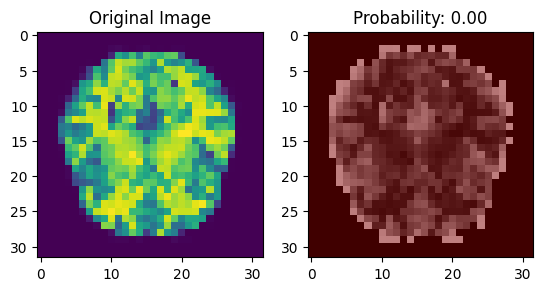

1/1 [==============================] - 0s 251ms/step


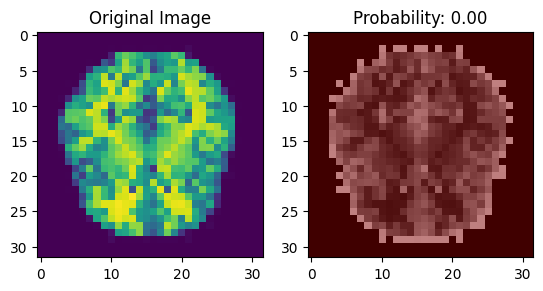

1/1 [==============================] - 0s 155ms/step


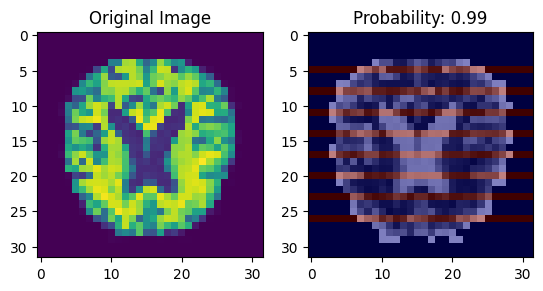

1/1 [==============================] - 0s 158ms/step


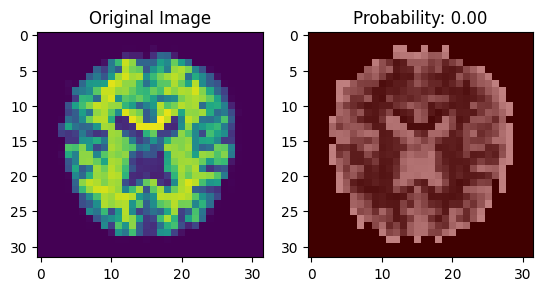

1/1 [==============================] - 0s 158ms/step


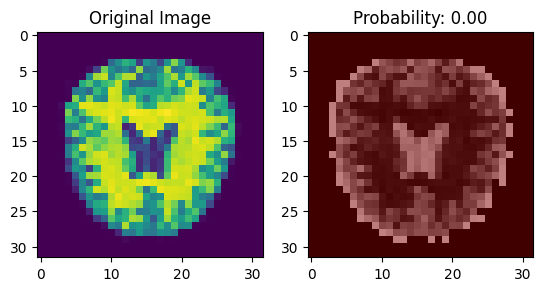

1/1 [==============================] - 0s 204ms/step


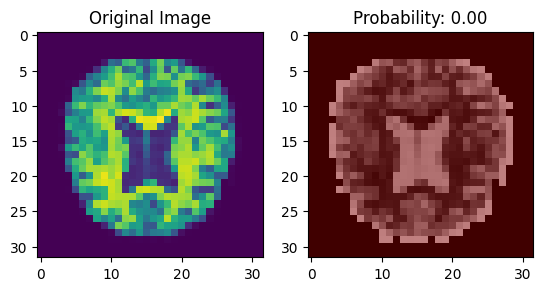

1/1 [==============================] - 0s 177ms/step


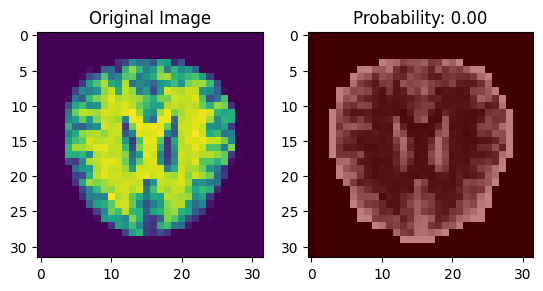

1/1 [==============================] - 0s 186ms/step


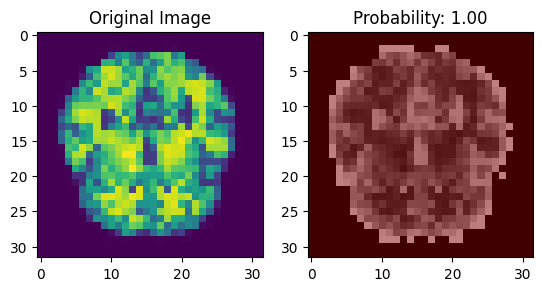

1/1 [==============================] - 0s 169ms/step


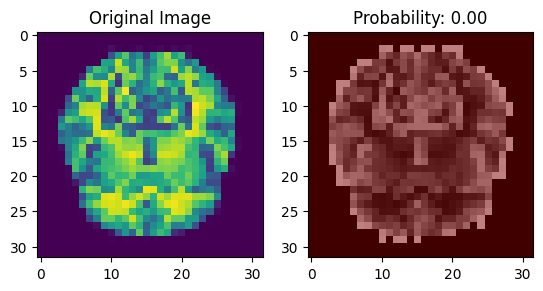

1/1 [==============================] - 0s 156ms/step


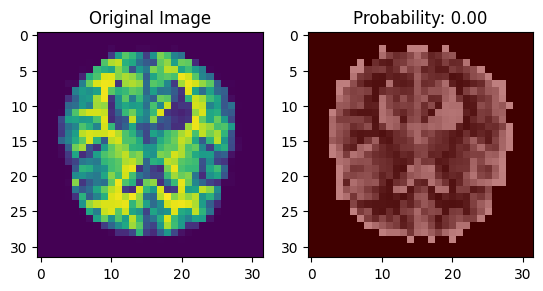

1/1 [==============================] - 0s 191ms/step


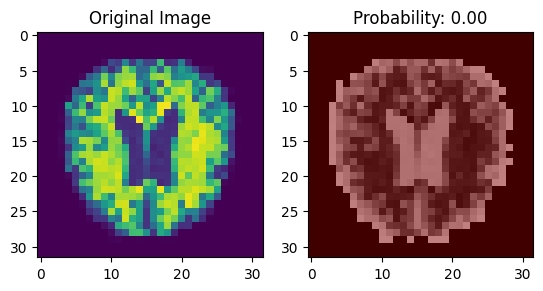

1/1 [==============================] - 0s 160ms/step


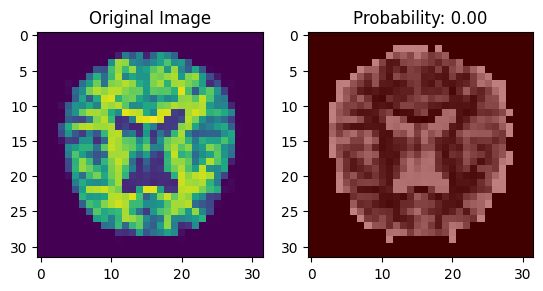

1/1 [==============================] - 0s 169ms/step


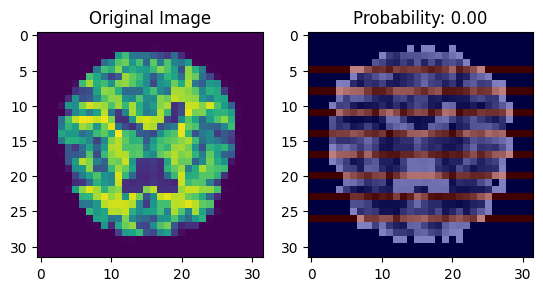

1/1 [==============================] - 0s 215ms/step


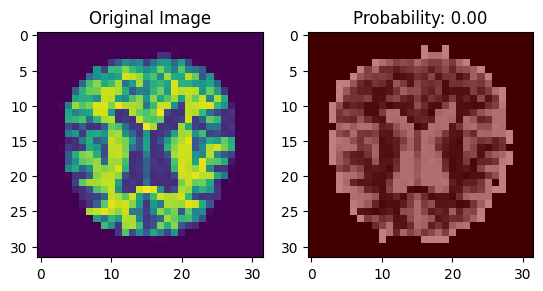

1/1 [==============================] - 0s 161ms/step


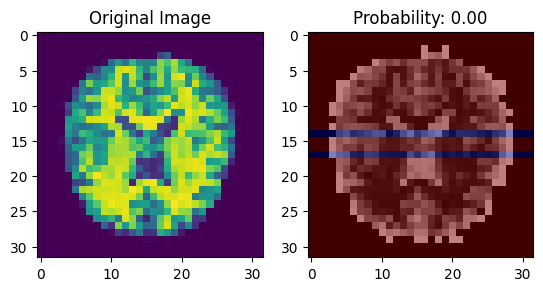

1/1 [==============================] - 0s 182ms/step


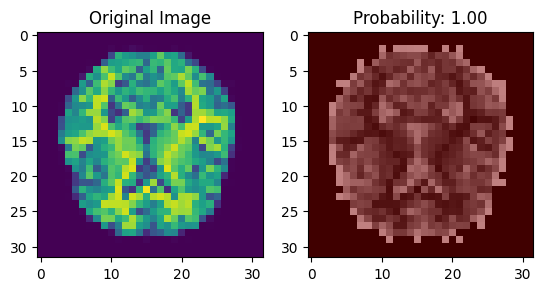

1/1 [==============================] - 0s 243ms/step


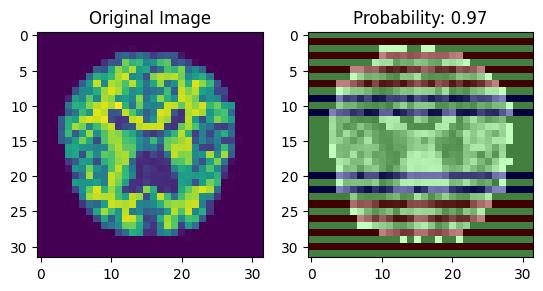

1/1 [==============================] - 0s 193ms/step


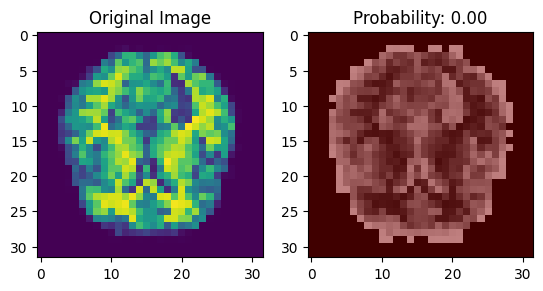

1/1 [==============================] - 0s 180ms/step


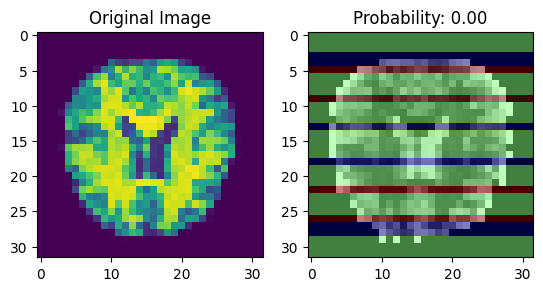

1/1 [==============================] - 0s 183ms/step


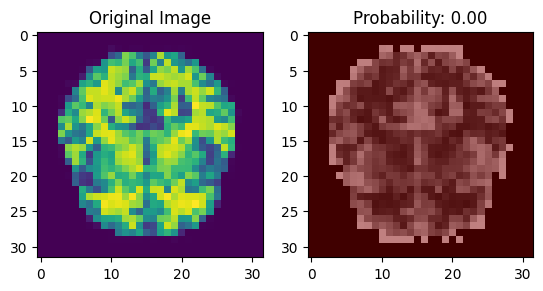

1/1 [==============================] - 0s 155ms/step


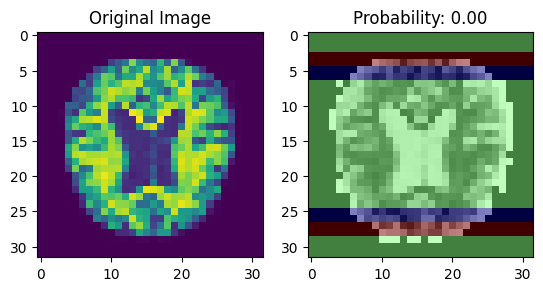

1/1 [==============================] - 0s 179ms/step


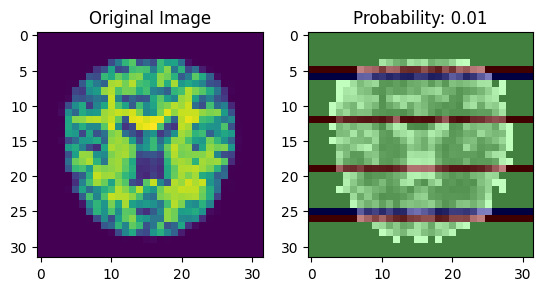

1/1 [==============================] - 0s 153ms/step


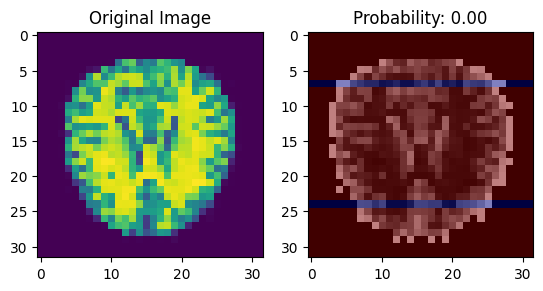

1/1 [==============================] - 0s 156ms/step


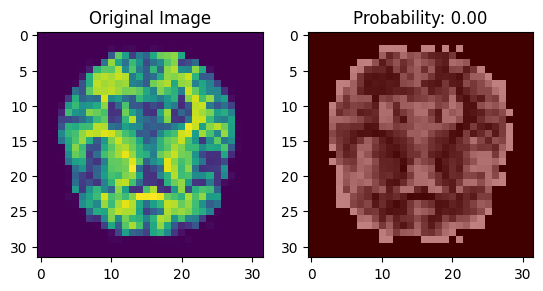

1/1 [==============================] - 0s 156ms/step


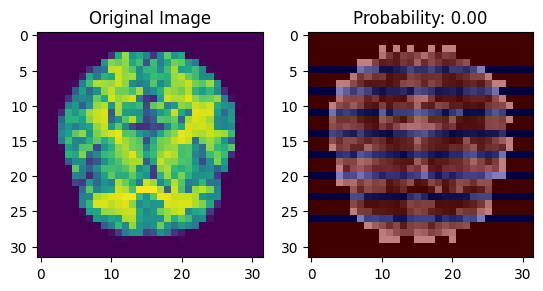

1/1 [==============================] - 0s 192ms/step


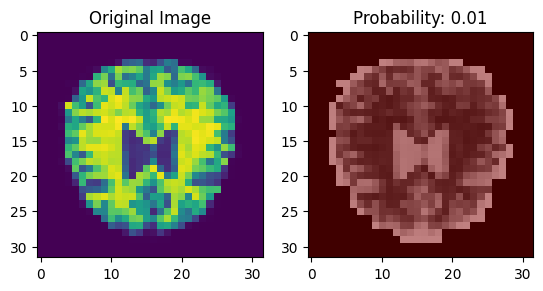

1/1 [==============================] - 0s 197ms/step


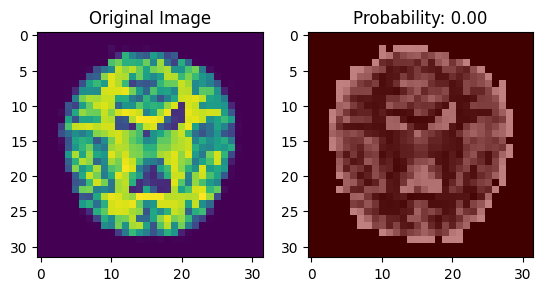

1/1 [==============================] - 0s 184ms/step


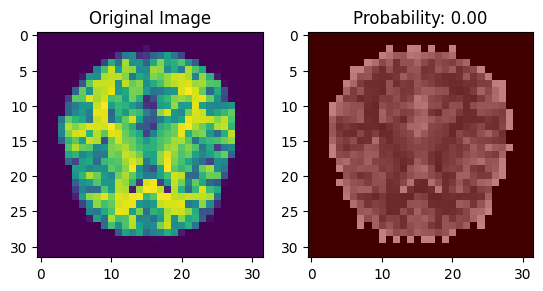

1/1 [==============================] - 0s 183ms/step


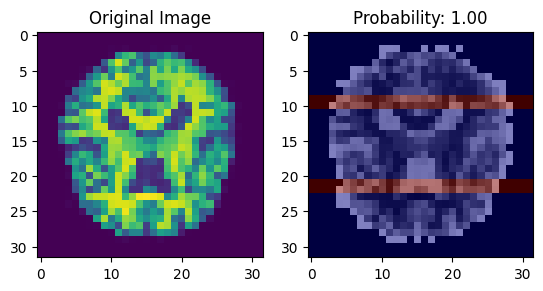

1/1 [==============================] - 0s 184ms/step


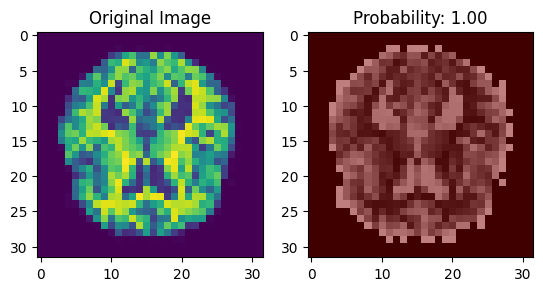

1/1 [==============================] - 0s 250ms/step


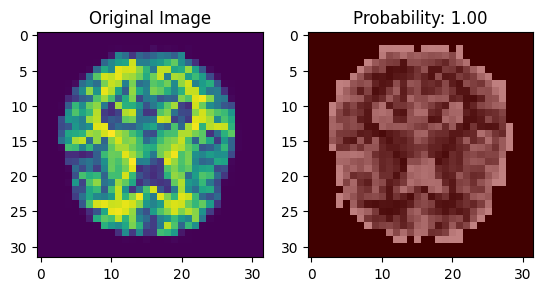

1/1 [==============================] - 0s 166ms/step


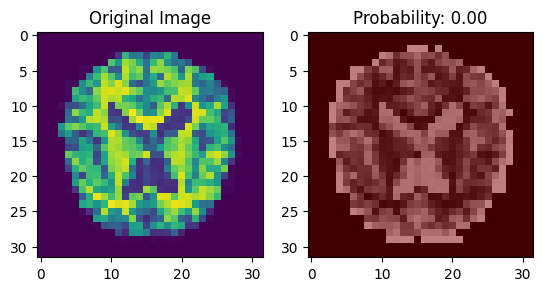

1/1 [==============================] - 0s 167ms/step


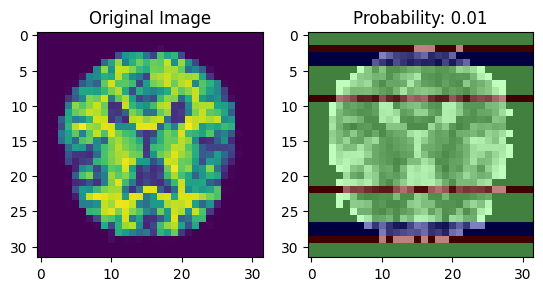

1/1 [==============================] - 0s 187ms/step


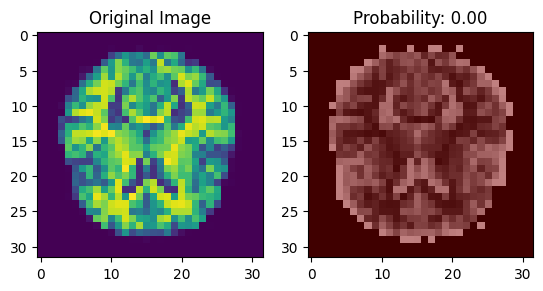

1/1 [==============================] - 0s 268ms/step


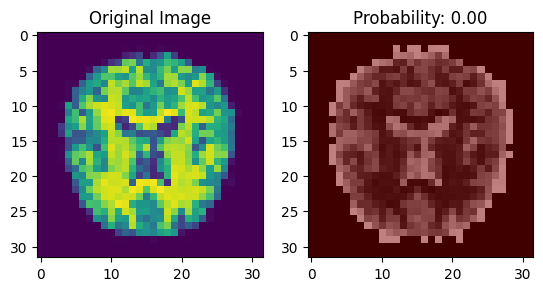

1/1 [==============================] - 0s 157ms/step


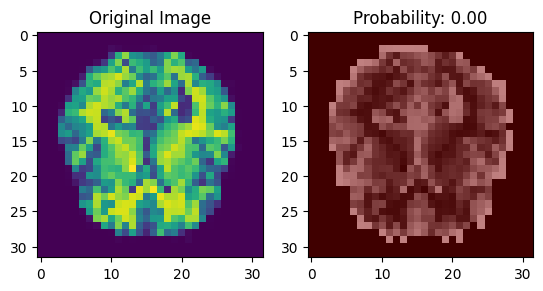

1/1 [==============================] - 0s 164ms/step


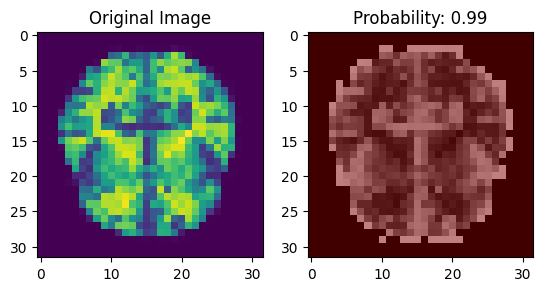

1/1 [==============================] - 0s 160ms/step


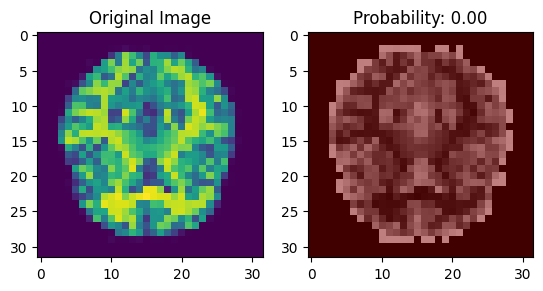

1/1 [==============================] - 0s 148ms/step


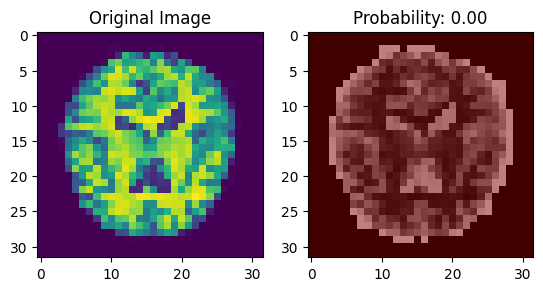

1/1 [==============================] - 0s 168ms/step


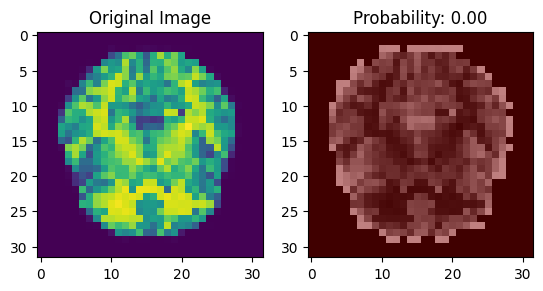

1/1 [==============================] - 0s 171ms/step


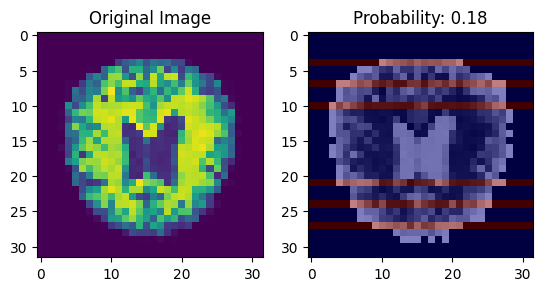

1/1 [==============================] - 0s 165ms/step


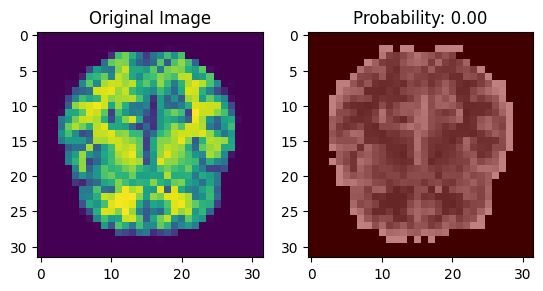

1/1 [==============================] - 0s 156ms/step


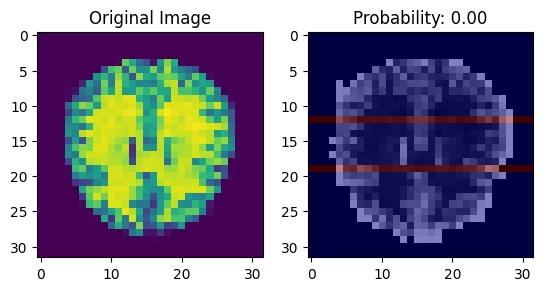

1/1 [==============================] - 0s 161ms/step


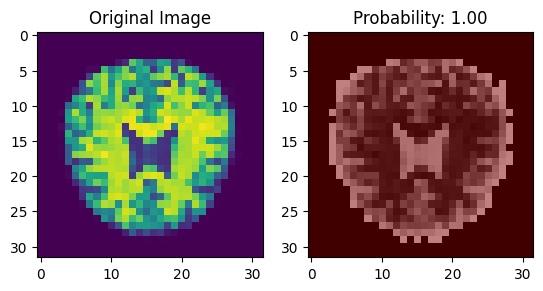

1/1 [==============================] - 0s 176ms/step


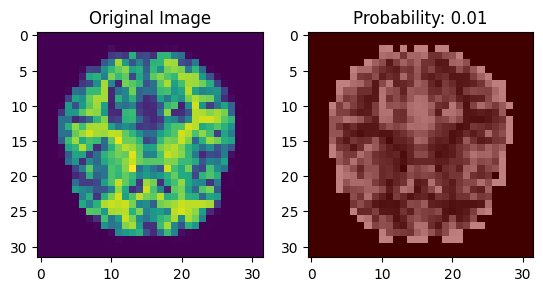

1/1 [==============================] - 0s 155ms/step


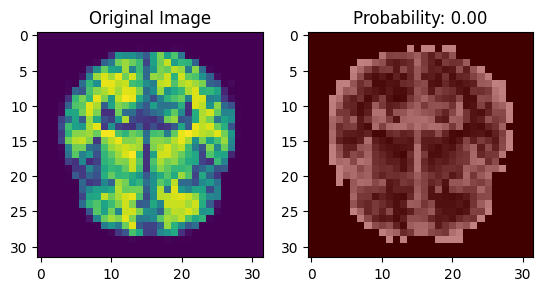

1/1 [==============================] - 0s 212ms/step


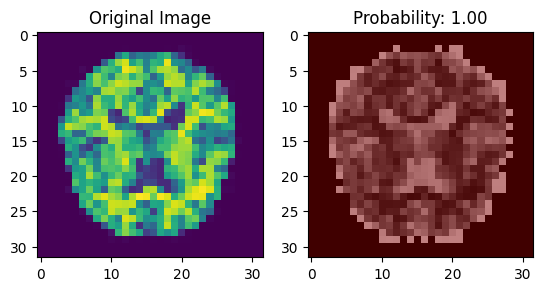

1/1 [==============================] - 0s 190ms/step


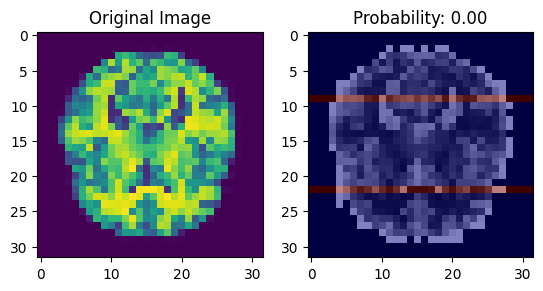

1/1 [==============================] - 0s 184ms/step


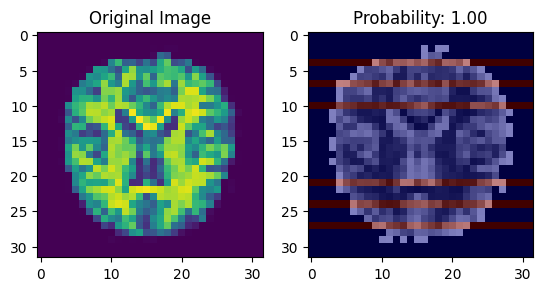

1/1 [==============================] - 0s 289ms/step


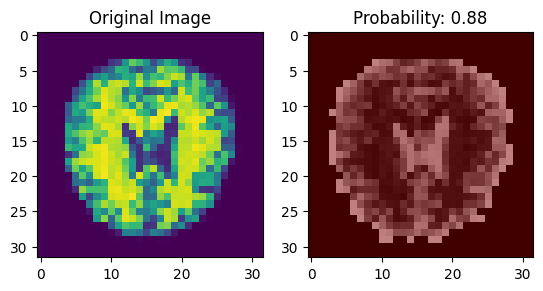

1/1 [==============================] - 0s 230ms/step


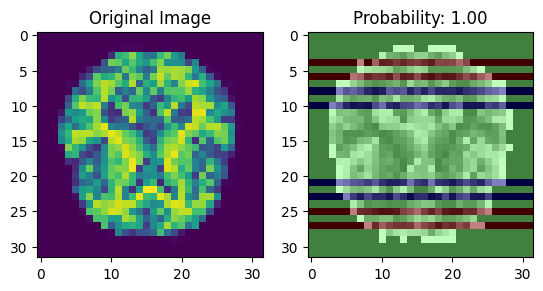

1/1 [==============================] - 0s 210ms/step


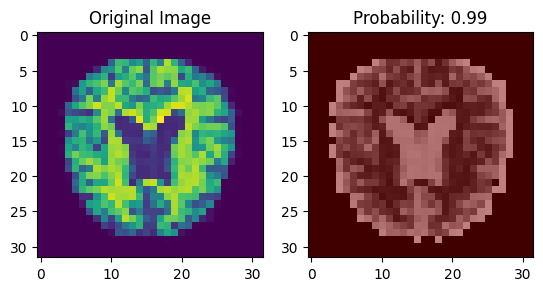

1/1 [==============================] - 0s 163ms/step


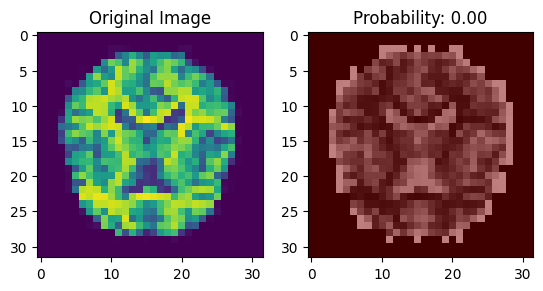

1/1 [==============================] - 0s 198ms/step


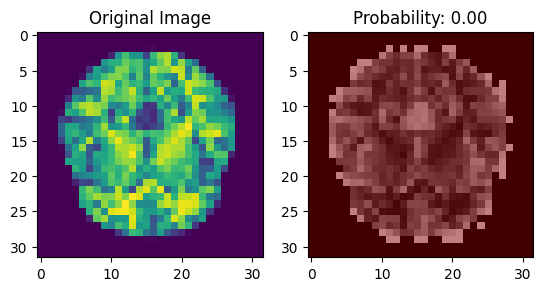

1/1 [==============================] - 0s 171ms/step


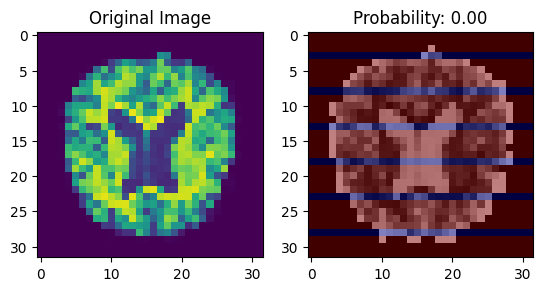

1/1 [==============================] - 0s 187ms/step


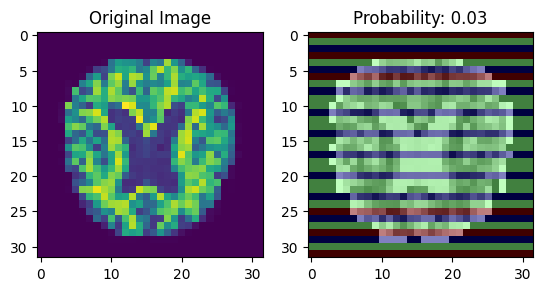

1/1 [==============================] - 0s 153ms/step


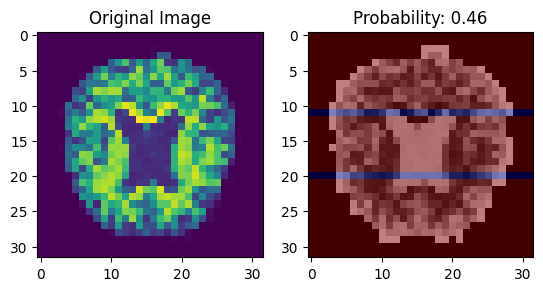

1/1 [==============================] - 0s 157ms/step


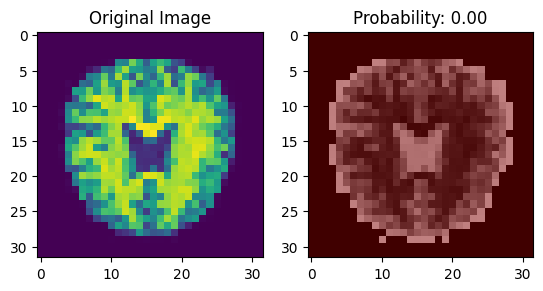

1/1 [==============================] - 0s 177ms/step


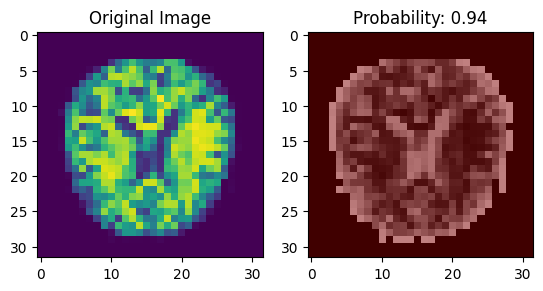

1/1 [==============================] - 0s 165ms/step


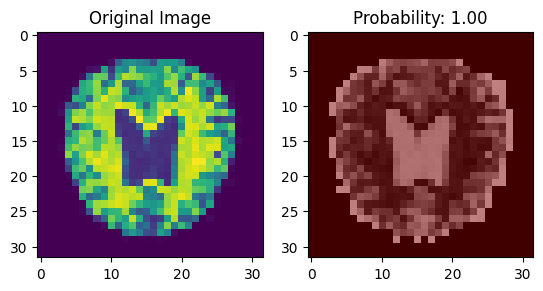

1/1 [==============================] - 0s 153ms/step


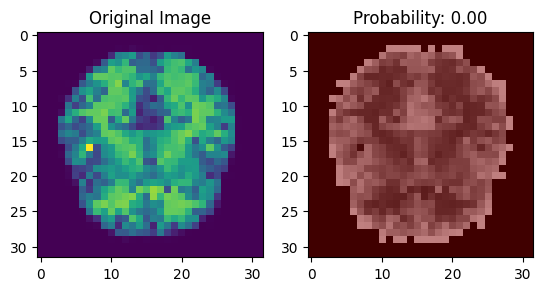

1/1 [==============================] - 0s 194ms/step


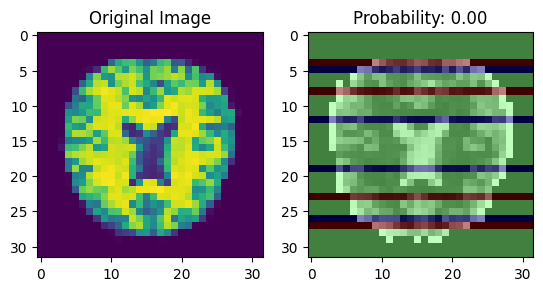

1/1 [==============================] - 0s 156ms/step


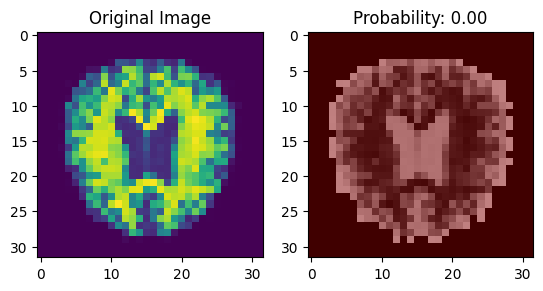

1/1 [==============================] - 0s 161ms/step


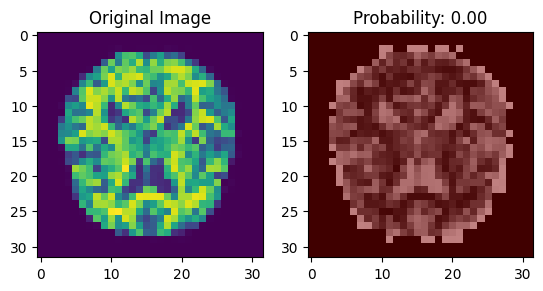

1/1 [==============================] - 0s 225ms/step


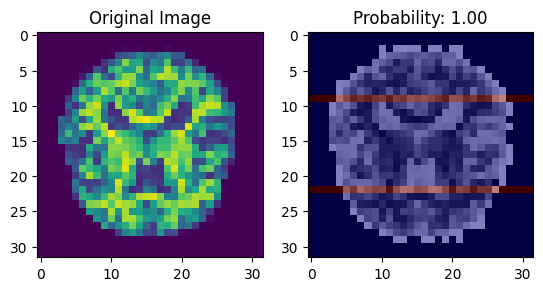

1/1 [==============================] - 0s 250ms/step


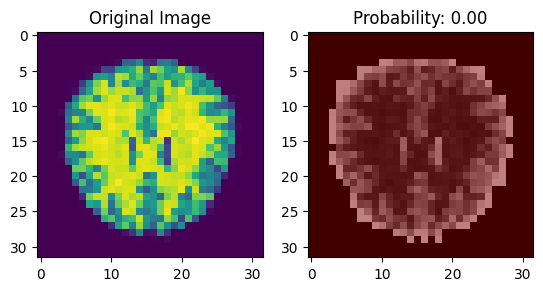

1/1 [==============================] - 0s 199ms/step


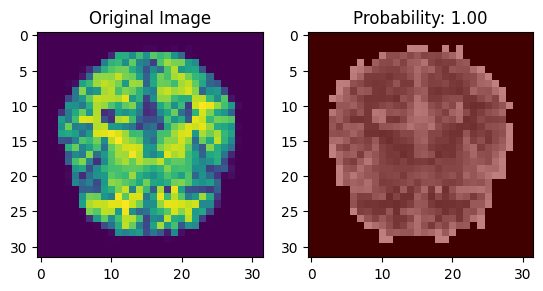

1/1 [==============================] - 0s 313ms/step


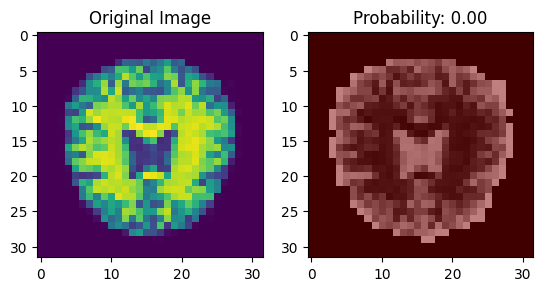

1/1 [==============================] - 0s 229ms/step


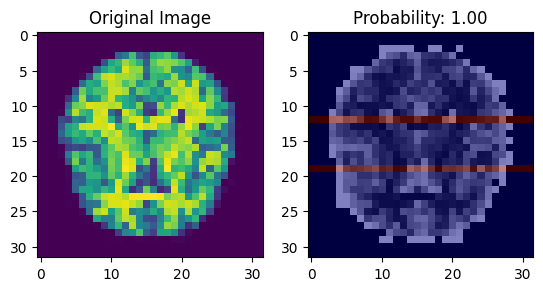

1/1 [==============================] - 0s 160ms/step


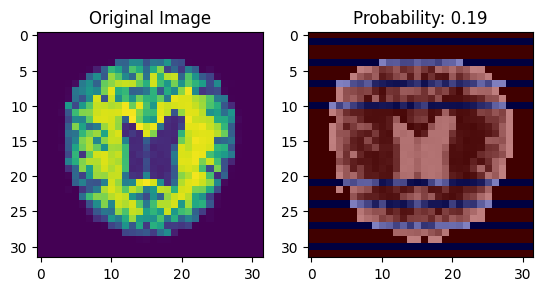

1/1 [==============================] - 0s 164ms/step


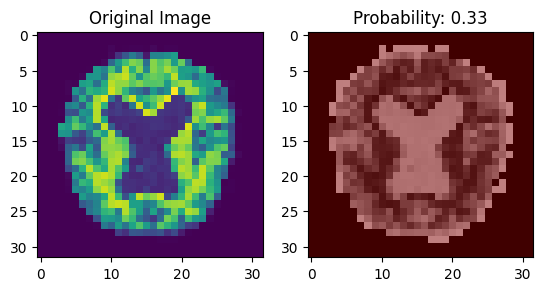

1/1 [==============================] - 0s 160ms/step


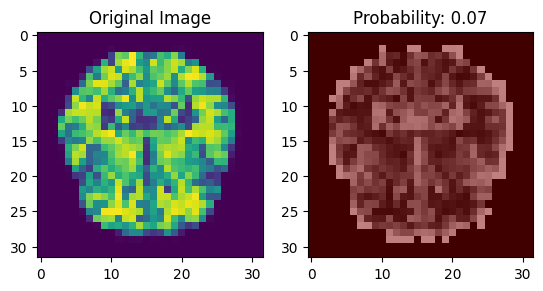

1/1 [==============================] - 0s 163ms/step


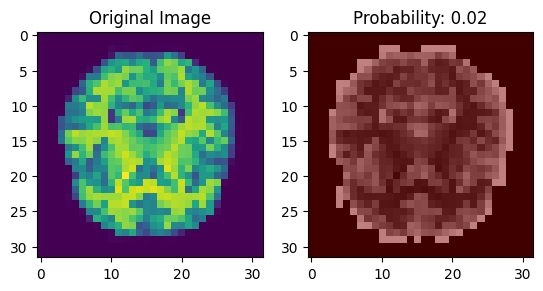

1/1 [==============================] - 0s 156ms/step


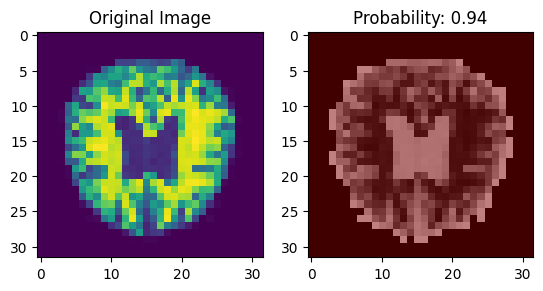

1/1 [==============================] - 0s 178ms/step


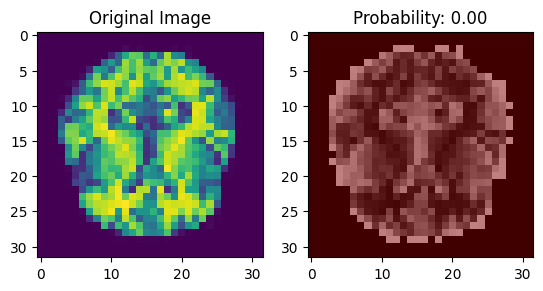

1/1 [==============================] - 0s 159ms/step


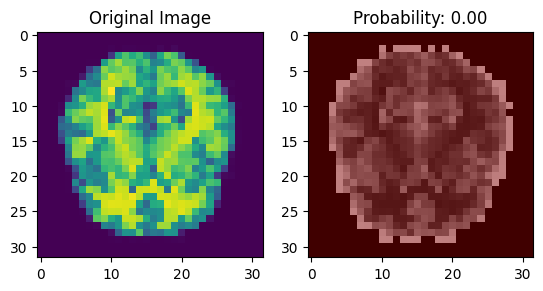

1/1 [==============================] - 0s 161ms/step


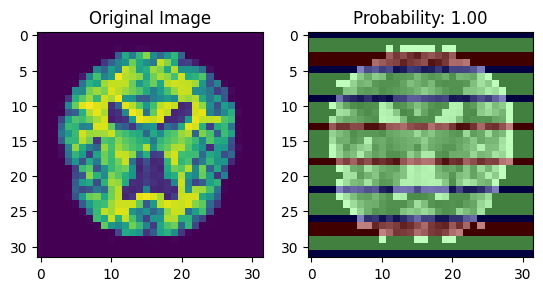

1/1 [==============================] - 0s 160ms/step


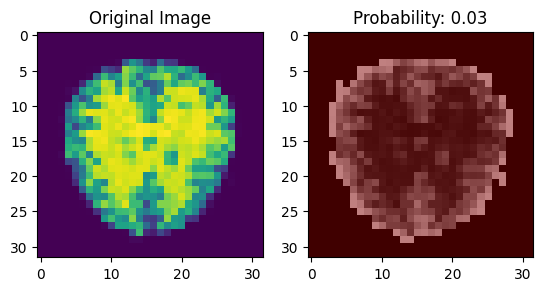

1/1 [==============================] - 0s 154ms/step


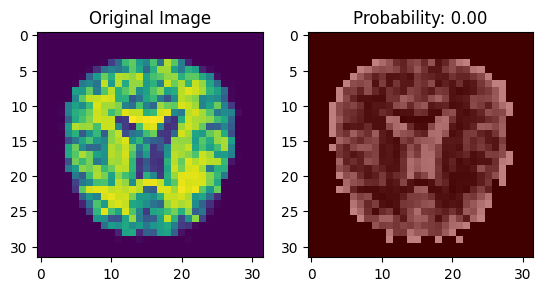

1/1 [==============================] - 0s 153ms/step


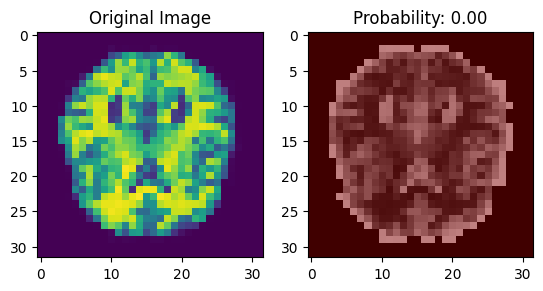

1/1 [==============================] - 0s 233ms/step


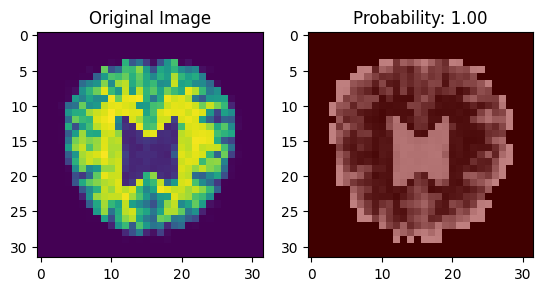

1/1 [==============================] - 0s 186ms/step


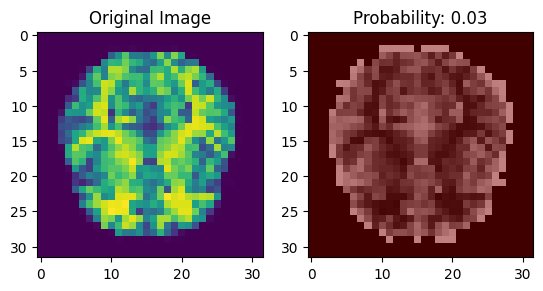

1/1 [==============================] - 0s 189ms/step


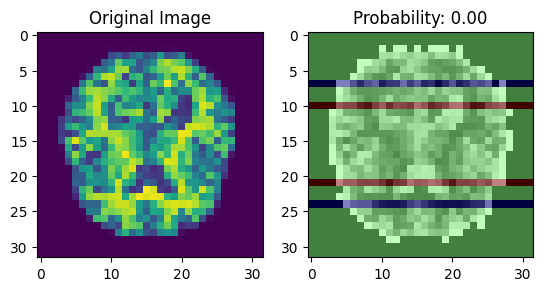

1/1 [==============================] - 0s 180ms/step


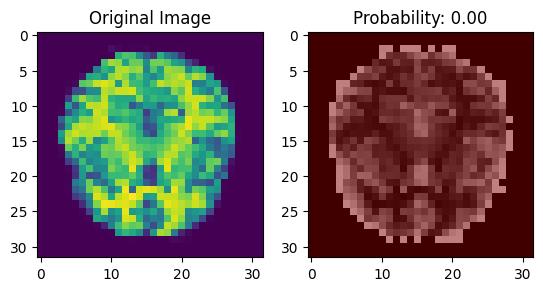

1/1 [==============================] - 0s 253ms/step


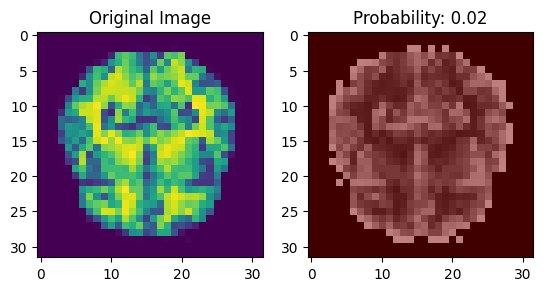

1/1 [==============================] - 1s 726ms/step


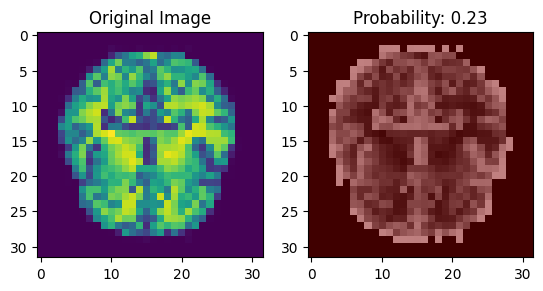

1/1 [==============================] - 0s 188ms/step


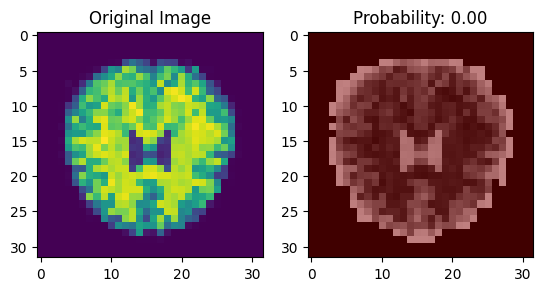

1/1 [==============================] - 0s 175ms/step


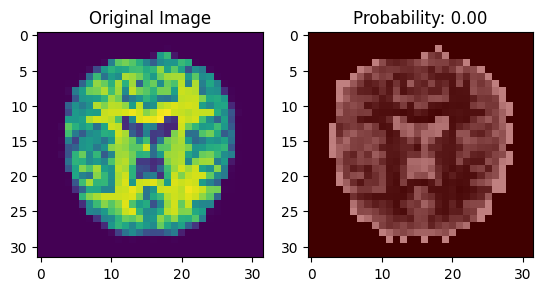

1/1 [==============================] - 0s 172ms/step


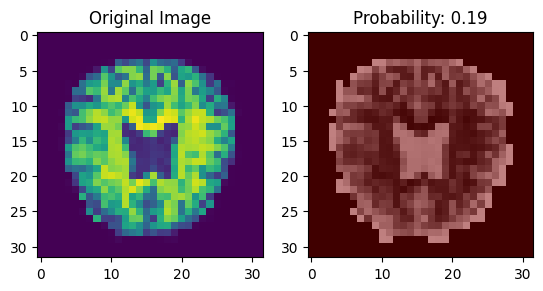

1/1 [==============================] - 0s 169ms/step


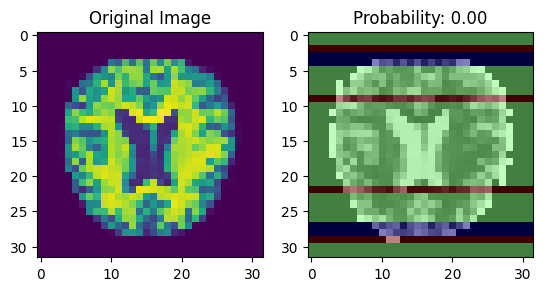

1/1 [==============================] - 0s 159ms/step


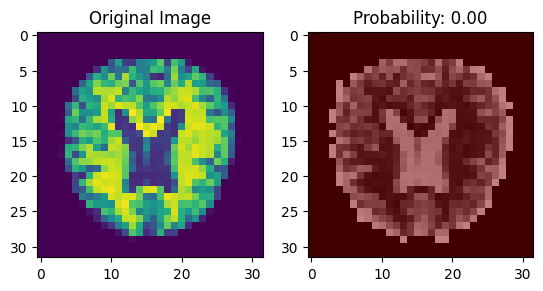

1/1 [==============================] - 0s 154ms/step


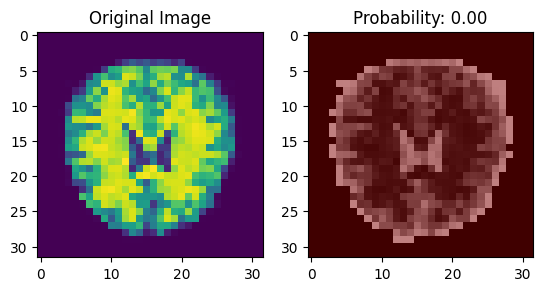

1/1 [==============================] - 0s 154ms/step


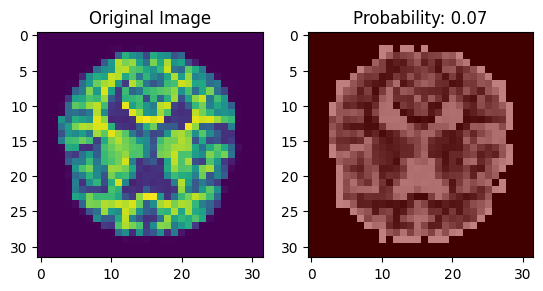

1/1 [==============================] - 0s 158ms/step


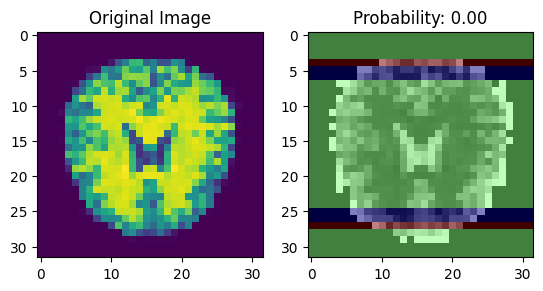

1/1 [==============================] - 0s 169ms/step


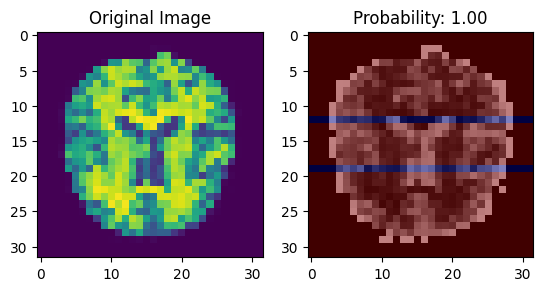

1/1 [==============================] - 0s 165ms/step


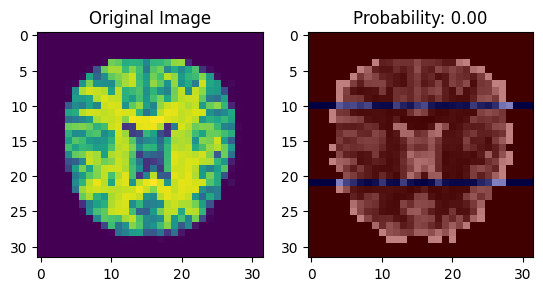

1/1 [==============================] - 0s 173ms/step


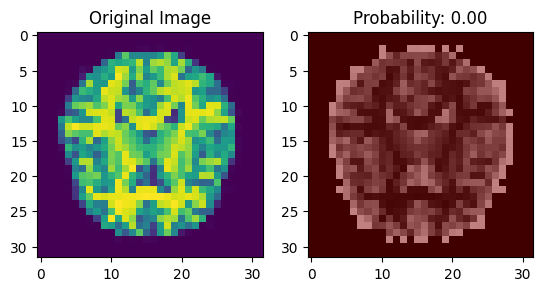

1/1 [==============================] - 0s 168ms/step


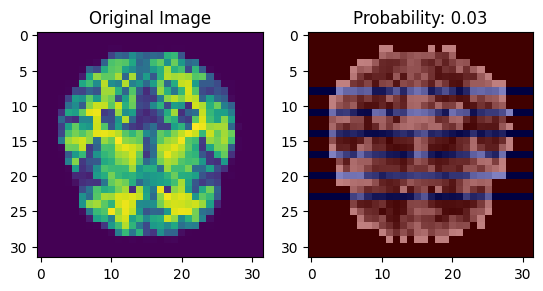

1/1 [==============================] - 0s 159ms/step


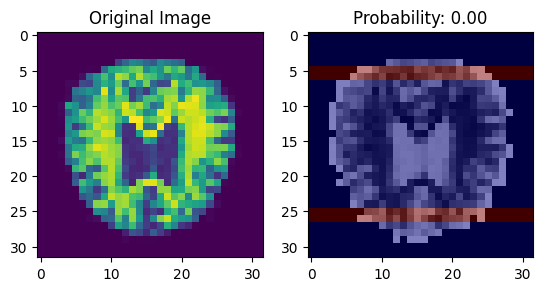

1/1 [==============================] - 0s 156ms/step


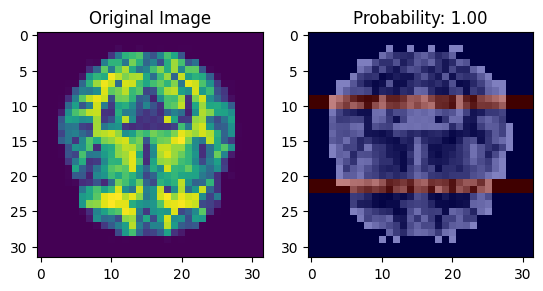

1/1 [==============================] - 0s 160ms/step


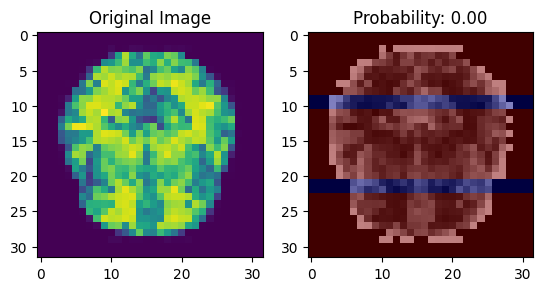

1/1 [==============================] - 0s 193ms/step


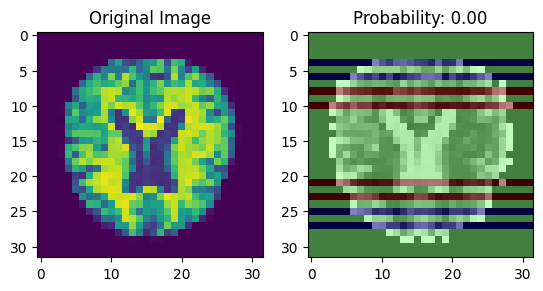

1/1 [==============================] - 0s 209ms/step


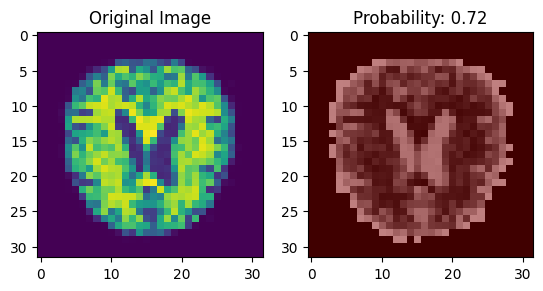

1/1 [==============================] - 0s 158ms/step


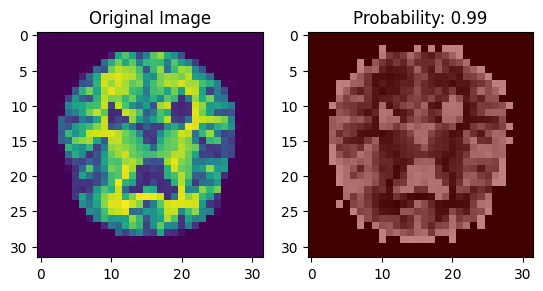

1/1 [==============================] - 0s 155ms/step


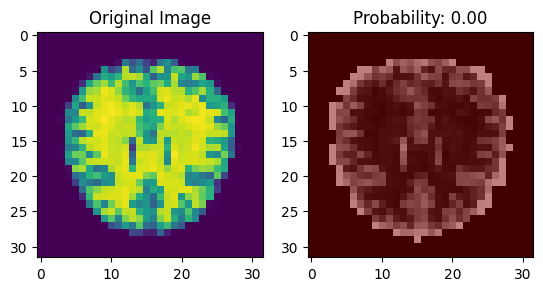

1/1 [==============================] - 0s 154ms/step


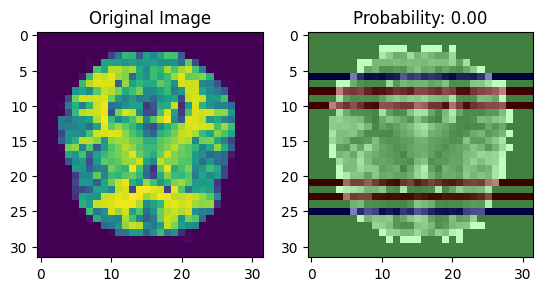

1/1 [==============================] - 0s 196ms/step


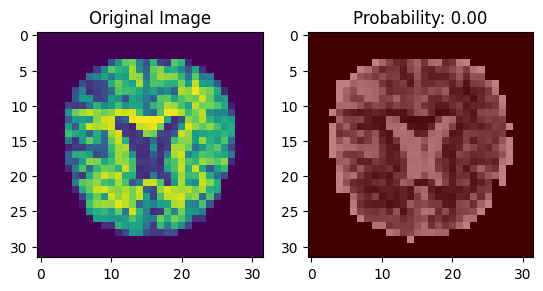

1/1 [==============================] - 0s 199ms/step


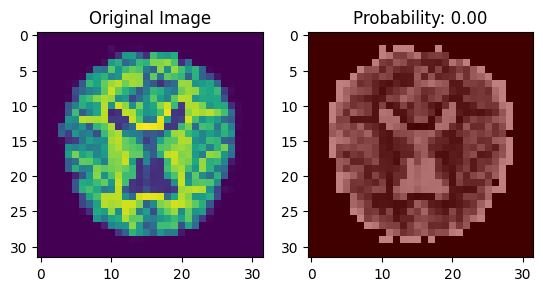

1/1 [==============================] - 0s 179ms/step


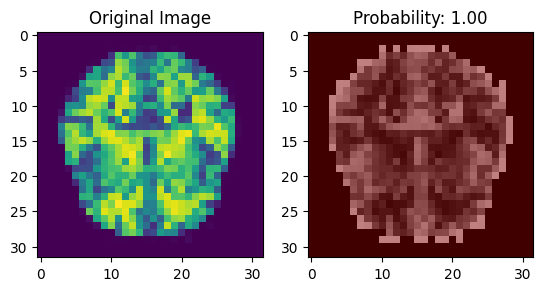

1/1 [==============================] - 0s 157ms/step


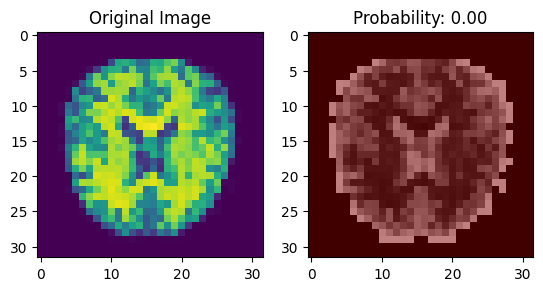

1/1 [==============================] - 0s 159ms/step


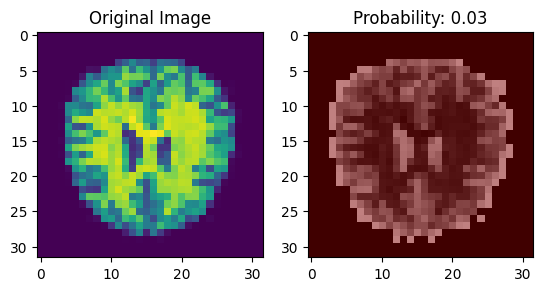

1/1 [==============================] - 0s 158ms/step


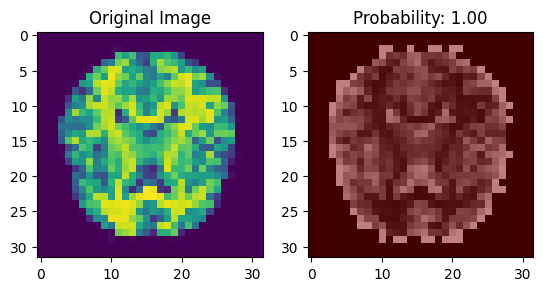

1/1 [==============================] - 0s 160ms/step


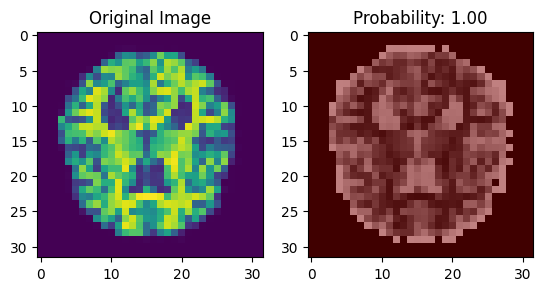

1/1 [==============================] - 0s 156ms/step


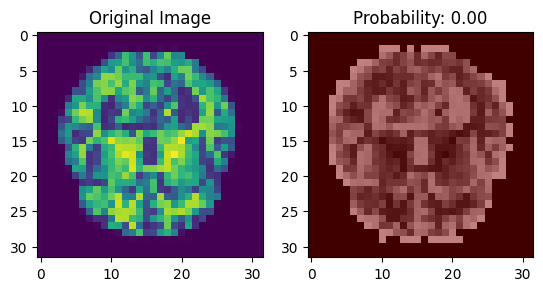

1/1 [==============================] - 0s 210ms/step


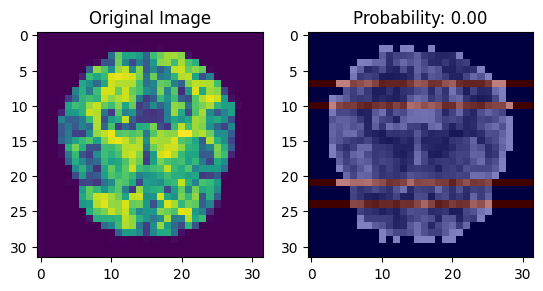

1/1 [==============================] - 0s 247ms/step


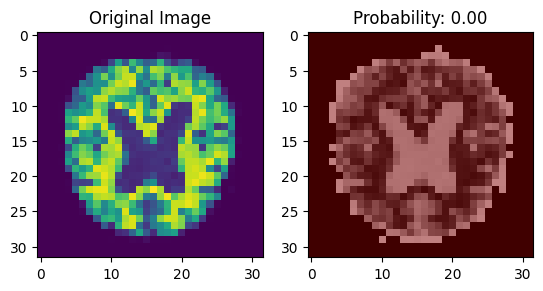

1/1 [==============================] - 0s 190ms/step


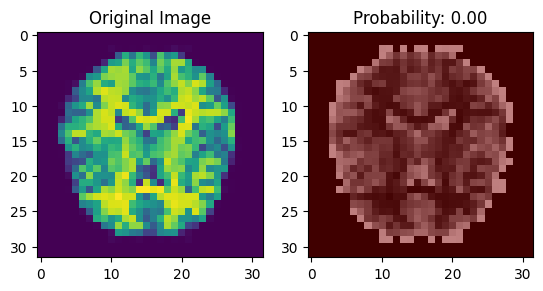

1/1 [==============================] - 0s 198ms/step


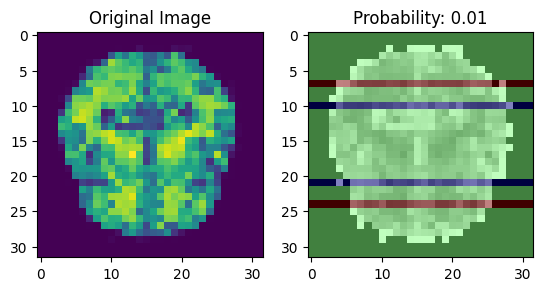

1/1 [==============================] - 0s 282ms/step


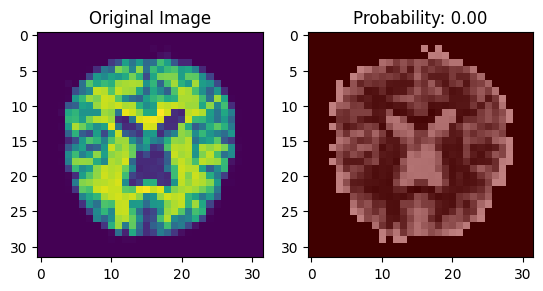

1/1 [==============================] - 0s 220ms/step


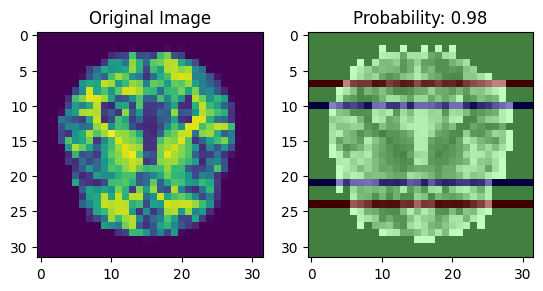

1/1 [==============================] - 0s 166ms/step


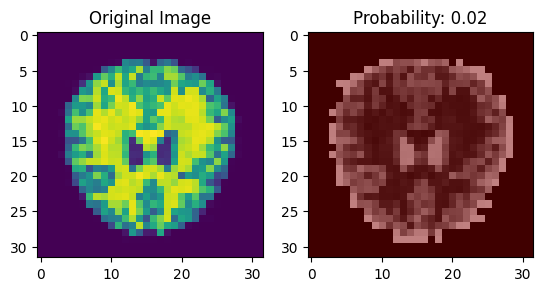

1/1 [==============================] - 0s 164ms/step


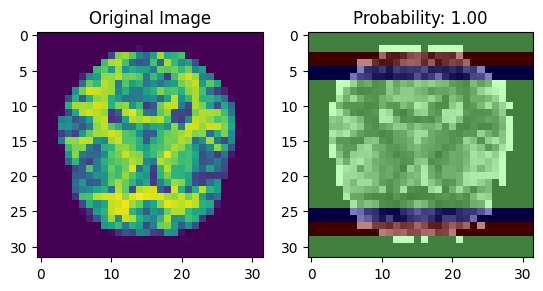

1/1 [==============================] - 0s 170ms/step


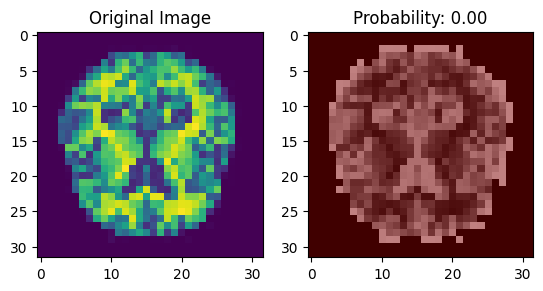

1/1 [==============================] - 0s 153ms/step


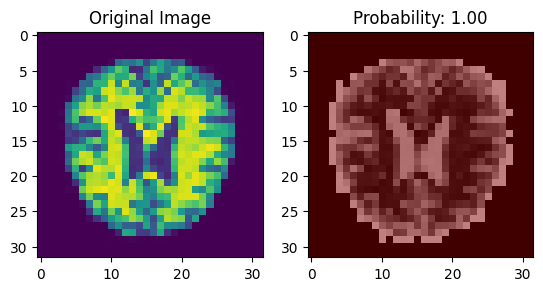

1/1 [==============================] - 0s 152ms/step


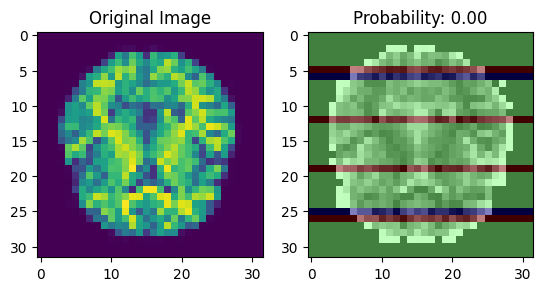

1/1 [==============================] - 0s 179ms/step


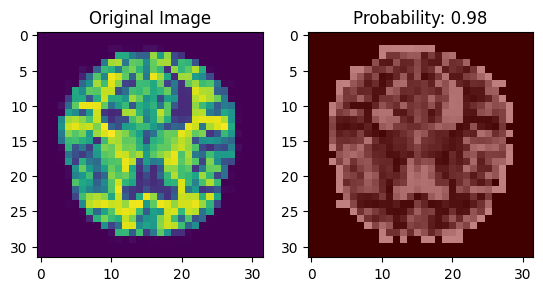

1/1 [==============================] - 0s 203ms/step


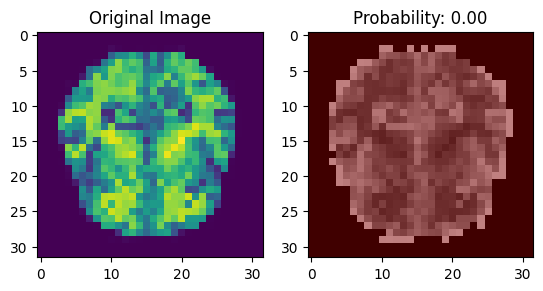

1/1 [==============================] - 0s 184ms/step


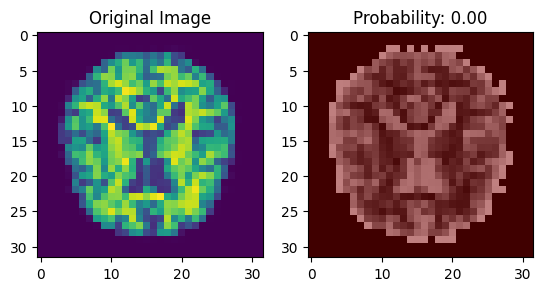

1/1 [==============================] - 0s 173ms/step


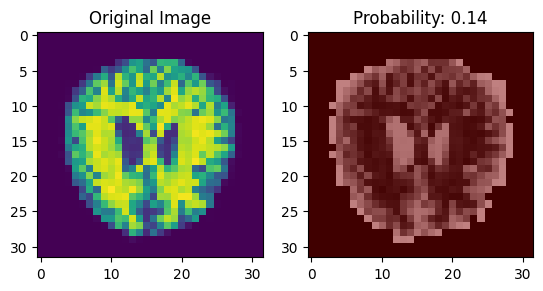

1/1 [==============================] - 0s 175ms/step


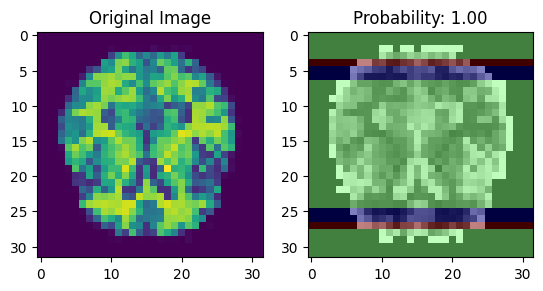

1/1 [==============================] - 0s 199ms/step


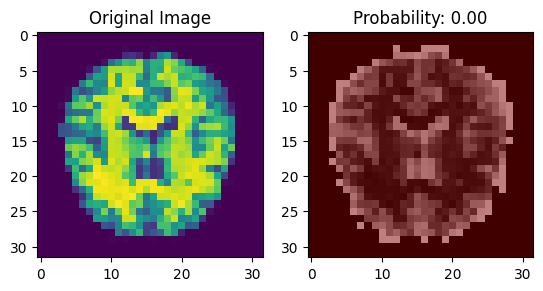

1/1 [==============================] - 0s 200ms/step


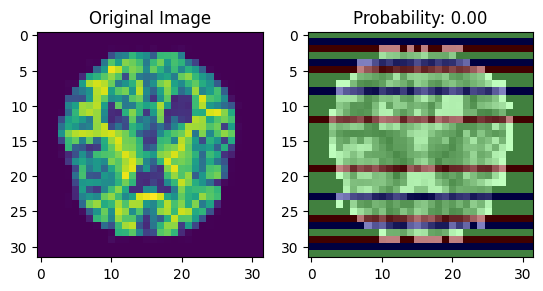

1/1 [==============================] - 0s 183ms/step


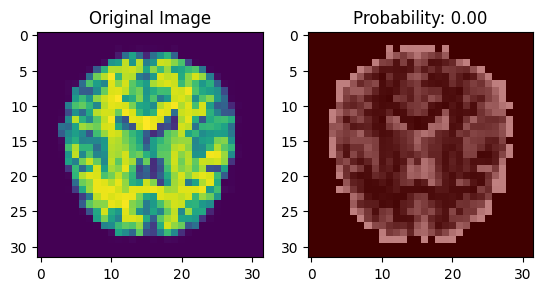

1/1 [==============================] - 0s 233ms/step


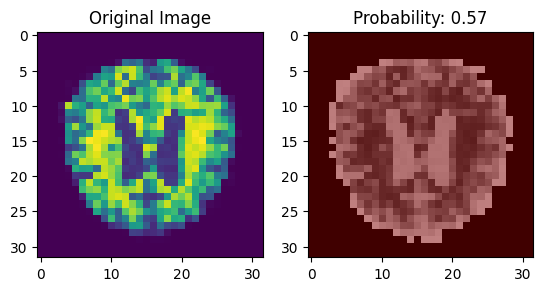

1/1 [==============================] - 0s 173ms/step


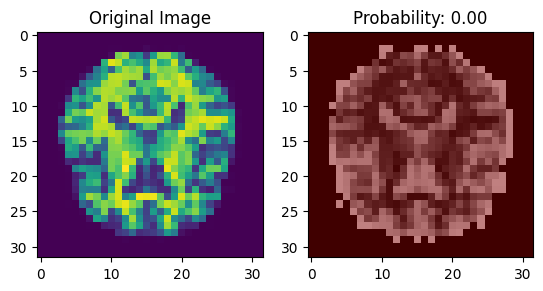

1/1 [==============================] - 0s 234ms/step


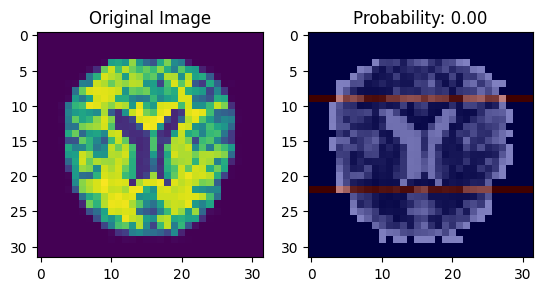

1/1 [==============================] - 0s 165ms/step


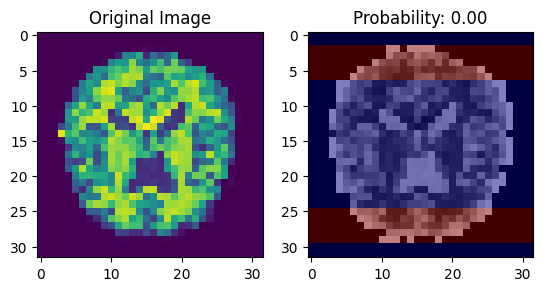

1/1 [==============================] - 0s 167ms/step


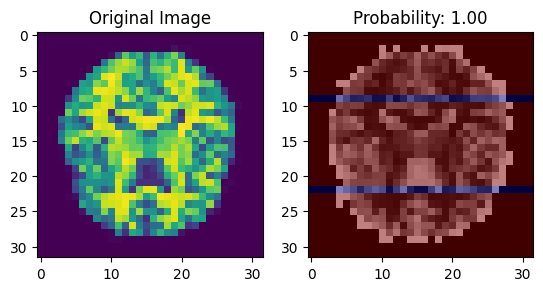

1/1 [==============================] - 0s 167ms/step


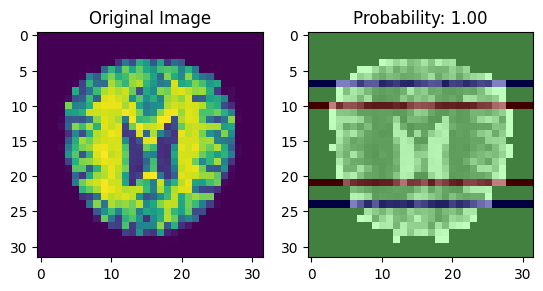

1/1 [==============================] - 0s 155ms/step


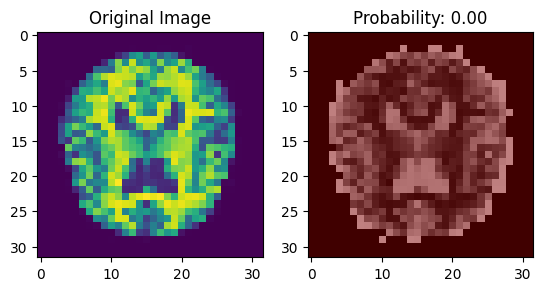

1/1 [==============================] - 0s 164ms/step


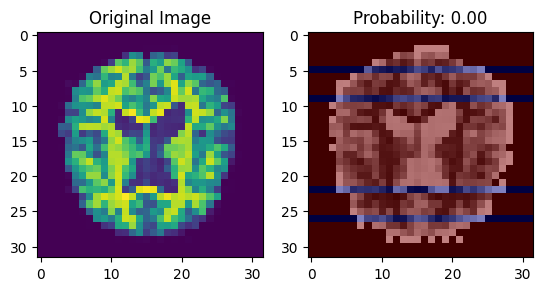

1/1 [==============================] - 0s 155ms/step


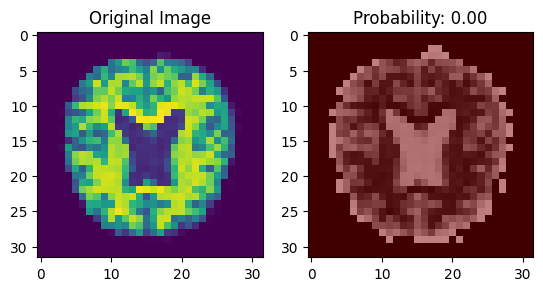

1/1 [==============================] - 0s 162ms/step


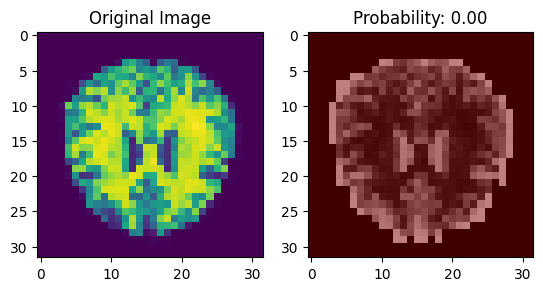

1/1 [==============================] - 0s 171ms/step


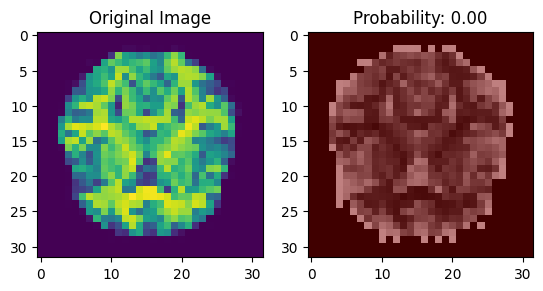

1/1 [==============================] - 0s 180ms/step


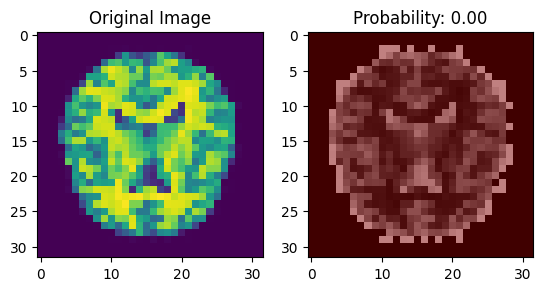

1/1 [==============================] - 0s 165ms/step


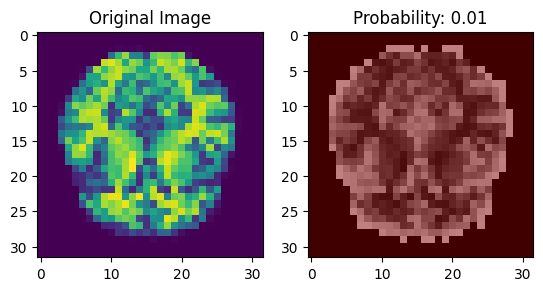

1/1 [==============================] - 0s 173ms/step


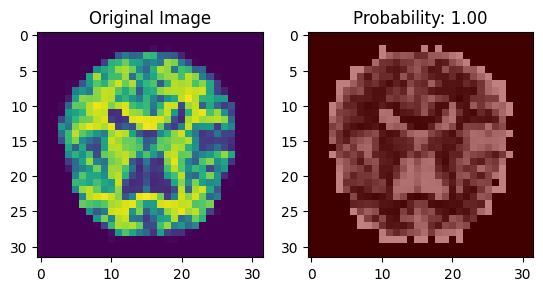

1/1 [==============================] - 0s 218ms/step


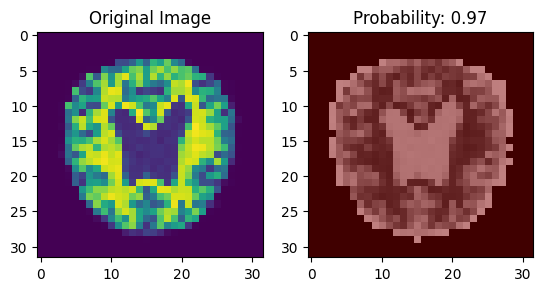

1/1 [==============================] - 0s 217ms/step


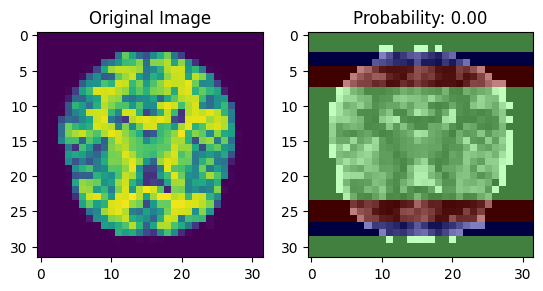

1/1 [==============================] - 0s 197ms/step


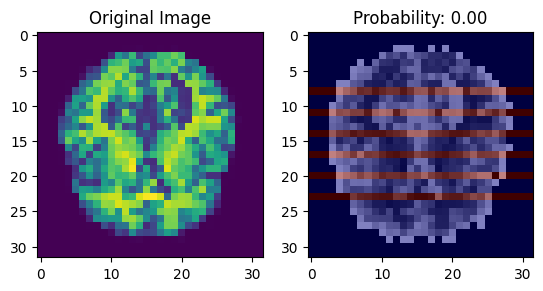

1/1 [==============================] - 0s 282ms/step


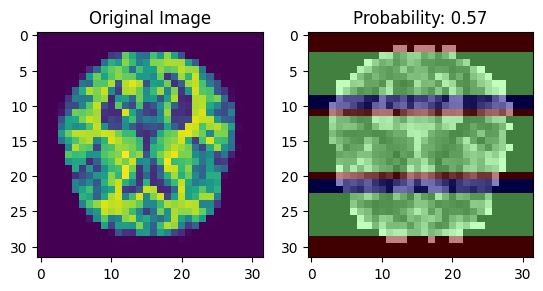

1/1 [==============================] - 0s 167ms/step


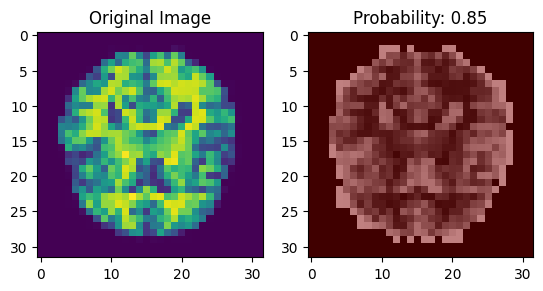

1/1 [==============================] - 0s 208ms/step


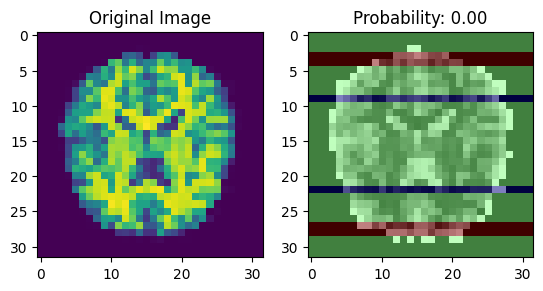

1/1 [==============================] - 0s 169ms/step


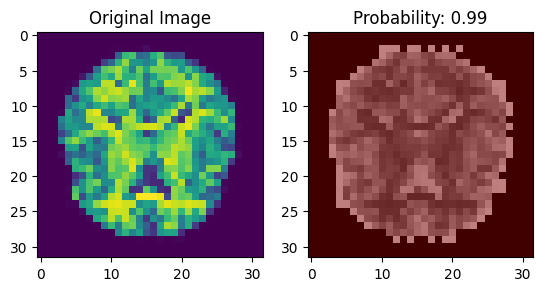

1/1 [==============================] - 0s 208ms/step


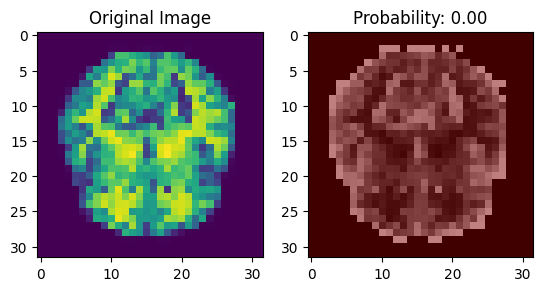

1/1 [==============================] - 0s 172ms/step


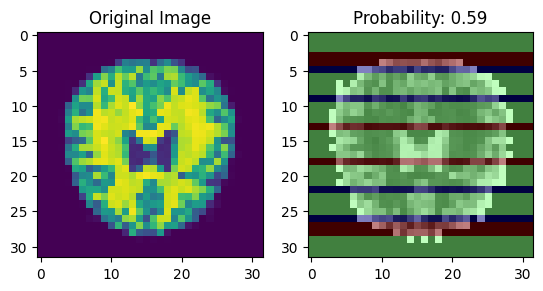

1/1 [==============================] - 0s 157ms/step


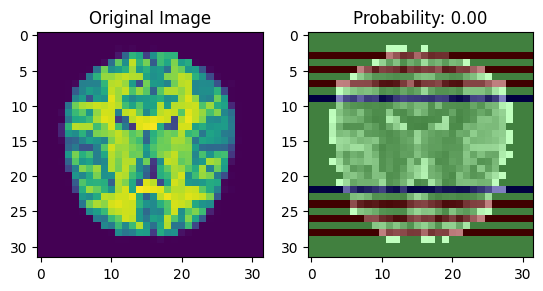

1/1 [==============================] - 0s 154ms/step


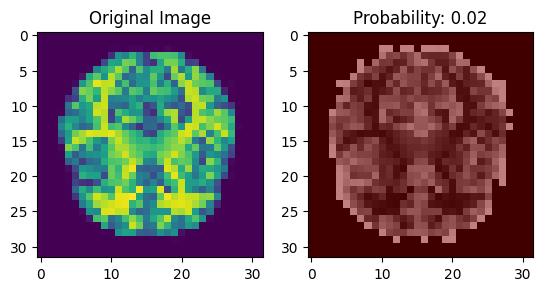

1/1 [==============================] - 0s 165ms/step


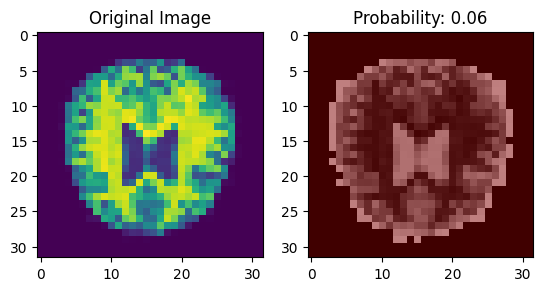

1/1 [==============================] - 0s 171ms/step


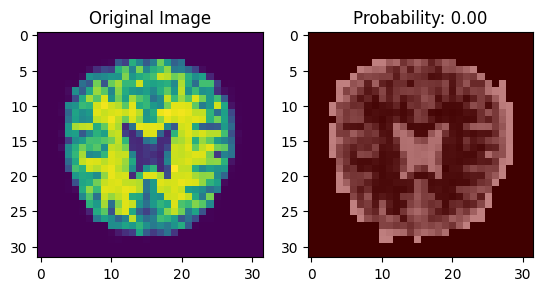

1/1 [==============================] - 0s 159ms/step


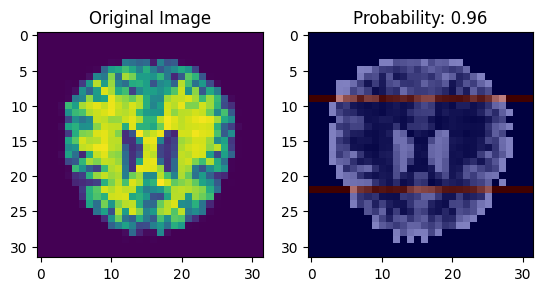

1/1 [==============================] - 0s 187ms/step


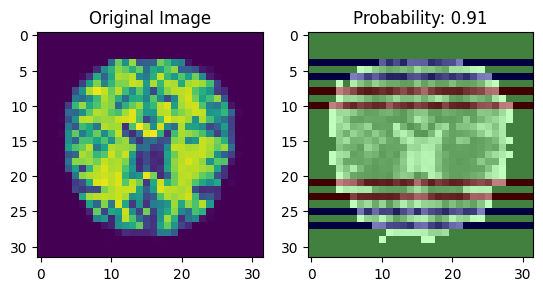

1/1 [==============================] - 0s 159ms/step


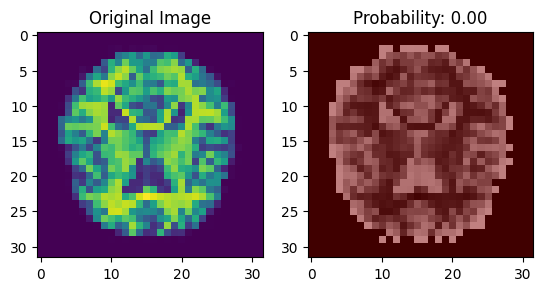

1/1 [==============================] - 0s 160ms/step


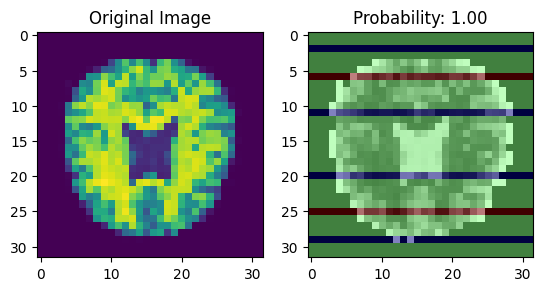

1/1 [==============================] - 0s 181ms/step


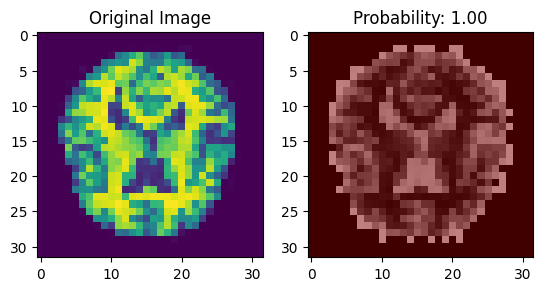

1/1 [==============================] - 0s 160ms/step


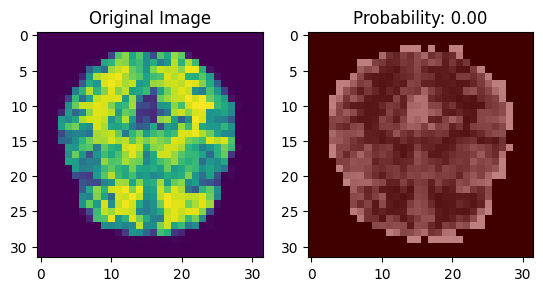

1/1 [==============================] - 0s 291ms/step


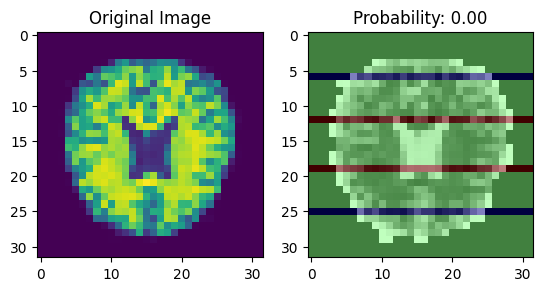

1/1 [==============================] - 0s 212ms/step


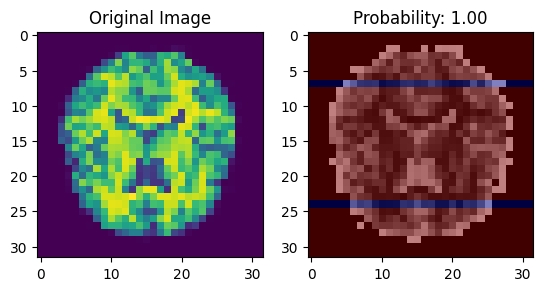

1/1 [==============================] - 0s 228ms/step


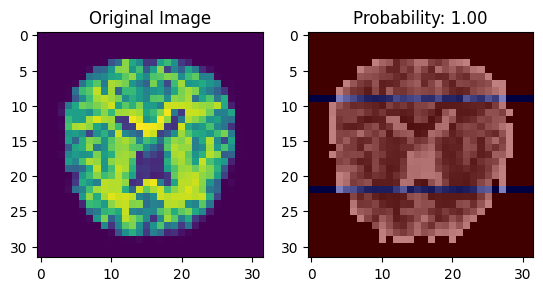

1/1 [==============================] - 0s 173ms/step


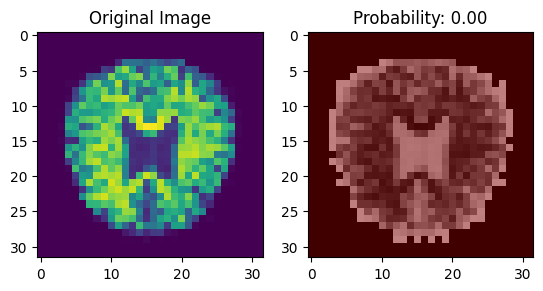

1/1 [==============================] - 0s 188ms/step


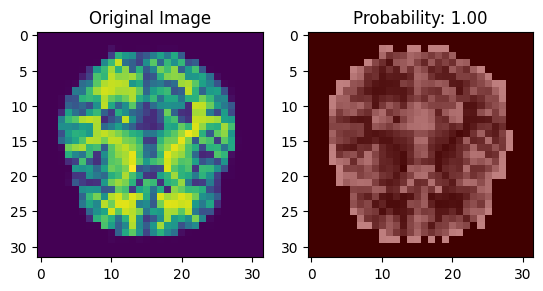

1/1 [==============================] - 0s 182ms/step


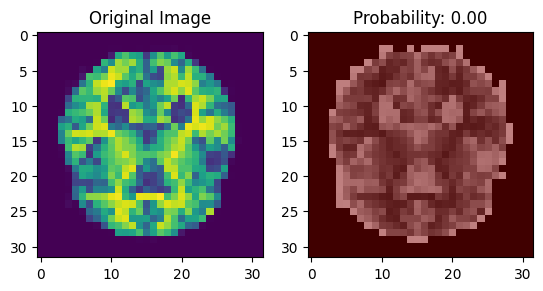

1/1 [==============================] - 0s 171ms/step


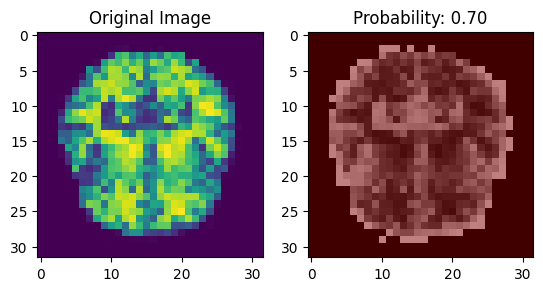

1/1 [==============================] - 0s 178ms/step


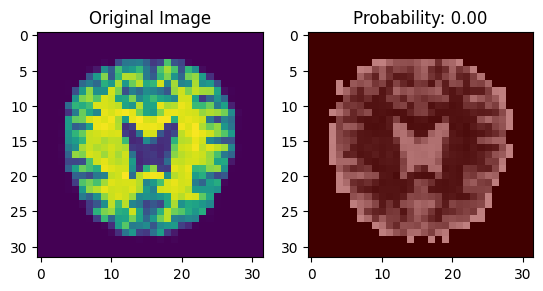

1/1 [==============================] - 0s 154ms/step


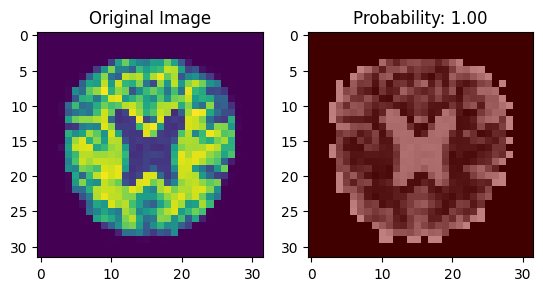

1/1 [==============================] - 0s 155ms/step


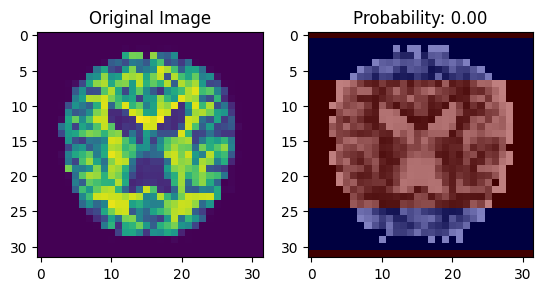

1/1 [==============================] - 0s 158ms/step


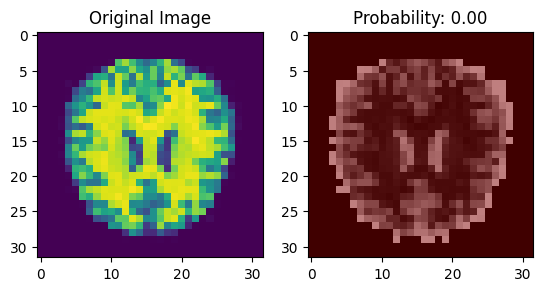

1/1 [==============================] - 0s 152ms/step


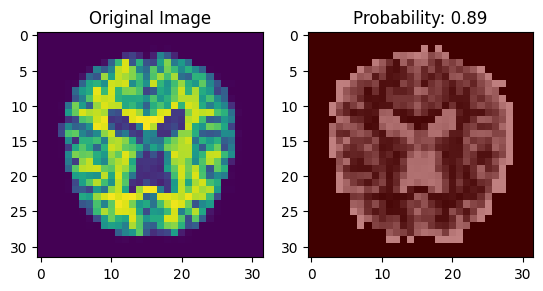

1/1 [==============================] - 0s 167ms/step


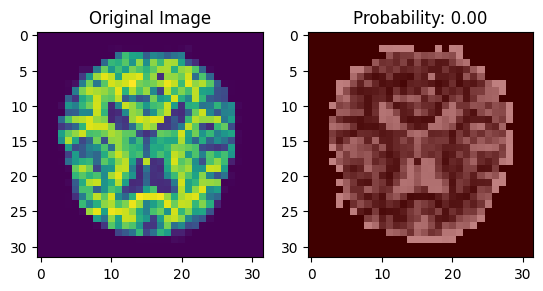

1/1 [==============================] - 0s 155ms/step


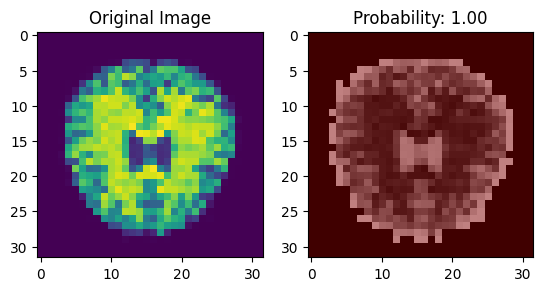

1/1 [==============================] - 0s 171ms/step


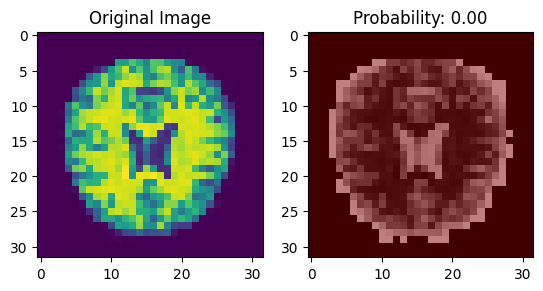

1/1 [==============================] - 0s 269ms/step


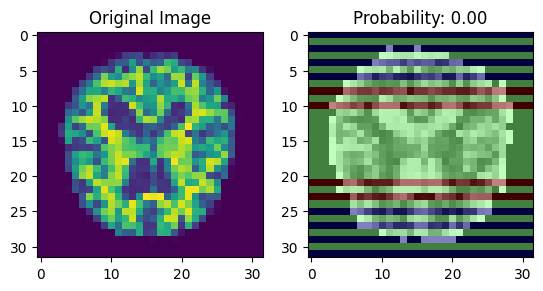

1/1 [==============================] - 0s 179ms/step


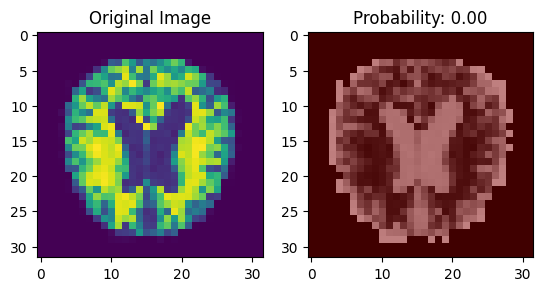

1/1 [==============================] - 0s 214ms/step


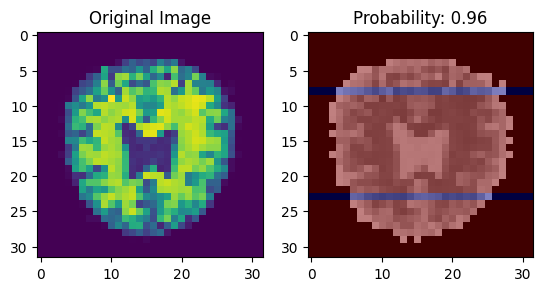

1/1 [==============================] - 0s 211ms/step


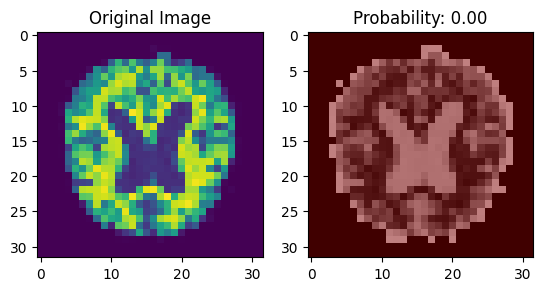

1/1 [==============================] - 0s 172ms/step


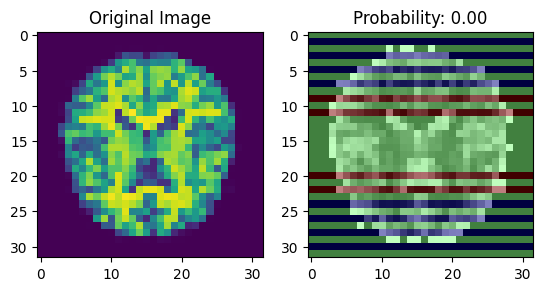

1/1 [==============================] - 0s 211ms/step


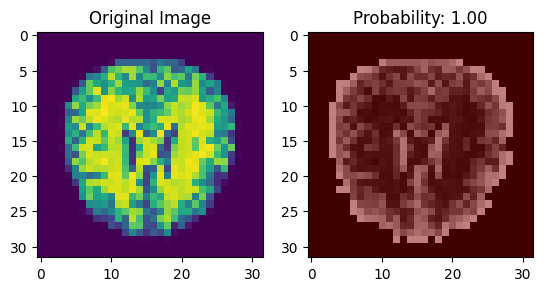

1/1 [==============================] - 0s 203ms/step


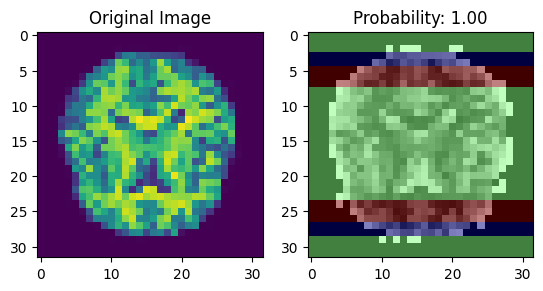

1/1 [==============================] - 0s 206ms/step


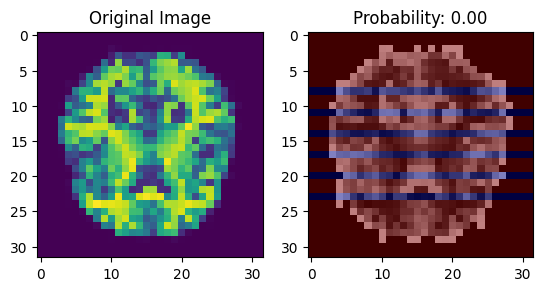

1/1 [==============================] - 0s 179ms/step


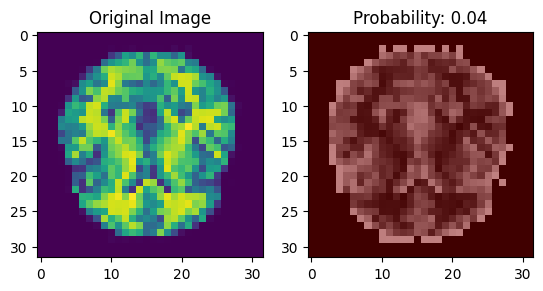

1/1 [==============================] - 0s 169ms/step


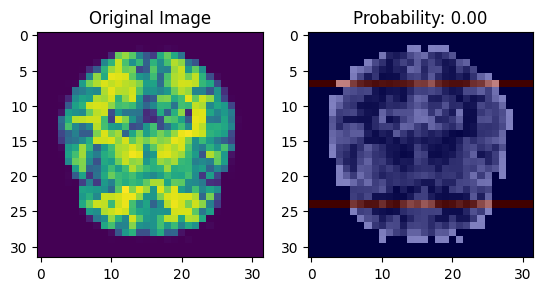

1/1 [==============================] - 0s 167ms/step


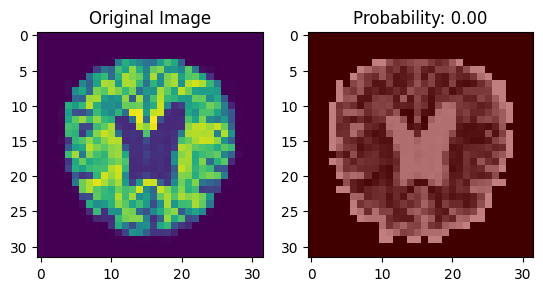

1/1 [==============================] - 0s 163ms/step


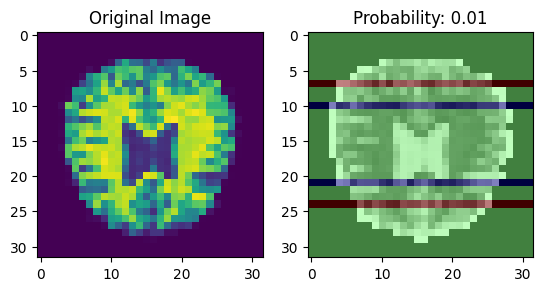

1/1 [==============================] - 0s 164ms/step


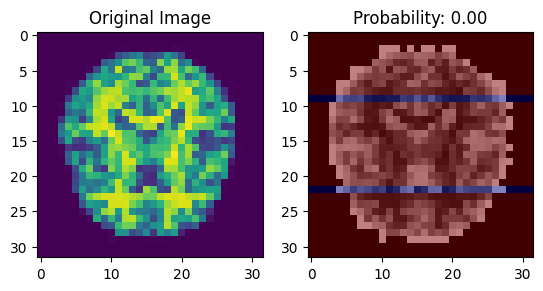

1/1 [==============================] - 0s 200ms/step


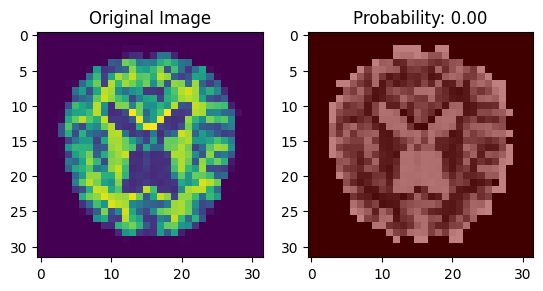

1/1 [==============================] - 0s 162ms/step


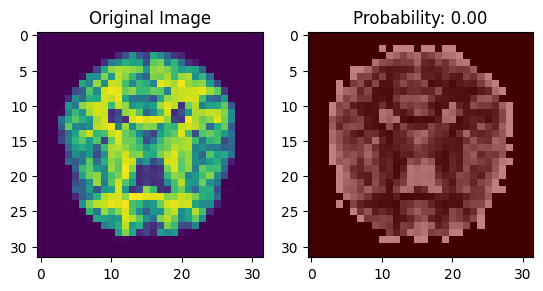

1/1 [==============================] - 0s 181ms/step


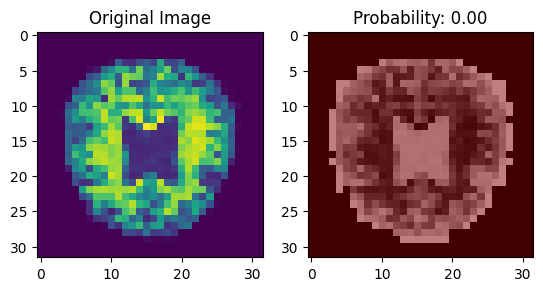

1/1 [==============================] - 0s 225ms/step


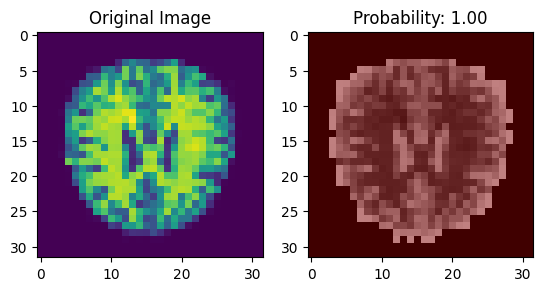

1/1 [==============================] - 0s 173ms/step


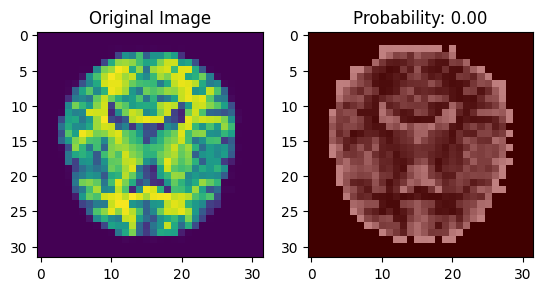

1/1 [==============================] - 0s 165ms/step


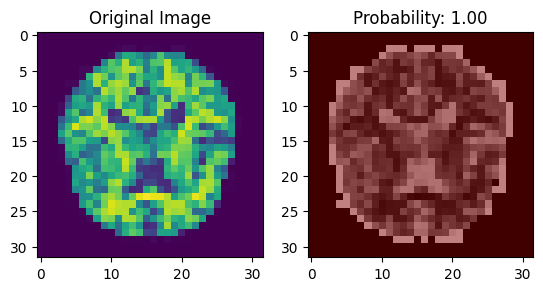

1/1 [==============================] - 0s 169ms/step


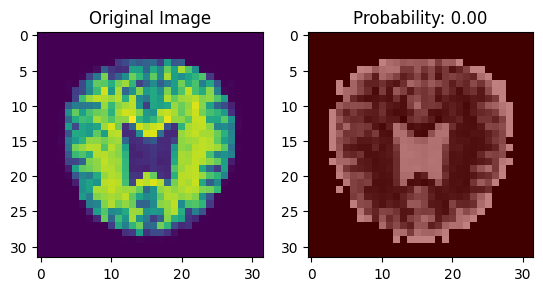

1/1 [==============================] - 0s 210ms/step


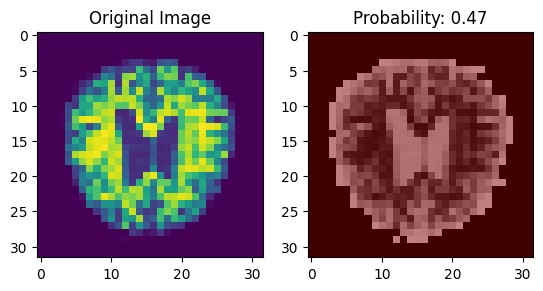

1/1 [==============================] - 0s 154ms/step


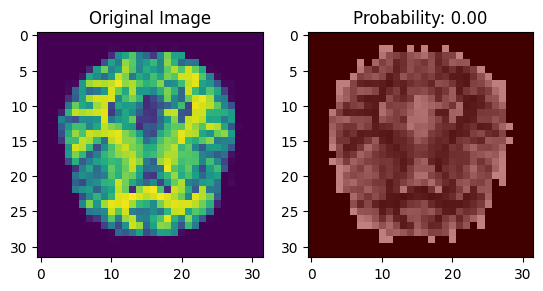

1/1 [==============================] - 0s 162ms/step


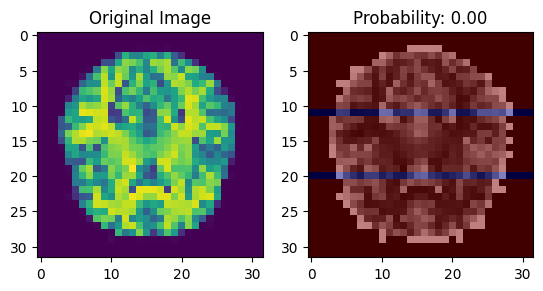

1/1 [==============================] - 0s 160ms/step


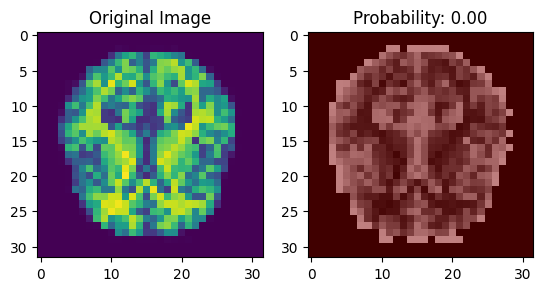

1/1 [==============================] - 0s 169ms/step


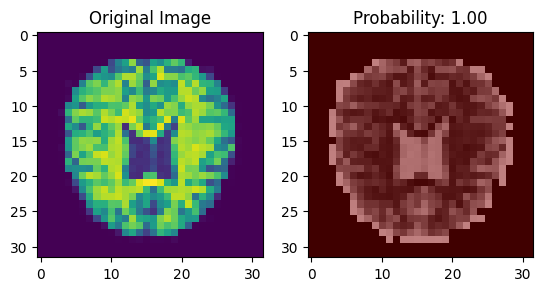

1/1 [==============================] - 0s 221ms/step


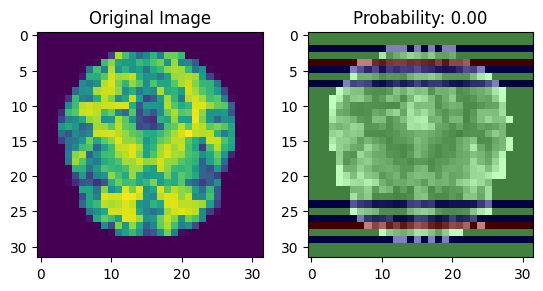

1/1 [==============================] - 0s 179ms/step


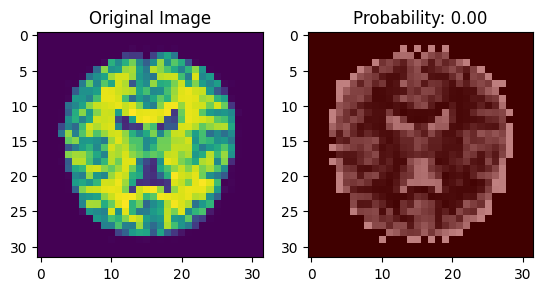

1/1 [==============================] - 0s 194ms/step


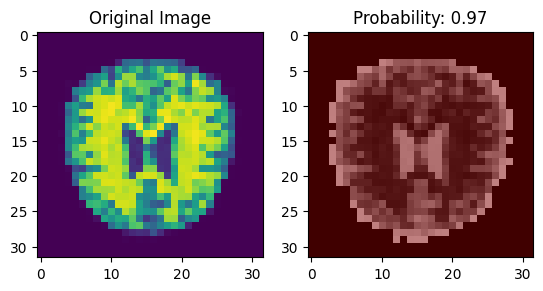

1/1 [==============================] - 0s 162ms/step


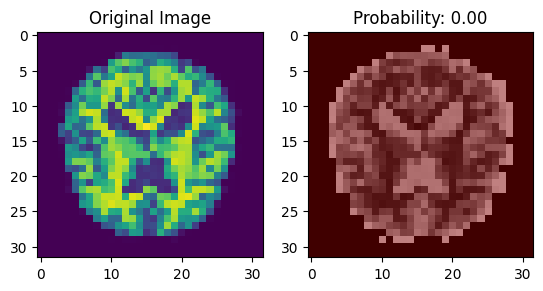

1/1 [==============================] - 0s 163ms/step


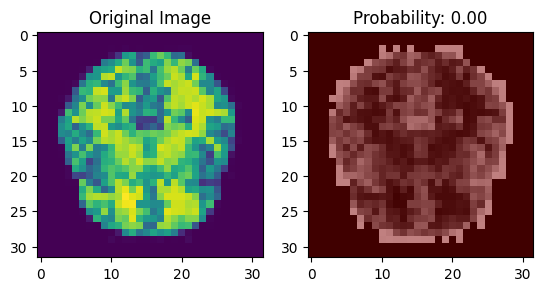

1/1 [==============================] - 0s 173ms/step


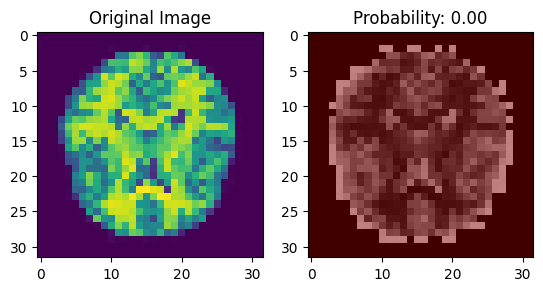

1/1 [==============================] - 0s 174ms/step


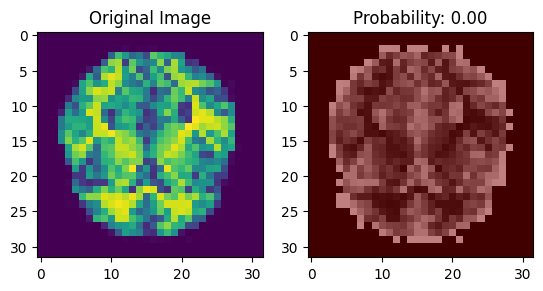

1/1 [==============================] - 0s 180ms/step


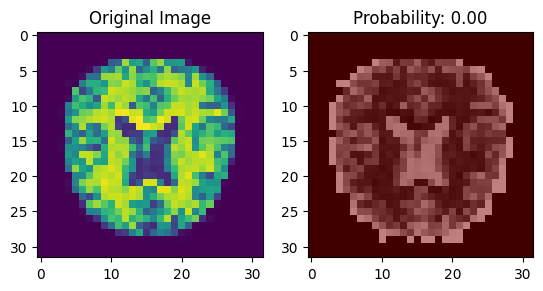

1/1 [==============================] - 0s 166ms/step


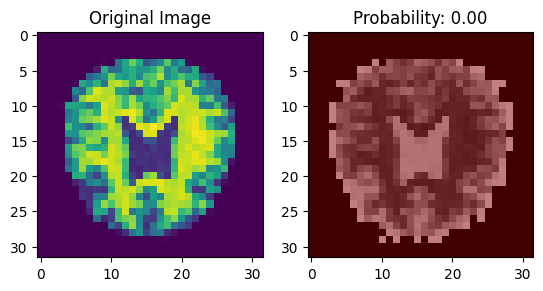

1/1 [==============================] - 0s 215ms/step


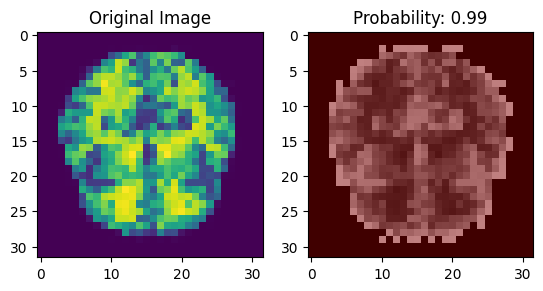

1/1 [==============================] - 0s 225ms/step


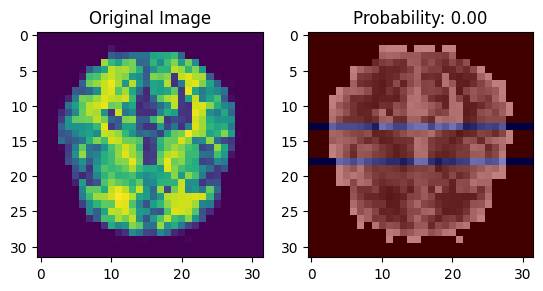

1/1 [==============================] - 0s 210ms/step


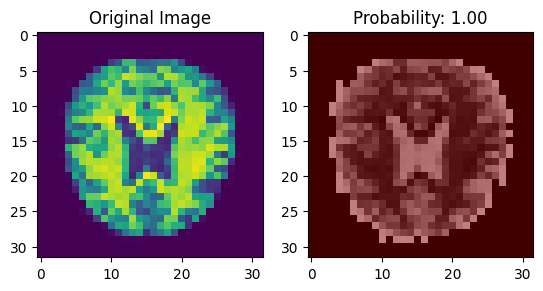

1/1 [==============================] - 0s 152ms/step


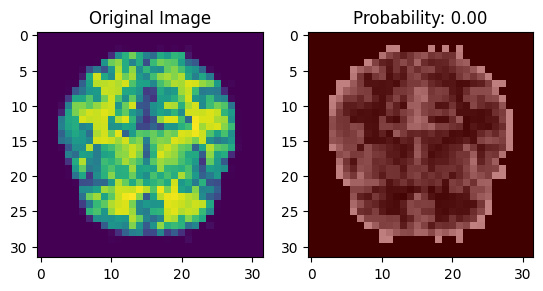

1/1 [==============================] - 0s 172ms/step


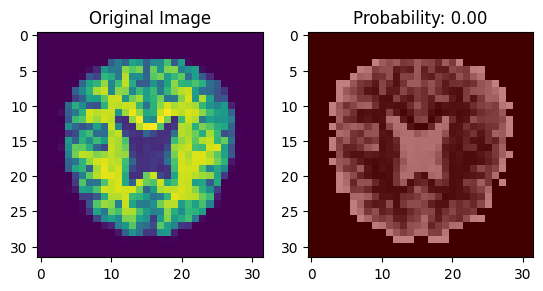

1/1 [==============================] - 0s 154ms/step


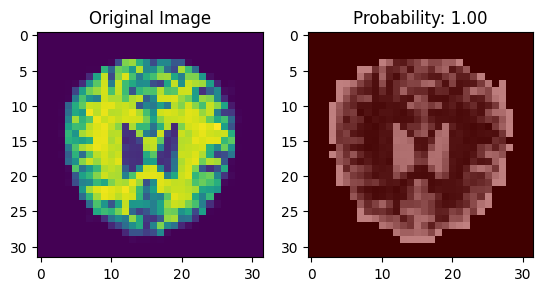

1/1 [==============================] - 0s 153ms/step


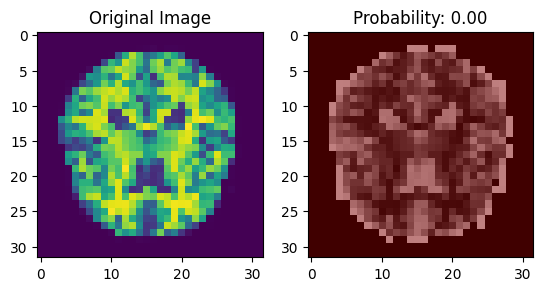

1/1 [==============================] - 0s 155ms/step


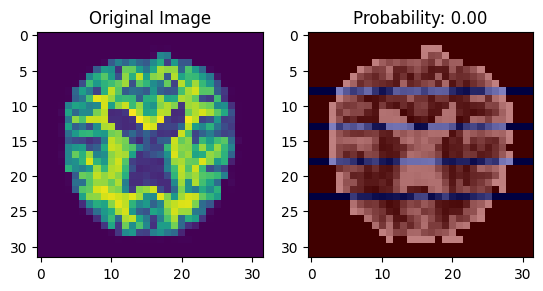

1/1 [==============================] - 0s 158ms/step


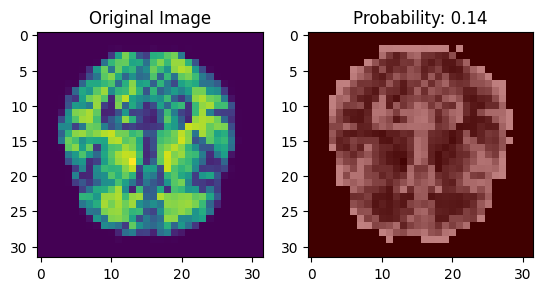

1/1 [==============================] - 0s 169ms/step


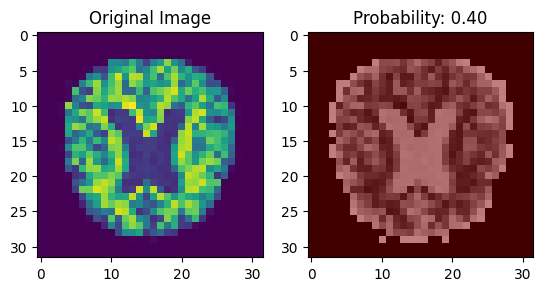

1/1 [==============================] - 0s 160ms/step


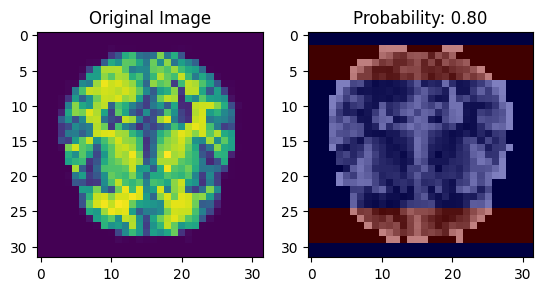

1/1 [==============================] - 0s 205ms/step


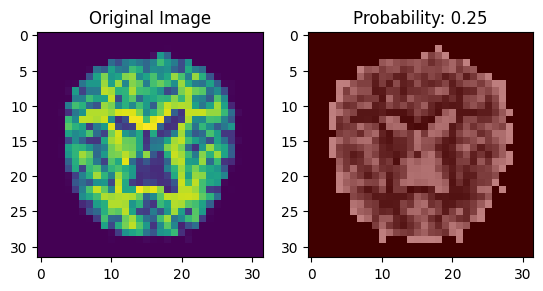

1/1 [==============================] - 0s 175ms/step


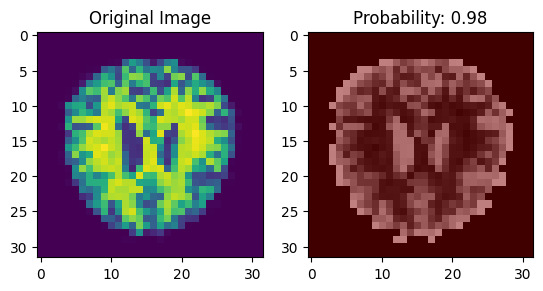

1/1 [==============================] - 0s 185ms/step


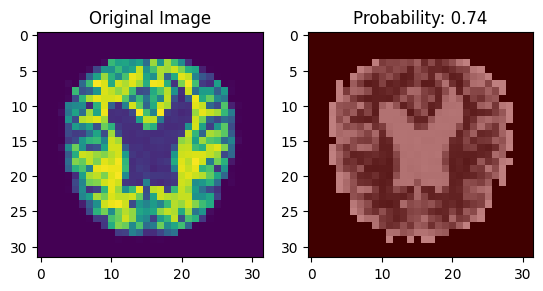

1/1 [==============================] - 0s 223ms/step


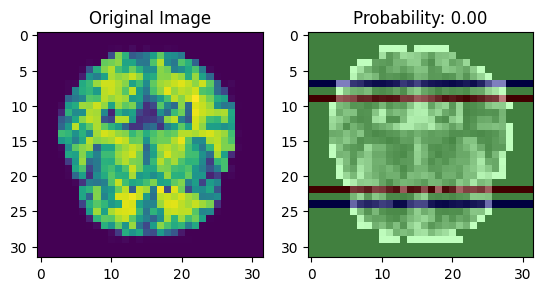

1/1 [==============================] - 0s 194ms/step


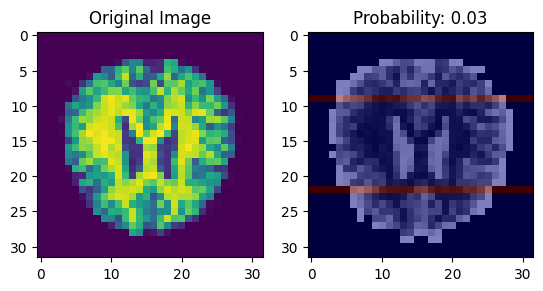

1/1 [==============================] - 0s 235ms/step


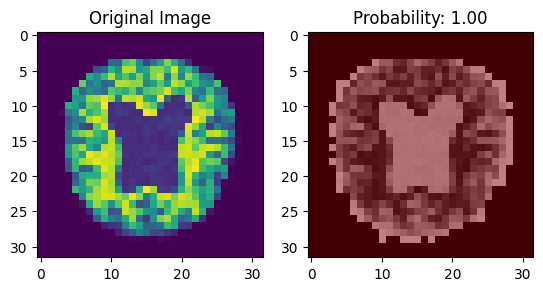

1/1 [==============================] - 0s 188ms/step


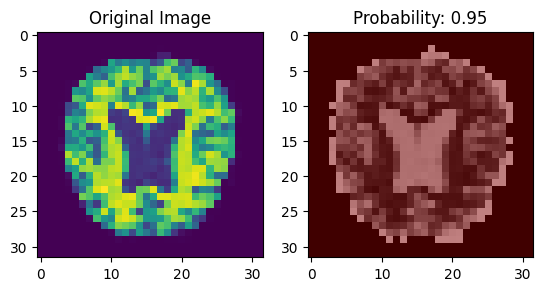

1/1 [==============================] - 0s 219ms/step


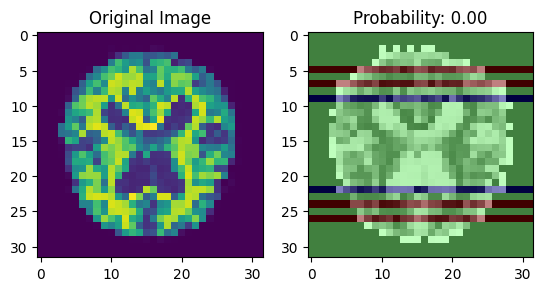

1/1 [==============================] - 0s 247ms/step


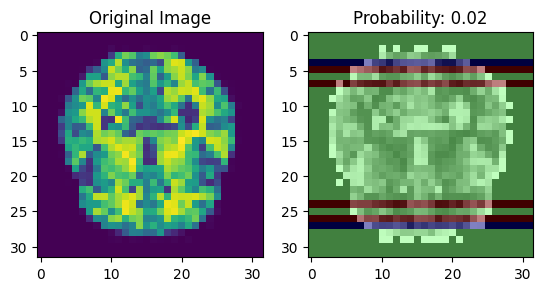

1/1 [==============================] - 0s 175ms/step


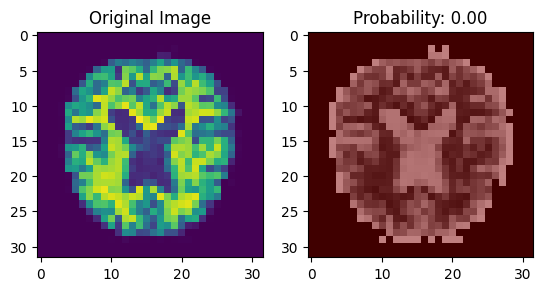

1/1 [==============================] - 0s 166ms/step


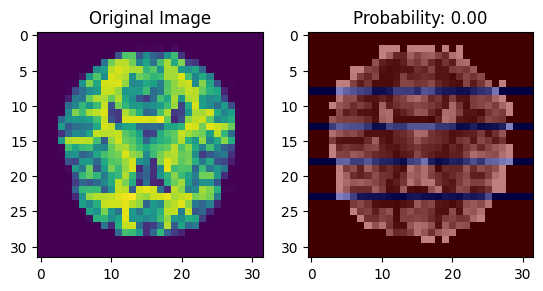

1/1 [==============================] - 0s 175ms/step


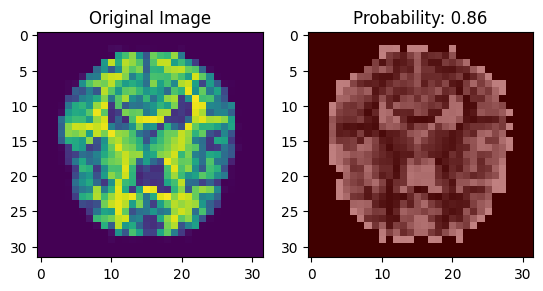

1/1 [==============================] - 0s 162ms/step


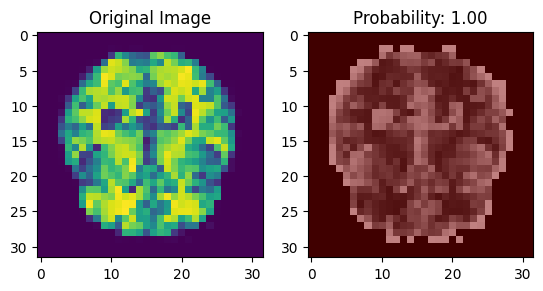

1/1 [==============================] - 0s 154ms/step


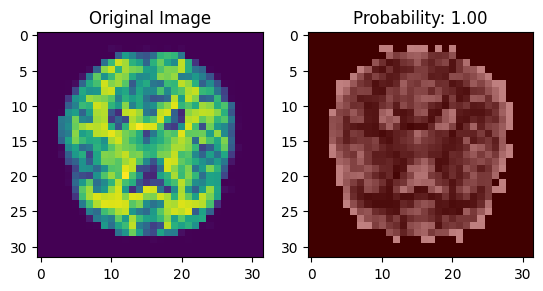

1/1 [==============================] - 0s 155ms/step


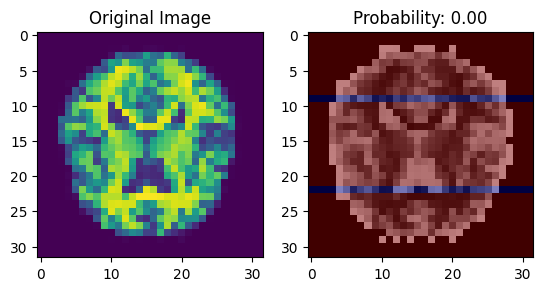

1/1 [==============================] - 0s 157ms/step


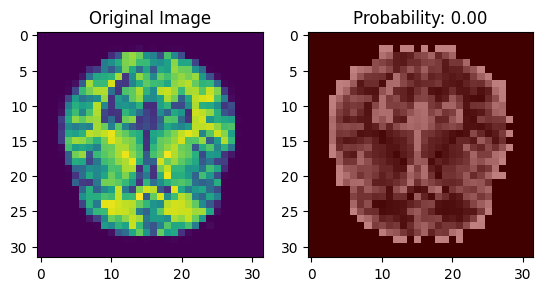

1/1 [==============================] - 0s 172ms/step


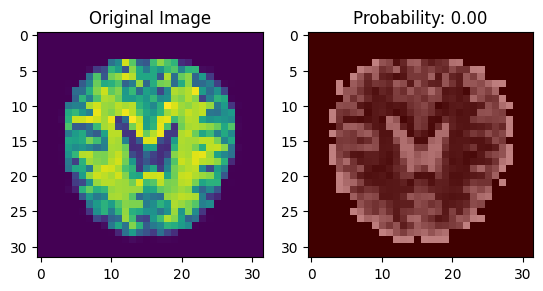

1/1 [==============================] - 0s 174ms/step


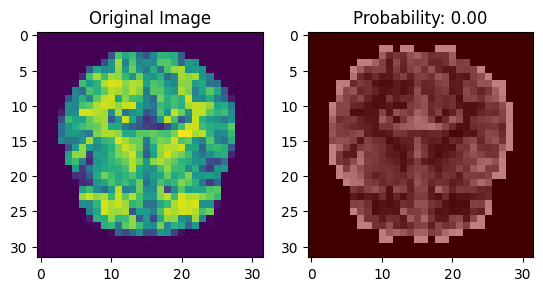

1/1 [==============================] - 0s 172ms/step


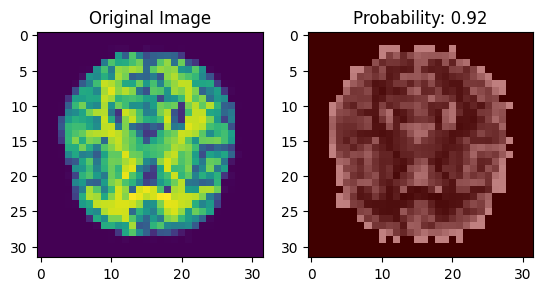

1/1 [==============================] - 0s 218ms/step


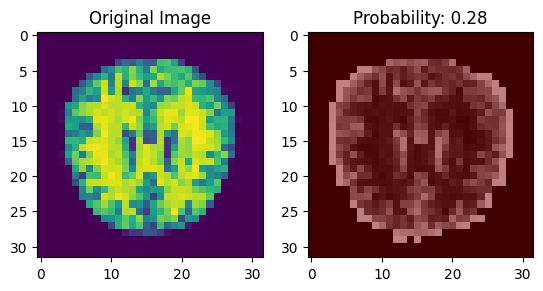

1/1 [==============================] - 0s 298ms/step


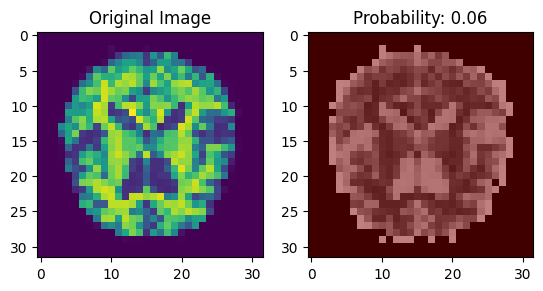

1/1 [==============================] - 0s 262ms/step


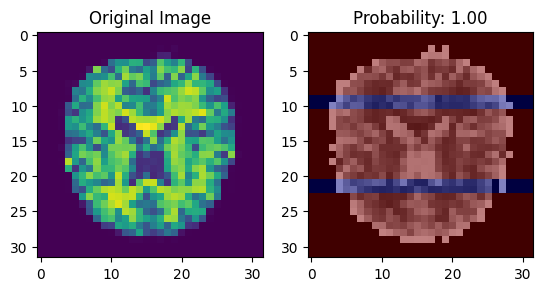

1/1 [==============================] - 0s 195ms/step


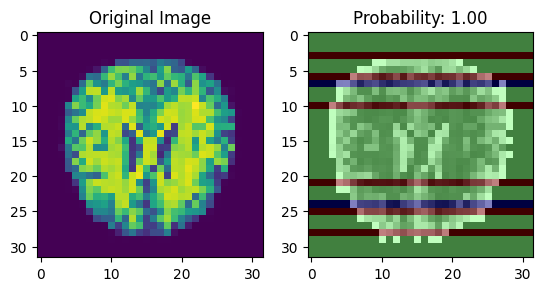

1/1 [==============================] - 0s 176ms/step


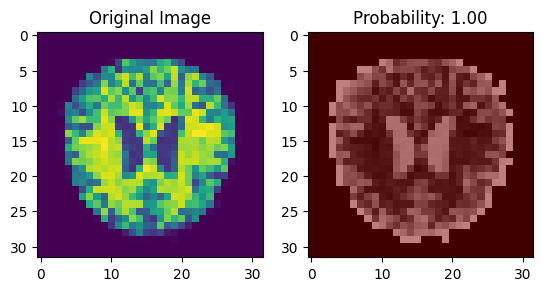

1/1 [==============================] - 0s 261ms/step


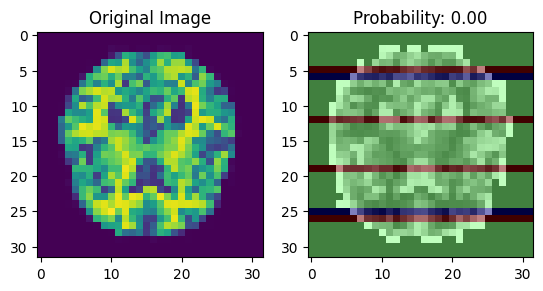

1/1 [==============================] - 0s 162ms/step


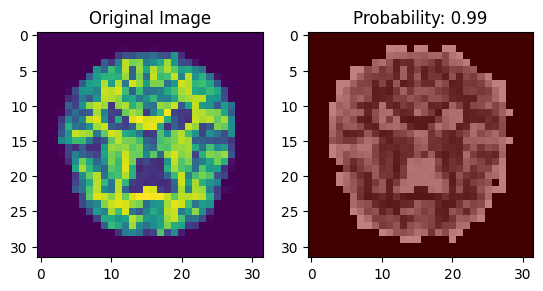

1/1 [==============================] - 0s 162ms/step


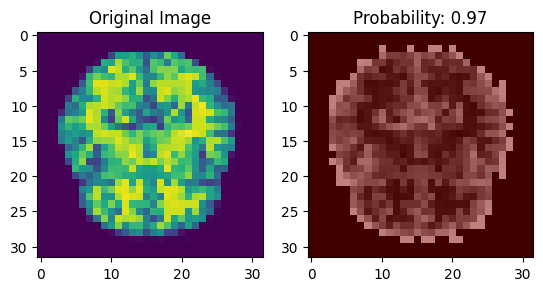

1/1 [==============================] - 0s 175ms/step


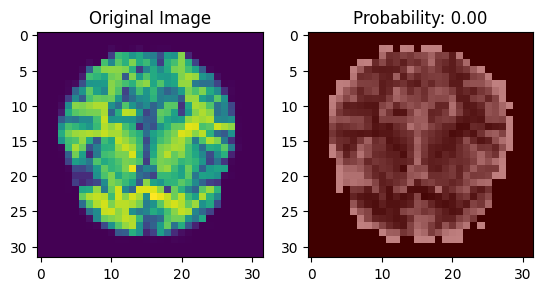

1/1 [==============================] - 0s 164ms/step


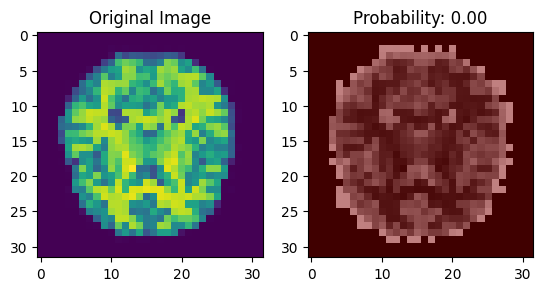

1/1 [==============================] - 0s 166ms/step


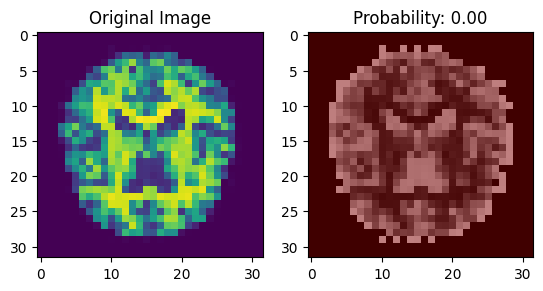

1/1 [==============================] - 0s 167ms/step


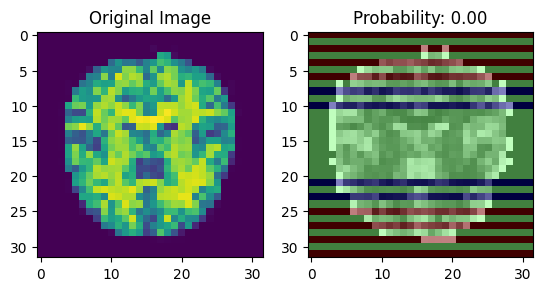

1/1 [==============================] - 0s 162ms/step


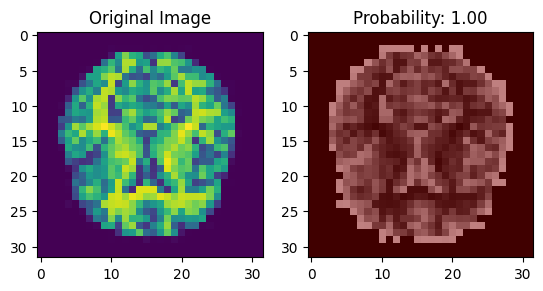

1/1 [==============================] - 0s 171ms/step


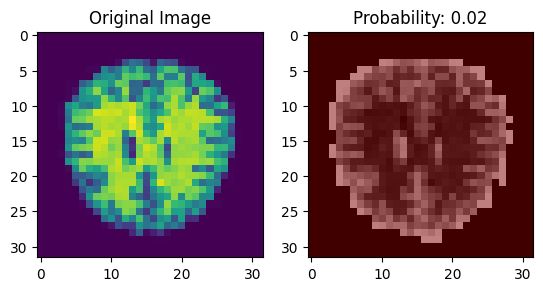

1/1 [==============================] - 0s 165ms/step


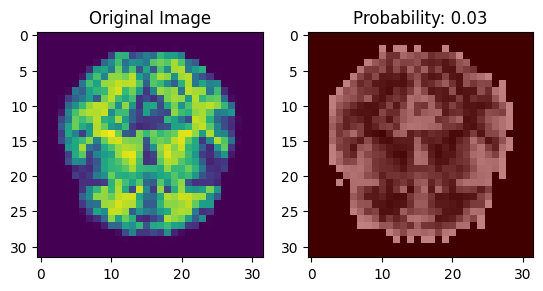

1/1 [==============================] - 0s 190ms/step


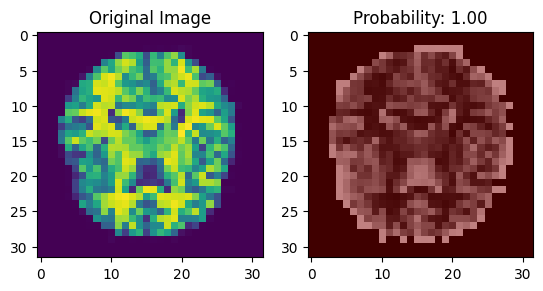

1/1 [==============================] - 0s 163ms/step


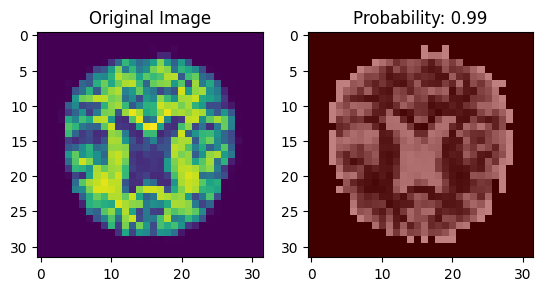

1/1 [==============================] - 0s 230ms/step


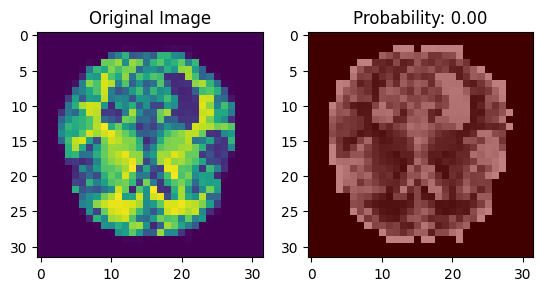

1/1 [==============================] - 0s 190ms/step


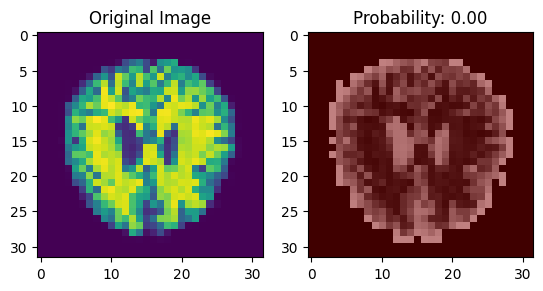

1/1 [==============================] - 0s 213ms/step


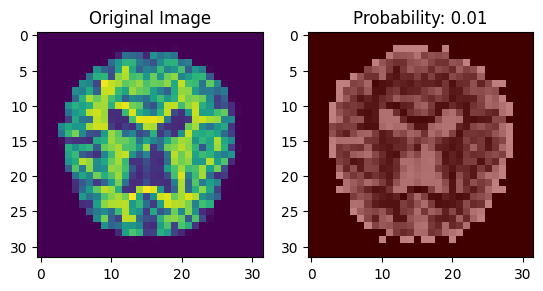

1/1 [==============================] - 0s 239ms/step


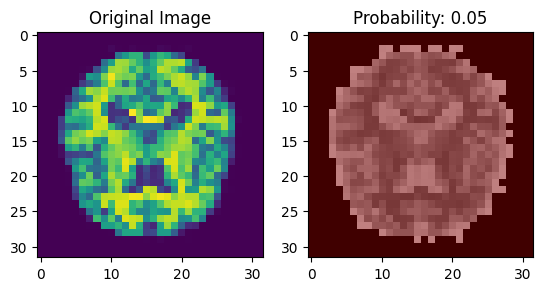

1/1 [==============================] - 0s 229ms/step


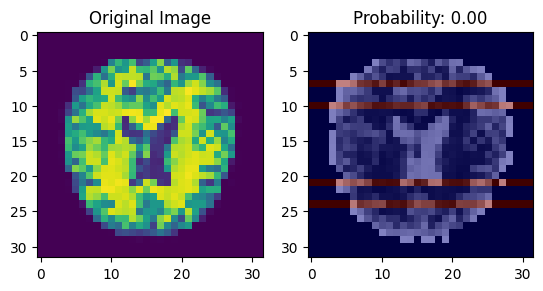

1/1 [==============================] - 0s 199ms/step


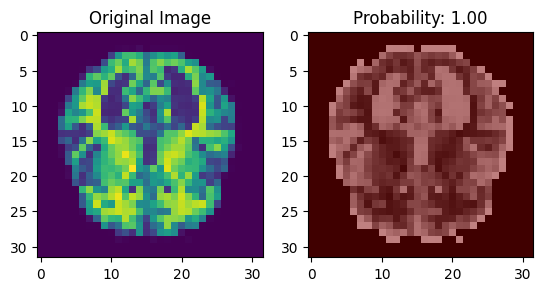

1/1 [==============================] - 0s 219ms/step


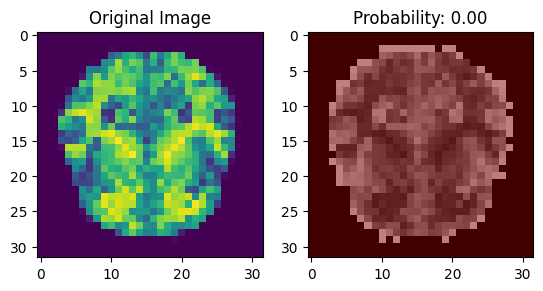

1/1 [==============================] - 0s 202ms/step


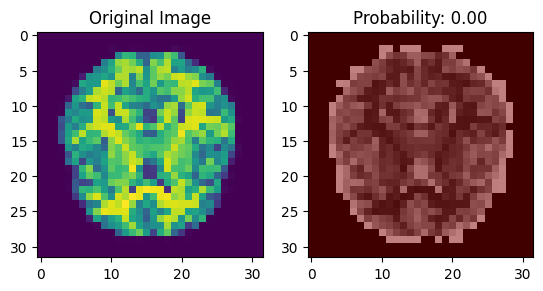

1/1 [==============================] - 0s 180ms/step


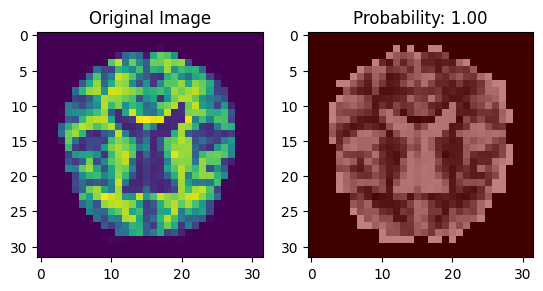

1/1 [==============================] - 0s 189ms/step


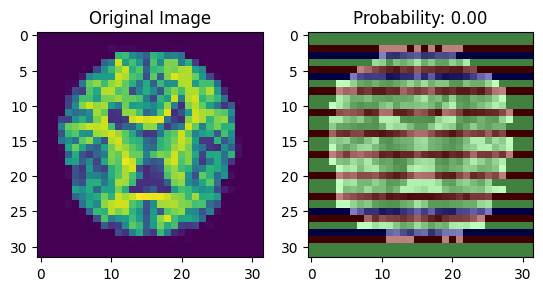

1/1 [==============================] - 0s 175ms/step


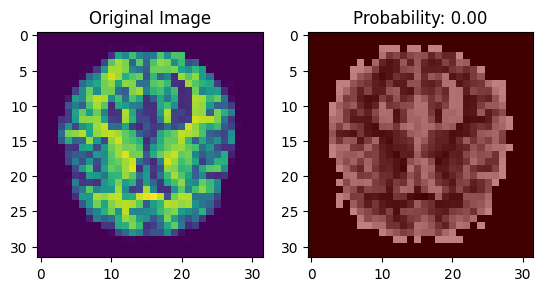

1/1 [==============================] - 0s 186ms/step


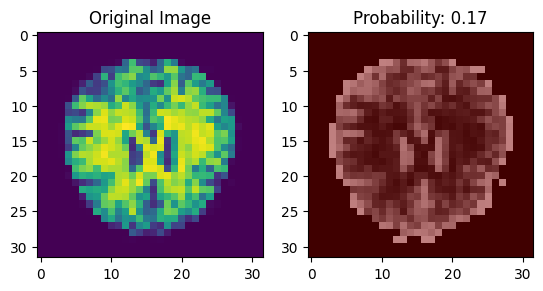

1/1 [==============================] - 0s 207ms/step


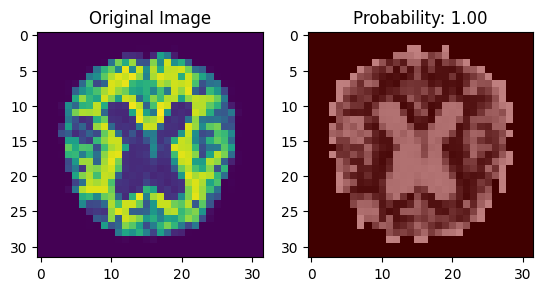

1/1 [==============================] - 0s 167ms/step


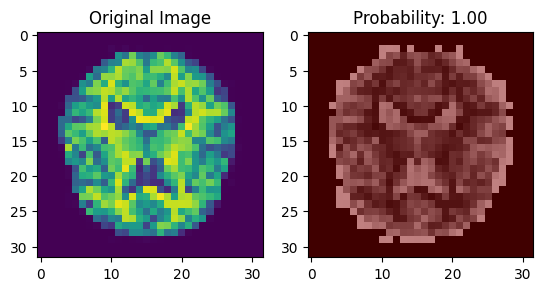

1/1 [==============================] - 0s 215ms/step


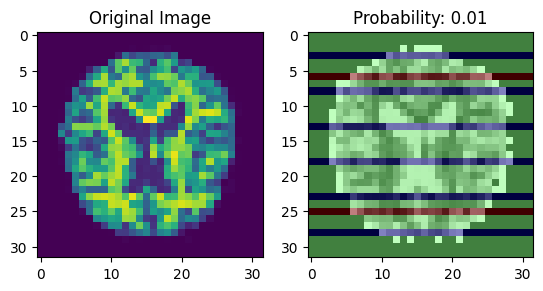

1/1 [==============================] - 0s 170ms/step


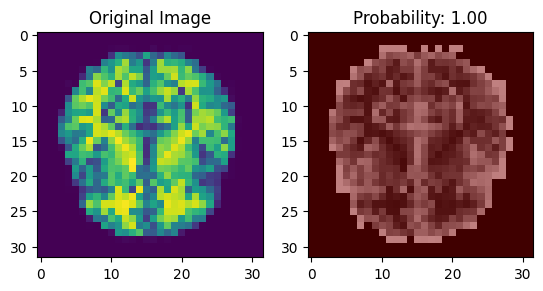

1/1 [==============================] - 0s 199ms/step


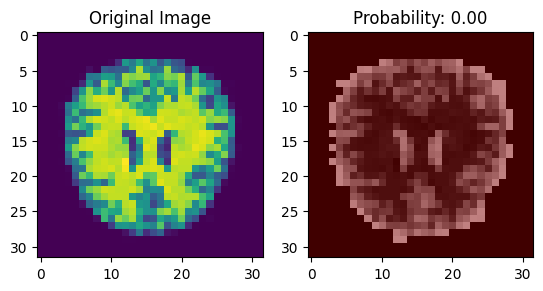

1/1 [==============================] - 0s 213ms/step


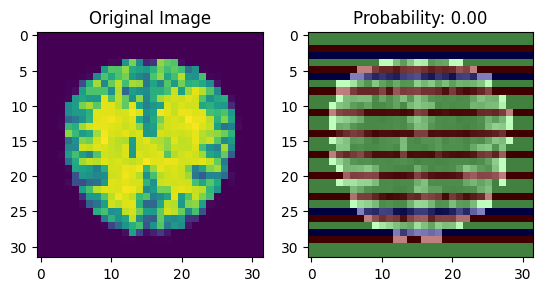

1/1 [==============================] - 0s 249ms/step


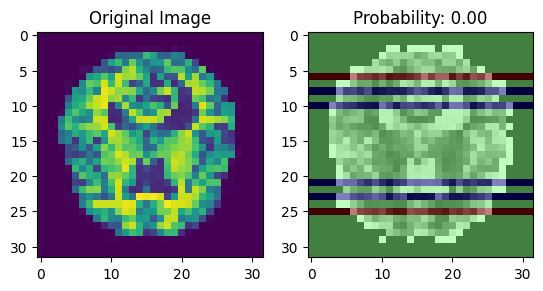

1/1 [==============================] - 0s 239ms/step


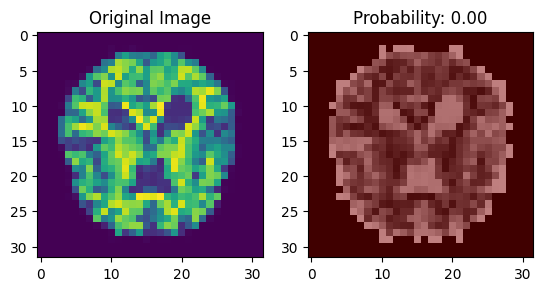

1/1 [==============================] - 0s 173ms/step


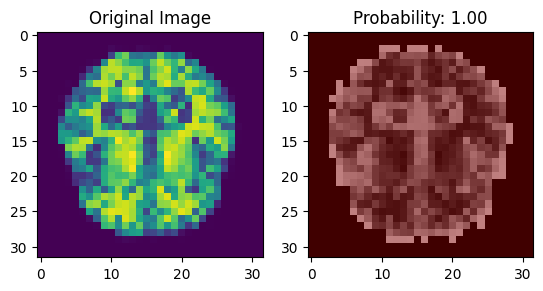

1/1 [==============================] - 0s 190ms/step


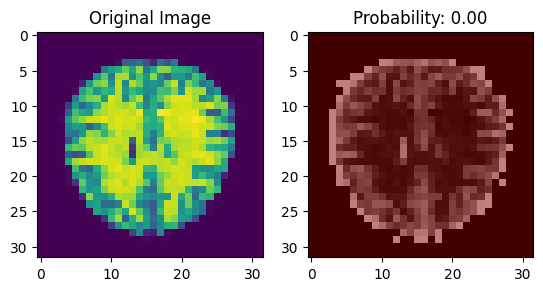

1/1 [==============================] - 0s 172ms/step


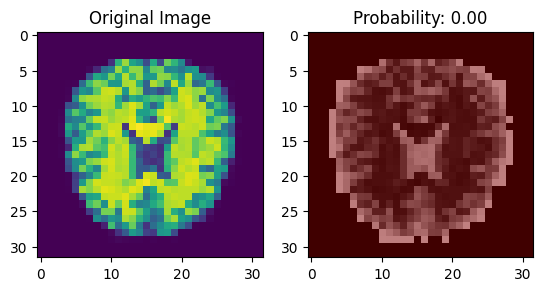

1/1 [==============================] - 0s 172ms/step


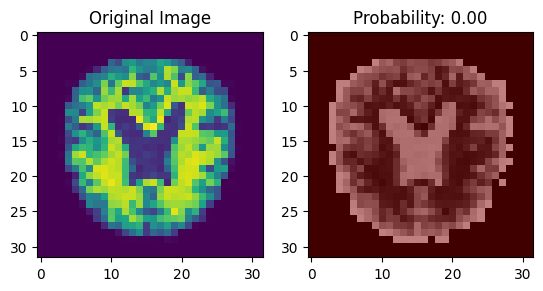

1/1 [==============================] - 0s 216ms/step


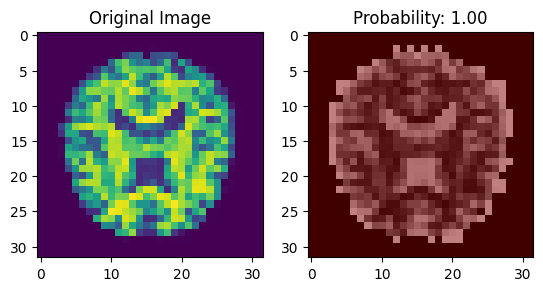

1/1 [==============================] - 0s 208ms/step


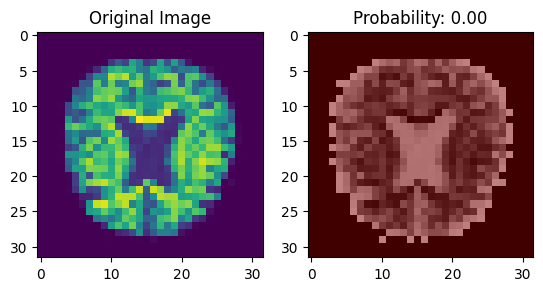

1/1 [==============================] - 0s 210ms/step


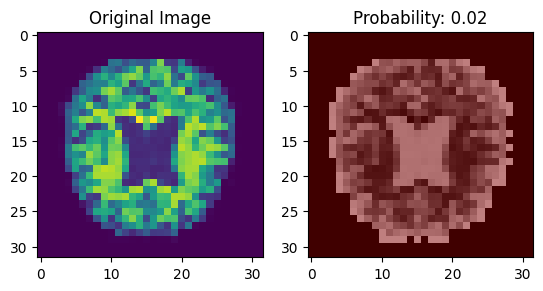

1/1 [==============================] - 0s 177ms/step


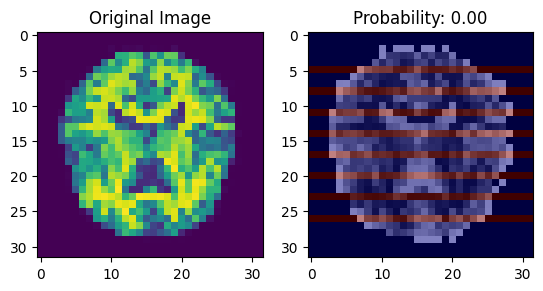

1/1 [==============================] - 0s 172ms/step


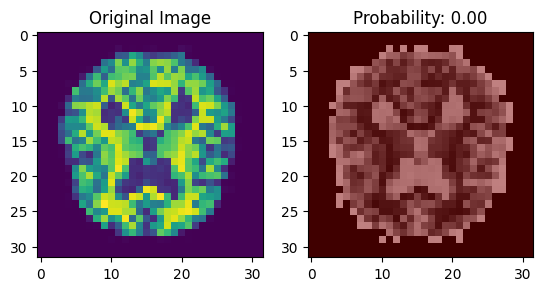

1/1 [==============================] - 0s 171ms/step


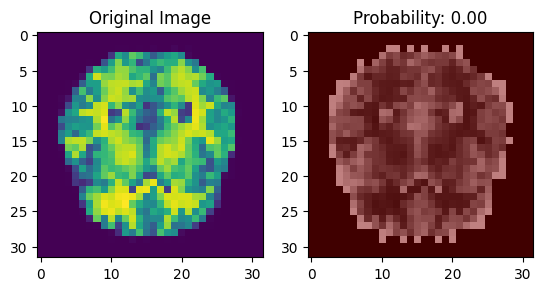

1/1 [==============================] - 0s 229ms/step


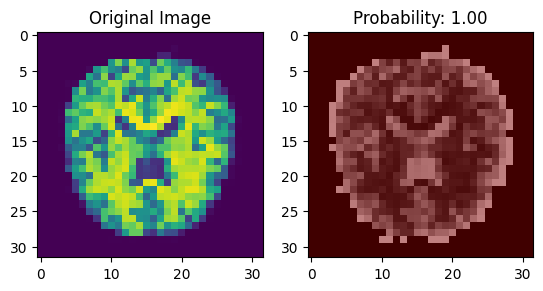

1/1 [==============================] - 0s 192ms/step


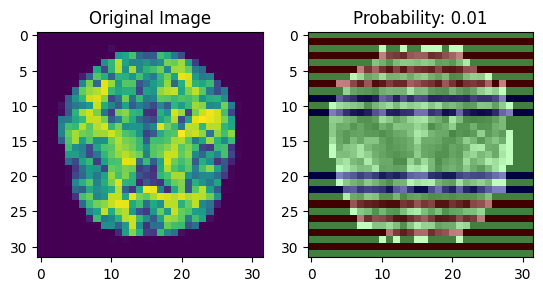

1/1 [==============================] - 0s 253ms/step


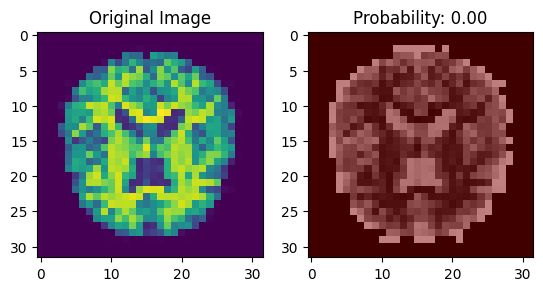

1/1 [==============================] - 0s 165ms/step


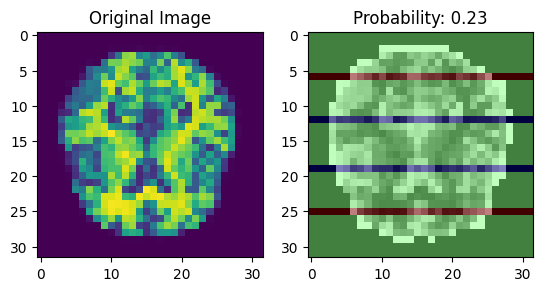

1/1 [==============================] - 0s 188ms/step


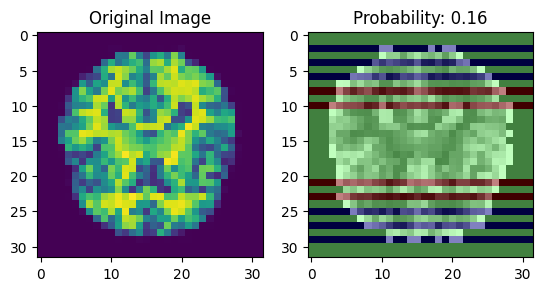

1/1 [==============================] - 0s 216ms/step


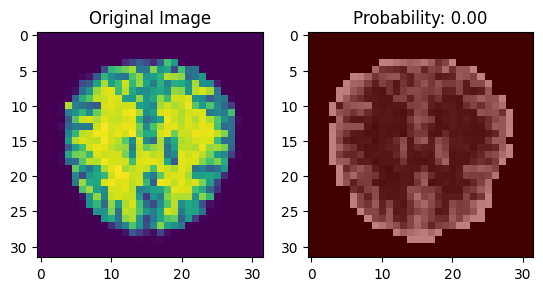

1/1 [==============================] - 0s 189ms/step


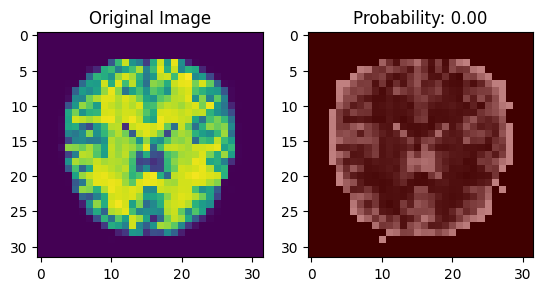

1/1 [==============================] - 0s 166ms/step


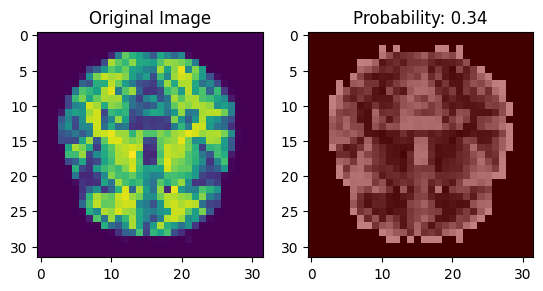

1/1 [==============================] - 0s 171ms/step


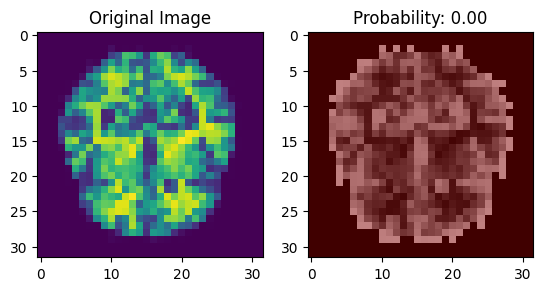

1/1 [==============================] - 0s 162ms/step


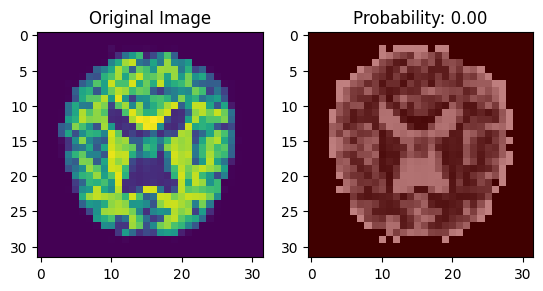

1/1 [==============================] - 0s 178ms/step


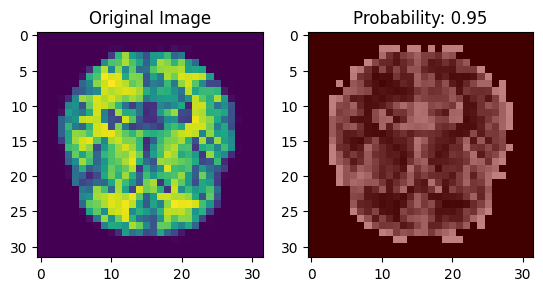

1/1 [==============================] - 0s 182ms/step


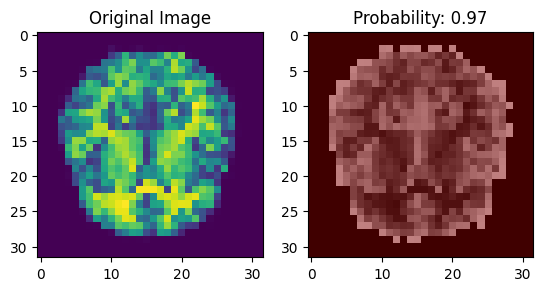

1/1 [==============================] - 0s 160ms/step


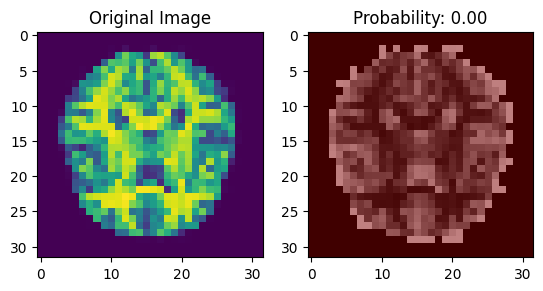

1/1 [==============================] - 0s 173ms/step


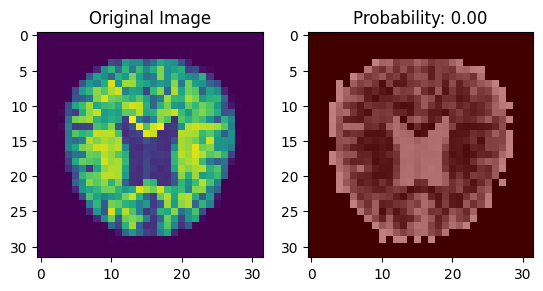

1/1 [==============================] - 1s 783ms/step


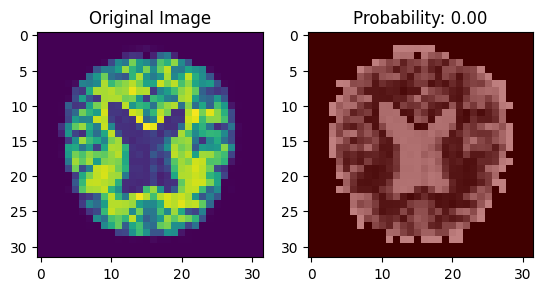

1/1 [==============================] - 0s 180ms/step


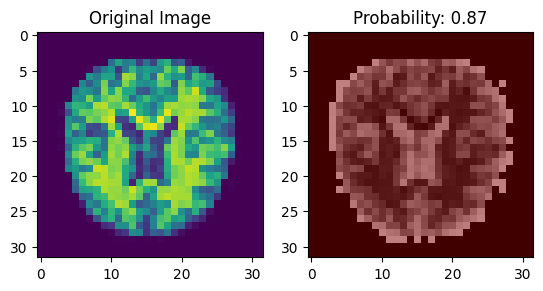

1/1 [==============================] - 0s 308ms/step


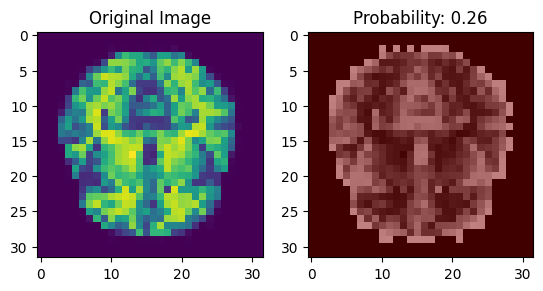

1/1 [==============================] - 0s 276ms/step


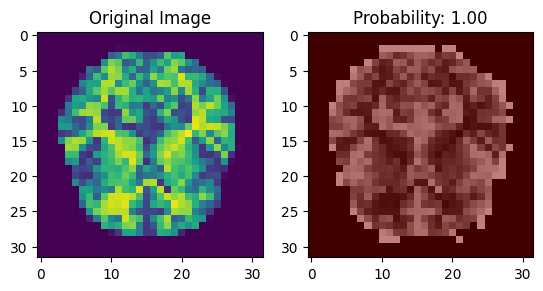

1/1 [==============================] - 0s 238ms/step


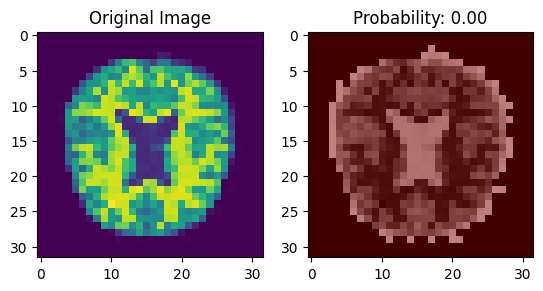

1/1 [==============================] - 0s 294ms/step


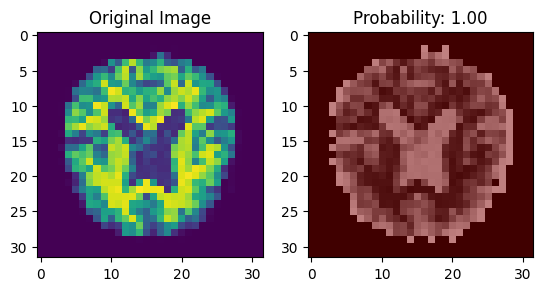

1/1 [==============================] - 0s 213ms/step


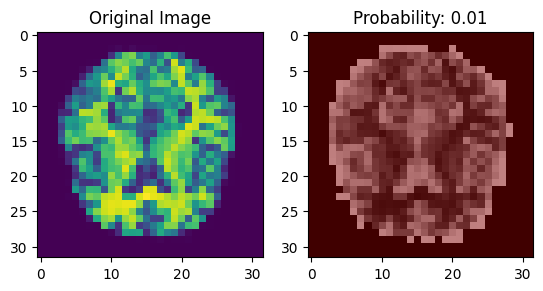

1/1 [==============================] - 0s 161ms/step


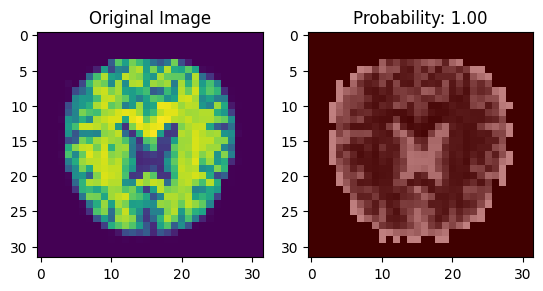

1/1 [==============================] - 0s 165ms/step


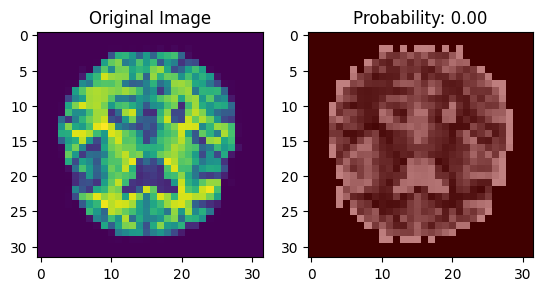

1/1 [==============================] - 0s 165ms/step


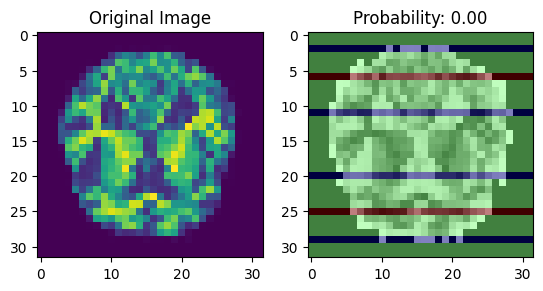

1/1 [==============================] - 0s 161ms/step


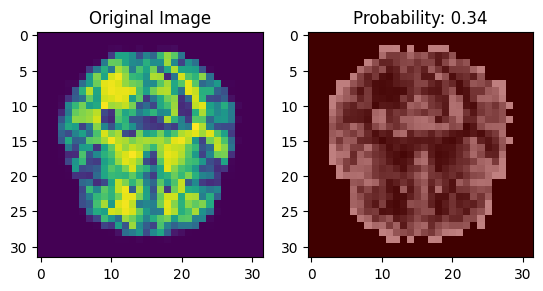

1/1 [==============================] - 0s 179ms/step


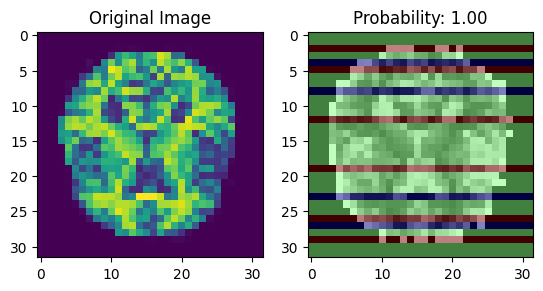

1/1 [==============================] - 0s 182ms/step


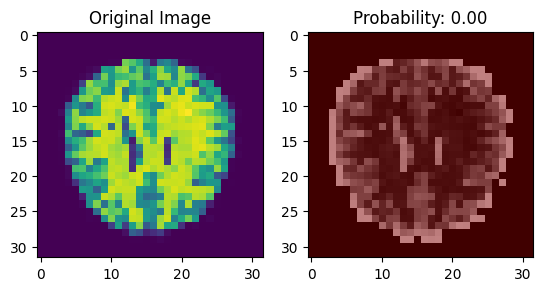

1/1 [==============================] - 0s 156ms/step


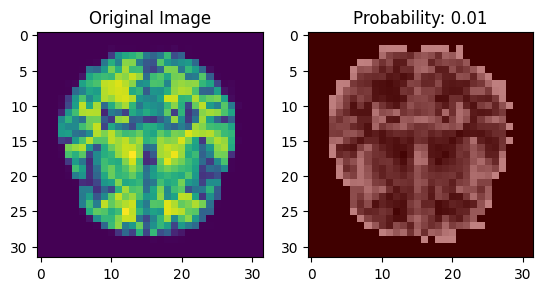

1/1 [==============================] - 0s 157ms/step


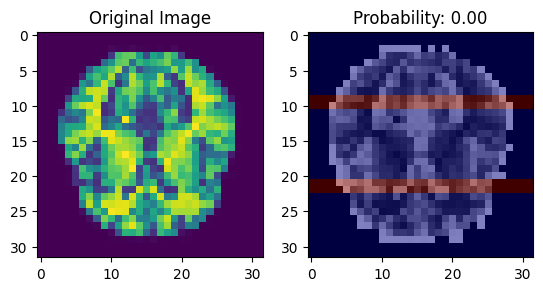

1/1 [==============================] - 0s 158ms/step


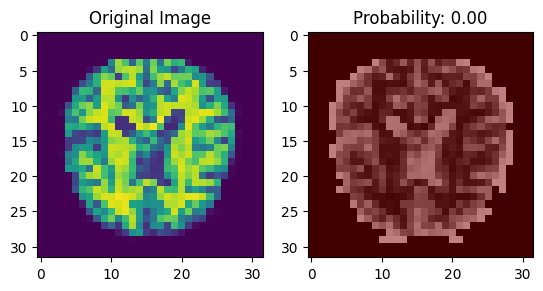

1/1 [==============================] - 0s 160ms/step


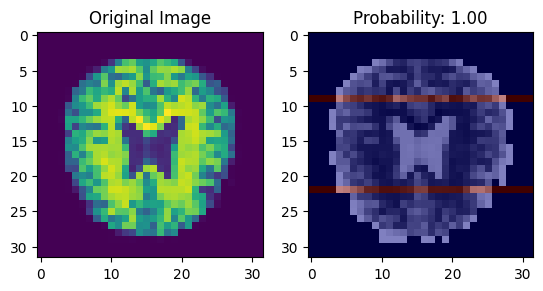

1/1 [==============================] - 0s 173ms/step


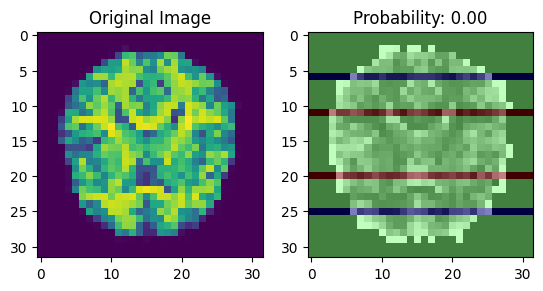

1/1 [==============================] - 0s 206ms/step


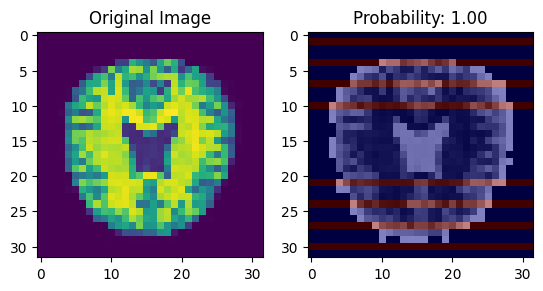

1/1 [==============================] - 0s 194ms/step


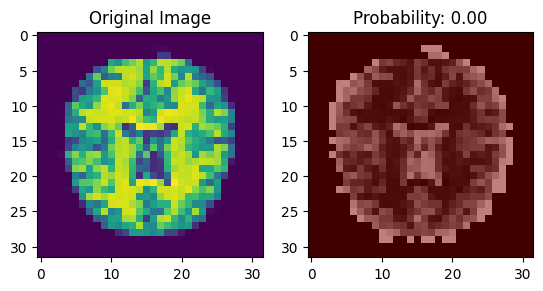

1/1 [==============================] - 0s 262ms/step


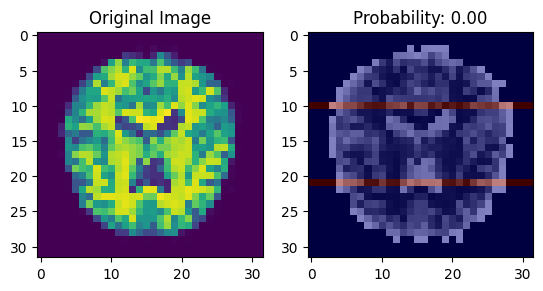

1/1 [==============================] - 0s 222ms/step


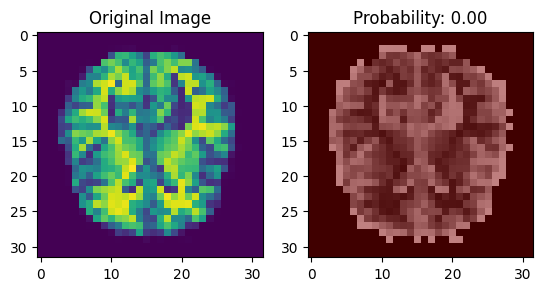

1/1 [==============================] - 0s 233ms/step


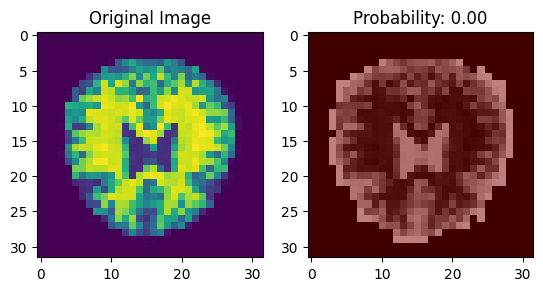

1/1 [==============================] - 0s 218ms/step


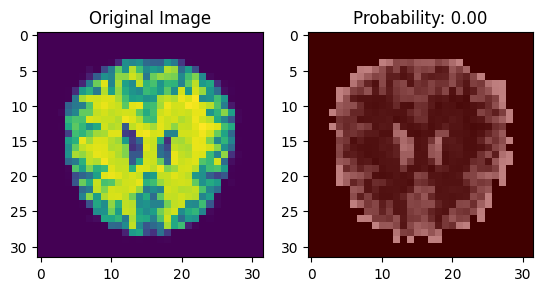

1/1 [==============================] - 0s 165ms/step


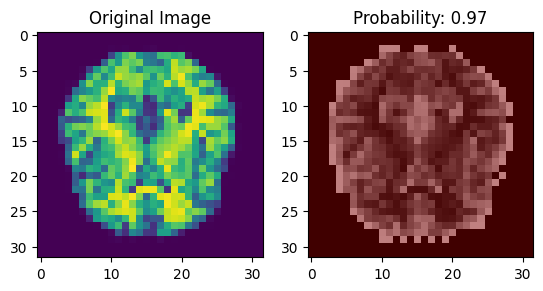

1/1 [==============================] - 0s 177ms/step


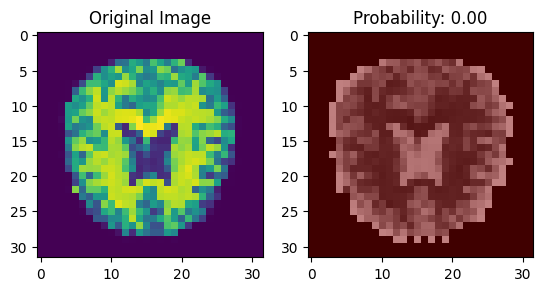

1/1 [==============================] - 0s 188ms/step


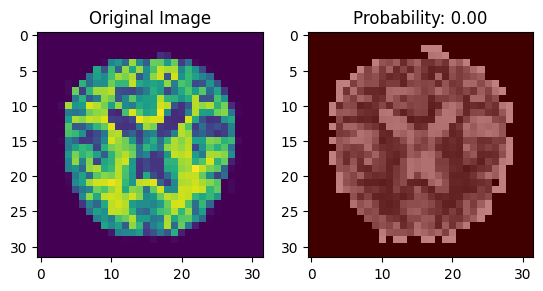

1/1 [==============================] - 0s 158ms/step


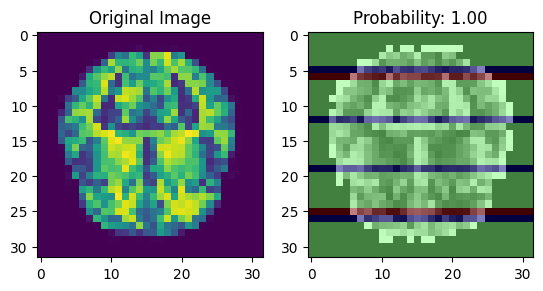

1/1 [==============================] - 0s 159ms/step


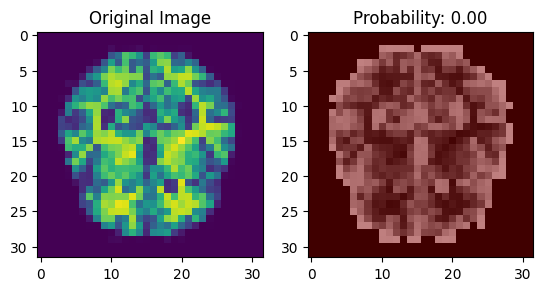

1/1 [==============================] - 0s 170ms/step


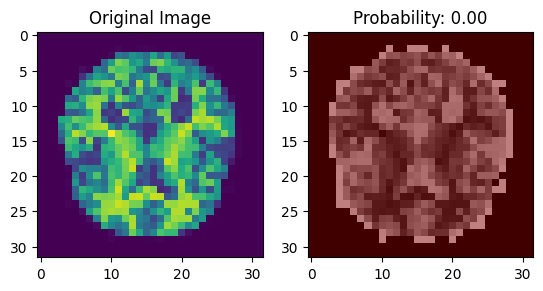

1/1 [==============================] - 0s 182ms/step


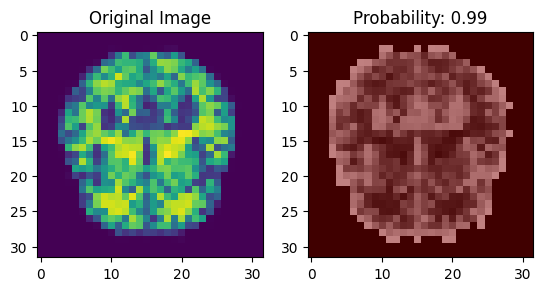

1/1 [==============================] - 0s 164ms/step


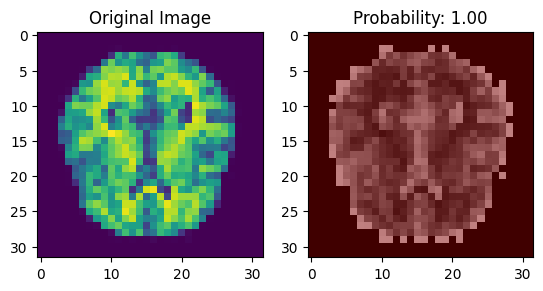

1/1 [==============================] - 0s 167ms/step


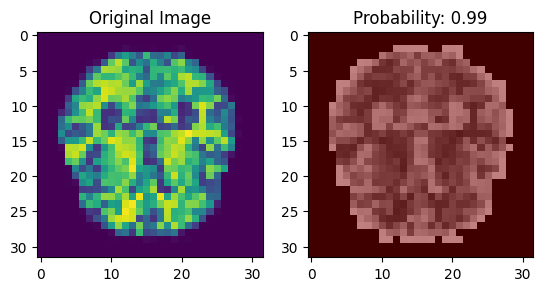

1/1 [==============================] - 0s 159ms/step


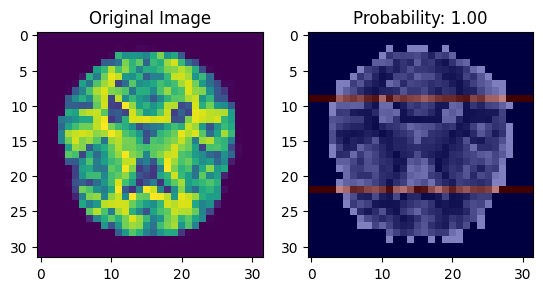

1/1 [==============================] - 0s 201ms/step


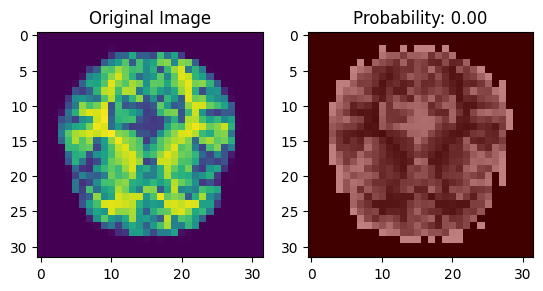

1/1 [==============================] - 0s 201ms/step


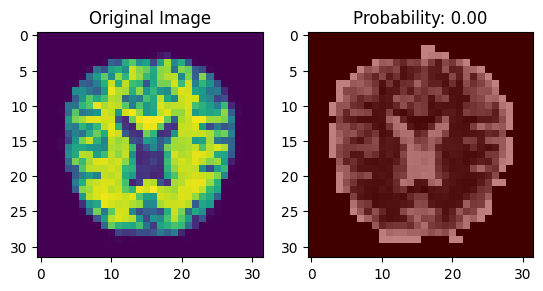

1/1 [==============================] - 0s 290ms/step


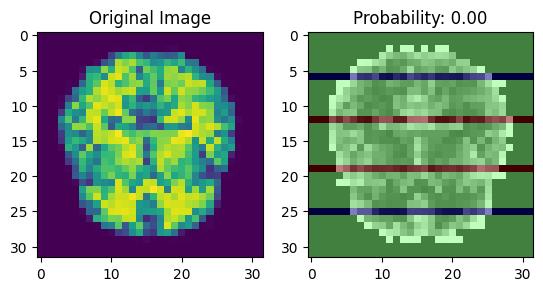

1/1 [==============================] - 0s 168ms/step


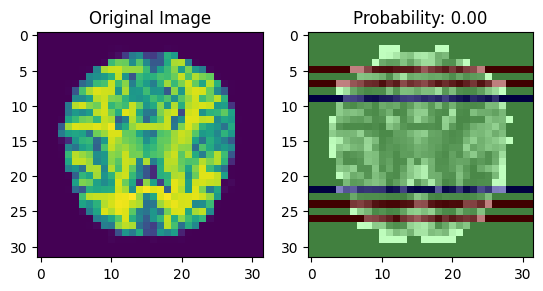

1/1 [==============================] - 0s 177ms/step


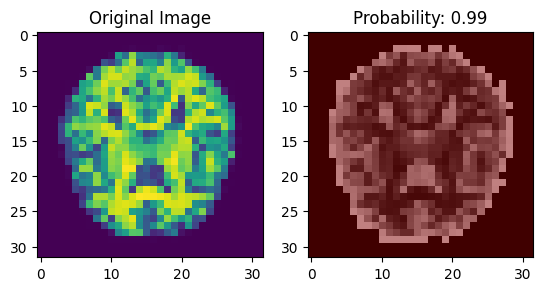

1/1 [==============================] - 0s 176ms/step


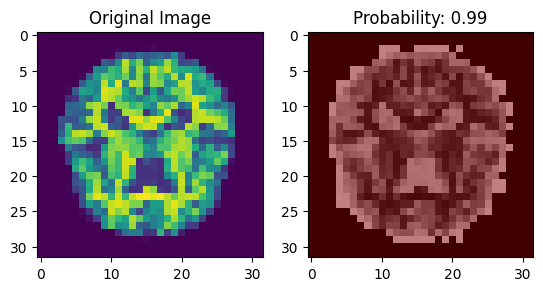

1/1 [==============================] - 0s 155ms/step


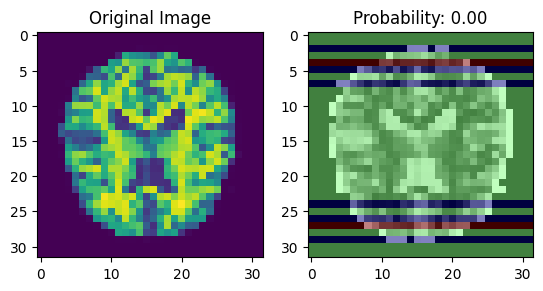

1/1 [==============================] - 1s 748ms/step


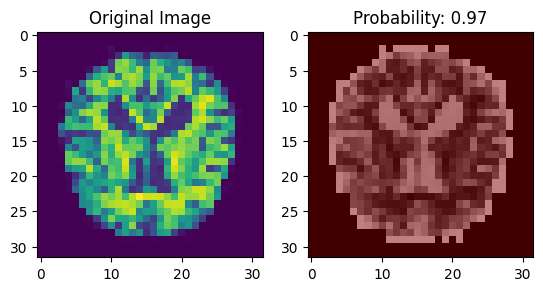

1/1 [==============================] - 0s 197ms/step


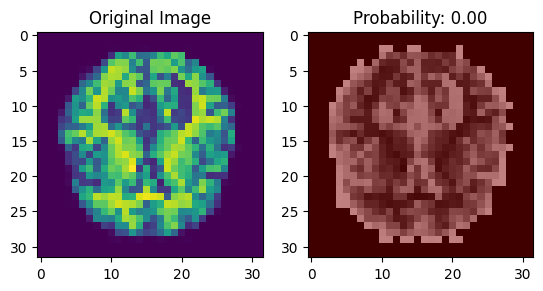

1/1 [==============================] - 0s 186ms/step


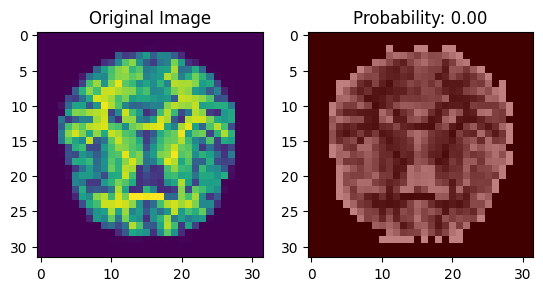

1/1 [==============================] - 0s 186ms/step


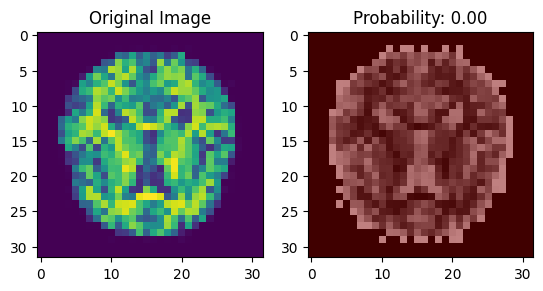

1/1 [==============================] - 0s 169ms/step


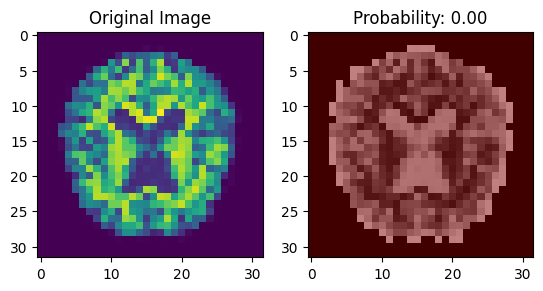

1/1 [==============================] - 0s 169ms/step


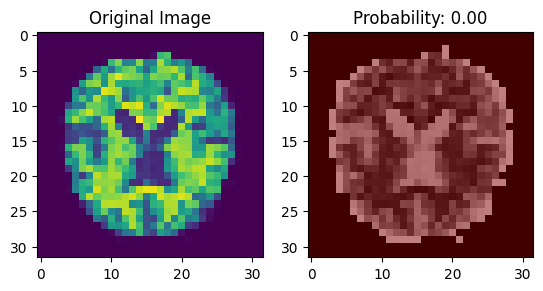

1/1 [==============================] - 0s 163ms/step


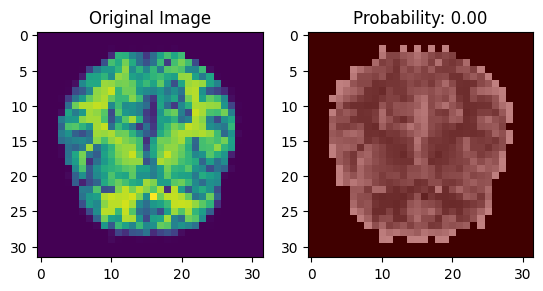

1/1 [==============================] - 0s 180ms/step


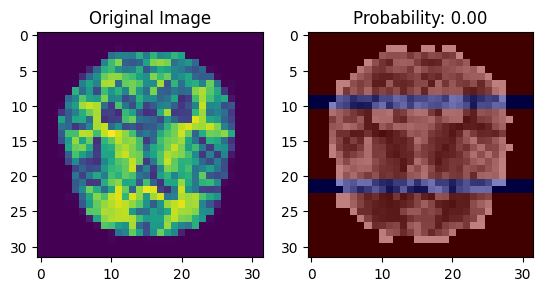

1/1 [==============================] - 0s 172ms/step


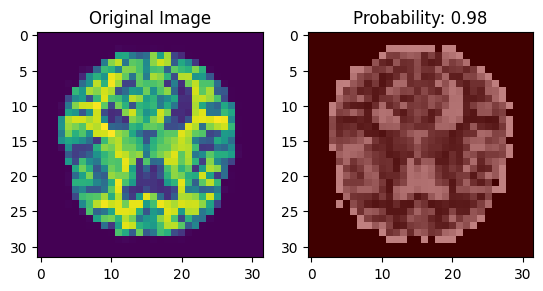

1/1 [==============================] - 0s 209ms/step


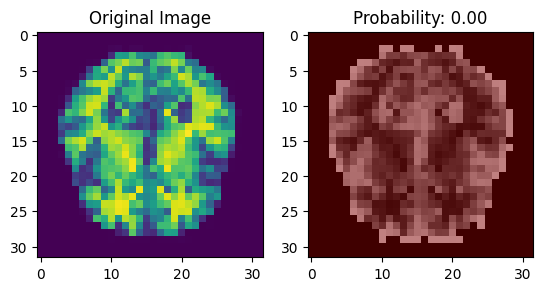

1/1 [==============================] - 0s 211ms/step


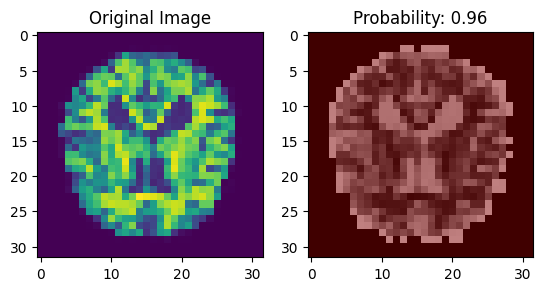

1/1 [==============================] - 0s 281ms/step


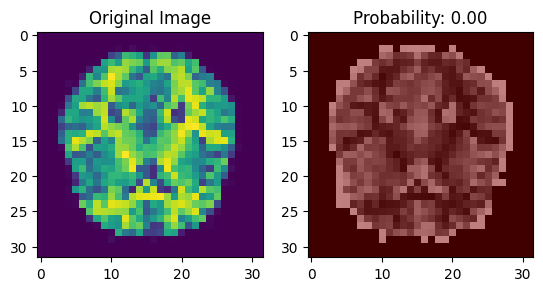

1/1 [==============================] - 0s 181ms/step


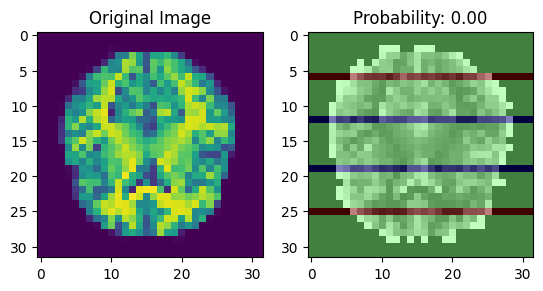

1/1 [==============================] - 0s 177ms/step


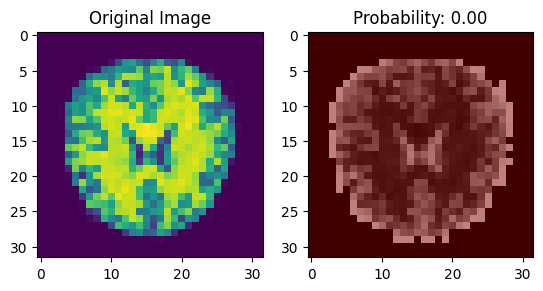

1/1 [==============================] - 0s 235ms/step


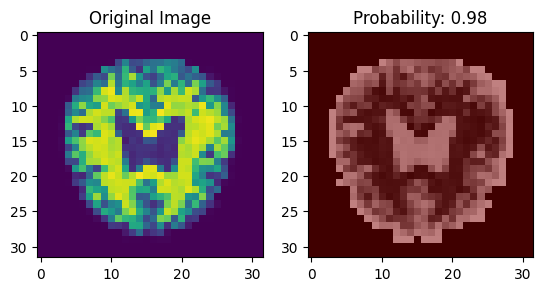

1/1 [==============================] - 0s 193ms/step


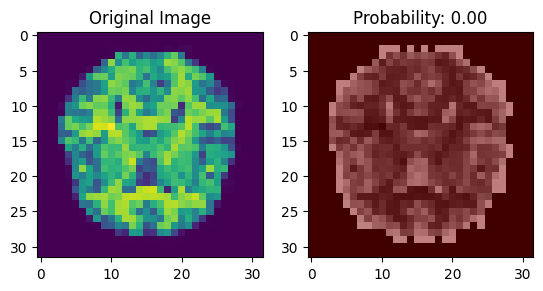

1/1 [==============================] - 0s 169ms/step


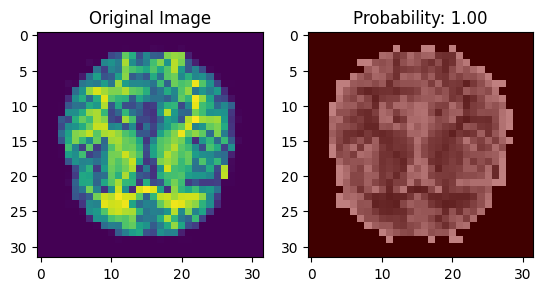

1/1 [==============================] - 0s 159ms/step


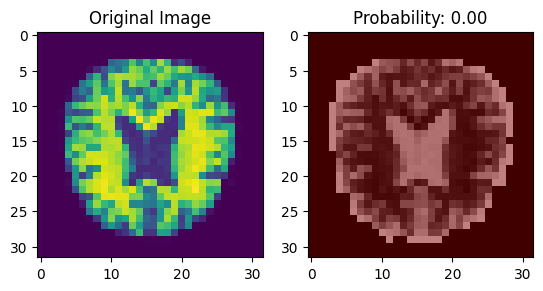

1/1 [==============================] - 0s 162ms/step


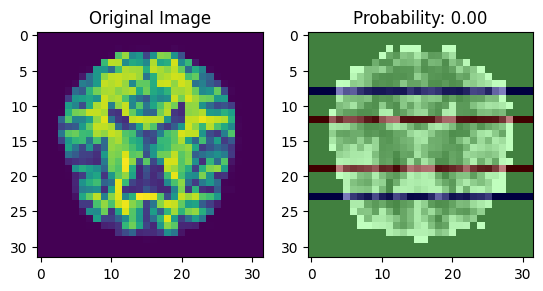

1/1 [==============================] - 0s 185ms/step


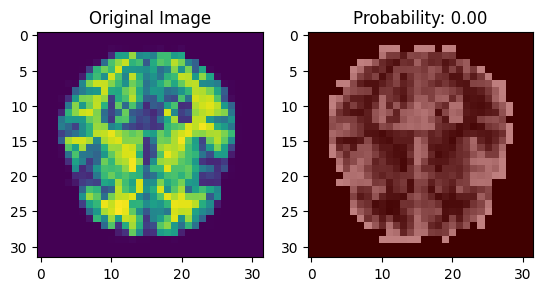

1/1 [==============================] - 0s 152ms/step


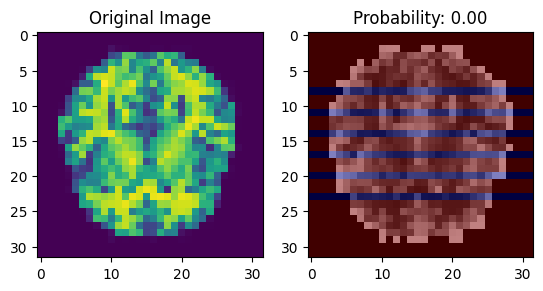

1/1 [==============================] - 0s 223ms/step


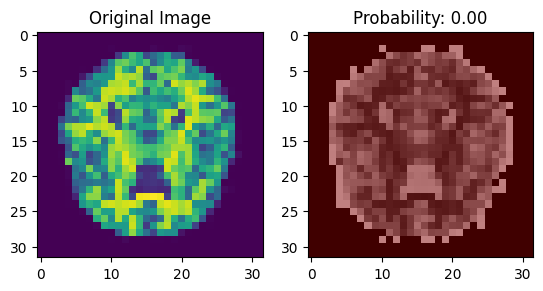

1/1 [==============================] - 0s 192ms/step


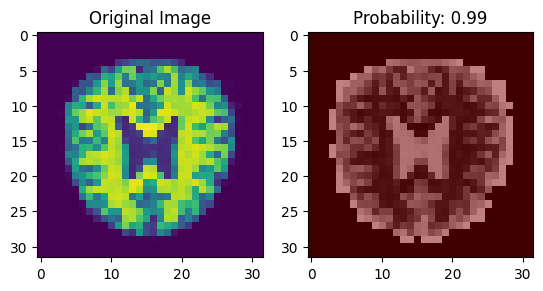

1/1 [==============================] - 0s 215ms/step


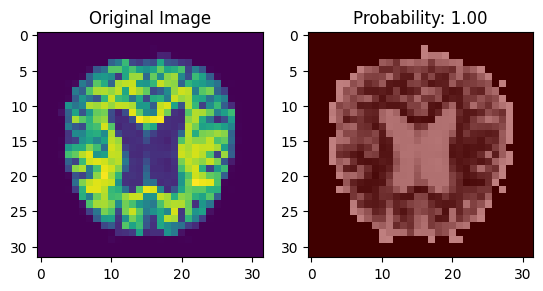

1/1 [==============================] - 0s 180ms/step


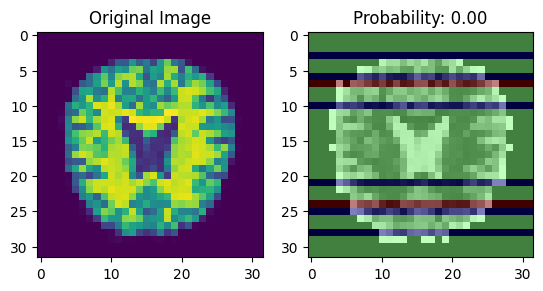

1/1 [==============================] - 0s 183ms/step


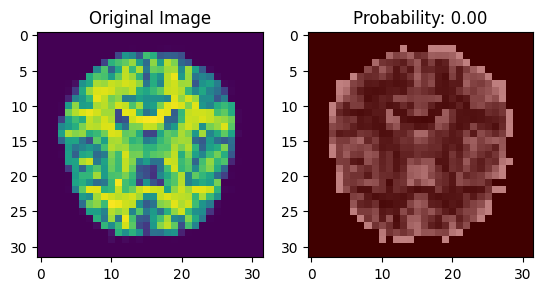

1/1 [==============================] - 0s 232ms/step


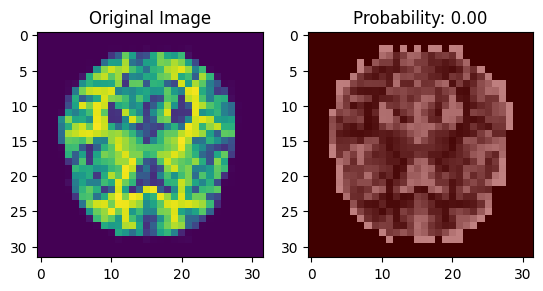

1/1 [==============================] - 0s 219ms/step


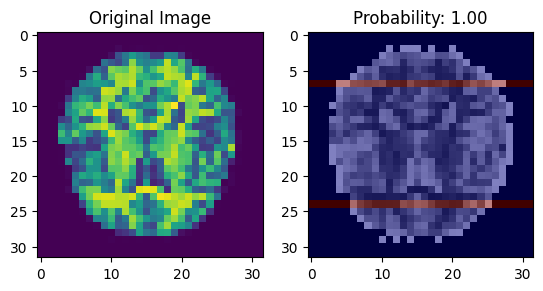

1/1 [==============================] - 0s 221ms/step


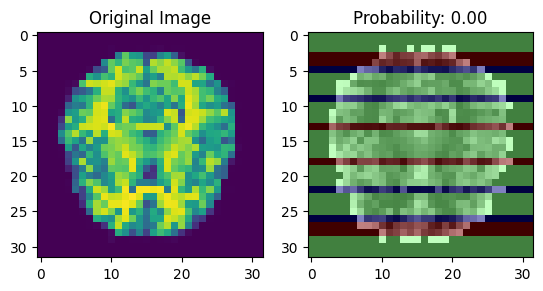

1/1 [==============================] - 0s 216ms/step


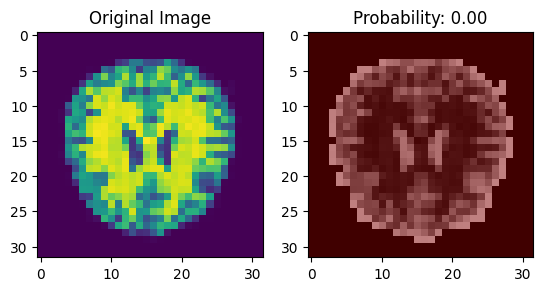

1/1 [==============================] - 0s 155ms/step


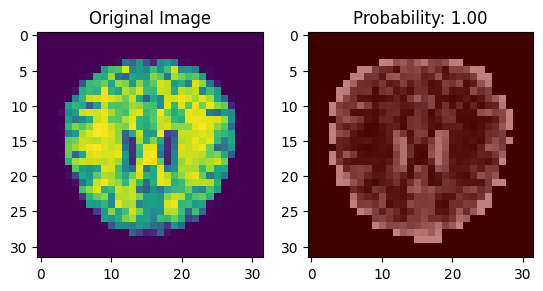

1/1 [==============================] - 0s 156ms/step


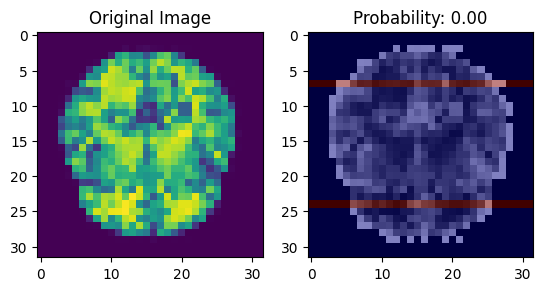

1/1 [==============================] - 0s 169ms/step


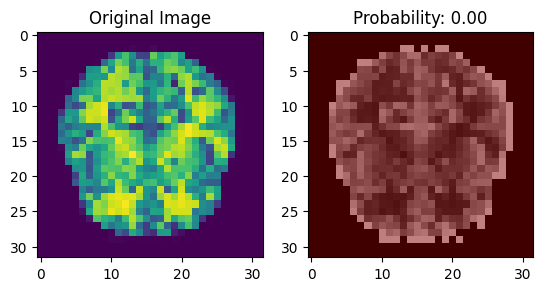

1/1 [==============================] - 0s 158ms/step


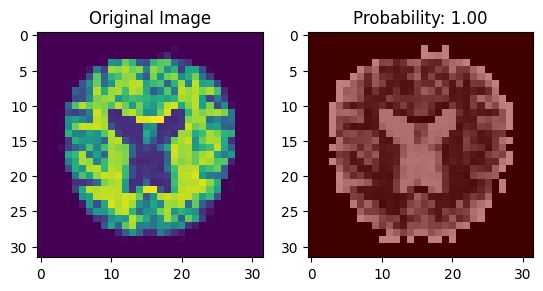

1/1 [==============================] - 0s 158ms/step


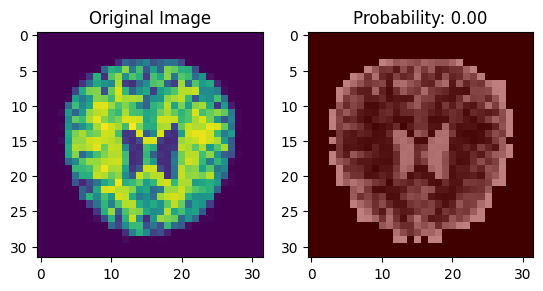

1/1 [==============================] - 0s 175ms/step


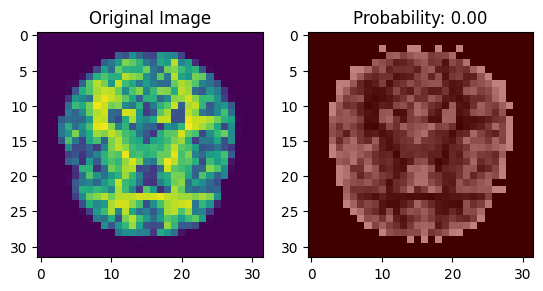

1/1 [==============================] - 0s 164ms/step


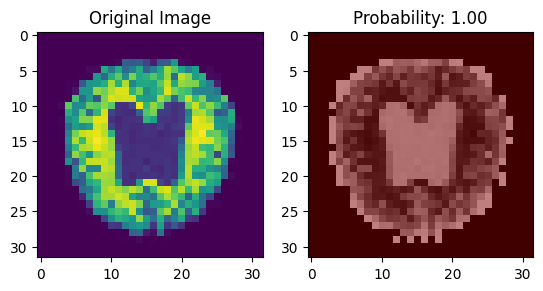

1/1 [==============================] - 0s 156ms/step


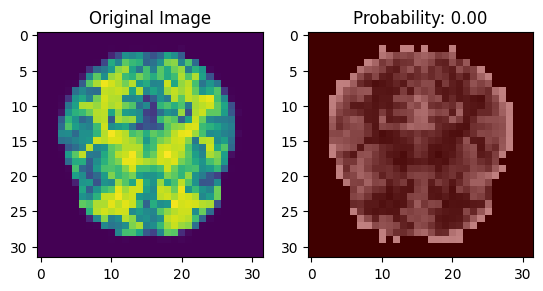

1/1 [==============================] - 0s 155ms/step


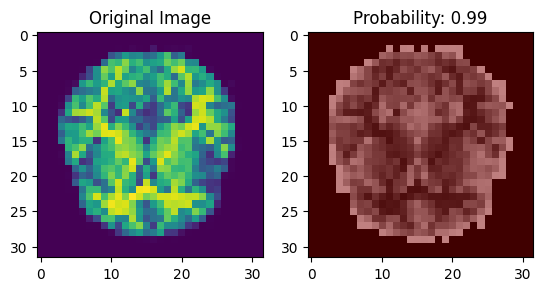

1/1 [==============================] - 0s 170ms/step


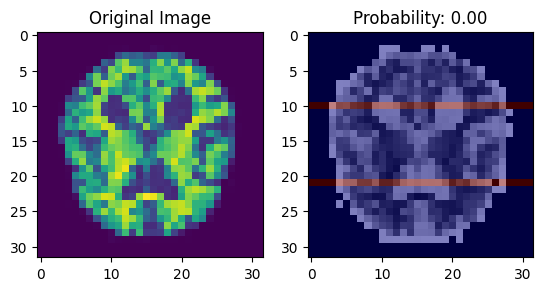

1/1 [==============================] - 0s 183ms/step


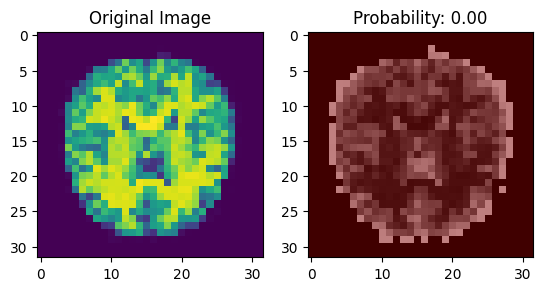

1/1 [==============================] - 0s 232ms/step


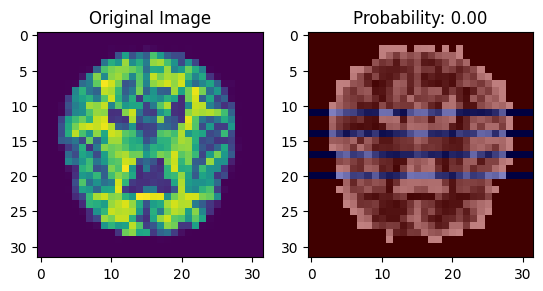

1/1 [==============================] - 0s 187ms/step


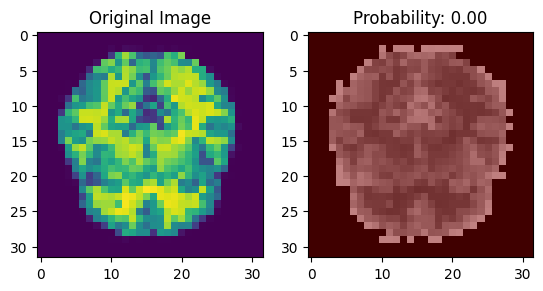

1/1 [==============================] - 0s 187ms/step


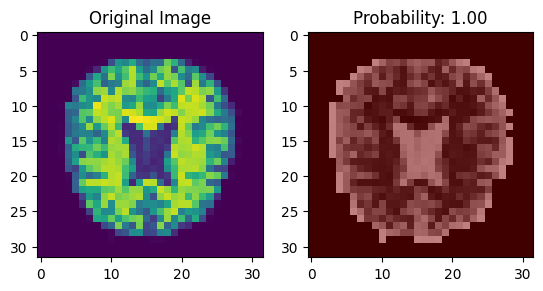

1/1 [==============================] - 0s 191ms/step


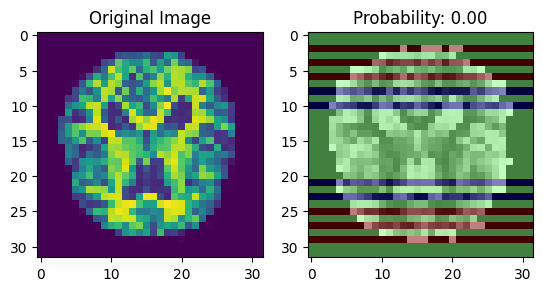

1/1 [==============================] - 0s 202ms/step


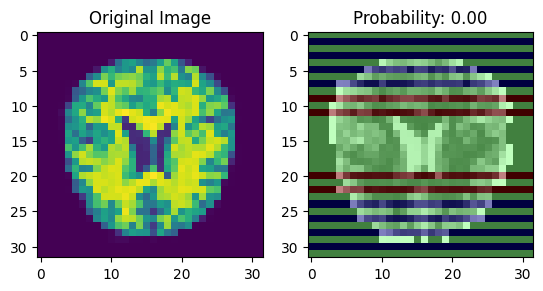

1/1 [==============================] - 0s 190ms/step


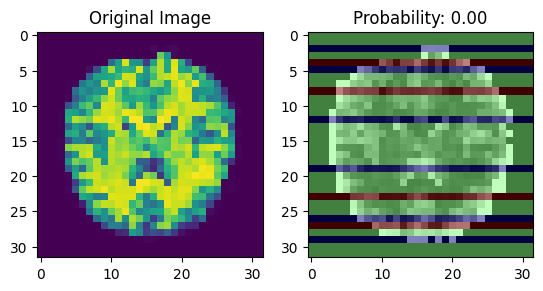

1/1 [==============================] - 0s 176ms/step


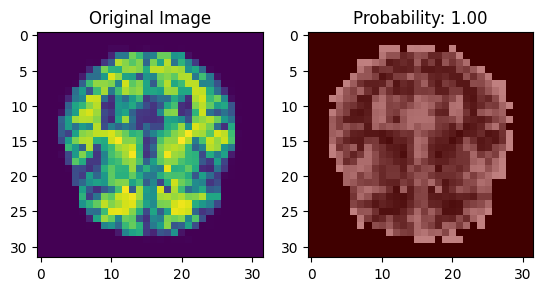

1/1 [==============================] - 0s 167ms/step


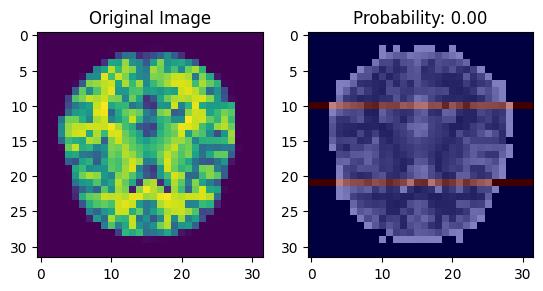

1/1 [==============================] - 0s 179ms/step


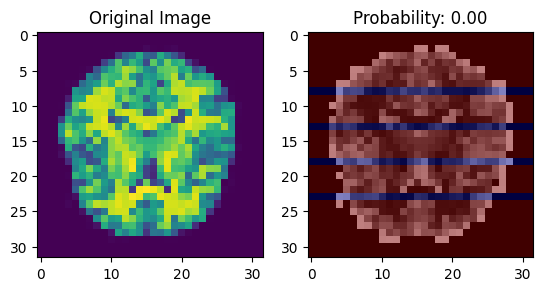

1/1 [==============================] - 0s 161ms/step


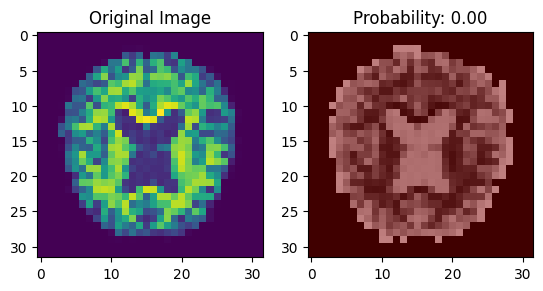

1/1 [==============================] - 0s 161ms/step


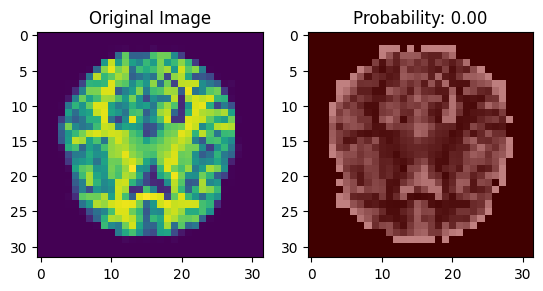

1/1 [==============================] - 0s 153ms/step


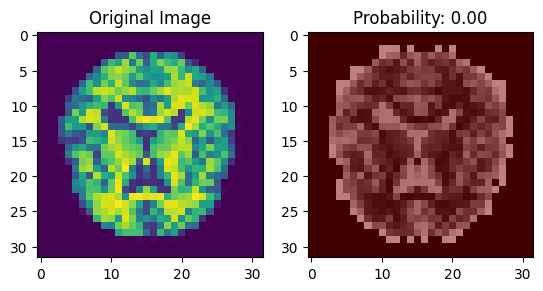

1/1 [==============================] - 0s 152ms/step


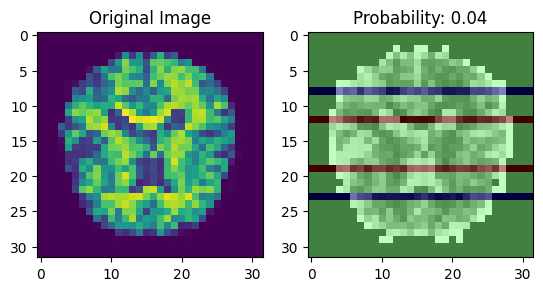

1/1 [==============================] - 0s 160ms/step


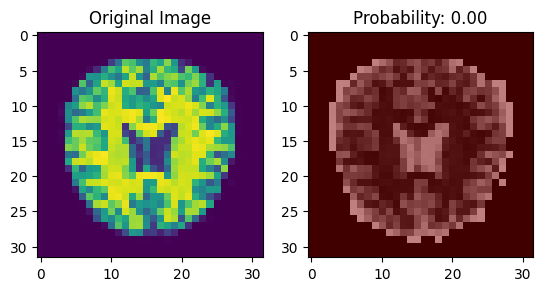

1/1 [==============================] - 0s 173ms/step


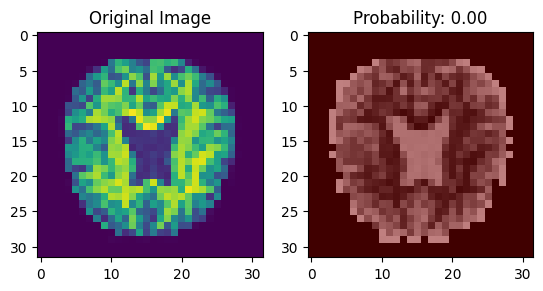

1/1 [==============================] - 0s 161ms/step


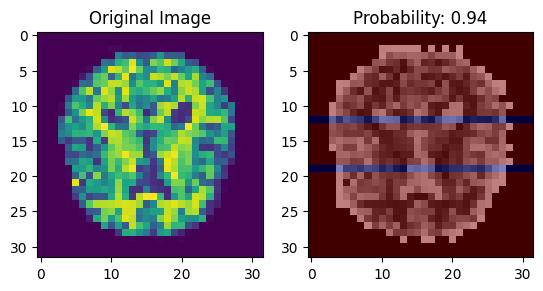

1/1 [==============================] - 0s 170ms/step


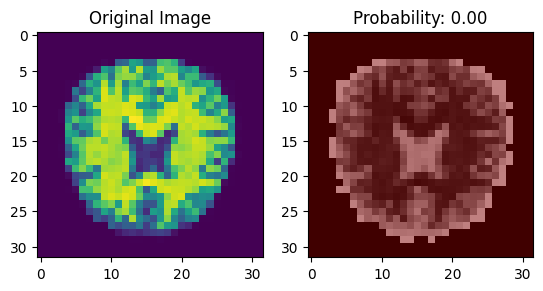

1/1 [==============================] - 0s 180ms/step


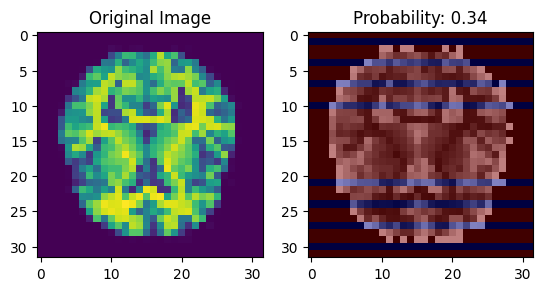

1/1 [==============================] - 0s 185ms/step


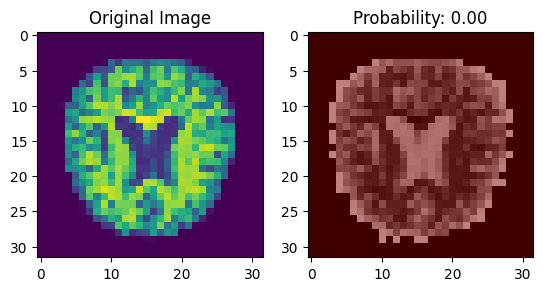

1/1 [==============================] - 0s 255ms/step


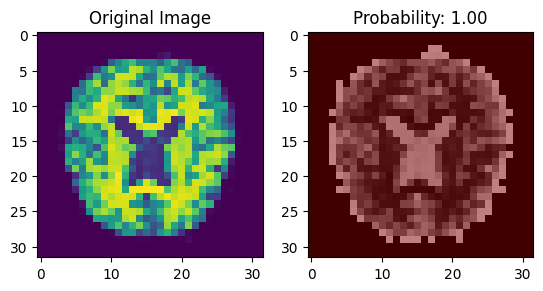

1/1 [==============================] - 0s 286ms/step


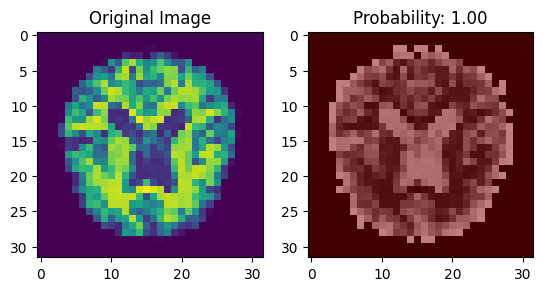

1/1 [==============================] - 0s 238ms/step


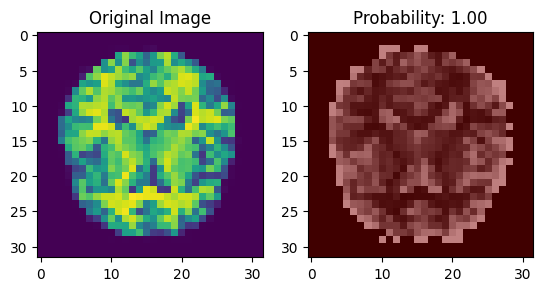

1/1 [==============================] - 0s 195ms/step


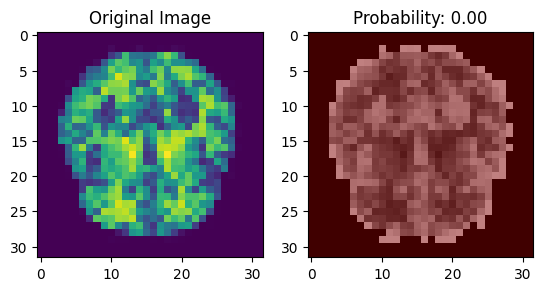

1/1 [==============================] - 0s 191ms/step


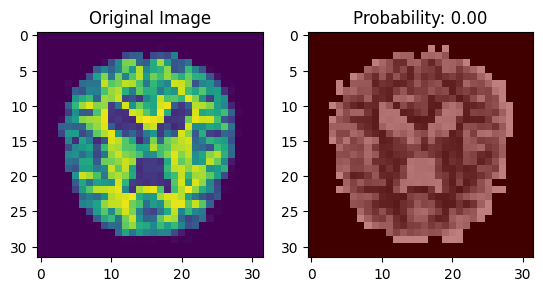

1/1 [==============================] - 0s 166ms/step


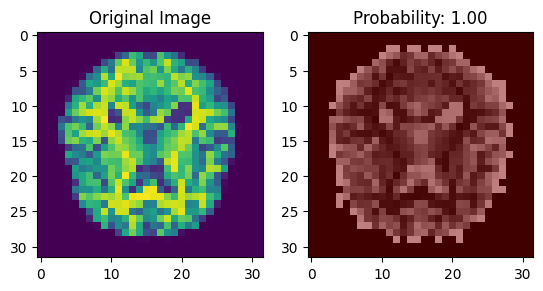

1/1 [==============================] - 0s 176ms/step


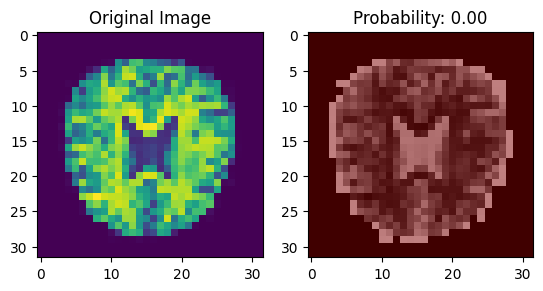

1/1 [==============================] - 0s 234ms/step


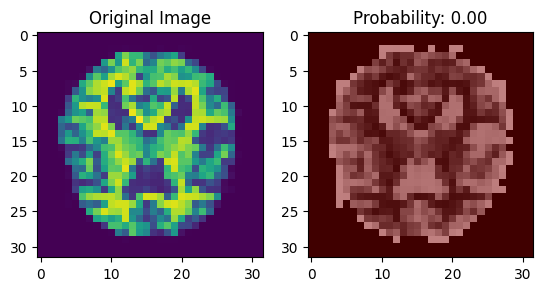

1/1 [==============================] - 0s 156ms/step


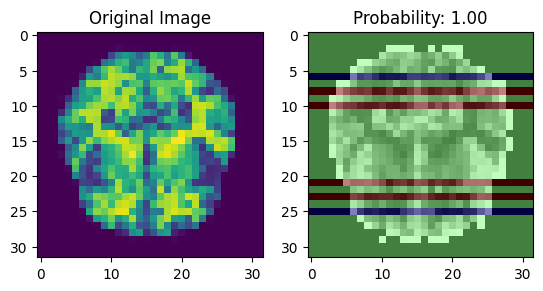

1/1 [==============================] - 0s 158ms/step


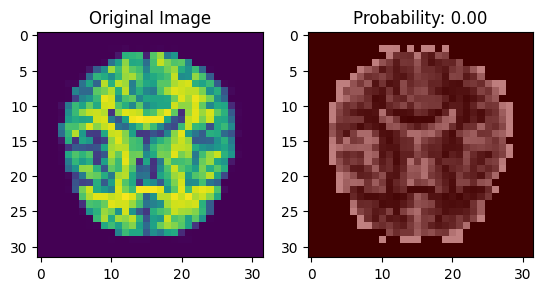

1/1 [==============================] - 0s 185ms/step


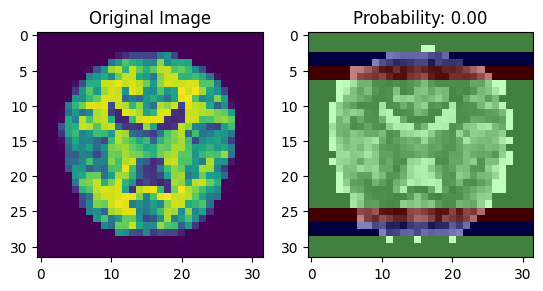

1/1 [==============================] - 0s 167ms/step


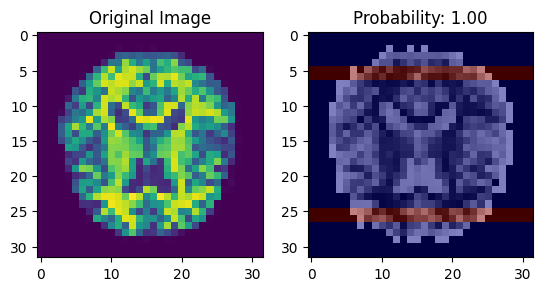

1/1 [==============================] - 0s 161ms/step


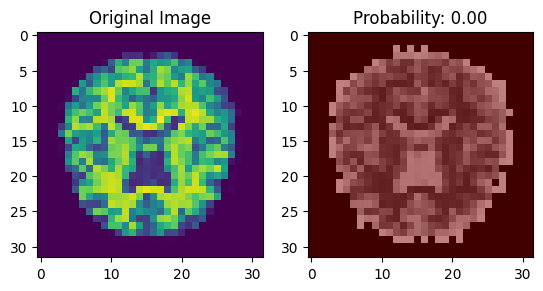

1/1 [==============================] - 0s 172ms/step


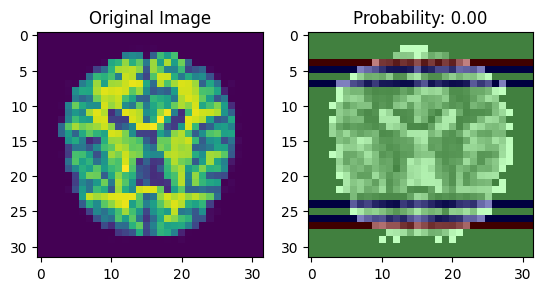

1/1 [==============================] - 0s 173ms/step


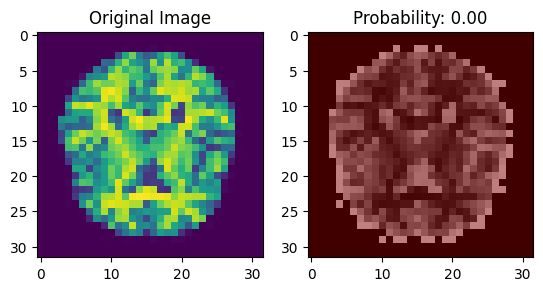

1/1 [==============================] - 0s 217ms/step


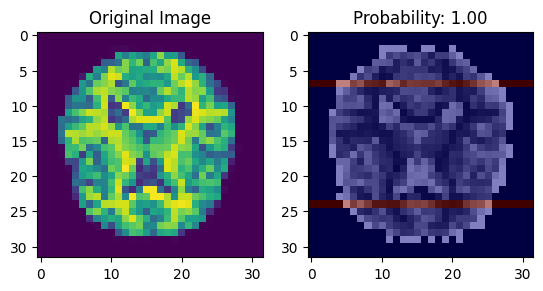

1/1 [==============================] - 0s 199ms/step


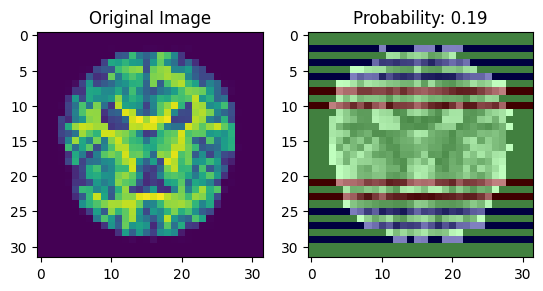

1/1 [==============================] - 0s 213ms/step


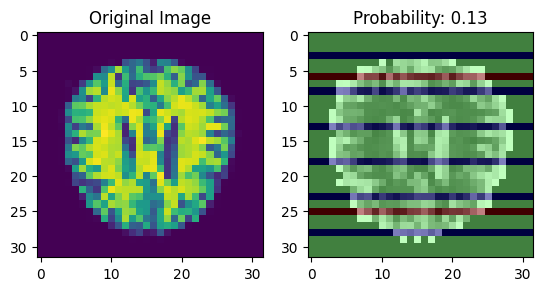

1/1 [==============================] - 0s 201ms/step


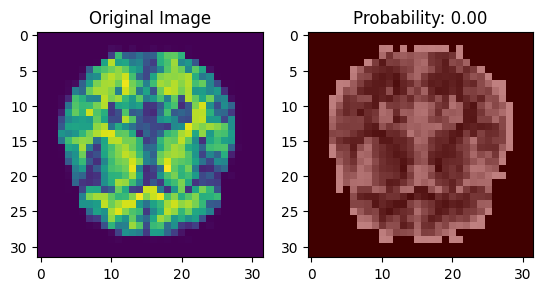

1/1 [==============================] - 0s 175ms/step


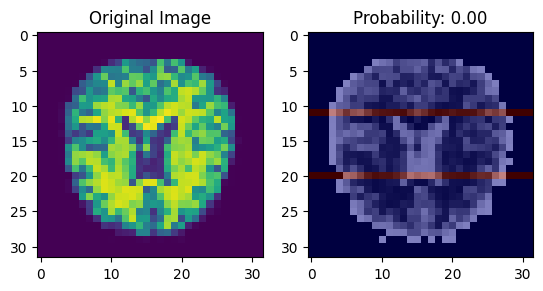

1/1 [==============================] - 0s 156ms/step


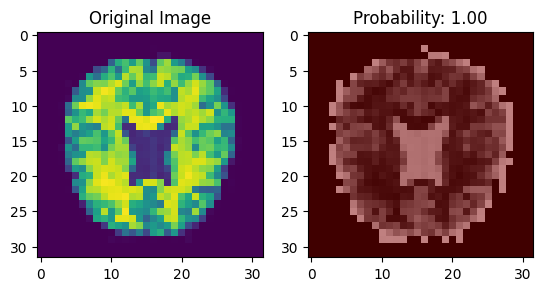

1/1 [==============================] - 0s 211ms/step


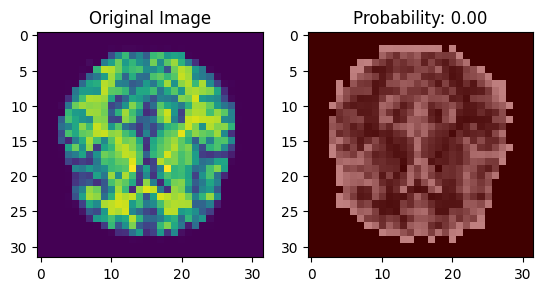

1/1 [==============================] - 0s 214ms/step


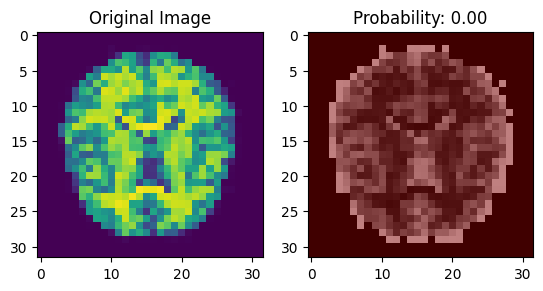

1/1 [==============================] - 0s 169ms/step


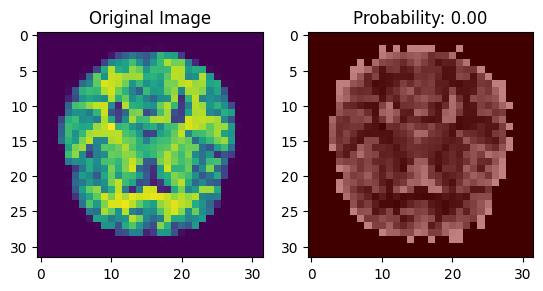

1/1 [==============================] - 0s 174ms/step


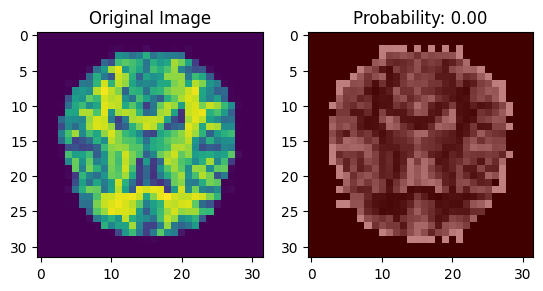

1/1 [==============================] - 0s 196ms/step


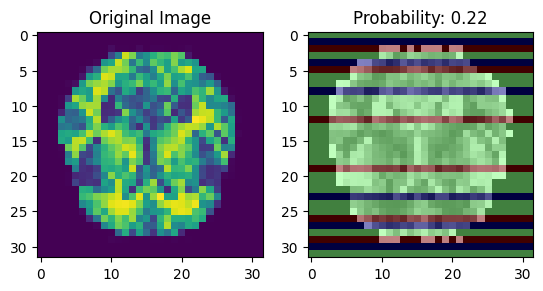

1/1 [==============================] - 0s 186ms/step


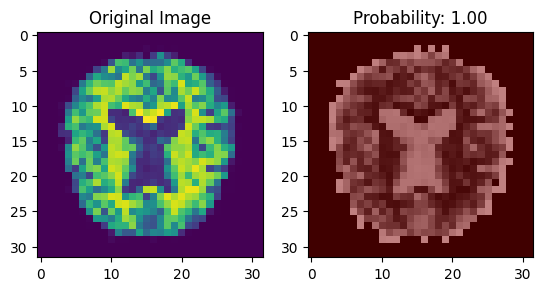

1/1 [==============================] - 0s 160ms/step


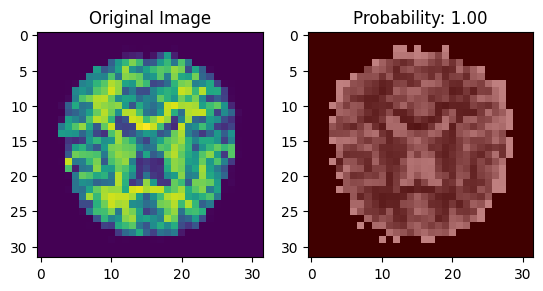

1/1 [==============================] - 0s 168ms/step


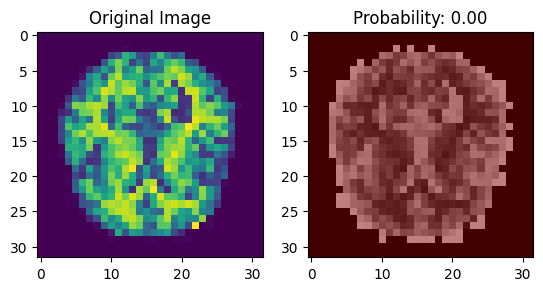

1/1 [==============================] - 0s 160ms/step


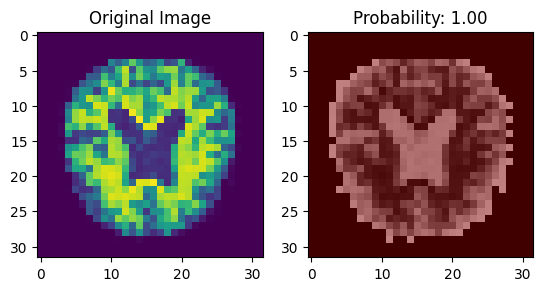

1/1 [==============================] - 0s 202ms/step


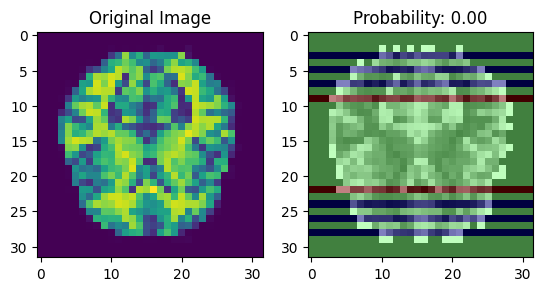

1/1 [==============================] - 0s 159ms/step


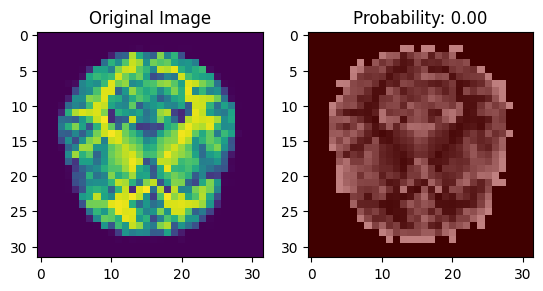

1/1 [==============================] - 0s 221ms/step


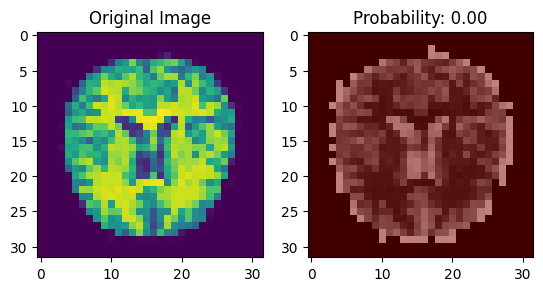

1/1 [==============================] - 0s 162ms/step


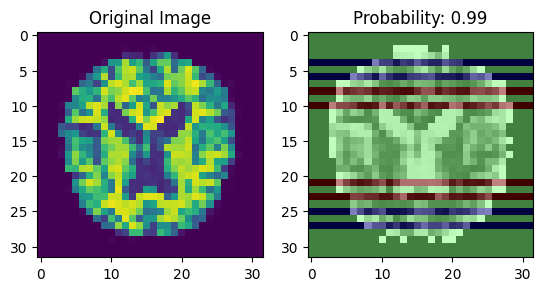

1/1 [==============================] - 0s 156ms/step


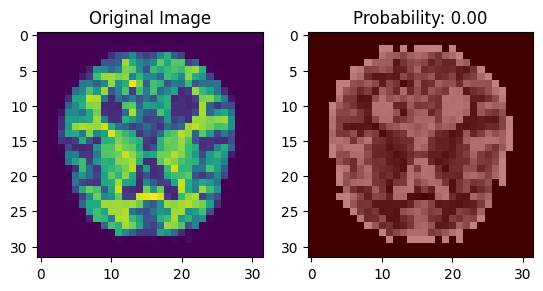

1/1 [==============================] - 0s 219ms/step


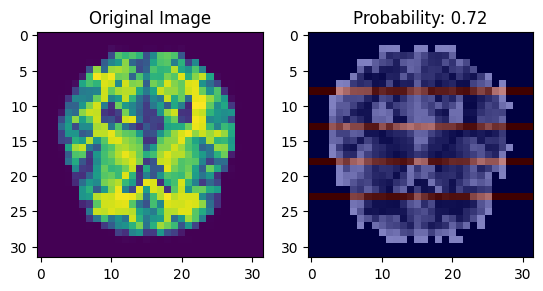

1/1 [==============================] - 0s 151ms/step


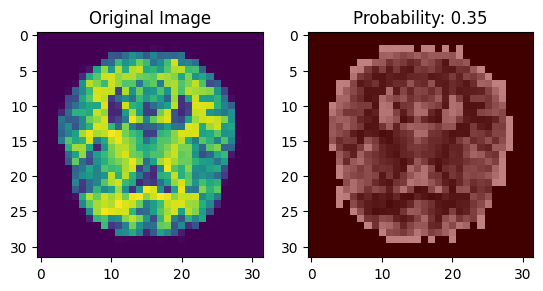

1/1 [==============================] - 0s 153ms/step


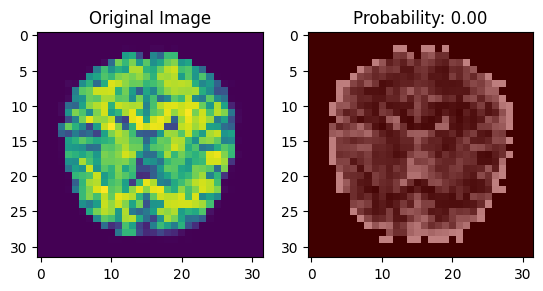

1/1 [==============================] - 0s 160ms/step


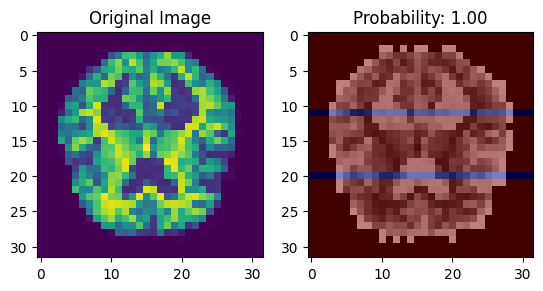

1/1 [==============================] - 0s 176ms/step


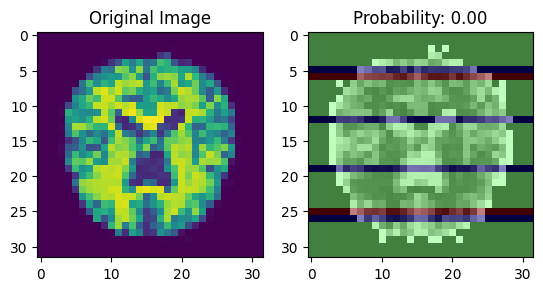

1/1 [==============================] - 0s 173ms/step


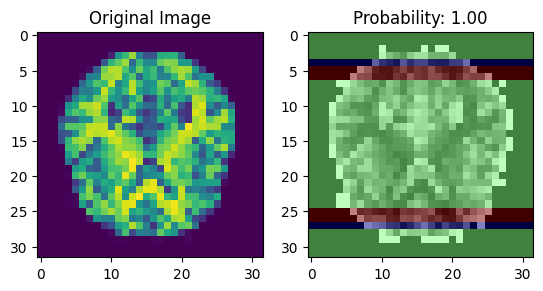

1/1 [==============================] - 0s 200ms/step


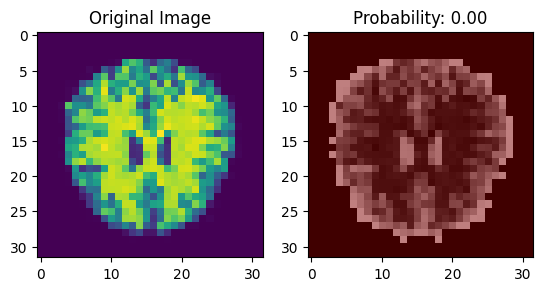

1/1 [==============================] - 0s 198ms/step


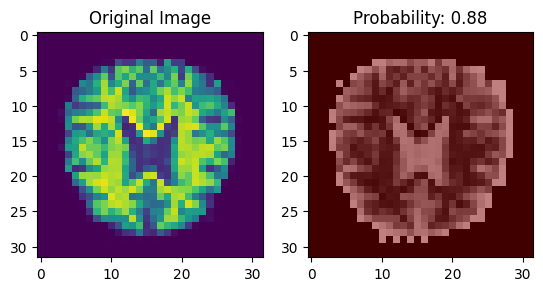

1/1 [==============================] - 0s 217ms/step


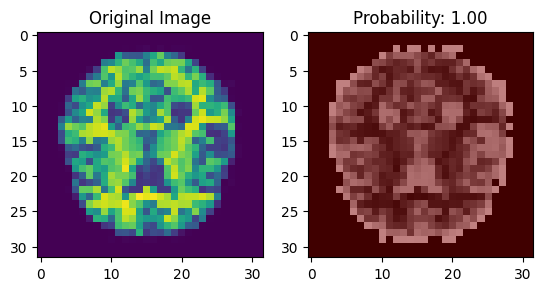

1/1 [==============================] - 0s 173ms/step


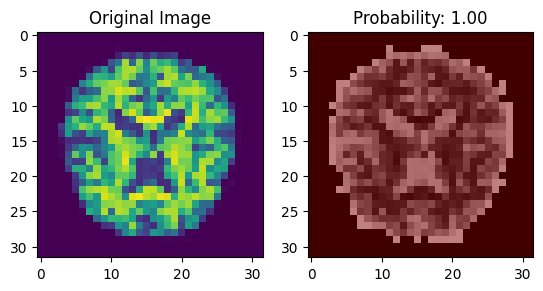

1/1 [==============================] - 0s 174ms/step


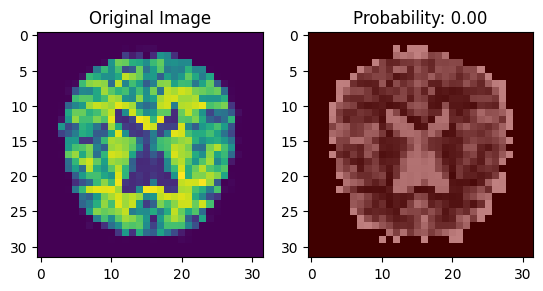

1/1 [==============================] - 0s 171ms/step


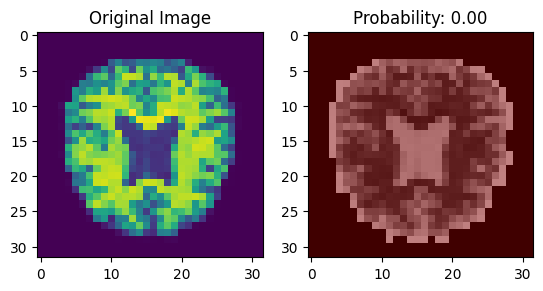

1/1 [==============================] - 0s 228ms/step


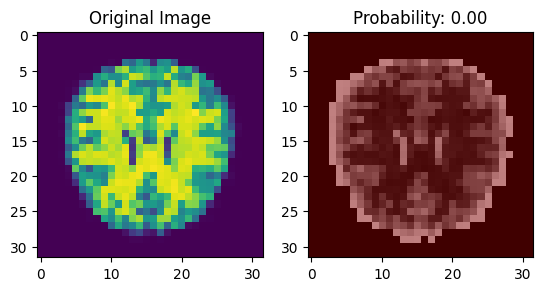

1/1 [==============================] - 0s 229ms/step


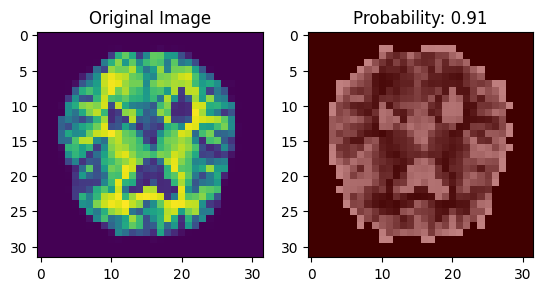

1/1 [==============================] - 0s 169ms/step


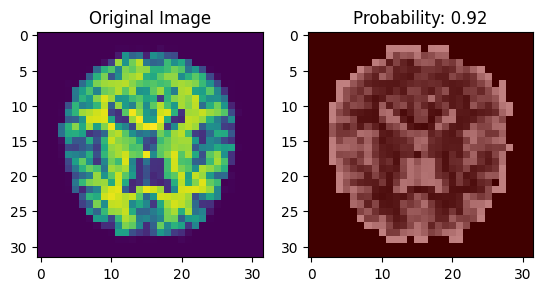

1/1 [==============================] - 0s 167ms/step


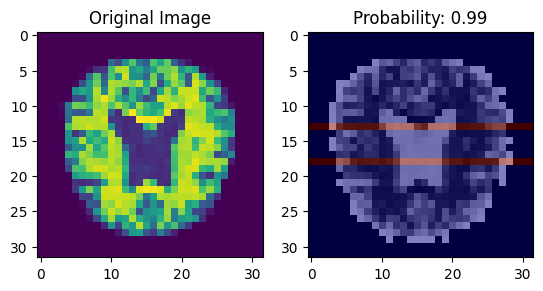

1/1 [==============================] - 0s 188ms/step


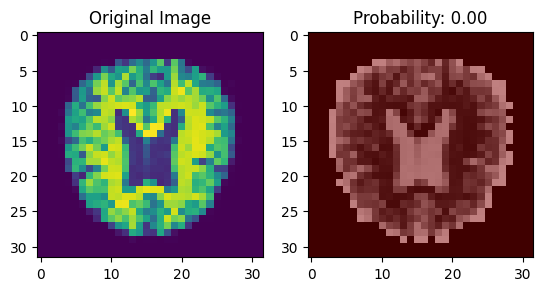

1/1 [==============================] - 0s 159ms/step


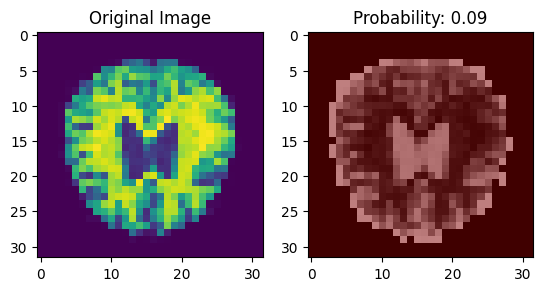

1/1 [==============================] - 0s 166ms/step


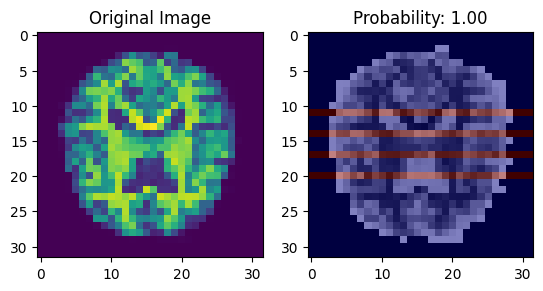

1/1 [==============================] - 0s 161ms/step


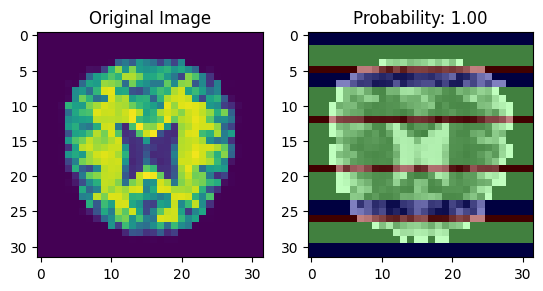

1/1 [==============================] - 0s 162ms/step


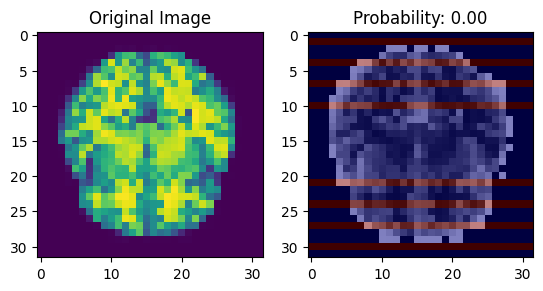

1/1 [==============================] - 0s 152ms/step


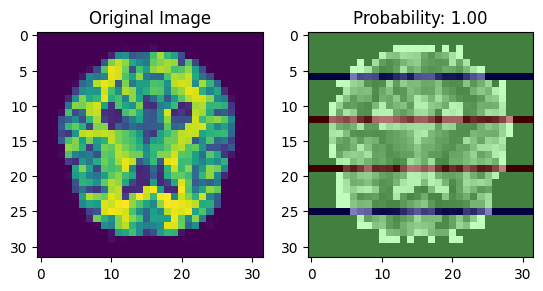

1/1 [==============================] - 0s 161ms/step


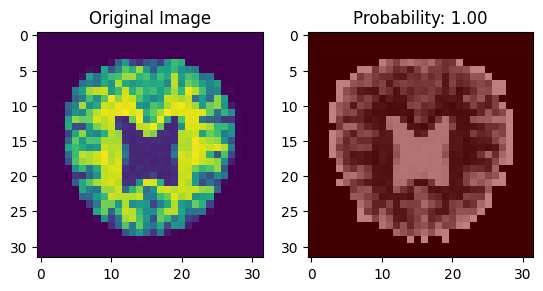

1/1 [==============================] - 0s 153ms/step


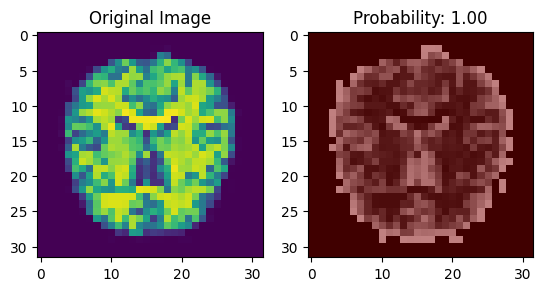

1/1 [==============================] - 0s 188ms/step


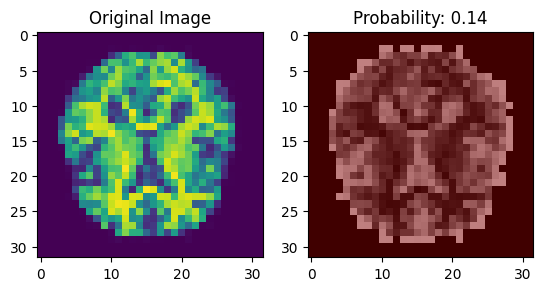

1/1 [==============================] - 0s 154ms/step


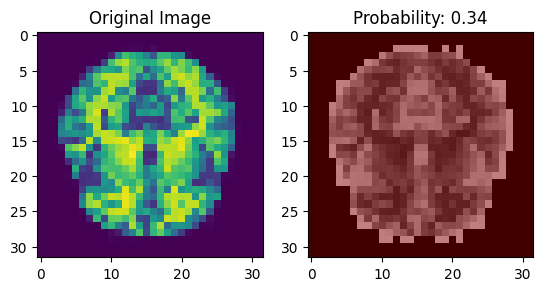

1/1 [==============================] - 0s 197ms/step


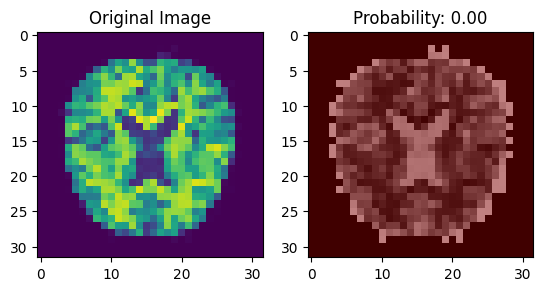

1/1 [==============================] - 0s 191ms/step


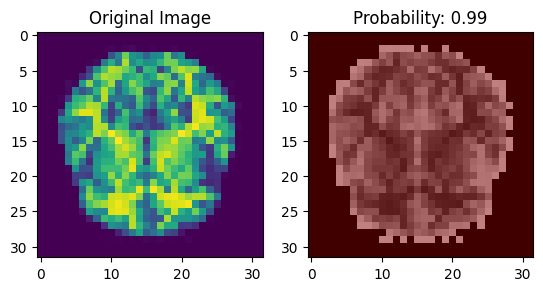

1/1 [==============================] - 0s 238ms/step


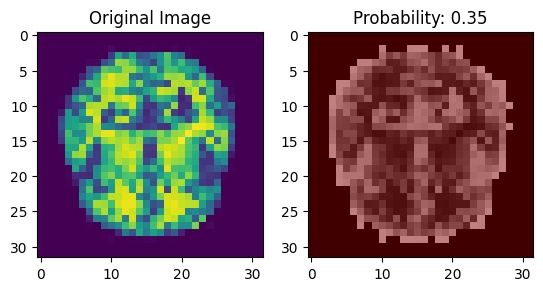

1/1 [==============================] - 0s 187ms/step


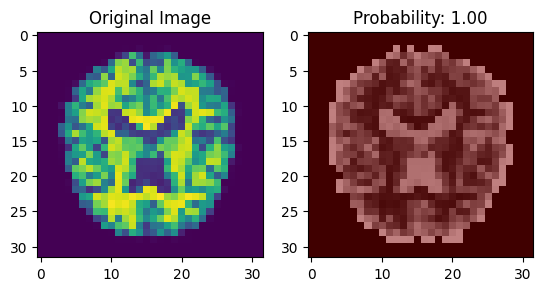

1/1 [==============================] - 0s 166ms/step


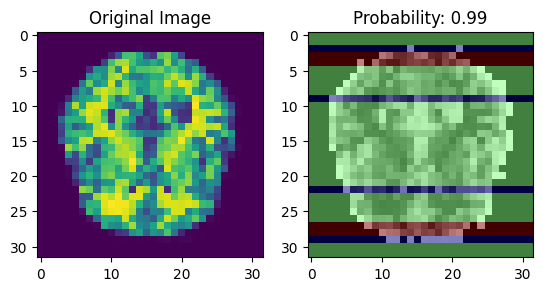

1/1 [==============================] - 0s 185ms/step


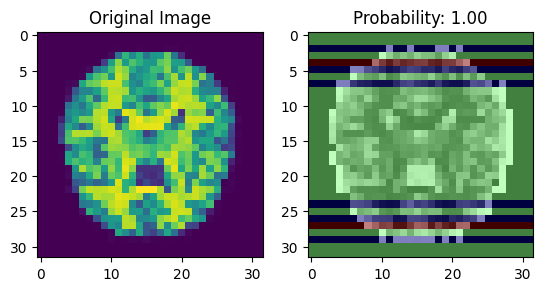

1/1 [==============================] - 0s 255ms/step


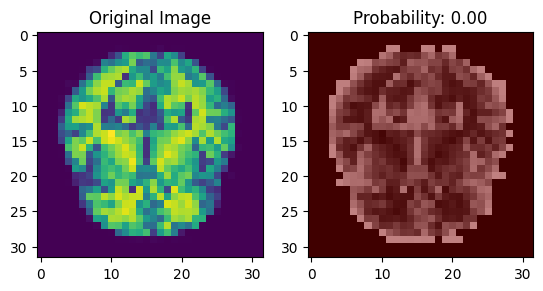

1/1 [==============================] - 0s 158ms/step


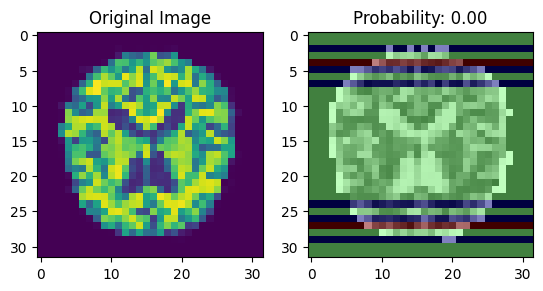

1/1 [==============================] - 0s 180ms/step


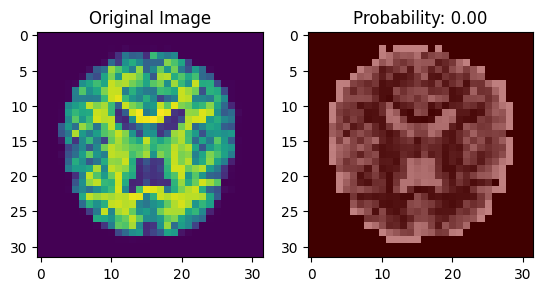

1/1 [==============================] - 0s 165ms/step


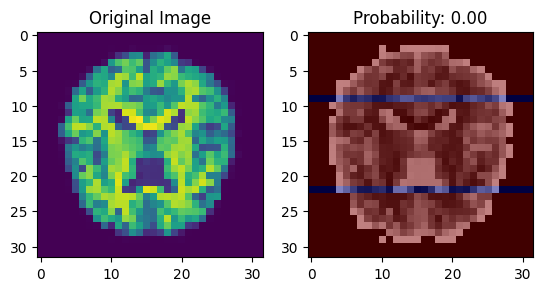

1/1 [==============================] - 0s 167ms/step


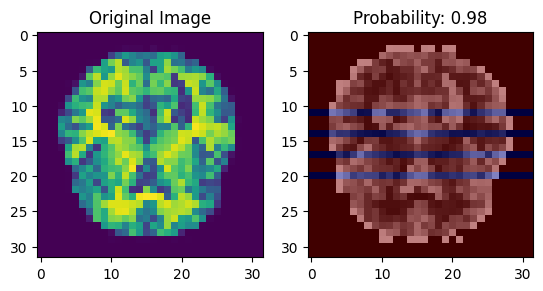

1/1 [==============================] - 0s 168ms/step


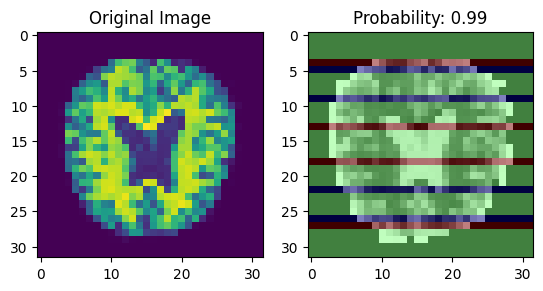

1/1 [==============================] - 0s 157ms/step


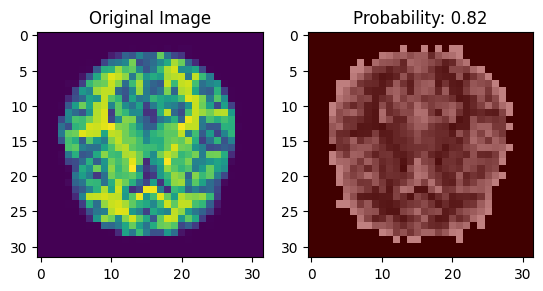

1/1 [==============================] - 0s 169ms/step


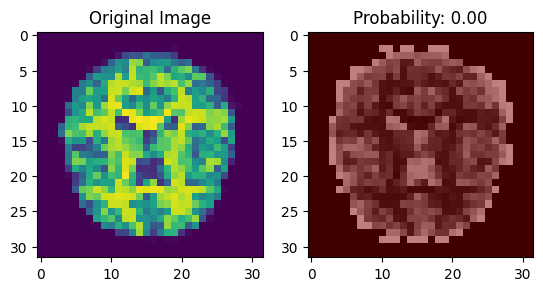

1/1 [==============================] - 0s 188ms/step


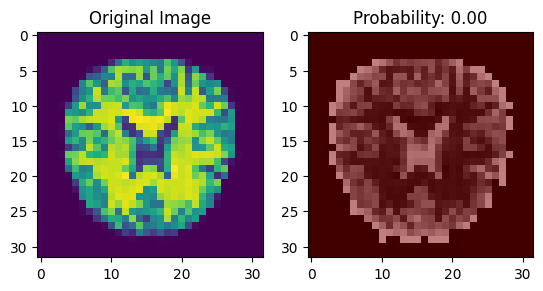

1/1 [==============================] - 0s 159ms/step


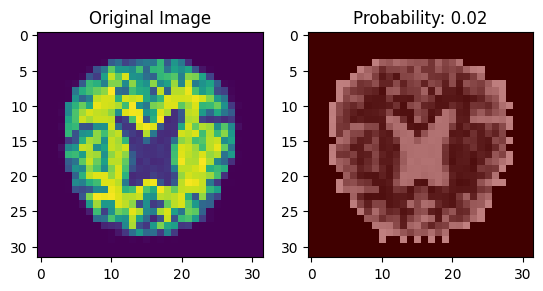

1/1 [==============================] - 0s 160ms/step


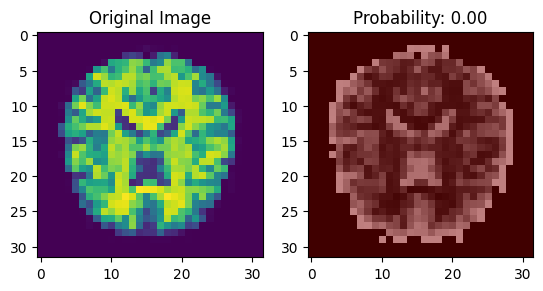

1/1 [==============================] - 0s 159ms/step


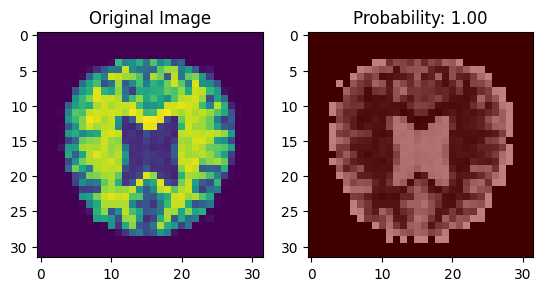

1/1 [==============================] - 0s 158ms/step


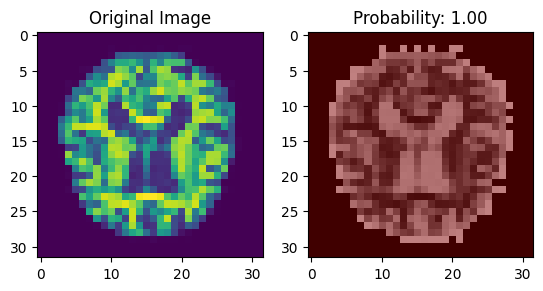

1/1 [==============================] - 0s 237ms/step


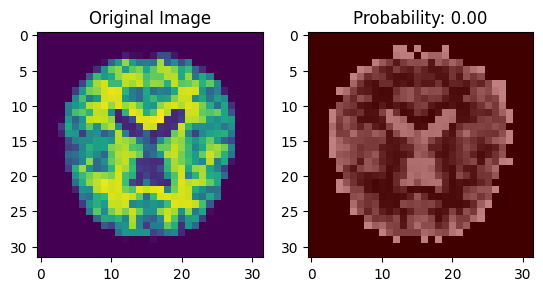

1/1 [==============================] - 0s 246ms/step


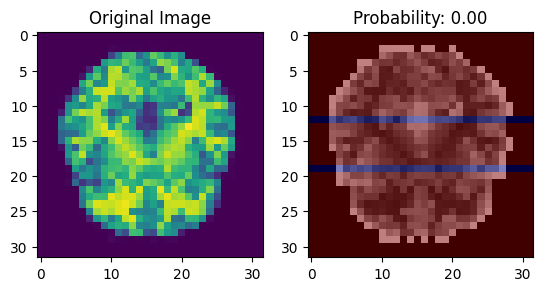

1/1 [==============================] - 0s 247ms/step


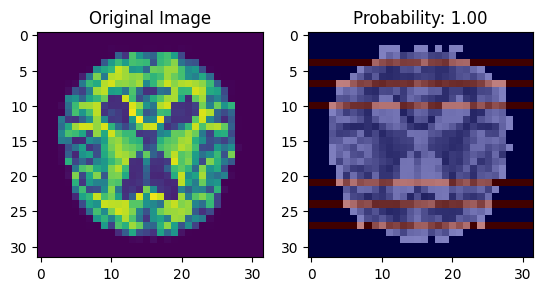

1/1 [==============================] - 0s 177ms/step


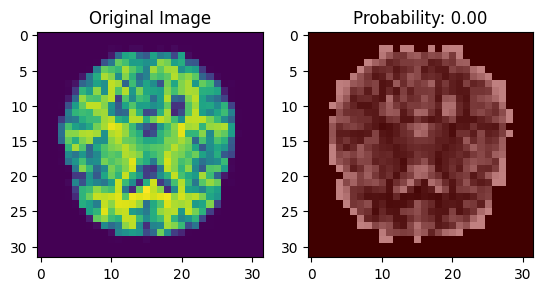

1/1 [==============================] - 0s 236ms/step


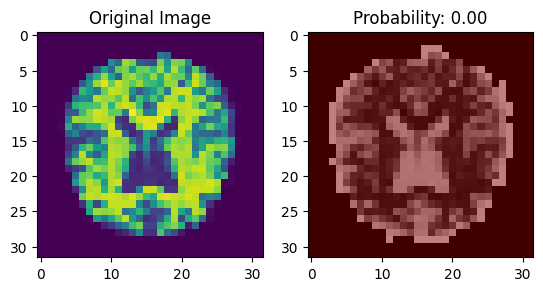

1/1 [==============================] - 0s 164ms/step


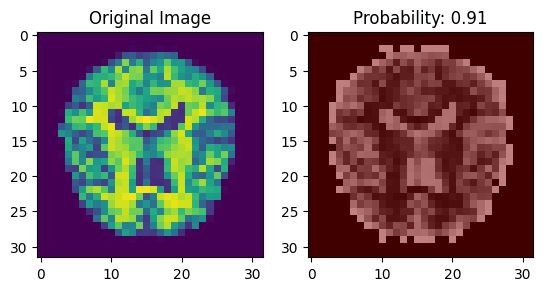

1/1 [==============================] - 0s 162ms/step


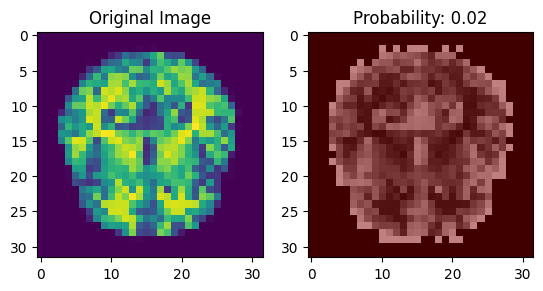

1/1 [==============================] - 0s 162ms/step


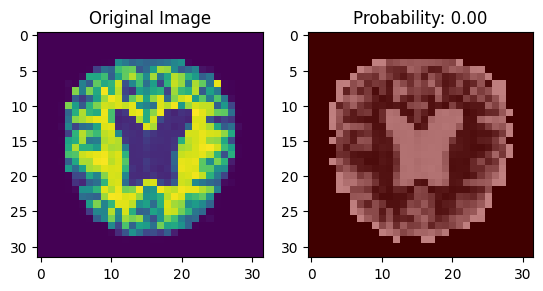

1/1 [==============================] - 0s 183ms/step


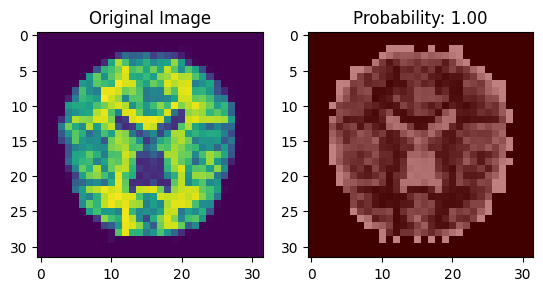

1/1 [==============================] - 0s 186ms/step


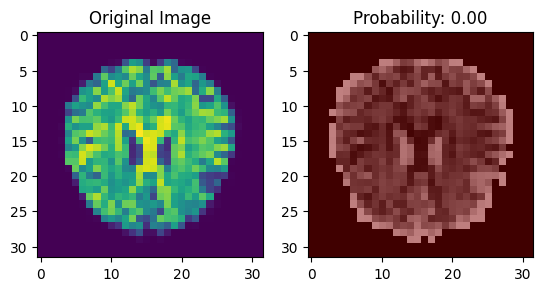

1/1 [==============================] - 0s 171ms/step


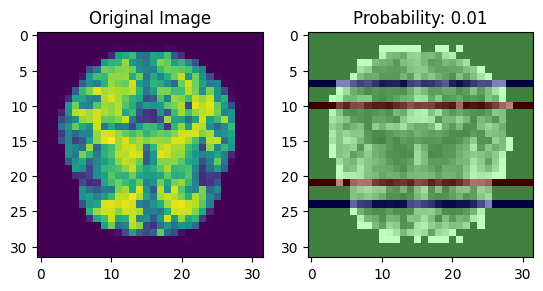

1/1 [==============================] - 0s 154ms/step


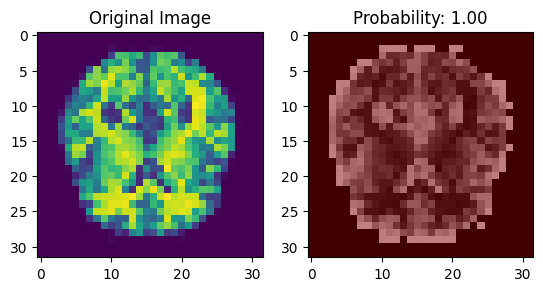

1/1 [==============================] - 0s 166ms/step


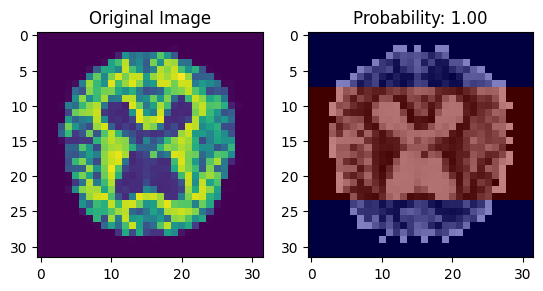

1/1 [==============================] - 0s 162ms/step


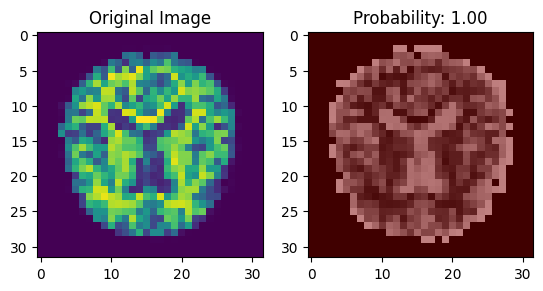

1/1 [==============================] - 0s 161ms/step


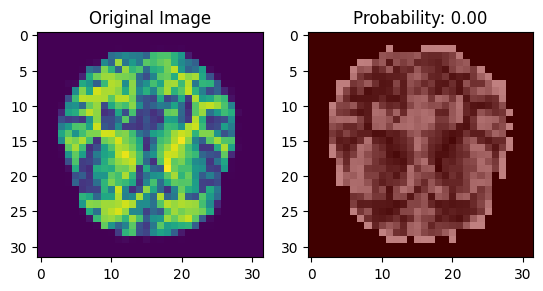

1/1 [==============================] - 0s 162ms/step


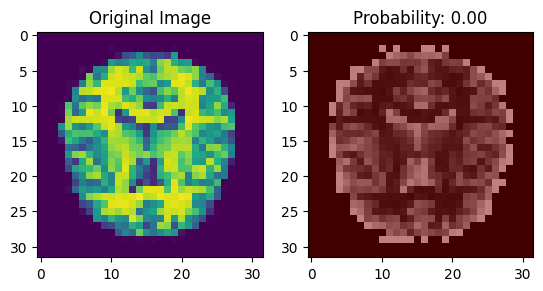

1/1 [==============================] - 0s 175ms/step


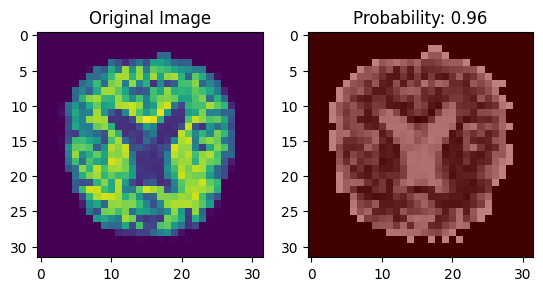

1/1 [==============================] - 0s 167ms/step


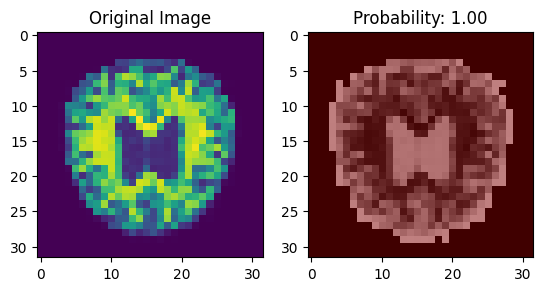

1/1 [==============================] - 0s 207ms/step


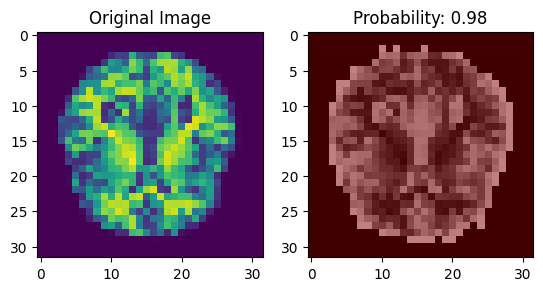

1/1 [==============================] - 0s 169ms/step


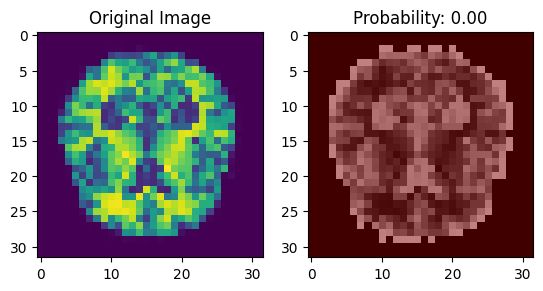

1/1 [==============================] - 0s 224ms/step


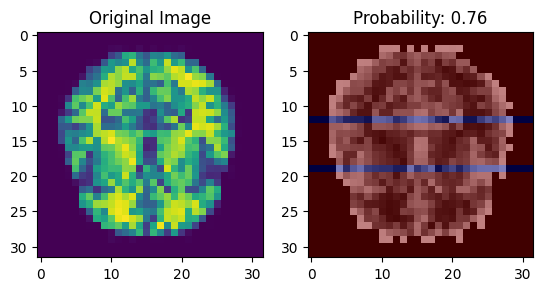

1/1 [==============================] - 0s 281ms/step


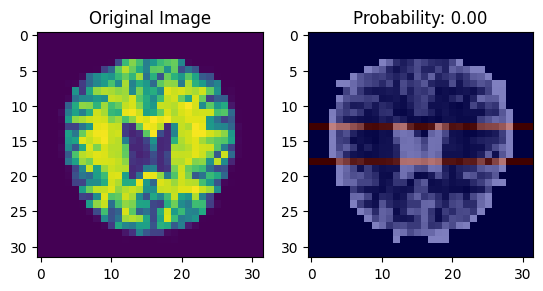

1/1 [==============================] - 0s 189ms/step


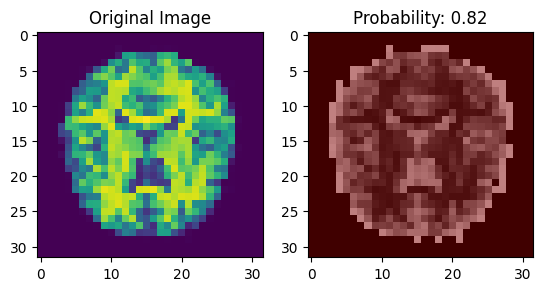

1/1 [==============================] - 0s 178ms/step


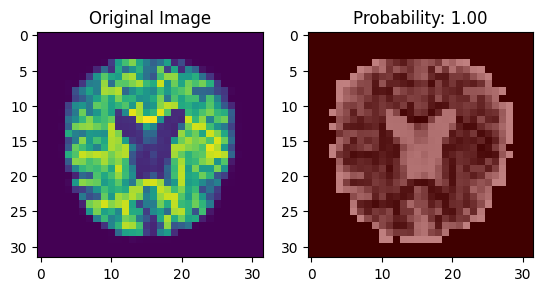

1/1 [==============================] - 0s 165ms/step


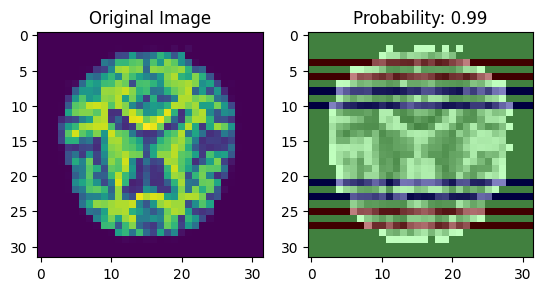

1/1 [==============================] - 0s 193ms/step


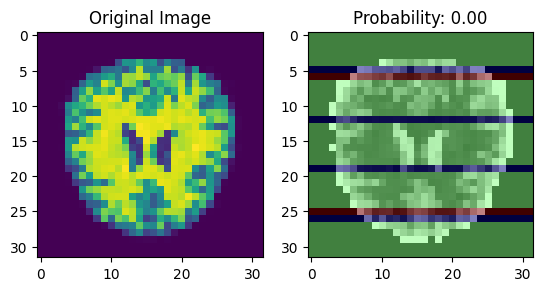

1/1 [==============================] - 0s 161ms/step


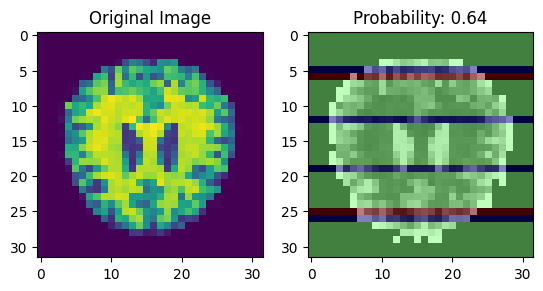

1/1 [==============================] - 0s 161ms/step


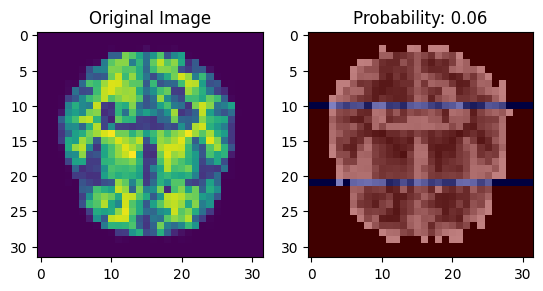

1/1 [==============================] - 0s 161ms/step


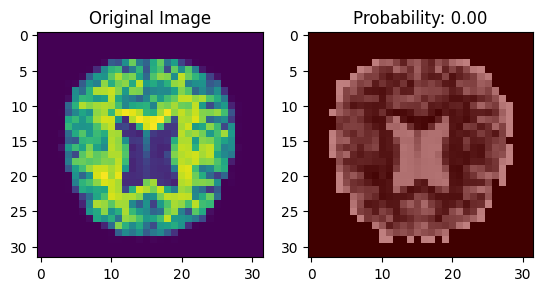

1/1 [==============================] - 0s 154ms/step


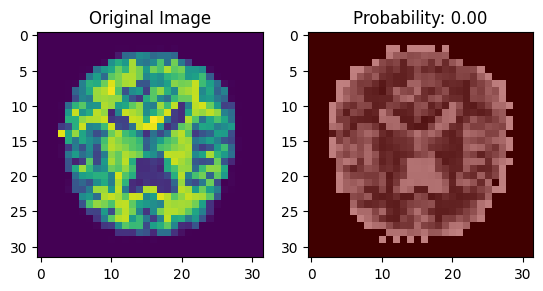

1/1 [==============================] - 0s 192ms/step


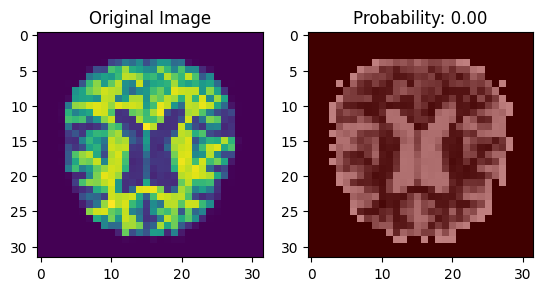

1/1 [==============================] - 0s 154ms/step


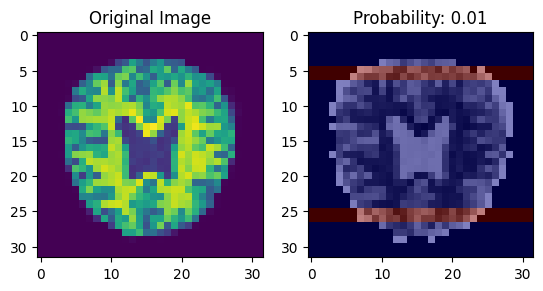

1/1 [==============================] - 0s 156ms/step


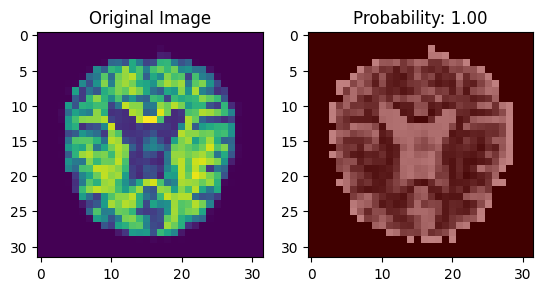

1/1 [==============================] - 0s 236ms/step


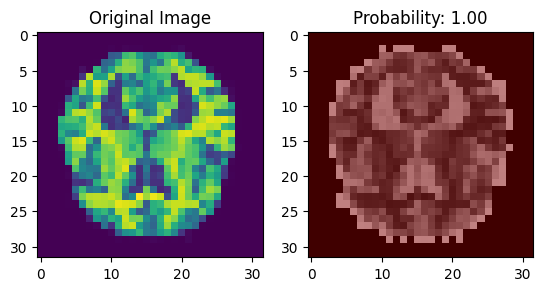

1/1 [==============================] - 0s 158ms/step


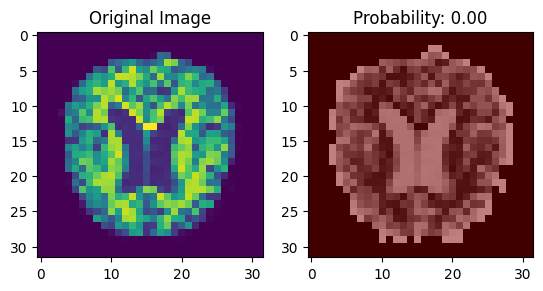

In [ ]:
# Iterate over the test images
for img_array, y_true in zip(x_test, y_test):
    # Predict the probability of Alzheimer's disease
    img_array = np.expand_dims(img_array, axis=0)
    prediction = model.predict(img_array)
    probability = prediction[0][1]  # Probability of Alzheimer's disease class

    # Generate CAM and overlay it on the original image
    overlayed_img = generate_cam(img_array, model, class_index=1)  # Class index for Alzheimer's disease

    # Display the original image, probability, and the overlayed image
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img_array[0])
    plt.title('Original Image')

    plt.subplot(1, 2, 2)
    plt.imshow(overlayed_img)
    plt.title(f'Probability: {probability:.2f}')

    plt.show()

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Initialize empty lists to store the predicted labels and true labels
y_pred = []
y_true = []

# Iterate over the test images
for img_array, true_label in zip(x_test, y_test):
    # Predict the probability of Alzheimer's disease
    img_array = np.expand_dims(img_array, axis=0)
    prediction = model.predict(img_array)
    probability = prediction[0][1]  # Probability of Alzheimer's disease class

    # Append the predicted label and true label to the respective lists
    predicted_label = 1 if probability >= 0.5 else 0
    y_pred.append(predicted_label)
    y_true.append(true_label[1])  # True label for Alzheimer's disease class

# Calculate evaluation metrics
accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred)
recall = recall_score(y_true, y_pred)
f1 = f1_score(y_true, y_pred)

# Print the evaluation metrics
print(f'Accuracy: {accuracy:.2f}')
print(f'Precision: {precision:.2f}')
print(f'Recall: {recall:.2f}')
print(f'F1-score: {f1:.2f}')


1/1 [==============================] - 0s 37ms/step
Accuracy: 0.96
Precision: 0.95
Recall: 0.94
F1-score: 0.94


In [ ]:
import numpy as np

# Assuming you have the predicted probabilities from your model
predicted_probabilities = model.predict(x_test)

# Set a threshold for classification
threshold = 0.5  # Adjust the threshold based on your requirements

# Classify individuals based on the threshold
predictions = (predicted_probabilities > threshold).astype(int)

# Count the number of positive cases (people with the disease)
num_people_with_disease = np.sum(predictions)

print(f"Number of people with the disease: {num_people_with_disease}")


41/41 [==============================] - 3s 74ms/step
Number of people with the disease: 1275
